In [31]:
import os
import requests
import pandas as pd
from pandas.api.types import CategoricalDtype
import numpy as np
import matplotlib.pyplot as plt
import matplotlib.pyplot as plt
import matplotlib.patches as mpatches
import seaborn as sns
from sklearn.model_selection import train_test_split, KFold, cross_val_score, cross_val_predict
from sklearn.linear_model import LinearRegression, Ridge
from sklearn.svm import SVR
from sklearn.neighbors import KNeighborsRegressor
from sklearn.tree import DecisionTreeRegressor
from sklearn.ensemble import RandomForestRegressor
from sklearn.metrics import mean_absolute_error, mean_squared_error, r2_score
from sklearn.preprocessing import StandardScaler
from sklearn.inspection import permutation_importance
import xgboost as xgb
from pygam import LinearGAM, s
from functools import reduce
import shap
from scipy.stats import shapiro
from scipy.stats import mannwhitneyu
from scipy.stats import wilcoxon

# Display all rows/columns in output
pd.set_option('display.max_rows', None)
pd.set_option('display.max_columns', None)

# Data Pre-processing

## Download datasets from GitHub

In [34]:
# Create input directory if it doesn't exist
os.makedirs("input", exist_ok=True)

# Download file 1 (Excel)
url1 = "https://raw.githubusercontent.com/jinshijian/SoilHealthDB/master/data/SoilHealthDB_V2.xlsx"
output_path1 = "input/SoilHealthDB_V2.xlsx"

response1 = requests.get(url1)
if response1.status_code == 200:
    with open(output_path1, "wb") as f:
        f.write(response1.content)
    print(f"SoilHealthDB_V2.xlsx downloaded to input folder.")
else:
    print("Failed to download SoilHealthDB_V2.xlsx:", response1.status_code)

# Download file 2 (CSV)
url2 = "https://raw.githubusercontent.com/jinshijian/SoilHealthDB/master/data/SoilHealthDB_V2.csv"
output_path2 = "input/SoilHealthDB_V2.csv"

response2 = requests.get(url2)
if response2.status_code == 200:
    with open(output_path2, "wb") as f:
        f.write(response2.content)
    print(f"SoilHealthDB_V2.csv downloaded to input folder.")
else:
    print("Failed to download SoilHealthDB_V2.csv:", response2.status_code)

SoilHealthDB_V2.xlsx downloaded to input folder.
SoilHealthDB_V2.csv downloaded to input folder.


## Correct ExperimentID format and match original columns

In [35]:
# Read the Excel file (active sheet by default), convert ExperimentID column to string type
df3 = pd.read_excel('input/SoilHealthDB_V2.xlsx', dtype={'ExperimentID': str})
# Read the original csv file
df2 = pd.read_csv('input/SoilHealthDB_V2.csv', low_memory=False, encoding='latin1')

# Compare column names of two DataFrames
diff_cols_df3 = set(df3.columns) - set(df2.columns)
print("Columns in SoilHealthDB_V2.xlsx but not in SoilHealthDB_V2.csv:", diff_cols_df3)

# Remove columns in df3 that are not in df2
df3 = df3.drop(columns=list(diff_cols_df3))
print("SoilHealthDB_V2.xlsx Shape (columns above removed):", df3.shape)

# Create output directories
for d in ["output", "output/plots", "output/tables"]:
    if not os.path.exists(d):
        os.makedirs(d)

Columns in SoilHealthDB_V2.xlsx but not in SoilHealthDB_V2.csv: {'CEC_Unit', 'CEC'}
SoilHealthDB_V2.xlsx Shape (columns above removed): (5907, 268)


## Filter data by comments

In [36]:
## Column info table (only the first 22 soil health indicators)
comment_columns = [
    col for col in df3.columns
    if 'Comments' in col and col.split('.')[0].isdigit() and 1 <= int(col.split('.')[0]) <= 22
]
filtered_columns = [col for col in df3.columns if 'comments' not in col.lower()]
numeric_df3 = df3[filtered_columns].select_dtypes(include=[np.number])
sh_control_columns = [col for col in numeric_df3.iloc[:, 26:119] if '_C' in col and not col.endswith(('_T', '_C_SD', '_C_SD%', '_C_SD_Seq', 'No_C'))]
sh_treatment_columns = [col for col in numeric_df3.iloc[:, 26:119] if '_T' in col and not col.endswith(('_C', '_T_SD', '_T_SD%', '_T_SD_Seq', 'No_T'))]
units = ['kg/hm2', 'kg/hm2', 'g/cm3', '%', 'Mg/ha', 'Mg/ha/cm/yr', 'mg/kg', 'mg/kg', 'mg/kg', '/', 'cmol+/kg = meq/100g', 'dS/m', 'mg/kg', 'g/kg', '%', 'Mpa', 'mm/h', 'cm/h', 'kg/ha', 'Mg/ha', 'kg/ha', '℃', 'kg/kg', 'g/g']  

column_table = {
    'Control': sh_control_columns,
    'Treatment': sh_treatment_columns,
    'Comment': comment_columns,
    'Unit': units,
}

column_df = pd.DataFrame(column_table)

column_df

,Control,Treatment,Comment,Unit
0,BiomassCash_C,BiomassCash_T,1.BiomassCash_Comments,kg/hm2
1,Yield_C,Yield_T,2.Yield_Comments,kg/hm2
2,BD_C,BD_T,3.BD_Comments,g/cm3
3,OC_C,OC_T,4.OC_Comments,%
4,OC_Con_C,OC_Con_T,4.2OC_Comments,Mg/ha
5,OC_C_Seq,OC_T_Seq,4.3OC_Seq_Comments,Mg/ha/cm/yr
6,N_C,N_T,5.N_Comments,mg/kg
7,P_C,P_T,6.P_Comments,mg/kg
8,K_C,K_T,7.K_Comments,mg/kg
9,pH_C,pH_T,8.pH_Comments,/


In [37]:
## Check comments

labels = sh_control_columns
diff_stats = []
output_lines = []

print(f"Indicators: non-NA rows - rows with comments | ratio of no comment rows (from highest)\n")
output_lines.append("Indicators: non-NA rows - rows with comments | ratio of no comment rows (from highest)\n")
# For each control indicator and its corresponding comment column:
for a, b, label in zip(sh_control_columns, comment_columns, labels):
    count_a = df3[a].notna().sum() # Count of non-NA values in the control column
    count_b = df3[b].notna().sum() # Count of non-NA values in the comment column
    diff = count_a - count_b # Difference: rows with data but no comment
    diff1 = round(diff/count_a, 2) # Ratio of rows without comments to total non-NA rows
    diff_stats.append((label, count_a, count_b, diff, diff1))
diff_stats.sort(key=lambda x: (x[4]), reverse=True)
for label, count_a, count_b, diff, diff1 in diff_stats:
    print(f"{label}: {count_a} - {count_b} = {diff} | {diff1}")
    output_lines.append(f"{label}: {count_a} - {count_b} = {diff} | {diff1}")

# Comment counts
print(f"\nComment Counts")
output_lines.append(f"\nComment Counts")

for col in comment_columns:
    print(f"\n{col}:")
    output_lines.append(f"\n{col}:")
    comment_counts = df3[col].dropna().value_counts()
    for comment, count in comment_counts.items():
        print(f"{comment} ----- {count}")
        output_lines.append(f"{comment} ----- {count}")

# Save to txt file
with open("output/tables/comments_summary_original.txt", "w", encoding="utf-8") as f:
    f.write("\n".join(output_lines))

Indicators: non-NA rows - rows with comments | ratio of no comment rows (from highest)

ST_C: 100 - 0 = 100 | 1.0
BD_C: 913 - 12 = 901 | 0.99
pH_C: 385 - 4 = 381 | 0.99
Yield_C: 2382 - 740 = 1642 | 0.69
Ksat_C: 121 - 61 = 60 | 0.5
OC_C: 1573 - 830 = 743 | 0.47
K_C: 406 - 273 = 133 | 0.33
Infiltration_C: 77 - 57 = 20 | 0.26
BiomassCash_C: 436 - 325 = 111 | 0.25
BS_C: 16 - 12 = 4 | 0.25
SWC_C: 821 - 676 = 145 | 0.18
Penetration_C: 241 - 206 = 35 | 0.15
P_C: 576 - 503 = 73 | 0.13
EC_C: 54 - 49 = 5 | 0.09
Aggre_C: 314 - 287 = 27 | 0.09
CEC_C: 191 - 181 = 10 | 0.05
AWHC_C: 85 - 81 = 4 | 0.05
Erosion_C: 477 - 459 = 18 | 0.04
Runoff_C: 436 - 418 = 18 | 0.04
N_C: 1615 - 1599 = 16 | 0.01
Porosity_C: 181 - 180 = 1 | 0.01
Leaching_C: 380 - 381 = -1 | -0.0
OC_Con_C: 606 - 979 = -373 | -0.62
OC_C_Seq: 80 - 1250 = -1170 | -14.62

Comment Counts

1.BiomassCash_Comments:
Stover ----- 75
Stove ----- 36
kg per ha ----- 36
Straw ----- 24
Corn population (Plants per ha) ----- 19
Corn population (1000 plan

In [ ]:
## Clean columns by comments

# Columns to blank only if they mention one of the unit keywords
units_per_comment = {
    '1.BiomassCash_Comments': ['need','unit','kg per ha','plants per ha','1000 plants per ha','g per pot','g/plant','Mg per ha','Mg per ha to kg per ha per yr','g','Height','NPP'],
    '2.Yield_Comments': ['check','unit','kg/ha','kg per ha','Kg per ha','Mg per ha to kg per ha','Mg per ha to Kg','Mg ha to Kg per ha','t dry matter / ha to kg per ha','t per ha to kg per ha','g/m2 to Mg/ha','t hm-2','unit is t hm-2','kg per tree to kg per ha','kg per vine'],
    '4.OC_Comments': ['unit','%','g/kg','g/kg to %','mg/g to %','mg c per kg soil to %','SOM (g/kg to %)','% OM','TC','TC (%)','TC (g/kg to %)','TC (g/kg) to %','TC (g*kg to %)','SOC (g/kg) to %','SOC, g/kg to %','SOC %','OC (%)','OM','OM*0.58 to OC'],
    '4.2OC_Comments': ['check','unit','Mg c per ha','Mg per ha','Mg/ha','kg c per m3','g per ha','TOC','SOC','TC','OCPerc','TCPerc','OC','OM','%','t per ha'],
    '5.N_Comments': ['unit','g/kg','g per kg','mg/g','mg per g','mg/kg','mg per kg','g/m2','kg per ha','kg/ha','kg N per ha','t per ha','t per ha to mg per kg','Mg/ha','Mg per ha','Mg per ha to mg per kg','kg c per m3','%','ppm','g/kg to mg/kg','g per kg to mg per kg'],
    '6.P_Comments': ['check','unit','g/mg','mu g per g','mg/g','mg per kg','mg/kg','g/kg','g/ha','kg per ha','g/kg to mg/kg','%','ppm','mg per L','mg dm-3','mm'],
    '7.K_Comments': ['unit','g/mg','ug/g','g/kg','mg/kg','cmol per kg','cmol per g','cmol dm-3','g/kg to %','%','ppm'],
    '9.CEC_Comments': ['unit','mg/kg','Cmol per kg','cmol per kg','cmol/kg','c mol per kg','meq per 100 g','m.e./g','me/100g','mmol per kg','mg per kg','cmol dm-3', 'mequiv per 100 g soil to per 1 kg soil'],
    '12.Aggre_Comments': ['unit','g/kg', '%'],
    '13.Porosity_Comments': ['unit','%', 'mu'],
    '14.Penetration_Comments': ['unit','Mpa', 'MPa', 'Kpa/cm', 'N/m2'],
    '15.Infiltration_Comments': ['mm', 'cm', '%'],
    '16.Ksat_Comments': ['unit','mm', 'cm', 'm'],
}

# Columns to blank every non‐NA comment unless an exception phrase is found
check_all_comments = ['4.3OC_Seq_Comments', '8.pH_Comments', '10.EC_Comments', '11.BS_Comments', '17.Erosion_Comments', '18.Runoff_Comments', '19.Leaching_Comments', '21.SWC_Comments', '22.AWHC_Comments']

# Define exceptions for each comment column
comment_exceptions = {
    '1.BiomassCash_Comments': ['kg per ha'],
    '2.Yield_Comments': ['kg per ha', 'kg/ha'],
    '4.OC_Comments': ['%', 'OC'],
    '4.2OC_Comments': ['Mg per ha', 'Mg c per ha', 'Mg/ha'],
    '4.3OC_Seq_Comments': ['Mg per Ha'],
    '5.N_Comments': ['mg/kg', 'mg per kg', 'mg N per kg'],
    '6.P_Comments': ['mg/kg', 'mg per kg'],
    '7.K_Comments': ['mg/kg', 'mg kg–1'],
    '9.CEC_Comments': ['cmol per kg', 'c mol per kg', 'cmol/kg', 'meq per 100 g', 'me/100g'],
    '10.EC_Comments': ['dS/m', 'dS m–1', 'dSm'],
    '11.BS_Comments': ['Ca'],
    '12.Aggre_Comments': ['g/kg'],
    '13.Porosity_Comments': ['%'],
    '14.Penetration_Comments': ['Mpa', 'MPa'],
    '15.Infiltration_Comments': ['mm per h'],
    '16.Ksat_Comments': ['cm/h'],
    '17.Erosion_Comments': ['kg/ha', 'defined', 'reduce'],
    '19.Leaching_Comments': ['kg/ha', 'kg per ha', 'Kg N per ha', 'k/ha'],
    '21.SWC_Comments': ['kg/kg', 'Gravimetric', 'GMW', 'No till'],
    '22.AWHC_Comments': ['g/g', 'AWC', 'SWC'],
}

# Helper functions (case‐insensitive substring match)
def mentions_unit(txt, keywords):
    if pd.isna(txt): return False
    low = str(txt).lower()
    return any(kw.lower() in low for kw in keywords)

def contains_exception(txt, exceptions):
    if pd.isna(txt): return False
    low = str(txt).lower()
    return any(exc.lower() in low for exc in exceptions)

# Loop
for ctl_col, trt_col, cmt_col in zip(sh_control_columns,
                                     sh_treatment_columns,
                                     comment_columns):

    # If in units_per_comment list => only blank rows matching units (minus exceptions)
    if cmt_col in units_per_comment:
        kws       = units_per_comment[cmt_col]
        mask_unit = df3[cmt_col].apply(lambda x: mentions_unit(x, kws))

        if cmt_col in comment_exceptions:
            excs     = comment_exceptions[cmt_col]
            mask_exc = df3[cmt_col].apply(lambda x: contains_exception(x, excs))
        else:
            # Build an “all–False” Series the same length as original df
            mask_exc = pd.Series(False, index=df3.index)

        final_mask = mask_unit & ~mask_exc

    # Else if check_all_comments => blank all non-NA except allowed exceptions
    elif cmt_col in check_all_comments:
        mask_all  = df3[cmt_col].notna()

        if cmt_col in comment_exceptions:
            excs     = comment_exceptions[cmt_col]
            mask_exc = df3[cmt_col].apply(lambda x: contains_exception(x, excs))
        else:
            # build an “all–False” Series the same length as original df
            mask_exc = pd.Series(False, index=df3.index)

        final_mask = mask_all & ~mask_exc

    # Otherwise skip this column entirely
    else:
        continue

    # Apply the blanking
    df3.loc[final_mask, ctl_col] = pd.NA
    df3.loc[final_mask, trt_col] = pd.NA

In [39]:
## Check columns after filtering

output_lines = []
diff_stats = []

print(f"Indicators: original non-NA rows → non-NA rows after filtered by comments\n")
output_lines.append("Indicators: original non-NA rows → non-NA rows after filtered by comments\n")
for a, b, label in zip(sh_control_columns, comment_columns, labels):
    count_a = df2[a].notna().sum()
    count_b = df3[a].notna().sum()
    diff_stats.append((label, count_a, count_b))
for label, count_a, count_b in diff_stats:
    print(f"{label}: {count_a} → {count_b}")
    output_lines.append(f"{label}: {count_a} → {count_b}")

print("\nComment Counts (only where control & treatment are not NA)")
output_lines.append("\nComment Counts (only where control & treatment are not NA)")

for ctl_col, trt_col, cmt_col in zip(sh_control_columns,
                                     sh_treatment_columns,
                                     comment_columns):

    print(f"\n{cmt_col}:")
    output_lines.append(f"\n{cmt_col}:")

    # mask rows where BOTH ctl & trt are present
    good = df3[ctl_col].notna() & df3[trt_col].notna()

    # count comments in that subset
    comment_counts = df3.loc[good, cmt_col].dropna().value_counts()
    for comment, count in comment_counts.items():
        print(f"{comment} ----- {count}")
        output_lines.append(f"{comment} ----- {count}")

# Save to txt file
with open("output/tables/comments_summary_filtered.txt", "w", encoding="utf-8") as f:
    f.write("\n".join(output_lines))

Indicators: original non-NA rows → non-NA rows after filtered by comments

BiomassCash_C: 436 → 343
Yield_C: 2382 → 2347
BD_C: 913 → 913
OC_C: 1573 → 1475
OC_Con_C: 606 → 433
OC_C_Seq: 80 → 0
N_C: 1615 → 888
P_C: 576 → 307
K_C: 406 → 233
pH_C: 385 → 381
CEC_C: 191 → 154
EC_C: 54 → 41
BS_C: 16 → 8
Aggre_C: 314 → 242
Porosity_C: 181 → 171
Penetration_C: 241 → 227
Infiltration_C: 77 → 24
Ksat_C: 121 → 94
Erosion_C: 477 → 28
Runoff_C: 436 → 19
Leaching_C: 380 → 149
ST_C: 100 → 100
SWC_C: 821 → 203
AWHC_C: 85 → 12

Comment Counts (only where control & treatment are not NA)

1.BiomassCash_Comments:
Stover ----- 53
Stove ----- 36
kg per ha ----- 36
Straw ----- 24
Stems + leaves, Units: kg per ha ----- 15
Maize stove ----- 14
Stubble yield (kg per ha) ----- 7
Stover (kg per ha) ----- 6
Main crop residues, Mg per ha to kg per ha per yr ----- 3
Maize stover ----- 3
First season ----- 3
Second season ----- 3
Haulms (table 6) ----- 3
Stover biomass ----- 2

2.Yield_Comments:
kg/ha ----- 85
Mg per 

## Impute soil textures

In [40]:
## Soil texture range table based on USDA classification
texture_range = {
    "Texture": [
        'Clay', 'Silty clay', 'Sandy clay', 'Silty clay loam',
        'Clay loam', 'Sandy clay loam', 'Silt', 'Silt loam',
        'Loam', 'Sandy loam', 'Loamy sand', 'Sand'
    ],
    "Sand_Low": [0.0, 0.0, 45.0, 0.0, 20.0, 45.0, 0.0, 0.0, 23.0, 43.0, 70.0, 85.0],
    "Sand_High": [45.0, 20.0, 65.0, 20.0, 45.0, 80.0, 20.0, 50.0, 52.0, 85.0, 90.0, 100.0],
    "Silt_Low": [0.0, 40.0, 0.0, 40.0, 15.0, 0.0, 80.0, 50.0, 28.0, 0.0, 0.0, 0.0],
    "Silt_High": [40.0, 60.0, 20.0, 73.0, 53.0, 28.0, 100.0, 88.0, 50.0, 50.0, 30.0, 15.0],
    "Clay_Low": [40.0, 40.0, 35.0, 27.0, 27.0, 20.0, 0.0, 0.0, 7.0, 0.0, 0.0, 0.0],
    "Clay_High": [100.0, 60.0, 55.0, 40.0, 40.0, 35.0, 12.0, 27.0, 27.0, 20.0, 15.0, 10.0]
}

# Convert to DataFrame
texture_df = pd.DataFrame(texture_range)

# Calculate centroid (mean values) for each texture
texture_df["Centroid_Sand"] = (texture_df["Sand_Low"] + texture_df["Sand_High"]) / 2
texture_df["Centroid_Silt"] = (texture_df["Silt_Low"] + texture_df["Silt_High"]) / 2
texture_df["Centroid_Clay"] = (texture_df["Clay_Low"] + texture_df["Clay_High"]) / 2

# Prepare for later impute function
texture_centroids = texture_df.set_index("Texture")[["Centroid_Sand", "Centroid_Silt", "Centroid_Clay"]]

texture_centroids


,Centroid_Sand,Centroid_Silt,Centroid_Clay
Texture,,,
Clay,22.5,20.0,70.0
Silty clay,10.0,50.0,50.0
Sandy clay,55.0,10.0,45.0
Silty clay loam,10.0,56.5,33.5
Clay loam,32.5,34.0,33.5
Sandy clay loam,62.5,14.0,27.5
Silt,10.0,90.0,6.0
Silt loam,25.0,69.0,13.5
Loam,37.5,39.0,17.0


In [42]:
## Impute sand, silt and clay percentages

# Function to impute missing values
def impute_soil_components(row):
    if row['Texture'] not in texture_centroids.index:
        return pd.Series([row['SandPerc'], row['SiltPerc'], row['ClayPerc']]) #no change

    x_c, y_c, z_c = texture_centroids.loc[row['Texture']]
    total = 100.0
    x, y, z = row['SandPerc'], row['SiltPerc'], row['ClayPerc']

    # Step 1: Inference when two are known
    if pd.notna(x) and pd.notna(y) and pd.isna(z):
        z = total - x - y
    elif pd.notna(y) and pd.notna(z) and pd.isna(x):
        x = total - y - z
    elif pd.notna(x) and pd.notna(z) and pd.isna(y):
        y = total - x - z

    # Step 2: Centroid-based fill if still missing
    # All missing
    if pd.isna(x) and pd.isna(y) and pd.isna(z):
        return pd.Series([x_c, y_c, z_c])

    # One known, two missing
    elif pd.notna(x) and pd.isna(y) and pd.isna(z):
        remaining = total - x
        y_ratio = y_c / (y_c + z_c)
        z_ratio = z_c / (y_c + z_c)
        y = remaining * y_ratio
        z = remaining * z_ratio
    elif pd.isna(x) and pd.notna(y) and pd.isna(z):
        remaining = total - y
        x_ratio = x_c / (x_c + z_c)
        z_ratio = z_c / (x_c + z_c)
        x = remaining * x_ratio
        z = remaining * z_ratio
    elif pd.isna(x) and pd.isna(y) and pd.notna(z):
        remaining = total - z
        x_ratio = x_c / (x_c + y_c)
        y_ratio = y_c / (x_c + y_c)
        x = remaining * x_ratio
        y = remaining * y_ratio

    return pd.Series([x, y, z])

# Apply and create new columns with '_imputed' suffix
df3 = df3.drop(columns=['SandPerc_imputed', 'SiltPerc_imputed', 'ClayPerc_imputed'], errors='ignore')# Remove new columns if it already exists (for re-running the script)
df3[['SandPerc_imputed', 'SiltPerc_imputed', 'ClayPerc_imputed']] = df3.apply(impute_soil_components, axis=1).round(2)

In [ ]:
## Check textures before and after imputation

# Define valid textures
valid_textures = texture_range['Texture']

# Texture column check
texture_non_na = df3['Texture'].notna().sum()
texture_valid = df3['Texture'].isin(valid_textures).sum()
texture_invalid = texture_non_na - texture_valid
print(f"Texture: {texture_non_na} total non-NA rows - {texture_invalid} rows with invalid values = {texture_valid} valid non-NA rows\n")

# Define columns
original_cols = ['SandPerc', 'SiltPerc', 'ClayPerc']
imputed_cols = ['SandPerc_imputed', 'SiltPerc_imputed', 'ClayPerc_imputed']

# Prepare results
rows = []
for orig, imp, name in zip(original_cols, imputed_cols, ['Sand', 'Silt', 'Clay']):
    orig_non_na = df3[orig].notna().sum()
    imp_non_na = df3[imp].notna().sum()
    rows.append({'': name, 'Original': orig_non_na, 'Imputed': imp_non_na})

# Intersection: rows where all sand/silt/clay are present
orig_all = df3[original_cols].notna().all(axis=1).sum()
imp_all = df3[imputed_cols].notna().all(axis=1).sum()
rows.append({'': 'Intersection', 'Original': orig_all, 'Imputed': imp_all})

# Output as DataFrame
summary_df = pd.DataFrame(rows)[['', 'Original', 'Imputed']]
summary_df.index = summary_df['']
summary_df = summary_df.drop(columns=[''])
print(summary_df)

Texture: 4926 total non-NA rows - 185 rows with invalid values = 4741 valid non-NA rows

              Original  Imputed
                               
Sand              2498     4741
Silt              2498     4741
Clay               455     4761
Intersection       233     4739


## Manual filtering

In [44]:
## Data filtering based on thresholds
df = df3

df.loc[df['BD_C'] > 2, 'BD_C'] = pd.NA
df.loc[df['BD_T'] > 2, 'BD_T'] = pd.NA
df.loc[df['CEC_C'] > 99, 'CEC_C'] = pd.NA
df.loc[df['CEC_T'] > 99, 'CEC_T'] = pd.NA
df.loc[df['Yield_C'] >= 50000, 'Yield_C'] = pd.NA
df.loc[df['Yield_T'] >= 50000, 'Yield_T'] = pd.NA
df.loc[df['ClayPerc_imputed'] < 0, 'ClayPerc_imputed'] = pd.NA

## Generate features for modelling

In [45]:
## Create new columns of CEC, BD and Yield log ratios for modelling

df3['CEC_ratio'] = df3['CEC_T'] / df3['CEC_C']
df3['BD_ratio'] = df3['BD_T'] / df3['BD_C']
df3['Yield_ratio'] = df3['Yield_T'] / df3['Yield_C']

df3['CEC_log_ratio'] = np.log(df3['CEC_T'] / df3['CEC_C'])
df3['BD_log_ratio'] = np.log(df3['BD_T'] / df3['BD_C'])
df3['Yield_log_ratio'] = np.log(df3['Yield_T'] / df3['Yield_C'])

In [46]:
## Group conservation types

def group_conservation_type(cons_type):
    # Keep AF and CC as is
    if cons_type in ['AF', 'CC']:
        return cons_type

    # If 'OF' present (and not AF/CC), group as 'OF'
    if 'OF' in cons_type.split('-'):
        return 'OF'

    # If 'SR' present, group as 'SR'
    if 'SR' in cons_type.split('-'):
        return 'SR'

    # If 'NT' or 'RT' present, group as 'NT&RT'
    if 'NT' in cons_type.split('-') or 'RT' in cons_type.split('-'):
        return 'NT&RT'

    # Everything else: NA
    return np.nan

# Apply the grouping function to create a Conservation_Group column
df3['Conservation_Group'] = df3['Conservation_Type'].apply(group_conservation_type)

# Show conservation groups
print(df3[['Conservation_Group']].value_counts())
print()

# Create a DataFrame of unique Conservation_Type and their mapped group
type_group_df = pd.DataFrame({
    'Conservation_Type': df3['Conservation_Type'].unique()
})
type_group_df['Conservation_Group'] = type_group_df['Conservation_Type'].apply(group_conservation_type)
# Count occurrences in the original data
type_counts = df3['Conservation_Type'].value_counts().rename('Count').reset_index()
type_counts = type_counts.rename(columns={'index': 'Conservation_Type'})
# Merge to show all types, their group, and count
combined_table = type_group_df.merge(type_counts, on='Conservation_Type', how='left')
# Show the table
print(combined_table.sort_values('Conservation_Group', na_position='last'))


Conservation_Group
CC                    3022
AF                    1107
NT&RT                  910
OF                     501
SR                     236
Name: count, dtype: int64

   Conservation_Type Conservation_Group  Count
2                 AF                 AF   1107
0                 CC                 CC   3022
22             NT-IN              NT&RT      6
21             RT-SD              NT&RT      1
17             NT-CC              NT&RT      6
24          RT-PF-RD              NT&RT      2
7                 NT              NT&RT    194
10                RT              NT&RT     40
3              CC-RT              NT&RT     16
1              CC-NT              NT&RT    643
25             RT-RD              NT&RT      2
5                 OF                 OF    268
4              OF-CC                 OF    223
6              OF-NT                 OF     10
8              NT-SR                 SR     75
9                 SR                 SR     81
16          NT-CC-SR

# Data Visualization

## Missing values in each column

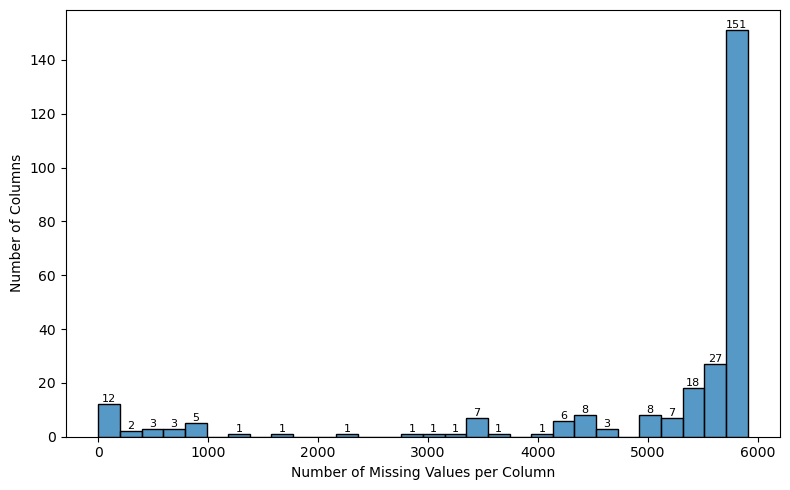

Missing values per column (from lowest):
StudyID                          0
Conservation_Type                0
Country                          0
YearPublication                  0
Latitude                        23
Longitude                       23
SiteInfor                       54
Duration                        65
ExperimentID                    75
Journal                         97
SamplingYear                    99
TimeAfterCoverCrop             101
Author_G                       236
GrainCropGroup                 291
Elevation                      410
GrainCrop                      412
Author_F                       498
SamplingDepth                  646
Time_Comments                  675
SamplingThickness              734
CoverCropGroup                 845
CoverCrop                      856
No_T                           978
No_C                           978
Texture                        981
ControlDescription            1265
SoilFamily                    1649
ExperimentDesi

In [ ]:
# Count missing values in each column
missing_per_column = df3.isnull().sum()

# Plot histogram of missing values count per column
plt.figure(figsize=(8, 5))
ax = sns.histplot(missing_per_column, bins=30, kde=False)
plt.xlabel('Number of Missing Values per Column')
plt.ylabel('Number of Columns')
for p in ax.patches:
    height = p.get_height()
    if height > 0:
        ax.annotate(f'{int(height)}', 
                    (p.get_x() + p.get_width() / 2, height),
                    ha='center', va='bottom', fontsize=8)
plt.tight_layout()
plt.savefig("output/plots/missing_values_per_column.png", dpi=300)
plt.show()

# Sort missing values in descending order
missing_per_column = missing_per_column.sort_values(ascending=True)

# List missing values per column
print("Missing values per column (from lowest):")
print(missing_per_column)

## Missing values in each row

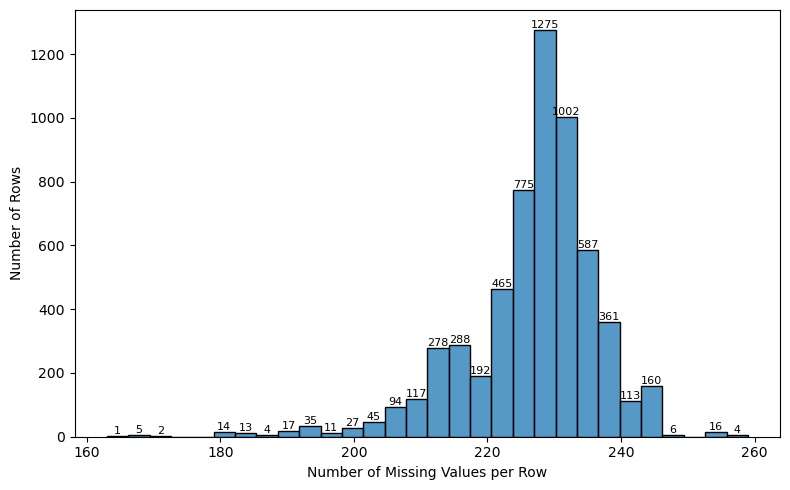

Missing values per row
     ExperimentID  missing_count
0             1-1            244
1             1-1            244
2             1-2            242
3             1-1            244
4             1-4            244
5             1-4            244
6             1-4            244
7             1-4            242
8             1-4            244
9             1-1            244
10            1-2            244
11            2-1            218
12            2-2            218
13            3-1            232
14            3-2            232
15            3-2            232
16            3-1            232
17            3-2            232
18            3-2            232
19            3-1            232
20            3-1            232
21            3-2            232
22            3-2            232
23            3-1            232
24            3-2            232
25            3-2            232
26            3-1            232
27            3-1            232
28            3-2   

In [ ]:
# Count missing values in each row
missing_per_row = df3.isnull().sum(axis=1)

# Plot histogram
plt.figure(figsize=(8, 5))
ax = sns.histplot(missing_per_row, bins=30, kde=False)
plt.xlabel('Number of Missing Values per Row')
plt.ylabel('Number of Rows')

# Add count labels above bars
for p in ax.patches:
    height = p.get_height()
    if height > 0:
        ax.annotate(f'{int(height)}', 
                    (p.get_x() + p.get_width() / 2, height),
                    ha='center', va='bottom', fontsize=8)

plt.tight_layout()
plt.savefig("output/plots/missing_values_per_row.png", dpi=300)
plt.show()


# Combine with row index for clarity
missing_per_row_df = pd.DataFrame({
    #'row_index': df.index,
    'ExperimentID': df3['ExperimentID'],
    'missing_count': missing_per_row
})

# Filter rows that have any missing values
missing_per_row_df = missing_per_row_df[missing_per_row_df['missing_count'] > 0]

# Reset index for display
missing_per_row_df = missing_per_row_df.reset_index(drop=True)

# List missing values per row
print("Missing values per row")
print(missing_per_row_df)


## ExperimentID replication assess

Number of ExperimentIDs: 1408


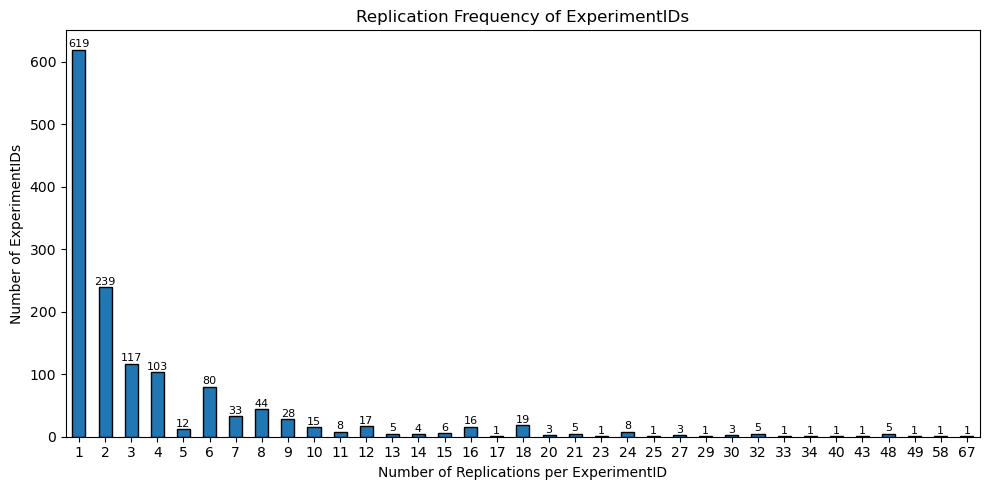

ExperimentID
21-1         67
59-1         58
148-1        49
172-4        48
172-3        48
172-1        48
172-2        48
73-3         48
160-1        43
41-1         40
41-2         34
170-2        33
30-1         32
111-41       32
30-3         32
30-2         32
30-4         32
170-1        30
17-4         30
110-5        30
110-3        29
164-1        27
65-1         27
149-1        27
313-1        25
153-5        24
298-1        24
3-2          24
153-4        24
133-2        24
147-2        24
147-1        24
45-1         24
207-69-3     23
26-4         21
26-3         21
26-2         21
26-1         21
158-1        21
168-6        20
150-1        20
168-5        20
194-1        18
166-1        18
53-8         18
53-3         18
135-1        18
163-6        18
53-7         18
133-1        18
111-15       18
93-4         18
130-2        18
3-1          18
93-3         18
131-1        18
93-2         18
110-4        18
194-2        18
130-1        18
111-12       18
91-16      

In [ ]:
# Count occurrences of each ID
id_counts = df3['ExperimentID'].value_counts().sort_values(ascending=False)

# Total unique IDs (if no duplication)
print(f"Number of ExperimentIDs: {id_counts.shape[0]}")

# Show a summary: how many IDs occur n times
replication_distribution = id_counts.value_counts().sort_index()

# Plot the replication distribution
fig, ax = plt.subplots(figsize=(10, 5))
replication_distribution.plot(kind='bar', ax=ax, edgecolor='black')

# Annotate each bar
for i, count in enumerate(replication_distribution):
    ax.text(i, count + 0.5, str(count), ha='center', va='bottom', fontsize=8)

# Set labels and ticks
ax.set_xlabel('Number of Replications per ExperimentID')
ax.set_ylabel('Number of ExperimentIDs')
ax.set_title('Replication Frequency of ExperimentIDs')
ax.set_xticklabels(replication_distribution.index, rotation=0)
plt.tight_layout()
plt.savefig(f"output/plots/replication_frequency_of_ExperimentIDs.png", dpi=300)
plt.show()

print(id_counts)

## Site coordinate assess

55 sites where Latitude and/or Longitude are NOT all the same.

        UniqueLats  UniqueLons  Count  Lat_StdDev  Lon_StdDev
SiteID                                                       
10               2           2     12    0.122599    0.097981
12               2           2     24    0.081721    0.127688
21               2           2     27    0.050071    0.300427
23               2           2     56    0.050324    0.301942
26               2           2     84    0.085511    0.191141
38               8           8     24    4.706971    3.899826
42               2           2     18    1.294986    1.636097
44               5           6     34    0.129647    0.092120
46               4           5     30    0.358701    0.718675
55               4           4     26    0.323859    0.246686
60               2           2     14    0.316691    0.094151
61               2           2     48    0.788254    0.298122
63               2           2     26    1.254698    0.143499
87    

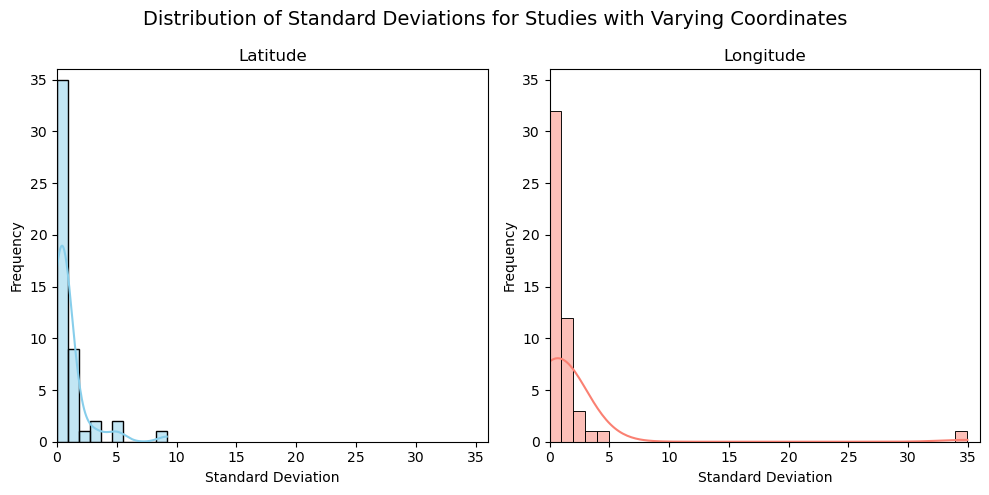

In [ ]:
df = df3

# Extract the Site ID
df['SiteID'] = df['StudyID'].astype(int)

# Group by Site and check uniqueness of Latitude and Longitude
site_coord_uniqueness = df.groupby('SiteID').agg(
    UniqueLats=('Latitude', 'nunique'),
    UniqueLons=('Longitude', 'nunique'),
    Count=('ExperimentID', 'count')
)

# Determine if all coordinates within each site are the same
site_coord_uniqueness['AllCoordsSame'] = (site_coord_uniqueness['UniqueLats'] == 1) & \
                                         (site_coord_uniqueness['UniqueLons'] == 1)

sites_with_differing_coords_df = site_coord_uniqueness[~site_coord_uniqueness['AllCoordsSame']]
num_differing_sites = len(sites_with_differing_coords_df)
print(f"{num_differing_sites} sites where Latitude and/or Longitude are NOT all the same.\n")

# Get the list of Site IDs that have differing coordinates
differing_site_ids = sites_with_differing_coords_df.index.tolist()

# Filter the original DataFrame to include only these differing sites
df_differing_sites = df[df['SiteID'].isin(differing_site_ids)]

# Calculate standard deviation for Latitude and Longitude for these sites
std_dev_differing_sites = df_differing_sites.groupby('SiteID').agg(
    Lat_StdDev=('Latitude', 'std'),
    Lon_StdDev=('Longitude', 'std')
)

report_for_differing_sites = sites_with_differing_coords_df.join(std_dev_differing_sites)
print(report_for_differing_sites[['UniqueLats', 'UniqueLons', 'Count', 'Lat_StdDev', 'Lon_StdDev']])

# Plot Standard Deviations
lat_stds_to_plot = std_dev_differing_sites['Lat_StdDev'].dropna()
lon_stds_to_plot = std_dev_differing_sites['Lon_StdDev'].dropna()

fig, axes = plt.subplots(1, 2, figsize=(10, 5), sharey=False) # sharey can be True if scales are similar
fig.suptitle('Distribution of Standard Deviations for Studies with Varying Coordinates', fontsize=14)

# Plot Latitude Standard Deviation
if not lat_stds_to_plot.empty:
    sns.histplot(lat_stds_to_plot, kde=True, ax=axes[0], bins=10, color='skyblue')
    axes[0].set_title('Latitude')
    axes[0].set_xlabel('Standard Deviation')
    axes[0].set_ylabel('Frequency')
else:
    axes[0].set_title('No valid Latitude Std Devs to plot')
    axes[0].text(0.5, 0.5, 'No data', horizontalalignment='center', verticalalignment='center', transform=axes[0].transAxes)

# Plot Longitude Standard Deviation
if not lon_stds_to_plot.empty:
    sns.histplot(lon_stds_to_plot, kde=True, ax=axes[1], bins=35, color='salmon')
    axes[1].set_title('Longitude')
    axes[1].set_xlabel('Standard Deviation')
    axes[1].set_ylabel('Frequency')
else:
    axes[1].set_title('No valid Longitude Std Devs to plot')
    axes[1].text(0.5, 0.5, 'No data', horizontalalignment='center', verticalalignment='center', transform=axes[1].transAxes)

for ax in axes:
    ax.set_xlim(0, 36)
    ax.set_ylim(0, 36)
    
plt.tight_layout()
plt.savefig(f"output/plots/distribution_of_std_for_studies_with_varying_coordinates.png", dpi=300)
plt.show()

## Pairwise scatter plots for column groups

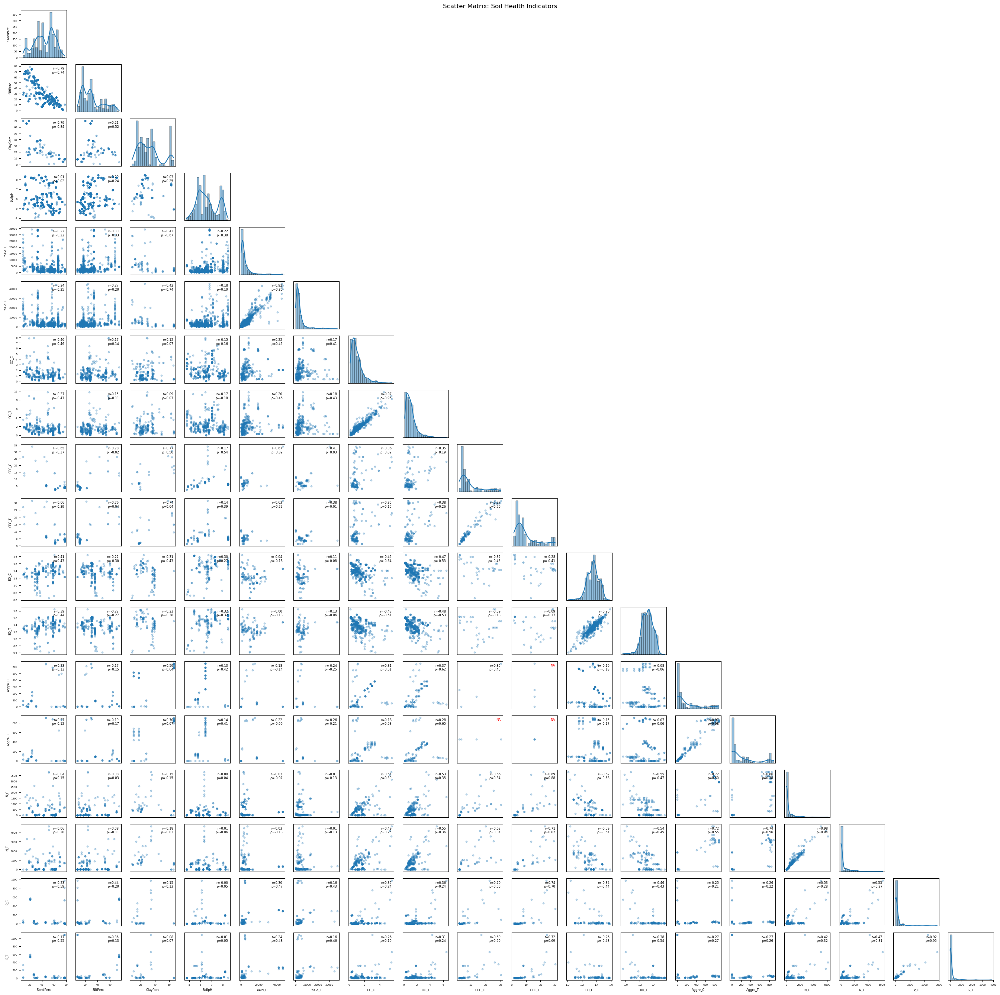

In [ ]:
# Make groups of selected columns
column_groups = {
    "Soil Health Indicators": ['SandPerc', 'SiltPerc', 'ClayPerc', 'SoilpH', 'Yield_C', 'Yield_T', 'OC_C', 'OC_T', 'CEC_C', 'CEC_T', 'BD_C', 'BD_T', 'Aggre_C', 'Aggre_T', 'N_C', 'N_T', 'P_C', 'P_T'],
}

def plot_scatter_matrix(df, column_groups, exclude_columns=None, output_dir='scatter_plot'):
    """
    Generate and save pairwise scatter plot matrices for specified column groups.

    Parameters
    ----------
    df : pd.DataFrame
        The DataFrame containing the data to plot.
    column_groups : dict
        Dictionary where keys are group names and values are lists of column names to include in each group.
    exclude_columns : list or None, optional
        List of column names to exclude from plotting. If None, no columns are excluded.
    output_dir : str, optional
        Directory to save the generated scatter plot SVG files. Default is 'scatter_plots'.

    Functionality
    -------------
    - For each group in column_groups, creates a scatter matrix (all pairwise combinations within the group).
    - For each pair of groups, creates a scatter matrix comparing all columns in group i vs all columns in group j.
    - Histograms are plotted on the diagonal, scatter plots on the lower triangle, and correlation coefficients are annotated.
    - Plots are saved as SVG files in the specified output directory.
    """
    os.makedirs(output_dir, exist_ok=True)

    if exclude_columns:
        df = df.drop(columns=exclude_columns)
    else:
        df = df.copy()

    group_names = list(column_groups.keys())
    n = len(group_names)

    for i in range(n):
        for j in range(i, n):
            name_i = group_names[i]
            name_j = group_names[j]
            subset_i = df[column_groups[name_i]]
            subset_j = df[column_groups[name_j]]

            if i == j:
                cols = subset_i.columns
                fig, axes = plt.subplots(len(cols), len(cols),
                                         figsize=(len(cols) * 1.5, len(cols) * 1.5),
                                         squeeze=False)

                for m, col_i in enumerate(cols):
                    for n_, col_j in enumerate(cols):
                        ax = axes[m, n_]
                        if n_ > m:
                            ax.axis('off')
                            continue
                        elif m == n_:
                            sns.histplot(subset_i[col_i].dropna(), kde=True, ax=ax, bins=20)
                        else:
                            x = subset_i[col_j]
                            y = subset_i[col_i]
                            mask = x.notna() & y.notna()
                            x_clean = x[mask]
                            y_clean = y[mask]
                            ax.scatter(x_clean, y_clean, alpha=0.3, s=10)

                            if x_clean.nunique() > 1 and y_clean.nunique() > 1:
                                pearson_corr = x_clean.corr(y_clean, method='pearson')
                                spearman_corr = x_clean.corr(y_clean, method='spearman')
                                ax.text(0.95, 0.95,
                                        f"r={pearson_corr:.2f}\nρ={spearman_corr:.2f}",
                                        transform=ax.transAxes,
                                        fontsize=6,
                                        va='top', ha='right')
                            else:
                                ax.annotate("NA", xy=(0.85, 0.9), xycoords='axes fraction', fontsize=6, color='red')

                        if m == len(cols) - 1:
                            ax.set_xlabel(col_j, fontsize=6)
                        else:
                            ax.set_xlabel('')
                            ax.set_xticks([])
                        if n_ == 0:
                            ax.set_ylabel(col_i, fontsize=6)
                        else:
                            ax.set_ylabel('')
                            ax.set_yticks([])
                        ax.tick_params(labelsize=5)

                plt.suptitle(f'Scatter Matrix: {name_i}', y=0.99)
                plt.tight_layout()

            else:
                fig, axes = plt.subplots(len(subset_i.columns), len(subset_j.columns),
                                         figsize=(len(subset_j.columns) * 1.5, len(subset_i.columns) * 1.5),
                                         squeeze=False)

                for m, col_i in enumerate(subset_i.columns):
                    for n_, col_j in enumerate(subset_j.columns):
                        ax = axes[m, n_]
                        x = subset_j[col_j]
                        y = subset_i[col_i]
                        mask = x.notna() & y.notna()
                        x_clean = x[mask]
                        y_clean = y[mask]

                        ax.scatter(x_clean, y_clean, alpha=0.3, s=10)

                        if x_clean.nunique() > 1 and y_clean.nunique() > 1:
                            pearson_corr = x_clean.corr(y_clean, method='pearson')
                            spearman_corr = x_clean.corr(y_clean, method='spearman')
                            ax.text(0.95, 0.95,
                                    f"r={pearson_corr:.2f}\nρ={spearman_corr:.2f}",
                                    transform=ax.transAxes,
                                    fontsize=6,
                                    va='top', ha='right')
                        else:
                            ax.annotate("NA", xy=(0.85, 0.9), xycoords='axes fraction', fontsize=6, color='red')

                        if m == len(subset_i.columns) - 1:
                            ax.set_xlabel(col_j, fontsize=6)
                        else:
                            ax.set_xlabel('')
                            ax.set_xticks([])
                        if n_ == 0:
                            ax.set_ylabel(col_i, fontsize=6)
                        else:
                            ax.set_ylabel('')
                            ax.set_yticks([])
                        ax.tick_params(labelsize=5)

                plt.suptitle(f'Scatter Matrix: {name_i} vs {name_j}', y=0.99)
                plt.tight_layout()

            safe_name_i = name_i.replace(" ", "_")
            safe_name_j = name_j.replace(" ", "_")
            save_path = os.path.join(output_dir, f'scatter_{safe_name_i}_vs_{safe_name_j}.svg')
            plt.savefig(save_path, format='svg')
            plt.show()
            plt.close()

plot_scatter_matrix(
    df=df3,
    column_groups=column_groups,
    exclude_columns=None,
    output_dir='output/plots/scatter_plot'
)

## Single column bar plot

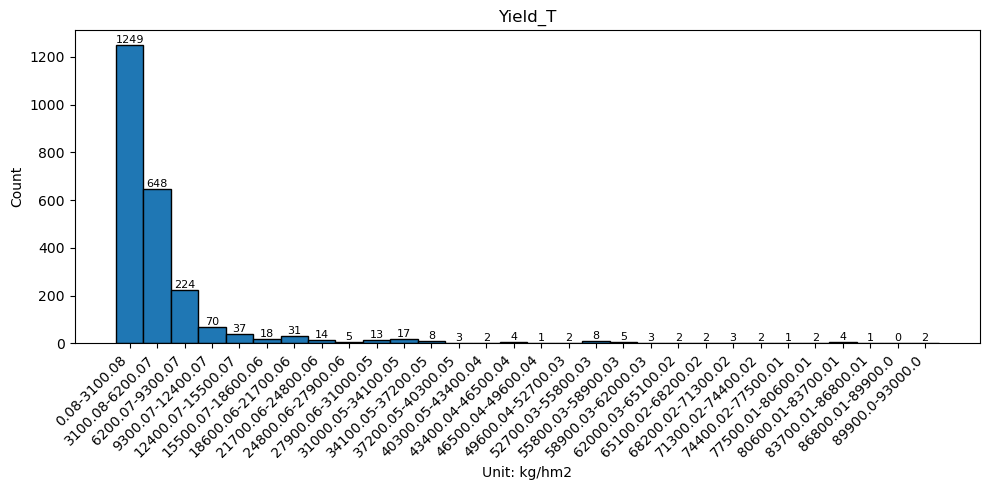

In [ ]:
df = df3
column_name = 'Yield_T'
min_val, max_val = None, None  # Change these as needed

# Helper to retrieve the unit for a column from column_df, searching both Control and Treatment columns
def get_column_info(column_name, column_df):
    try:
        # Check Control
        idx = column_df['Control'].index[column_df['Control'] == column_name]
        if len(idx) > 0:
            unit = column_df.at[idx[0], 'Unit']
            return unit
        # Check Treatment
        idx = column_df['Treatment'].index[column_df['Treatment'] == column_name]
        if len(idx) > 0:
            unit = column_df.at[idx[0], 'Unit']
            return unit
        # Not found
        print(f"Column '{column_name}' not found in Control or Treatment. Please input info manually.")
        unit = input("Enter unit: ")
        return unit
    except Exception as e:
        print(f"Error: {e}")
        unit = input("Enter unit: ")
        return unit

unit = get_column_info(column_name, column_df)

# Drop NA values
values = df[column_name].dropna()

# Use filtered range if specified, else use all values
values_to_plot = values[(values >= min_val) & (values <= max_val)] if min_val is not None and max_val is not None else values

fig, ax = plt.subplots(figsize=(10, 5))
n, bins, patches = ax.hist(values_to_plot, bins=30, edgecolor='black')
for count, x in zip(n, bins):
    ax.text(x + (bins[1] - bins[0]) / 2, count, str(int(count)), ha='center', va='bottom', fontsize=8)
bin_labels = [f"{round(bins[i], 2)}-{round(bins[i+1], 2)}" for i in range(len(bins)-1)]
ax.set_xticks([(bins[i] + bins[i+1]) / 2 for i in range(len(bins)-1)])
ax.set_xticklabels(bin_labels, rotation=45, ha='right')
plt.title(f"{column_name} ({min_val}-{max_val})" if min_val is not None and max_val is not None else column_name)
plt.xlabel(f"Unit: {unit}")
plt.ylabel('Count')
plt.tight_layout()

# Save the figure
os.makedirs("output/plots/column_histogram", exist_ok=True)
if min_val is not None and max_val is not None:
    plt.savefig(f"output/plots/column_histogram/Histogram of {column_name}_range_{min_val}_{max_val}.png", dpi=300)
else:
    plt.savefig(f"output/plots/column_histogram/Histogram of {column_name}.png", dpi=300)

plt.show()

## Single column cumulative density plot

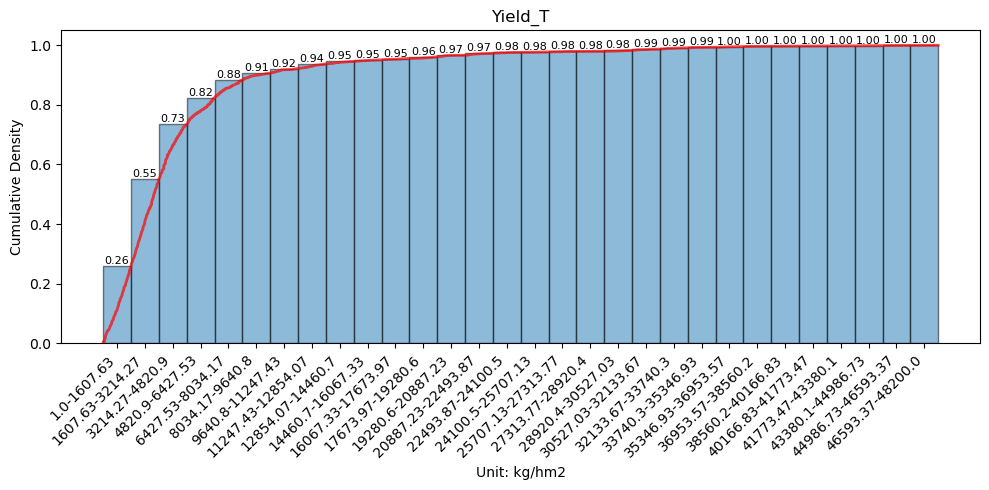

In [ ]:
df = df3
column_name = 'Yield_T'
min_val, max_val = None, None  # Set range as needed

# Helper to retrieve the unit for a column from column_df, searching both Control and Treatment columns
def get_column_info(column_name, column_df):
    try:
        # Check Control
        idx = column_df['Control'].index[column_df['Control'] == column_name]
        if len(idx) > 0:
            unit = column_df.at[idx[0], 'Unit']
            return unit
        # Check Treatment
        idx = column_df['Treatment'].index[column_df['Treatment'] == column_name]
        if len(idx) > 0:
            unit = column_df.at[idx[0], 'Unit']
            return unit
        # Not found
        print(f"Column '{column_name}' not found in Control or Treatment. Please input info manually.")
        unit = input("Enter unit: ")
        return unit
    except Exception as e:
        print(f"Error: {e}")
        unit = input("Enter unit: ")
        return unit

unit = get_column_info(column_name, column_df)

# Drop NA values
values = df[column_name].dropna()

# Use filtered range if specified, else use all values
values_to_plot = values[(values >= min_val) & (values <= max_val)] if min_val is not None and max_val is not None else values

fig, ax = plt.subplots(figsize=(10, 5))
n, bins, patches = ax.hist(values_to_plot, bins=30, edgecolor='black', alpha=0.5, cumulative=True, density=True)
for count, x in zip(n, bins):
    ax.text(x + (bins[1] - bins[0]) / 2, count, f"{count:.2f}", ha='center', va='bottom', fontsize=8)
bin_labels = [f"{round(bins[i], 2)}-{round(bins[i+1], 2)}" for i in range(len(bins)-1)]
ax.set_xticks([(bins[i] + bins[i+1]) / 2 for i in range(len(bins)-1)])
ax.set_xticklabels(bin_labels, rotation=45, ha='right')
plt.title(f"{column_name} ({min_val}-{max_val})" if min_val is not None and max_val is not None else f"{column_name}")
plt.xlabel(f"Unit: {unit}")
plt.ylabel('Cumulative Density')
plt.tight_layout()

# Add cumulative density line
sorted_vals = np.sort(values_to_plot)
cum_density = np.arange(1, len(sorted_vals) + 1) / len(sorted_vals)
ax.plot(sorted_vals, cum_density * max(n), color='red', alpha=0.7, lw=2)  # scale to match bar height

os.makedirs("output/plots/cumulative_density", exist_ok=True)
if min_val is not None and max_val is not None:
    plt.savefig(f"output/plots/cumulative_density/cumulative_density_{column_name}_range_{min_val}_{max_val}.png", dpi=300)
else:
    plt.savefig(f"output/plots/cumulative_density/cumulative_density_{column_name}.png", dpi=300)
plt.show()

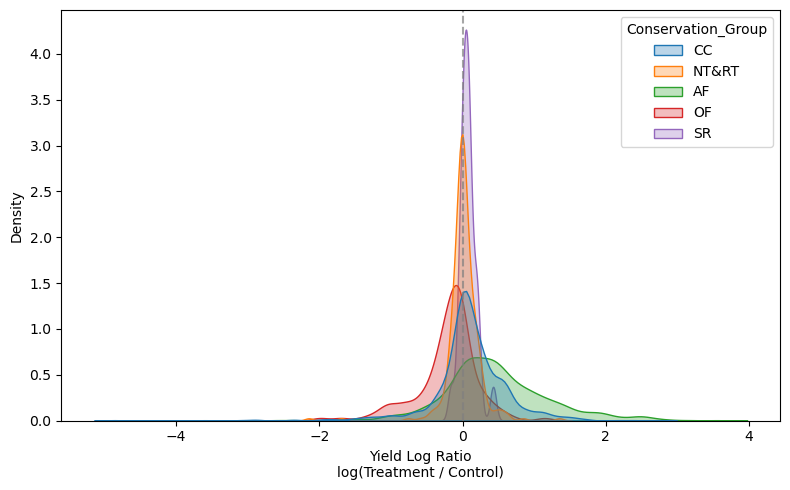

In [70]:
## Density plot of Yield log ratio by Conservation_Group
df = df3
log_ratio_col = 'Yield_log_ratio'
group_col = 'Conservation_Group'

plt.figure(figsize=(8, 5))
sns.kdeplot(
    data=df.dropna(subset=[log_ratio_col, group_col]),
    x=log_ratio_col,
    hue=group_col,
    fill=True,
    common_norm=False,
    alpha=0.3,
    bw_adjust=0.7
)
plt.axvline(0, color='gray', linestyle='--', alpha=0.7)
plt.xlabel('Yield Log Ratio\nlog(Treatment / Control)')
plt.ylabel('Density')
plt.tight_layout()
plt.savefig("output/plots/Yield_log_ratio_density_by_Conservation_Group.png", dpi=300)
plt.show()

# Modelling

In [170]:
def soil_health_prediction_models(df, predictors, target_train, target_test, fig_legend):
    """
    Run regression models for soil health metrics prediction.
    
    Parameters:
        df (pd.DataFrame): DataFrame containing data.
        predictors (list): List of predictor column names.
        target_train (str): Column name for training target.
        target_test (str): Column name for test target.
        fig_legend (str): Column name for coloring/legend in plots.

    Example usage:
        soil_health_prediction_models(df3, ['SandPerc', 'SiltPerc', 'ClayPerc', 'OC_C', 'Conservation_Type'], 'CEC_C', 'CEC_T', 'Conservation_Type')
    """

    # Prepare data
    cat_cols = [col for col in predictors if pd.api.types.is_object_dtype(df[col]) or isinstance(df[col].dtype, CategoricalDtype)] # Detect categorical columns
    use_cv = target_train == target_test # Use cross-validation if training and test targets are the same

    def get_X_y(df, predictors, target, cat_cols):
        data = df[predictors + [target]].dropna()
        X = pd.get_dummies(data[predictors], columns=cat_cols, dtype=int) if cat_cols else data[predictors] # One-hot encode if there are categorical variables
        y = data[target]
        return X, y

    if use_cv:
        X, y = get_X_y(df, predictors, target_train, cat_cols)
        X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2, random_state=42)
        kf = KFold(n_splits=5, shuffle=True, random_state=42) # 5-fold cross-validation
        print("Random split (80/20) and 5-fold cross-validation used.\n")
    else:
        X_train, y_train = get_X_y(df, predictors, target_train, cat_cols)
        X_test, y_test = get_X_y(df, predictors, target_test, cat_cols)
        kf = None
        print("Separate train/test sets used.\n")
        
    print("Predictors:", *predictors)
    if use_cv: print("Dataset Shape:", X.shape)
    print("Train set:", target_train, "| Shape:", X_train.shape)
    print("Test set:", target_test, "| Shape:", X_test.shape)

    # Prepare colors for legend
    if target_train == target_test:
        fig_legend_series = df.loc[X.index, fig_legend]
    else:
        fig_legend_series = df.loc[X_test.index, fig_legend]
    fig_legend_uniques = pd.unique(fig_legend_series)
    cmap = plt.get_cmap('turbo')
    rng = np.random.default_rng(seed=42)
    color_indices = rng.permutation(len(fig_legend_uniques))
    color_map = {sid: cmap(idx / max(len(fig_legend_uniques)-1, 1)) for sid, idx in zip(fig_legend_uniques, color_indices)}
    colors = [color_map[sid] for sid in fig_legend_series]

    # Helper for plotting predicted vs actual
    def plot_pred_vs_actual(y_true, y_pred, colors, color_map, fig_legend, fig_legend_uniques, title):
        plt.figure(figsize=(6, 4))
        plt.scatter(y_true, y_pred, c=colors, alpha=0.8)
        handles = [mpatches.Patch(color=color_map[sid], label=str(sid)) for sid in fig_legend_uniques]
        plt.legend(handles=handles, title=fig_legend, bbox_to_anchor=(1.05, 1), loc='upper left', borderaxespad=0., fontsize=8)
        min_val = min(y_true.min(), y_pred.min())
        max_val = max(y_true.max(), y_pred.max())
        plt.plot([min_val, max_val], [min_val, max_val], color='gray', linestyle='-', alpha=0.5)
        if target_train is not None and 'ratio' in str(target_train).lower():  # Add dotted lines at x=1 and y=1 if input ratio
            plt.axvline(1, color='gray', linestyle=':', linewidth=1)
            plt.axhline(1, color='gray', linestyle=':', linewidth=1)
        plt.xlabel("Actual")
        plt.ylabel("Predicted")
        plt.title(title)
        plt.show()

    # Helper function to compute and plot coefficients
    def plot_coefficients(model, feature_names, title="Model Coefficients", xlabel="Coefficients"):
        coefficients = model.coef_
        x = np.arange(len(feature_names))
        if min(coefficients) >= 0:
            xlim_min = 0
        else:
            xlim_min = min(coefficients) * 1.1
        plt.figure(figsize=(6, 4))
        plt.xlim(xlim_min, max(coefficients) * 1.1)
        plt.barh(x, coefficients, color='skyblue')
        plt.yticks(x, feature_names)
        plt.xlabel(xlabel)
        plt.title(title)
        plt.grid(True, axis='x', linestyle='--', alpha=0.5)
        for i, val in enumerate(coefficients):
            plt.text(val + 0.005, i, f"{val:.3f}", va='center', fontsize=8)
        plt.tight_layout()
        plt.show()

    # Helper function to compute and plot cross-validated coefficients
    def plot_cv_coefficients(model, X, y, kf, feature_names=None, title="Cross-Validated Coefficients", xlabel="Coefficients"):
        coefs = []
        for train_idx, test_idx in kf.split(X):
            model = model.fit(X.iloc[train_idx], y.iloc[train_idx])
            coefs.append(model.coef_)
        coefficients = np.array(coefs)
        coef_means = coefficients.mean(axis=0)
        coef_stds = coefficients.std(axis=0)
        if feature_names is None:
            feature_names = X.columns if hasattr(X, "columns") else [f"X{i}" for i in range(X.shape[1])]

        plt.figure(figsize=(6, 4))
        x = np.arange(len(feature_names))
        xlim_min = min(coef_means - coef_stds) * 1.1 if np.min(coef_means - coef_stds) < 0 else 0
        plt.errorbar(coef_means, x, xerr=coef_stds, fmt='o', ecolor='gray', capsize=5)
        plt.xlim(xlim_min, max(coef_means + coef_stds) * 1.3)
        for i, (mean, std) in enumerate(zip(coef_means, coef_stds)):
            plt.text(mean + std + 0.005, i, f"{mean:.3f}±{std:.3f}", va='center', fontsize=8)
        plt.yticks(x, feature_names)
        plt.xlabel(xlabel)
        plt.title(title)
        plt.grid(True, axis='x', linestyle='--', alpha=0.5)
        plt.tight_layout()
        plt.show()

    # Helper function to compute and plot permutation importances
    def plot_perm_imp(model, X, y, title=None, n_repeats=10, random_state=42, xlabel="Permutation Importance"):
        importances = permutation_importance(model, X, y, n_repeats=n_repeats, random_state=random_state).importances_mean
        plt.figure(figsize=(6, 4))
        x = np.arange(len(X.columns))
        plt.xlim(0, max(importances) * 1.1)
        plt.barh(x, importances, color='skyblue')
        plt.yticks(x, list(X.columns))
        plt.xlabel(xlabel)
        plt.title(title or "Permutation Importances")
        plt.grid(True, axis='x', linestyle='--', alpha=0.5)
        for i, val in enumerate(importances):
            plt.text(val + 0.005, i, f"{val:.3f}", va='center', fontsize=8)
        plt.tight_layout()
        plt.show()
        return importances
    
    # Helper function to compute and plot cross-validated permutation importances
    def plot_cv_perm_imp(estimator, X, y, cv, scoring='r2', n_repeats=10, random_state=42, feature_names=None, title=None):
        if feature_names is None:
            feature_names = X.columns if hasattr(X, 'columns') else [f"X{i}" for i in range(X.shape[1])]
        importances_list = []
        for train_idx, test_idx in cv.split(X, y):
            X_train, X_test = X.iloc[train_idx], X.iloc[test_idx]
            y_train, y_test = y.iloc[train_idx], y.iloc[test_idx]
            est = estimator.__class__(**estimator.get_params())
            est.fit(X_train, y_train)
            result = permutation_importance(
                est, X_test, y_test, n_repeats=n_repeats, random_state=random_state, scoring=scoring
            )
            importances_list.append(result.importances_mean)
        importances_array = np.array(importances_list)
        mean_importances = importances_array.mean(axis=0)
        std_importances = importances_array.std(axis=0)

        # Plot
        plt.figure(figsize=(6, 4))
        x = np.arange(len(feature_names))
        plt.xlim(0, max(mean_importances+std_importances) * 1.25)
        plt.errorbar(mean_importances, x, xerr=std_importances, fmt='o', ecolor='gray', capsize=5)
        plt.yticks(x, feature_names)
        plt.xlabel(f"Permutation Importance (mean ± std)")
        plt.title(title or "Cross-Validated Permutation Importances")
        plt.grid(True, axis='x', linestyle='--', alpha=0.5)
        for i, (mean, std) in enumerate(zip(mean_importances, std_importances)):
            plt.text(mean + std + 0.005, i, f"{mean:.3f}±{std:.3f}", va='center', fontsize=8)
        plt.tight_layout()
        plt.show()
        return mean_importances, std_importances
    
    # Helper function to plot SHAP summary beeswarm plot
    def plot_shap_summary(model, X, max_display=20, plot_type="dot"):
        try:
            explainer = shap.Explainer(model, X)
            shap_values = explainer(X)
        except TypeError:
            explainer = shap.KernelExplainer(model.predict, X)
            shap_values = explainer.shap_values(X, nsamples=100, silent=True)
        shap.summary_plot(shap_values, X, max_display=max_display, plot_type=plot_type)
        plt.show()

    ## Multi Linear Regression
    print("\nMulti Linear Regression\n")
    lr_model = LinearRegression()

    if kf is None:
        lr_model = lr_model.fit(X_train, y_train)
        lr_y_pred = lr_model.predict(X_test)
        print("MAE:", round(mean_absolute_error(y_test, lr_y_pred), 3))
        print("RMSE:", round(np.sqrt(mean_squared_error(y_test, lr_y_pred)), 3))
        print("R²:", round(r2_score(y_test, lr_y_pred), 3))
        plot_pred_vs_actual(y_test, lr_y_pred, colors, color_map, fig_legend, fig_legend_uniques, f"Multiple Linear Regression - {target_test}")
        plot_coefficients(lr_model, X_test.columns, title=f"Multiple Linear Regression Coefficients - {target_test}")
        plot_perm_imp(lr_model, X_test, y_test, title=f"Multiple Linear Regression Permutation Importances - {target_test}")
        plot_shap_summary(lr_model, X_test, plot_type="dot")
        
    if kf is not None:
        lr_mae_scores = cross_val_score(lr_model, X, y, scoring='neg_mean_absolute_error', cv=kf)
        lr_rmse_scores = cross_val_score(lr_model, X, y, scoring='neg_root_mean_squared_error', cv=kf)
        lr_r2_scores = cross_val_score(lr_model, X, y, scoring='r2', cv=kf)
        print("Cross-validated MAE (mean ± std):", round(-lr_mae_scores.mean(), 3), "±", round(-lr_rmse_scores.std(), 3))
        print("Cross-validated RMSE (mean ± std):", round(-lr_rmse_scores.mean(), 3), "±", round(-lr_rmse_scores.std(), 3))
        print("Cross-validated R² (mean ± std):", round(lr_r2_scores.mean(), 3), "±", round(lr_r2_scores.std(), 3))
        lr_y_pred_cv = cross_val_predict(lr_model, X, y, cv=kf)
        plot_pred_vs_actual(y, lr_y_pred_cv, colors, color_map, fig_legend, fig_legend_uniques, f"Multiple Linear Regression - {target_test}")
        plot_cv_coefficients(lr_model, X, y, kf, feature_names=X.columns, title=f"Multiple Linear Regression Coefficients - {target_test}")
        plot_cv_perm_imp(lr_model, X, y, kf, feature_names=X.columns, title=f"Multiple Linear Regression Permutation Importances - {target_test}")
        plot_shap_summary(lr_model.fit(X, y), X, plot_type="dot")

    ## Ridge Regression
    print("\nRidge Regression\n")
    ridge_model = Ridge(alpha=1.0)

    if kf is None:
        ridge_model = ridge_model.fit(X_train, y_train)
        ridge_y_pred = ridge_model.predict(X_test)
        print("MAE:", round(mean_absolute_error(y_test, ridge_y_pred), 3))
        print("RMSE:", round(np.sqrt(mean_squared_error(y_test, ridge_y_pred)), 3))
        print("R²:", round(r2_score(y_test, ridge_y_pred), 3))
        plot_pred_vs_actual(y_test, ridge_y_pred, colors, color_map, fig_legend, fig_legend_uniques, f"Ridge Regression - {target_test}")
        plot_coefficients(ridge_model, X_test.columns, title=f"Ridge Regression Coefficients - {target_test}")
        plot_perm_imp(ridge_model, X_test, y_test, title=f"Ridge Regression Permutation Importances - {target_test}")
        plot_shap_summary(ridge_model, X_test, plot_type="dot")

    if kf is not None:
        ridge_mae_scores = cross_val_score(ridge_model, X, y, scoring='neg_mean_absolute_error', cv=kf)
        ridge_rmse_scores = cross_val_score(ridge_model, X, y, scoring='neg_root_mean_squared_error', cv=kf)
        ridge_r2_scores = cross_val_score(ridge_model, X, y, scoring='r2', cv=kf)
        print("Cross-validated MAE (mean ± std):", round(-ridge_mae_scores.mean(), 3), "±", round(-ridge_rmse_scores.std(), 3))
        print("Cross-validated RMSE (mean ± std):", round(-ridge_rmse_scores.mean(), 3), "±", round(-ridge_rmse_scores.std(), 3))
        print("Cross-validated R² (mean ± std):", round(ridge_r2_scores.mean(), 3), "±", round(ridge_r2_scores.std(), 3))
        ridge_y_pred_cv = cross_val_predict(ridge_model, X, y, cv=kf)
        plot_pred_vs_actual(y, ridge_y_pred_cv, colors, color_map, fig_legend, fig_legend_uniques, f"Ridge Regression - {target_test}")
        plot_cv_coefficients(ridge_model, X, y, kf, feature_names=X.columns, title=f"Ridge Regression Coefficients - {target_test}")
        plot_cv_perm_imp(ridge_model, X, y, kf, feature_names=X.columns, title=f"Ridge Regression Permutation Importances - {target_test}")
        plot_shap_summary(ridge_model.fit(X, y), X, plot_type="dot")

    ## Support Vector Regression
    print("\nSupport Vector Regression\n")
    svr_model = SVR(kernel='rbf', C=50, epsilon=0.1)
    
    if kf is None:    
        scaler = StandardScaler() # Scale features for SVR
        X_train_scaled = scaler.fit_transform(X_train)
        X_test_scaled = scaler.transform(X_test)
        X_train_scaled = pd.DataFrame(X_train_scaled, columns=X_train.columns, index=X_train.index) # Convert back to DataFrame to keep column names and .iloc
        X_test_scaled = pd.DataFrame(X_test_scaled, columns=X_test.columns, index=X_test.index)
        svr_model = svr_model.fit(X_train_scaled, y_train)
        svr_y_pred = svr_model.predict(X_test_scaled)
        print("MAE:", round(mean_absolute_error(y_test, svr_y_pred), 3))
        print("RMSE:", round(np.sqrt(mean_squared_error(y_test, svr_y_pred)), 3))
        print("R²:", round(r2_score(y_test, svr_y_pred), 3))
        plot_pred_vs_actual(y_test, svr_y_pred, colors, color_map, fig_legend, fig_legend_uniques, f"Support Vector Regression - {target_test}")
        plot_perm_imp(svr_model, X_test_scaled, y_test, f"SVR Permutation Importances - {target_test}")
        plot_shap_summary(svr_model, X_test_scaled, plot_type="dot")

    if kf is not None:
        scaler = StandardScaler() # Scale features for SVR
        X_scaled = scaler.fit_transform(X)
        X_scaled = pd.DataFrame(X_scaled, columns=X.columns, index=X.index) # Convert back to DataFrame to keep column names and .iloc
        svr_y_pred_cv = cross_val_predict(svr_model, X_scaled, y, cv=kf)
        svr_mae_scores = cross_val_score(svr_model, X_scaled, y, scoring='neg_mean_absolute_error', cv=kf)
        svr_rmse_scores = cross_val_score(svr_model, X_scaled, y, scoring='neg_root_mean_squared_error', cv=kf)
        svr_r2_scores = cross_val_score(svr_model, X_scaled, y, scoring='r2', cv=kf)
        print("Cross-validated MAE (mean ± std):", round(-svr_mae_scores.mean(), 3), "±", round(-svr_mae_scores.std(), 3))
        print("Cross-validated RMSE (mean ± std):", round(-svr_rmse_scores.mean(), 3), "±", round(-svr_rmse_scores.std(), 3))
        print("Cross-validated R² (mean ± std):", round(svr_r2_scores.mean(), 3), "±", round(svr_r2_scores.std(), 3))
        plot_pred_vs_actual(y, svr_y_pred_cv, colors, color_map, fig_legend, fig_legend_uniques, f"Support Vector Regression - {target_test}")
        plot_cv_perm_imp(svr_model, X_scaled, y, cv=kf, scoring='r2', n_repeats=10, feature_names=X.columns, title="SVR Permutation Importances")
        plot_shap_summary(svr_model.fit(X_scaled, y), X_scaled, plot_type="dot")

    ## KNN Regression
    print("\nKNN Regression\n")
    knn_model = KNeighborsRegressor(n_neighbors=5, weights='distance')

    if kf is None:
        knn_model = knn_model.fit(X_train, y_train)
        knn_y_pred = knn_model.predict(X_test)
        print("MAE:", round(mean_absolute_error(y_test, knn_y_pred), 3))
        print("RMSE:", round(np.sqrt(mean_squared_error(y_test, knn_y_pred)), 3))
        print("R²:", round(r2_score(y_test, knn_y_pred), 3))
        plot_pred_vs_actual(y_test, knn_y_pred, colors, color_map, fig_legend, fig_legend_uniques, f"KNN Regression - {target_test}")
        plot_perm_imp(knn_model, X_test, y_test, f"KNN Permutation Importances - {target_test}")
        plot_shap_summary(knn_model, X_test, plot_type="dot")

    if kf is not None:
        knn_y_pred_cv = cross_val_predict(knn_model, X, y, cv=kf)
        knn_mae_scores = cross_val_score(knn_model, X, y, scoring='neg_mean_absolute_error', cv=kf)
        knn_rmse_scores = cross_val_score(knn_model, X, y, scoring='neg_root_mean_squared_error', cv=kf)
        knn_r2_scores = cross_val_score(knn_model, X, y, scoring='r2', cv=kf)
        print("Cross-validated MAE (mean ± std):", round(-knn_mae_scores.mean(), 3), "±", round(-knn_rmse_scores.std(), 3))
        print("Cross-validated RMSE (mean ± std):", round(-knn_rmse_scores.mean(), 3), "±", round(-knn_rmse_scores.std(), 3))
        print("Cross-validated R² (mean ± std):", round(knn_r2_scores.mean(), 3), "±", round(knn_r2_scores.std(), 3))
        plot_pred_vs_actual(y, knn_y_pred_cv, colors, color_map, fig_legend, fig_legend_uniques, f"KNN Regression - {target_test}")
        plot_cv_perm_imp(knn_model, X, y, cv=kf, scoring='r2', n_repeats=10, feature_names=X.columns, title="KNN Permutation Importances")
        plot_shap_summary(knn_model.fit(X, y), X, plot_type="dot")

    ## Decision Tree Regression
    print("\nDecision Tree Regression\n")
    dt_model = DecisionTreeRegressor(max_depth=6, random_state=42)

    if kf is None:
        dt_model = dt_model.fit(X_train, y_train)
        dt_y_pred = dt_model.predict(X_test)
        print("MAE:", round(mean_absolute_error(y_test, dt_y_pred), 3))
        print("RMSE:", round(np.sqrt(mean_squared_error(y_test, dt_y_pred)), 3))
        print("R²:", round(r2_score(y_test, dt_y_pred), 3))
        plot_pred_vs_actual(y_test, dt_y_pred, colors, color_map, fig_legend, fig_legend_uniques, f"Decision Tree Regression - {target_test}")
        plot_perm_imp(dt_model, X_test, y_test, f"Decision Tree Permutation Importances - {target_test}")
        plot_shap_summary(dt_model, X_test, plot_type="dot")

    if kf is not None:
        dt_y_pred_cv = cross_val_predict(dt_model, X, y, cv=kf)
        dt_mae_scores = cross_val_score(dt_model, X, y, scoring='neg_mean_absolute_error', cv=kf)
        dt_rmse_scores = cross_val_score(dt_model, X, y, scoring='neg_root_mean_squared_error', cv=kf)
        dt_r2_scores = cross_val_score(dt_model, X, y, scoring='r2', cv=kf)
        print("Cross-validated MAE (mean ± std):", round(-dt_mae_scores.mean(), 3), "±", round(-dt_rmse_scores.std(), 3))
        print("Cross-validated RMSE (mean ± std):", round(-dt_rmse_scores.mean(), 3), "±", round(-dt_rmse_scores.std(), 3))
        print("Cross-validated R² (mean ± std):", round(dt_r2_scores.mean(), 3), "±", round(dt_r2_scores.std(), 3))
        plot_pred_vs_actual(y, dt_y_pred_cv, colors, color_map, fig_legend, fig_legend_uniques, f"Decision Tree Regression - {target_test}")
        plot_cv_perm_imp(dt_model, X, y, cv=kf, scoring='r2', n_repeats=10, feature_names=X.columns, title="Decision Tree Permutation Importances")
        plot_shap_summary(dt_model.fit(X, y), X, plot_type="dot")

    ## Random Forest Regression
    print("\nRandom Forest Regression\n")
    rf_model = RandomForestRegressor(n_estimators=100, max_depth=6, random_state=42)
    
    if kf is None:
        rf_model = rf_model.fit(X_train, y_train)
        rf_y_pred = rf_model.predict(X_test)
        print("MAE:", round(mean_absolute_error(y_test, rf_y_pred), 3))
        print("RMSE:", round(np.sqrt(mean_squared_error(y_test, rf_y_pred)), 3))
        print("R²:", round(r2_score(y_test, rf_y_pred), 3))
        plot_pred_vs_actual(y_test, rf_y_pred, colors, color_map, fig_legend, fig_legend_uniques, f"Random Forest Regression - {target_test}")
        plot_perm_imp(rf_model, X_test, y_test, f"Random Forest Permutation Importances - {target_test}")
        plot_shap_summary(rf_model, X_test, plot_type="dot")

    if kf is not None:
        rf_y_pred_cv = cross_val_predict(rf_model, X, y, cv=kf)
        rf_mae_scores = cross_val_score(rf_model, X, y, scoring='neg_mean_absolute_error', cv=kf)
        rf_rmse_scores = cross_val_score(rf_model, X, y, scoring='neg_root_mean_squared_error', cv=kf)
        rf_r2_scores = cross_val_score(rf_model, X, y, scoring='r2', cv=kf)
        print("Cross-validated MAE (mean ± std):", round(-rf_mae_scores.mean(), 3), "±", round(-rf_rmse_scores.std(), 3))
        print("Cross-validated RMSE (mean ± std):", round(-rf_rmse_scores.mean(), 3), "±", round(-rf_rmse_scores.std(), 3))
        print("Cross-validated R² (mean ± std):", round(rf_r2_scores.mean(), 3), "±", round(rf_r2_scores.std(), 3))
        plot_pred_vs_actual(y, rf_y_pred_cv, colors, color_map, fig_legend, fig_legend_uniques, f"Random Forest Regression - {target_test}")
        plot_cv_perm_imp(rf_model, X, y, cv=kf, scoring='r2', n_repeats=10, feature_names=X.columns, title="Random Forest Permutation Importances")
        plot_shap_summary(rf_model.fit(X, y), X, plot_type="dot")

    ## XGBoost Random Forest Regression
    print("\nXGBoost Random Forest Regression\n")
    xgb_rf_model = xgb.XGBRegressor(
        n_estimators=100, max_depth=6, subsample=0.8, colsample_bynode=0.8,
        num_parallel_tree=100, # enables random forest mode
        tree_method='hist', booster='gbtree',
        random_state=42, objective='reg:squarederror'
    )

    if kf is None:
        xgb_rf_model = xgb_rf_model.fit(X_train, y_train)
        xgb_rf_y_pred = xgb_rf_model.predict(X_test)
        print("MAE:", round(mean_absolute_error(y_test, xgb_rf_y_pred), 3))
        print("RMSE:", round(np.sqrt(mean_squared_error(y_test, xgb_rf_y_pred)), 3))
        print("R²:", round(r2_score(y_test, xgb_rf_y_pred), 3))
        plot_pred_vs_actual(y_test, xgb_rf_y_pred, colors, color_map, fig_legend, fig_legend_uniques, f"XGBoost Random Forest Regression - {target_test}")
        plot_perm_imp(xgb_rf_model, X_test, y_test, f"XGBoost RF Permutation Importances - {target_test}")
        print("* SHAP does not support XGBoost random forest mode (num_parallel_tree > 1). Skipping SHAP plot.")

    if kf is not None:
        xgb_rf_y_pred_cv = cross_val_predict(xgb_rf_model, X, y, cv=kf)
        xgb_rf_mae_scores = cross_val_score(xgb_rf_model, X, y, scoring='neg_mean_absolute_error', cv=kf)
        xgb_rf_rmse_scores = cross_val_score(xgb_rf_model, X, y, scoring='neg_root_mean_squared_error', cv=kf)
        xgb_rf_r2_scores = cross_val_score(xgb_rf_model, X, y, scoring='r2', cv=kf)
        print("Cross-validated MAE (mean ± std):", round(-xgb_rf_mae_scores.mean(), 3), "±", round(-xgb_rf_rmse_scores.std(), 3))
        print("Cross-validated RMSE (mean ± std):", round(-xgb_rf_rmse_scores.mean(), 3), "±", round(-xgb_rf_rmse_scores.std(), 3))
        print("Cross-validated R² (mean ± std):", round(xgb_rf_r2_scores.mean(), 3), "±", round(xgb_rf_r2_scores.std(), 3))
        plot_pred_vs_actual(y, xgb_rf_y_pred_cv, colors, color_map, fig_legend, fig_legend_uniques, f"XGBoost Random Forest Regression - {target_test}")
        plot_cv_perm_imp(xgb_rf_model, X, y, cv=kf, scoring='r2', n_repeats=10, feature_names=X.columns, title="XGBoost RF Permutation Importances")
        print("* SHAP does not support XGBoost random forest mode (num_parallel_tree > 1). Skipping SHAP plot.")

    ## XGBoost Regression
    print("\nXGBoost Regression\n")
    xgb_model = xgb.XGBRegressor(
        n_estimators=100, max_depth=6, subsample=0.8, colsample_bynode=0.8,
        tree_method='hist', booster='gbtree', random_state=42, objective='reg:squarederror'
    )

    if kf is None:
        xgb_model = xgb_model.fit(X_train, y_train)
        xgb_y_pred = xgb_model.predict(X_test)
        print("MAE:", round(mean_absolute_error(y_test, xgb_y_pred), 3))
        print("RMSE:", round(np.sqrt(mean_squared_error(y_test, xgb_y_pred)), 3))
        print("R²:", round(r2_score(y_test, xgb_y_pred), 3))
        plot_pred_vs_actual(y_test, xgb_y_pred, colors, color_map, fig_legend, fig_legend_uniques, f"XGBoost Regression - {target_test}")
        plot_perm_imp(xgb_model, X_test, y_test, f"XGBoost Permutation Importances - {target_test}")
        plot_shap_summary(xgb_model, X_test, plot_type="dot")
    
    if kf is not None:
        xgb_y_pred_cv = cross_val_predict(xgb_model, X, y, cv=kf)
        xgb_mae_scores = cross_val_score(xgb_model, X, y, scoring='neg_mean_absolute_error', cv=kf)
        xgb_rmse_scores = cross_val_score(xgb_model, X, y, scoring='neg_root_mean_squared_error', cv=kf)
        xgb_r2_scores = cross_val_score(xgb_model, X, y, scoring='r2', cv=kf)
        print("Cross-validated MAE (mean ± std):", round(-xgb_mae_scores.mean(), 3), "±", round(-xgb_rmse_scores.std(), 3))
        print("Cross-validated RMSE (mean ± std):", round(-xgb_rmse_scores.mean(), 3), "±", round(-xgb_rmse_scores.std(), 3))
        print("Cross-validated R² (mean ± std):", round(xgb_r2_scores.mean(), 3), "±", round(xgb_r2_scores.std(), 3))
        plot_pred_vs_actual(y, xgb_y_pred_cv, colors, color_map, fig_legend, fig_legend_uniques, f"XGBoost Regression - {target_test}")
        plot_cv_perm_imp(xgb_model, X, y, cv=kf, scoring='r2', n_repeats=10, feature_names=X.columns, title="XGBoost Permutation Importances")
        plot_shap_summary(xgb_model.fit(X, y), X, plot_type="dot")
    
    ## Generalized Additive Model
    print("\nGeneralized Additive Model\n")
    gam_splines = reduce(lambda a, b: a + b, [s(i) for i in range(len(predictors))])
    gam = LinearGAM(gam_splines)
    
    if kf is None:
        gam = gam.fit(X_train, y_train)
        gam_y_pred = gam.predict(X_test)
        print("MAE:", round(mean_absolute_error(y_test, gam_y_pred), 3))
        print("RMSE:", round(np.sqrt(mean_squared_error(y_test, gam_y_pred)), 3))
        print("R²:", round(r2_score(y_test, gam_y_pred), 3))
        plot_pred_vs_actual(y_test, gam_y_pred, colors, color_map, fig_legend, fig_legend_uniques, f"GAM Regression - {target_test}")
        plot_perm_imp(gam, X_test, y_test, f"GAM Permutation Importances - {target_test}")
        plot_shap_summary(gam, X_test, plot_type="dot")

        # Partial dependence plots for each term
        plt.figure(figsize=(10, 6))
        plt.suptitle(f"Partial Dependence - {target_test}")
        for i, term in enumerate(gam.terms):
            if term.isintercept:
                continue
            XX = gam.generate_X_grid(term=i)
            pd_values = gam.partial_dependence(term=i, X=XX)
            plt.subplot(2, int(np.ceil(len(predictors)/2)), i+1) # Combine into 2xN grid
            plt.plot(XX[:, i], pd_values)
            plt.gca().yaxis.set_major_formatter(plt.FuncFormatter(lambda x, _: f"{x:.1f}"))
            plt.xlim(XX[:, i].min()*0.9, XX[:, i].max()*1.1)
            plt.ylim(pd_values.min()*1.1, pd_values.max()*1.1)
            plt.title(f'{X_train.columns[i]}')
        plt.tight_layout()
        plt.show()

    if kf is not None:
        y_true_cv = []
        y_pred_cv = []
        mae_scores = []
        rmse_scores = []
        r2_scores = []
        for train_idx, test_idx in kf.split(X):
            gam.fit(X.iloc[train_idx], y.iloc[train_idx])
            preds = gam.predict(X.iloc[test_idx])
            y_pred_cv.extend(preds)
            y_true_cv.extend(y.iloc[test_idx])
            mae_scores.append(mean_absolute_error(y.iloc[test_idx], preds))
            rmse_scores.append(np.sqrt(mean_squared_error(y.iloc[test_idx], preds)))
            r2_scores.append(r2_score(y.iloc[test_idx], preds))
        gam_mae_scores = np.array(mae_scores)
        gam_rmse_scores = np.array(rmse_scores)
        gam_r2_scores = np.array(r2_scores)
        print("Cross-validated MAE (mean ± std):", round(gam_mae_scores.mean(), 3), "±", round(gam_mae_scores.std(), 3))
        print("Cross-validated RMSE (mean ± std):", round(gam_rmse_scores.mean(), 3), "±", round(gam_rmse_scores.std(), 3))
        print("Cross-validated R² (mean ± std):", round(gam_r2_scores.mean(), 3), "±", round(gam_r2_scores.std(), 3))
        plot_pred_vs_actual(np.array(y_true_cv), np.array(y_pred_cv), colors, color_map, fig_legend, fig_legend_uniques, f"GAM Regression - {target_test}")
        plot_cv_perm_imp(gam, X, y, cv=kf, scoring='r2', n_repeats=10, feature_names=X.columns, title="GAM Permutation Importances")
        plot_shap_summary(gam.fit(X, y), X, plot_type="dot")

        # Partial dependence plots for each term
        feature_terms = [i for i, term in enumerate(gam.terms) if not term.isintercept]
        partial_dependence_curves = {i: [] for i in feature_terms}
        for train_idx, test_idx in kf.split(X):
            gam = LinearGAM(gam_splines)
            gam.fit(X.iloc[train_idx], y.iloc[train_idx])
            for i in feature_terms:
                XX = gam.generate_X_grid(term=i, n=100)
                pd_values = gam.partial_dependence(term=i, X=XX)
                partial_dependence_curves[i].append(pd_values)
        nrows, ncols = 3, 2
        fig, axes = plt.subplots(nrows, ncols, figsize=(12, 10)) # Combine into 3x2 grid
        plt.suptitle(f"Cross-Validated Partial Dependence - {target_test}")
        axes = axes.flatten()
        for idx, i in enumerate(feature_terms):  # Iterate over feature terms
            pd_array = np.vstack(partial_dependence_curves[i])
            mean_pd = pd_array.mean(axis=0)
            std_pd = pd_array.std(axis=0)
            XX = gam.generate_X_grid(term=i, n=100)
            ax = axes[idx]
            ax.plot(XX[:, i], mean_pd, label='Mean Partial Dependence')
            ax.fill_between(XX[:, i], mean_pd - std_pd, mean_pd + std_pd, alpha=0.3, label='±1 std')
            ax.set_xlabel(X.columns[i if hasattr(X, 'columns') else i])
            ax.set_ylabel('Partial Dependence')
            ax.legend(fontsize=8)
        for j in range(idx + 1, nrows * ncols):
            fig.delaxes(axes[j]) # Hide unused subplots if any
        plt.tight_layout()
        plt.show()
        

    ## Result as table
    print("Predictors:", *predictors)
    if use_cv: print("Dataset Shape:", X.shape)
    print("Train set:", target_train, "| Dataset Shape:", X_train.shape)
    print("Test set:", target_test, "| Dataset Shape:", X_test.shape)

    model_names = [
        "Multi Linear Regression", "Ridge Regression", "Support Vector Regression",
        "KNN Regression", "Decision Tree Regression", "Random Forest Regression",
        "XGBoost Random Forest Regression", "XGBoost Regression", "Generalized Additive Model"
    ]

    if kf is None:
        preds = [
            lr_y_pred, ridge_y_pred, svr_y_pred, knn_y_pred, dt_y_pred,
            rf_y_pred, xgb_rf_y_pred, xgb_y_pred, gam_y_pred
        ]
        results = [
            {
                "Model": name,
                "MAE": round(mean_absolute_error(y_test, pred), 3),
                "RMSE": round(np.sqrt(mean_squared_error(y_test, pred)), 3),
                "R²": round(r2_score(y_test, pred), 3)
            }
            for name, pred in zip(model_names, preds)
        ]
        results_df = pd.DataFrame(results)
        print(results_df)

    if kf is not None:
        cv_metrics = [
            (lr_mae_scores, lr_rmse_scores, lr_r2_scores),
            (ridge_mae_scores, ridge_rmse_scores, ridge_r2_scores),
            (svr_mae_scores, svr_rmse_scores, svr_r2_scores),
            (knn_mae_scores, knn_rmse_scores, knn_r2_scores),
            (dt_mae_scores, dt_rmse_scores, dt_r2_scores),
            (rf_mae_scores, rf_rmse_scores, rf_r2_scores),
            (xgb_rf_mae_scores, xgb_rf_rmse_scores, xgb_rf_r2_scores),
            (xgb_mae_scores, xgb_rmse_scores, xgb_r2_scores),
            (gam_mae_scores, gam_rmse_scores, gam_r2_scores)
        ]
        results = [
            {
                "Model": name,
                "Cross-validated MAE (mean ± std)": f"{-mae.mean():.3f} ± {-mae.std():.3f}",
                "Cross-validated RMSE (mean ± std)": f"{-rmse.mean():.3f} ± {-rmse.std():.3f}",
                "Cross-validated R² (mean ± std)": f"{r2.mean():.3f} ± {r2.std():.3f}"
            }
            for name, (mae, rmse, r2) in zip(model_names, cv_metrics)
        ]
        results_df = pd.DataFrame(results)
        print(results_df)

## Train Control Test Control

### CEC

Random split (80/20) and 5-fold cross-validation used.

Predictors: SandPerc_imputed SiltPerc_imputed ClayPerc_imputed SoilpH OC_C
Dataset Shape: (93, 5)
Train set: CEC_C | Shape: (74, 5)
Test set: CEC_C | Shape: (19, 5)

Multi Linear Regression

Cross-validated MAE (mean ± std): 1.821 ± -0.442
Cross-validated RMSE (mean ± std): 2.397 ± -0.442
Cross-validated R² (mean ± std): 0.473 ± 0.591


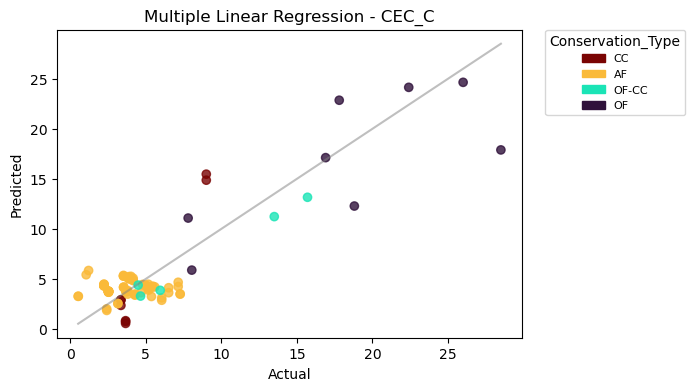

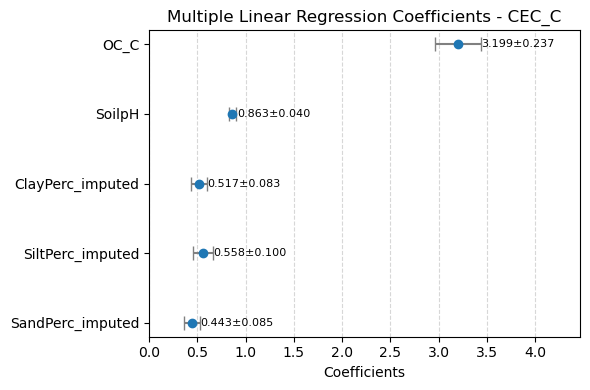

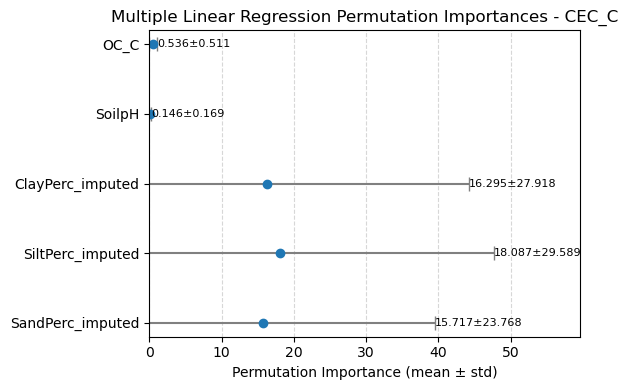

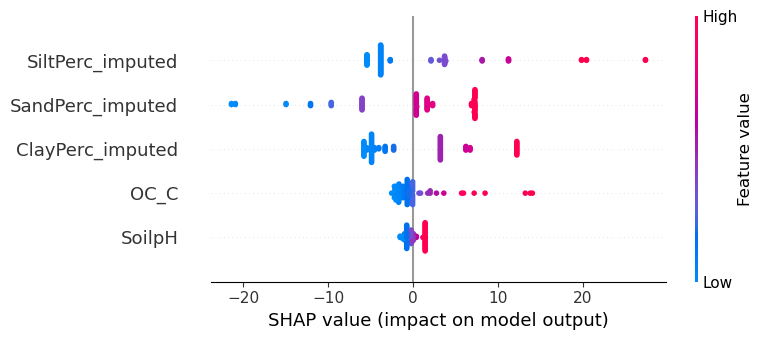


Ridge Regression

Cross-validated MAE (mean ± std): 1.81 ± -0.437
Cross-validated RMSE (mean ± std): 2.4 ± -0.437
Cross-validated R² (mean ± std): 0.472 ± 0.593


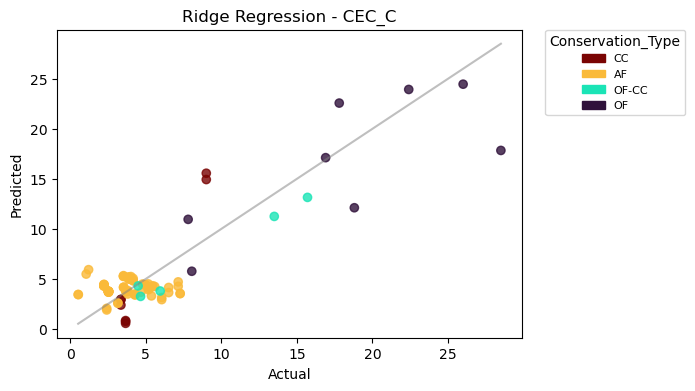

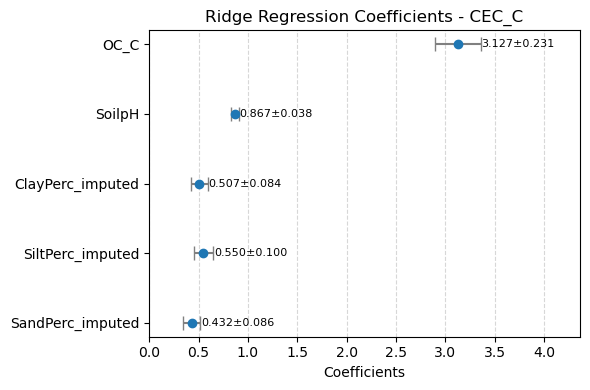

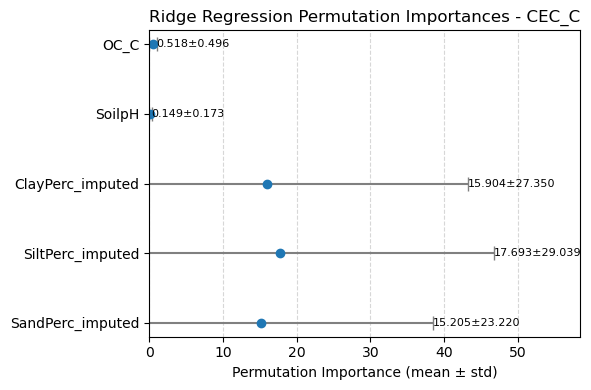

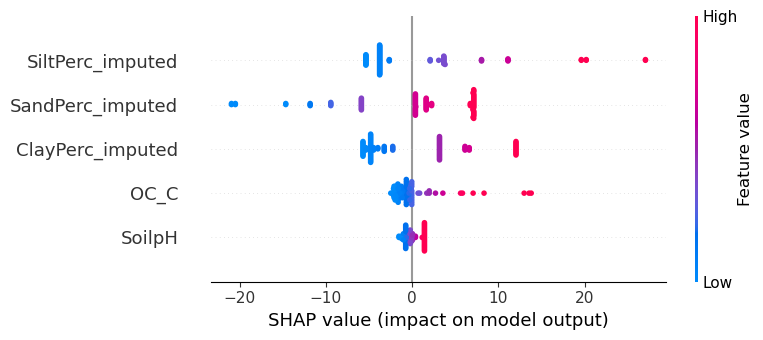


Support Vector Regression

Cross-validated MAE (mean ± std): 0.887 ± -0.429
Cross-validated RMSE (mean ± std): 1.957 ± -1.03
Cross-validated R² (mean ± std): 0.826 ± 0.085


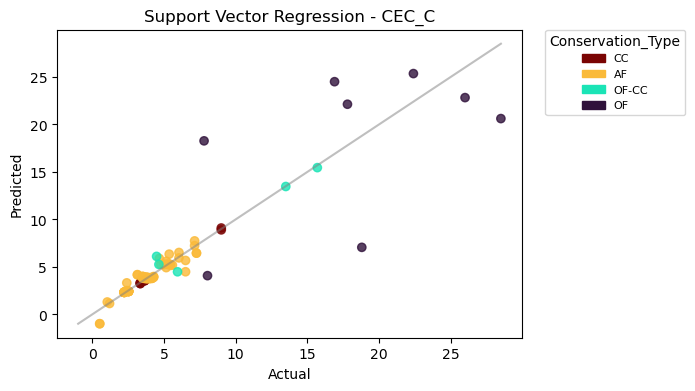

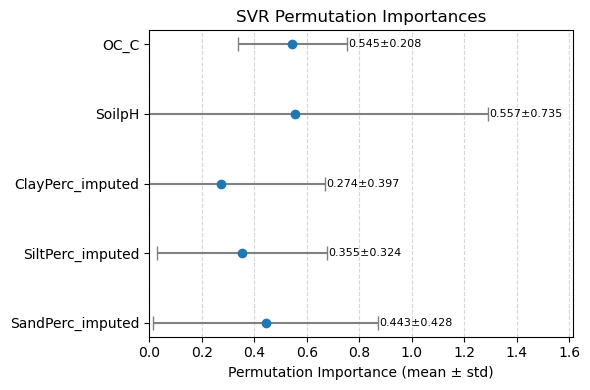

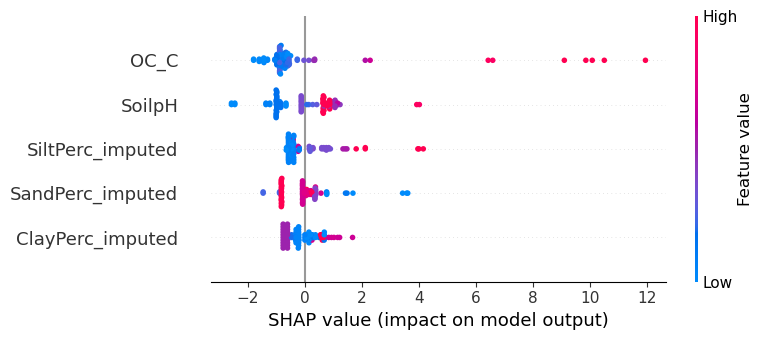


KNN Regression

Cross-validated MAE (mean ± std): 0.766 ± -0.981
Cross-validated RMSE (mean ± std): 2.072 ± -0.981
Cross-validated R² (mean ± std): 0.808 ± 0.096


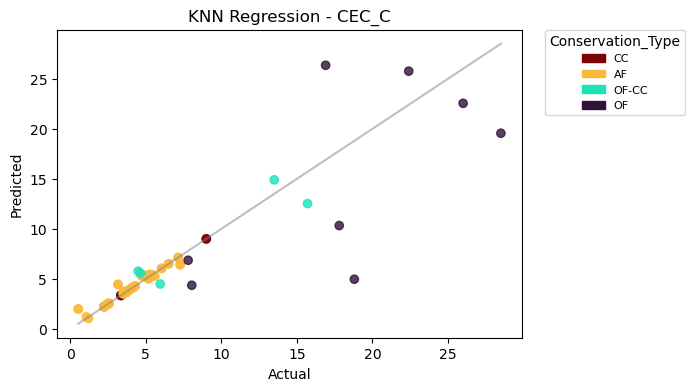

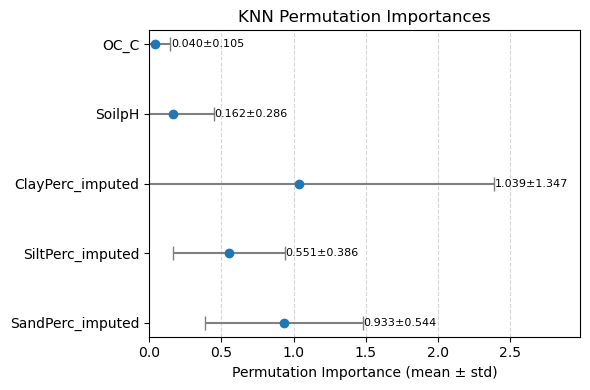

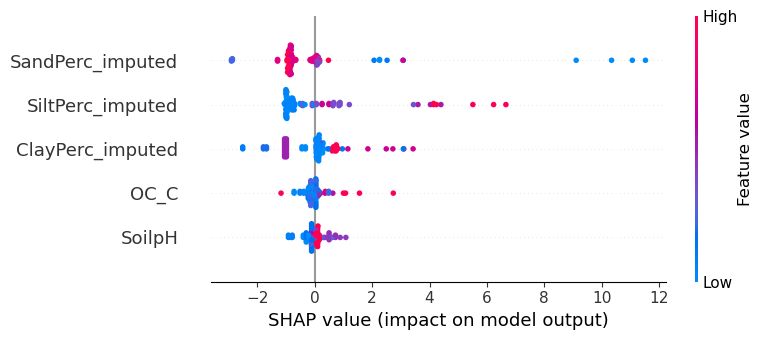


Decision Tree Regression

Cross-validated MAE (mean ± std): 0.884 ± -1.193
Cross-validated RMSE (mean ± std): 2.05 ± -1.193
Cross-validated R² (mean ± std): 0.806 ± 0.139


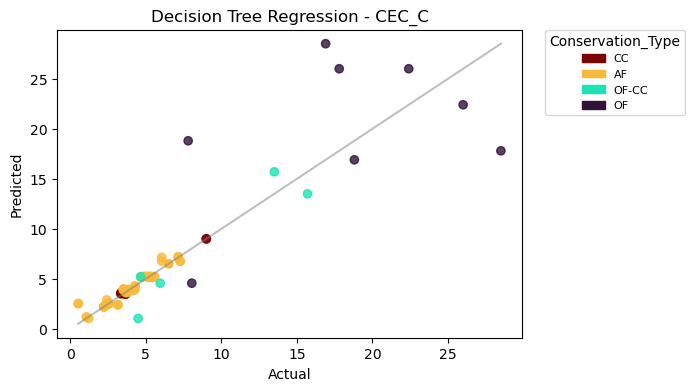

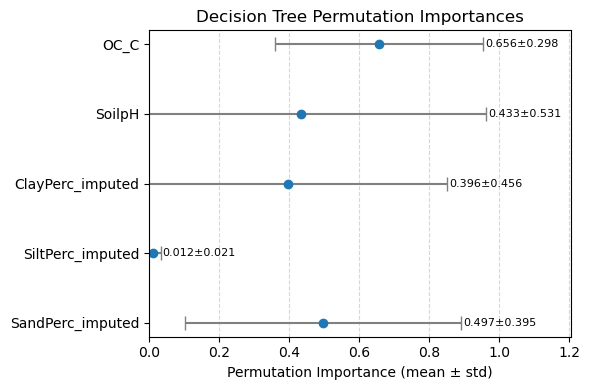

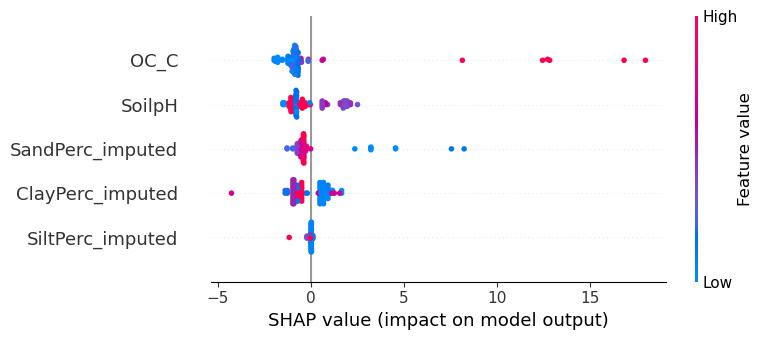


Random Forest Regression

Cross-validated MAE (mean ± std): 0.859 ± -0.775
Cross-validated RMSE (mean ± std): 1.782 ± -0.775
Cross-validated R² (mean ± std): 0.848 ± 0.051


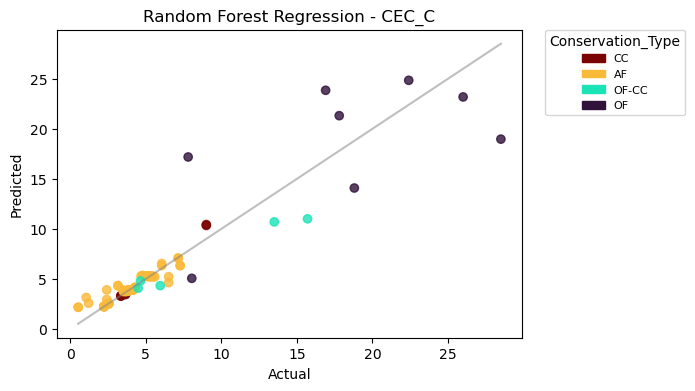

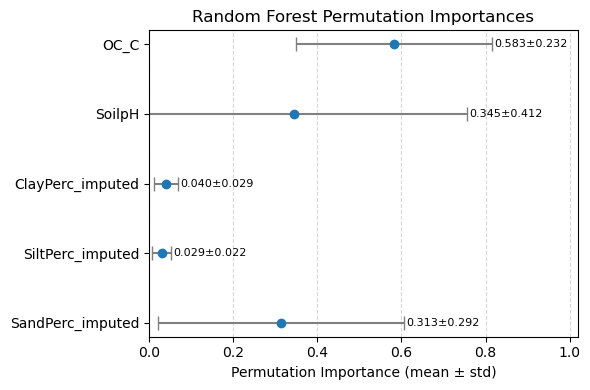

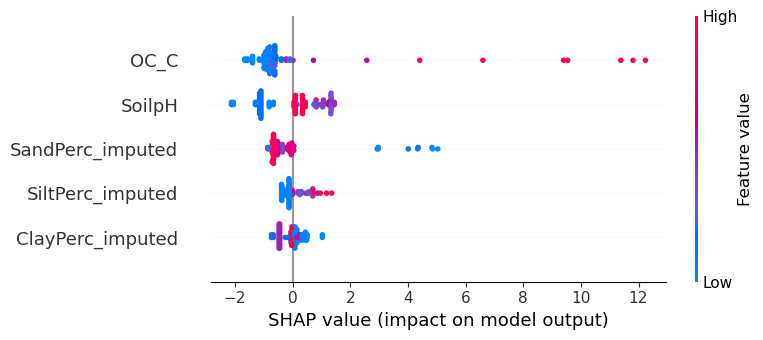


XGBoost Random Forest Regression

Cross-validated MAE (mean ± std): 0.783 ± -0.649
Cross-validated RMSE (mean ± std): 2.067 ± -0.649
Cross-validated R² (mean ± std): 0.768 ± 0.093


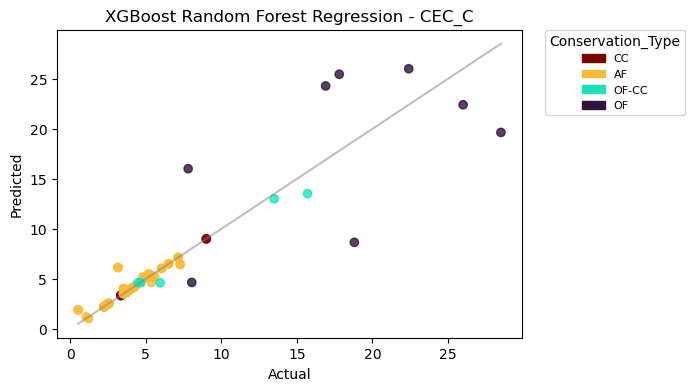

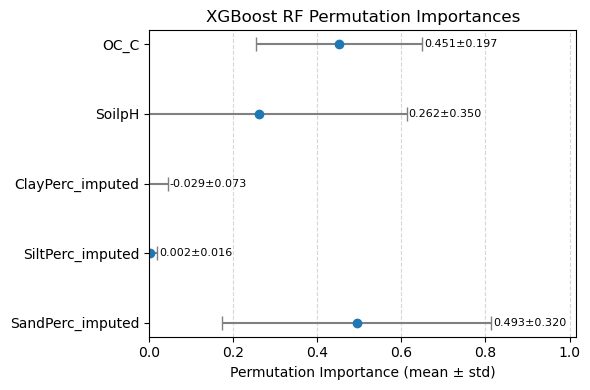

* SHAP does not support XGBoost random forest mode (num_parallel_tree > 1). Skipping SHAP plot.

XGBoost Regression

Cross-validated MAE (mean ± std): 0.906 ± -1.078
Cross-validated RMSE (mean ± std): 2.387 ± -1.078
Cross-validated R² (mean ± std): 0.718 ± 0.108


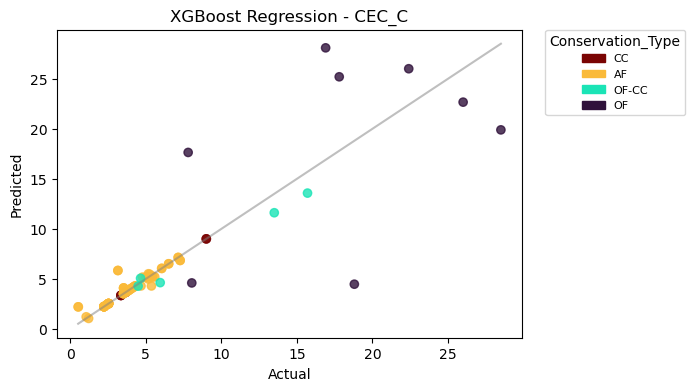

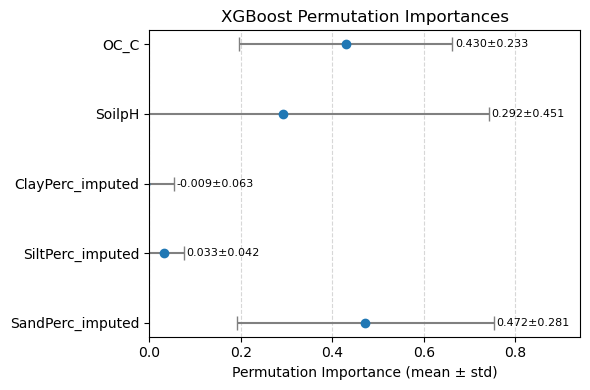

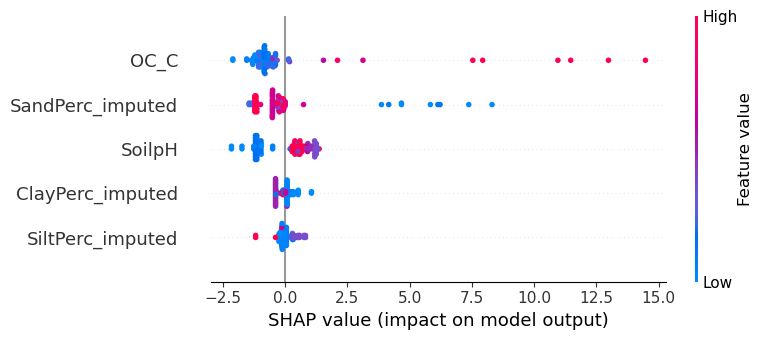


Generalized Additive Model

Cross-validated MAE (mean ± std): 0.924 ± 0.266
Cross-validated RMSE (mean ± std): 1.743 ± 0.688
Cross-validated R² (mean ± std): 0.861 ± 0.02


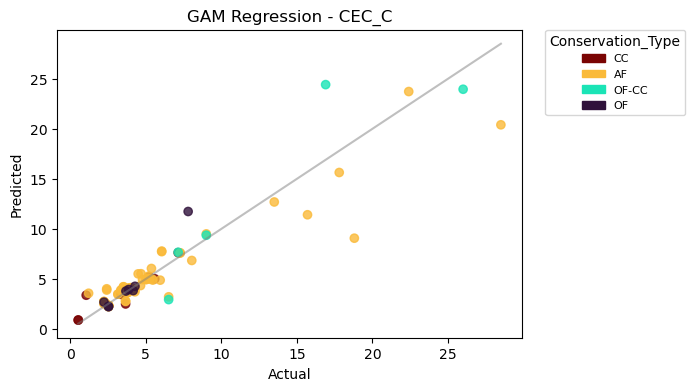

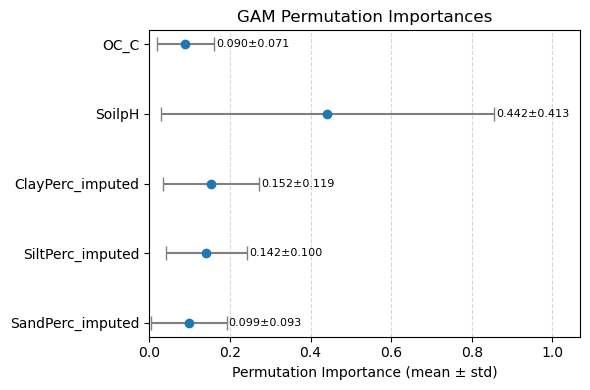

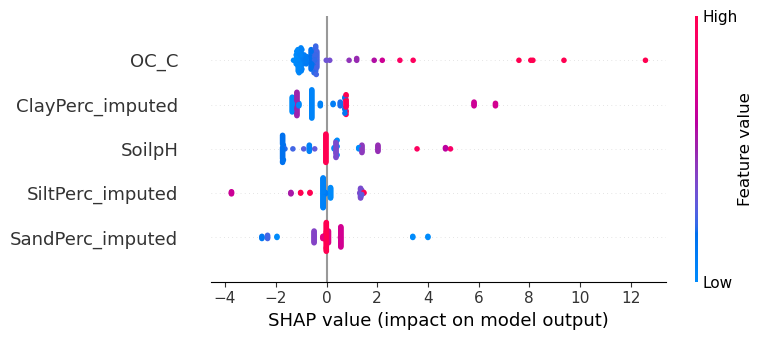

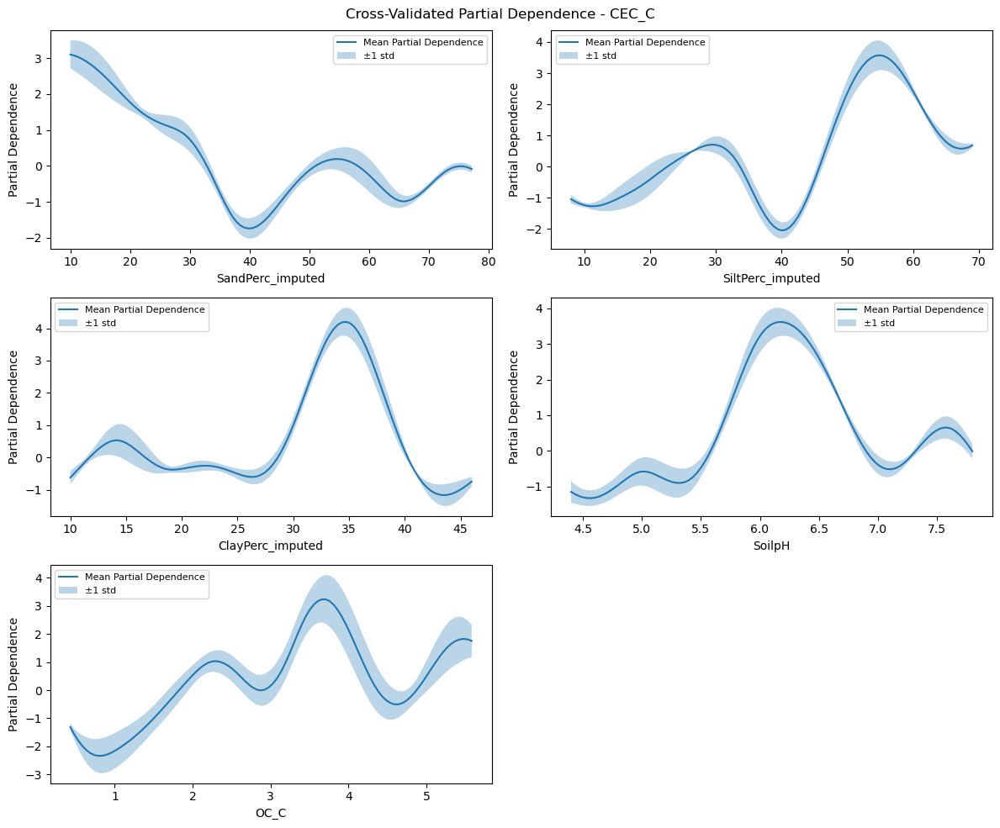

Predictors: SandPerc_imputed SiltPerc_imputed ClayPerc_imputed SoilpH OC_C
Dataset Shape: (93, 5)
Train set: CEC_C | Dataset Shape: (74, 5)
Test set: CEC_C | Dataset Shape: (19, 5)
                              Model Cross-validated MAE (mean ± std)  \
0           Multi Linear Regression                   1.821 ± -0.355   
1                  Ridge Regression                   1.810 ± -0.352   
2         Support Vector Regression                   0.887 ± -0.429   
3                    KNN Regression                   0.766 ± -0.388   
4          Decision Tree Regression                   0.884 ± -0.505   
5          Random Forest Regression                   0.859 ± -0.342   
6  XGBoost Random Forest Regression                   0.783 ± -0.343   
7                XGBoost Regression                   0.906 ± -0.496   
8        Generalized Additive Model                  -0.924 ± -0.266   

  Cross-validated RMSE (mean ± std) Cross-validated R² (mean ± std)  
0                    2.397 ±

In [171]:
soil_health_prediction_models(df3, ['SandPerc_imputed', 'SiltPerc_imputed', 'ClayPerc_imputed', 'SoilpH', 'OC_C'], 'CEC_C', 'CEC_C', 'Conservation_Type')

### BD

Random split (80/20) and 5-fold cross-validation used.

Predictors: SandPerc_imputed SiltPerc_imputed ClayPerc_imputed OC_C
Dataset Shape: (503, 4)
Train set: BD_C | Shape: (402, 4)
Test set: BD_C | Shape: (101, 4)

Multi Linear Regression

Cross-validated MAE (mean ± std): 0.098 ± -0.011
Cross-validated RMSE (mean ± std): 0.133 ± -0.011
Cross-validated R² (mean ± std): 0.31 ± 0.093


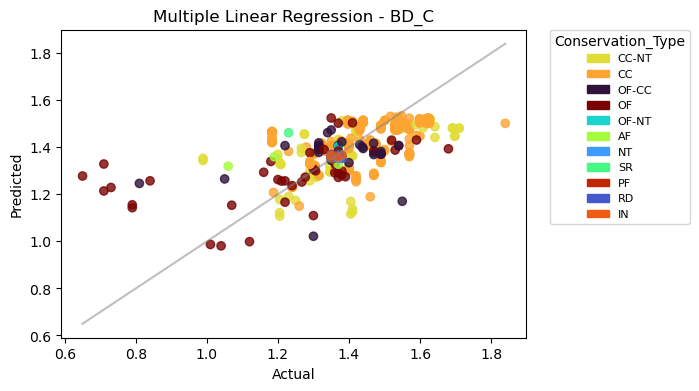

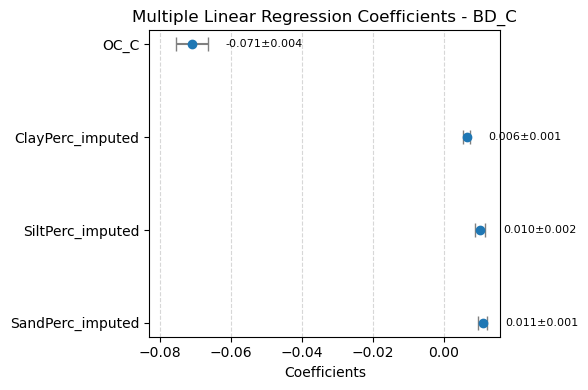

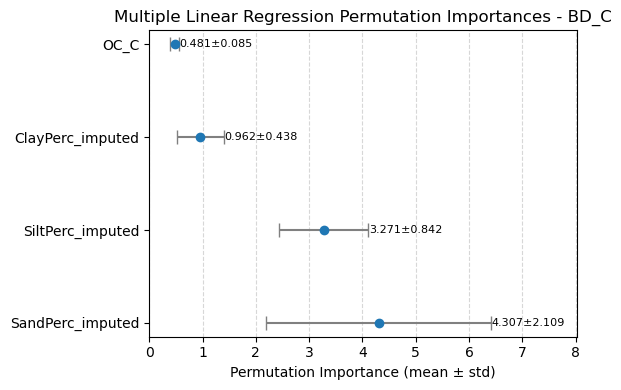

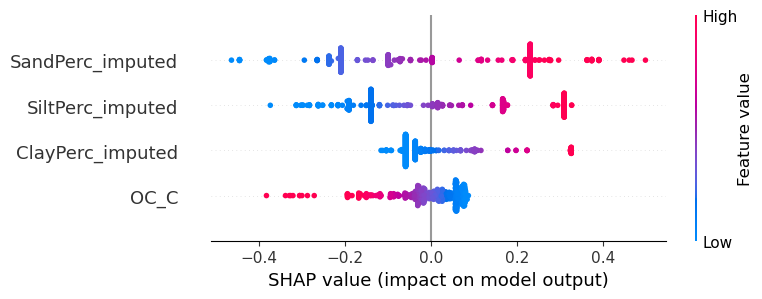


Ridge Regression

Cross-validated MAE (mean ± std): 0.098 ± -0.011
Cross-validated RMSE (mean ± std): 0.133 ± -0.011
Cross-validated R² (mean ± std): 0.31 ± 0.093


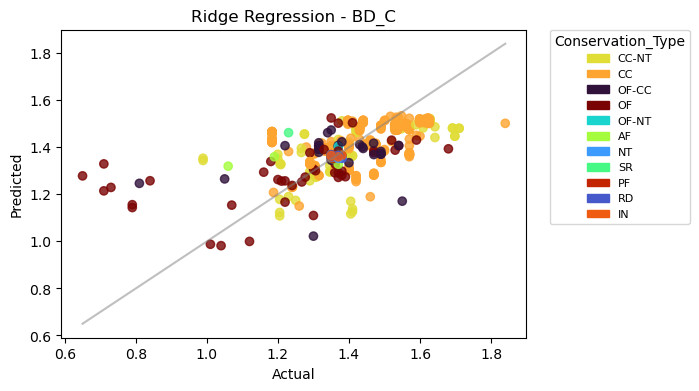

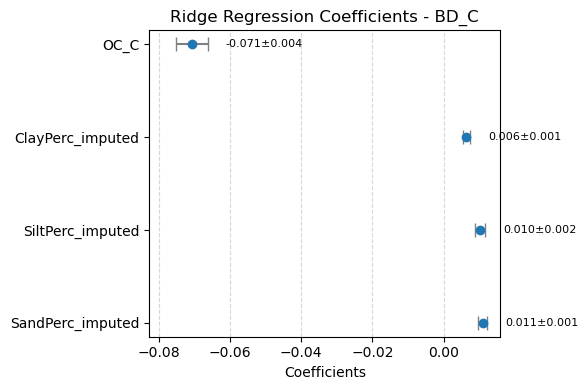

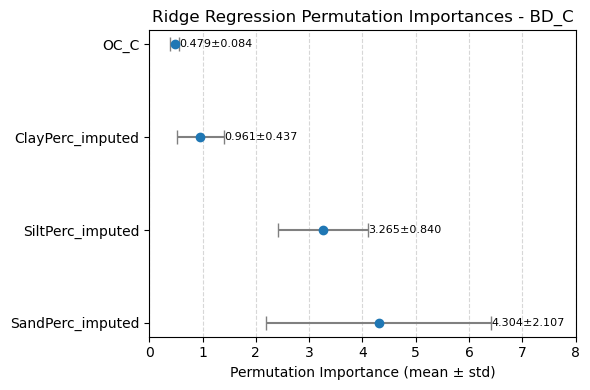

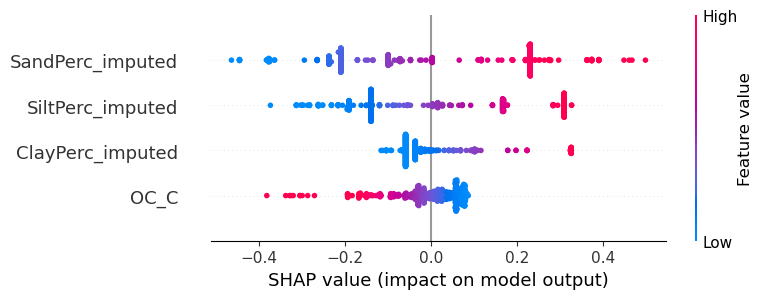


Support Vector Regression

Cross-validated MAE (mean ± std): 0.087 ± -0.008
Cross-validated RMSE (mean ± std): 0.122 ± -0.027
Cross-validated R² (mean ± std): 0.392 ± 0.299


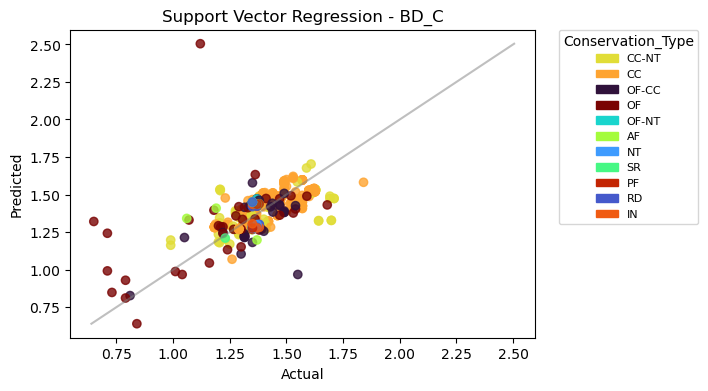

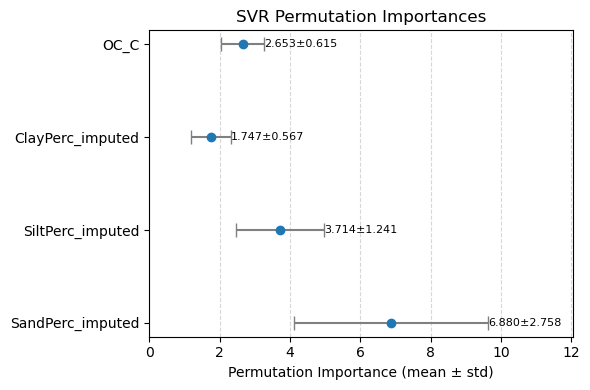

Using 503 background data samples could cause slower run times. Consider using shap.sample(data, K) or shap.kmeans(data, K) to summarize the background as K samples.


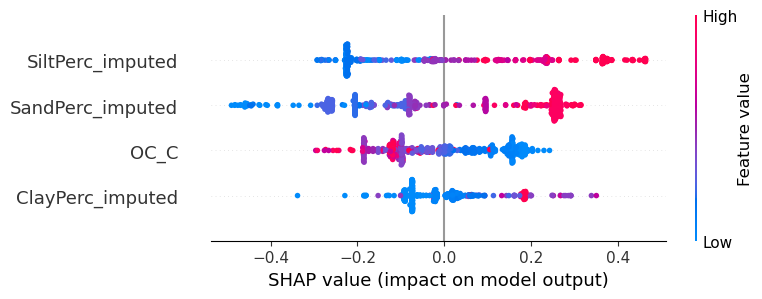


KNN Regression

Cross-validated MAE (mean ± std): 0.031 ± -0.02
Cross-validated RMSE (mean ± std): 0.088 ± -0.02
Cross-validated R² (mean ± std): 0.7 ± 0.099


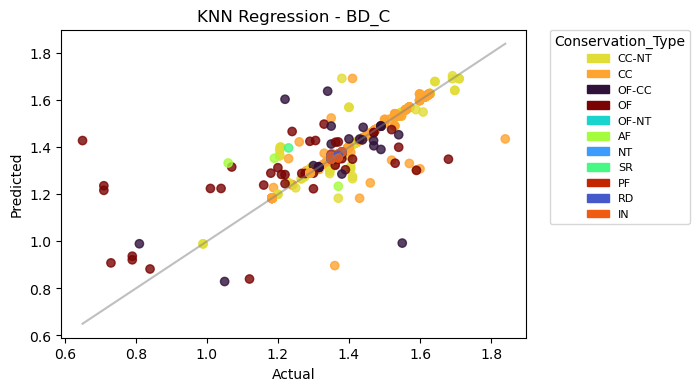

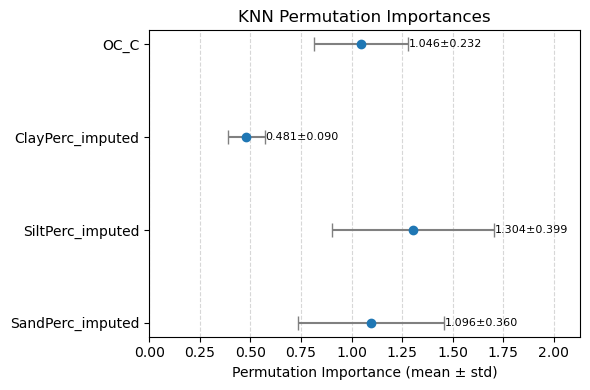

Using 503 background data samples could cause slower run times. Consider using shap.sample(data, K) or shap.kmeans(data, K) to summarize the background as K samples.


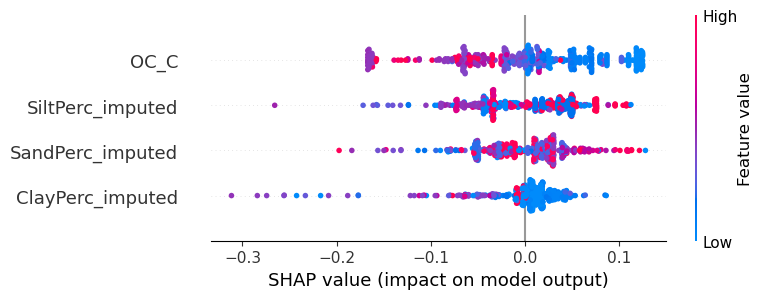


Decision Tree Regression

Cross-validated MAE (mean ± std): 0.053 ± -0.021
Cross-validated RMSE (mean ± std): 0.099 ± -0.021
Cross-validated R² (mean ± std): 0.619 ± 0.111


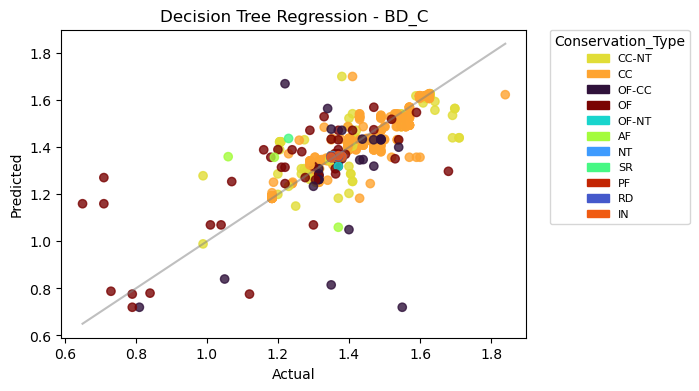

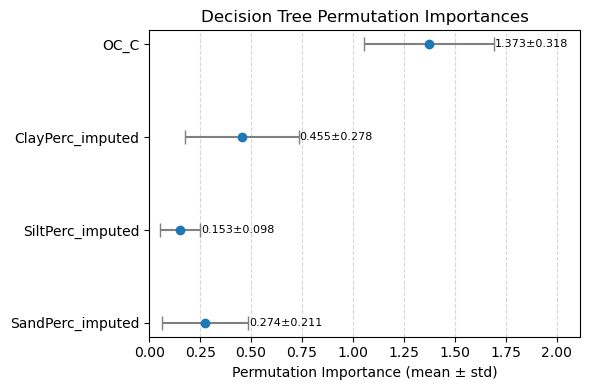

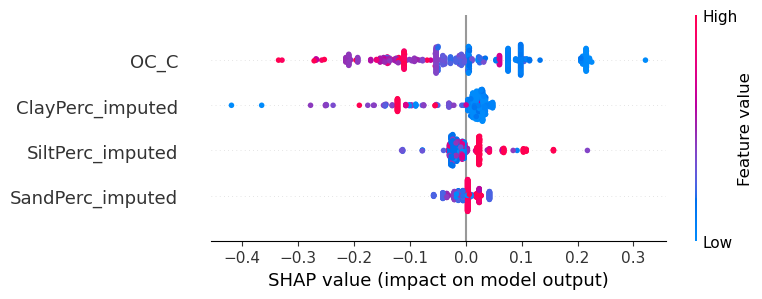


Random Forest Regression

Cross-validated MAE (mean ± std): 0.048 ± -0.025
Cross-validated RMSE (mean ± std): 0.087 ± -0.025
Cross-validated R² (mean ± std): 0.704 ± 0.129


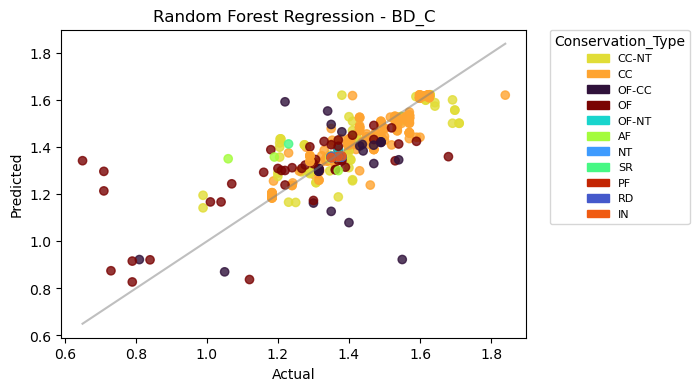

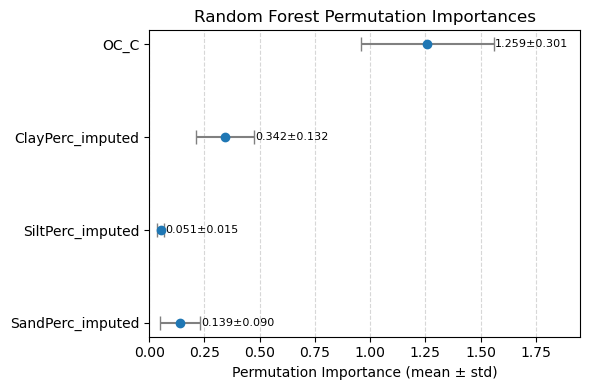

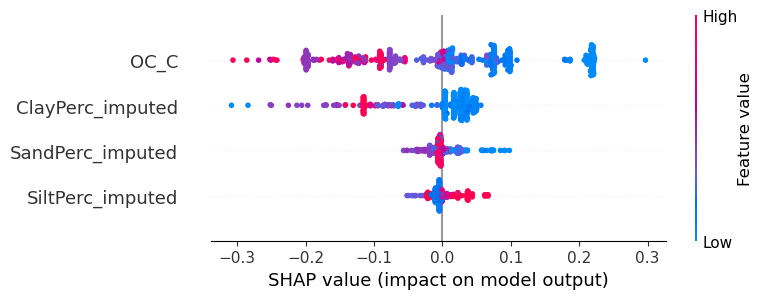


XGBoost Random Forest Regression

Cross-validated MAE (mean ± std): 0.029 ± -0.018
Cross-validated RMSE (mean ± std): 0.072 ± -0.018
Cross-validated R² (mean ± std): 0.797 ± 0.075


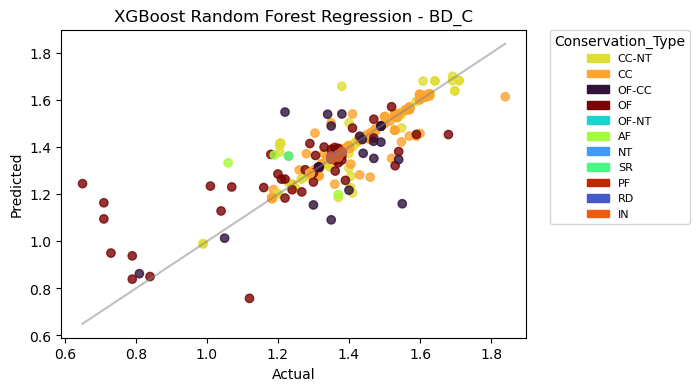

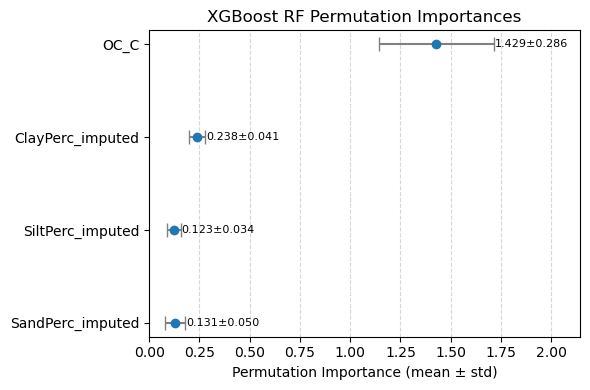

* SHAP does not support XGBoost random forest mode (num_parallel_tree > 1). Skipping SHAP plot.

XGBoost Regression

Cross-validated MAE (mean ± std): 0.031 ± -0.021
Cross-validated RMSE (mean ± std): 0.076 ± -0.021
Cross-validated R² (mean ± std): 0.772 ± 0.096


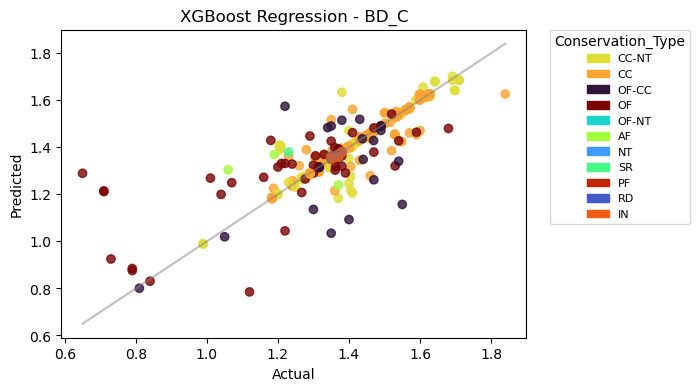

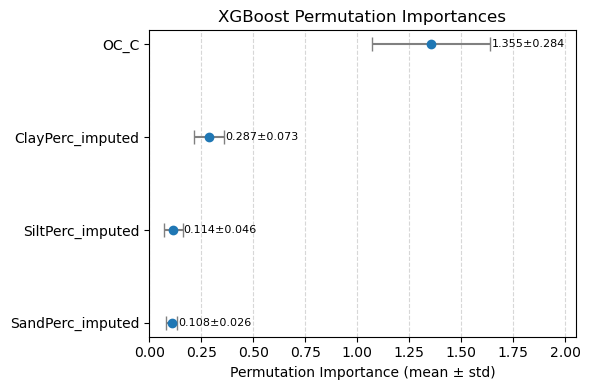

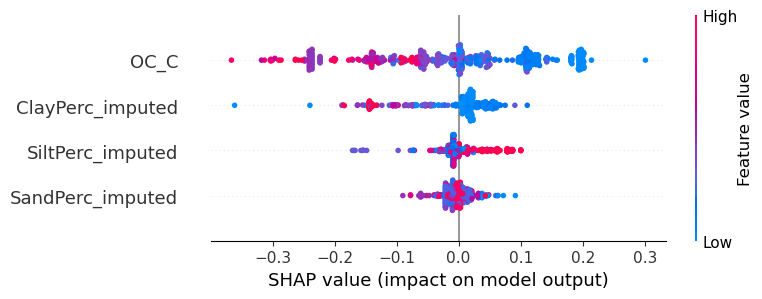


Generalized Additive Model

Cross-validated MAE (mean ± std): 0.08 ± 0.005
Cross-validated RMSE (mean ± std): 0.11 ± 0.015
Cross-validated R² (mean ± std): 0.531 ± 0.073


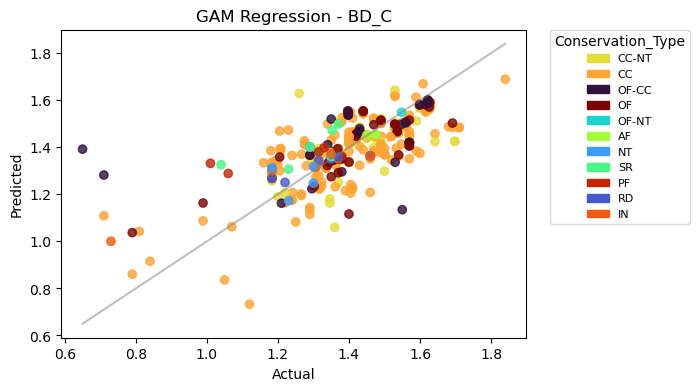

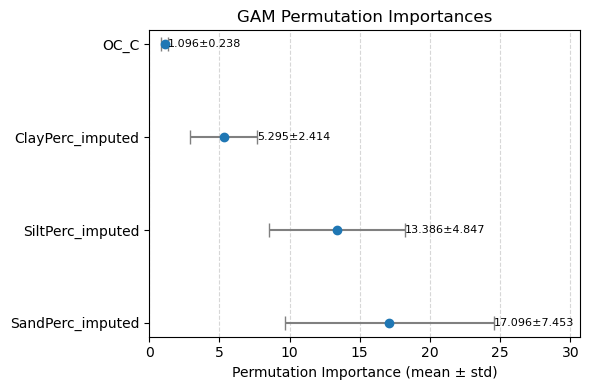

Using 503 background data samples could cause slower run times. Consider using shap.sample(data, K) or shap.kmeans(data, K) to summarize the background as K samples.


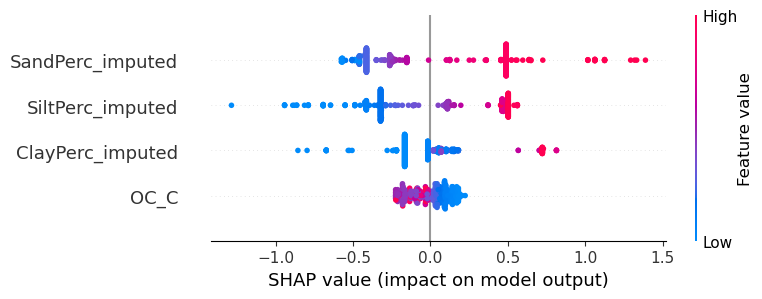

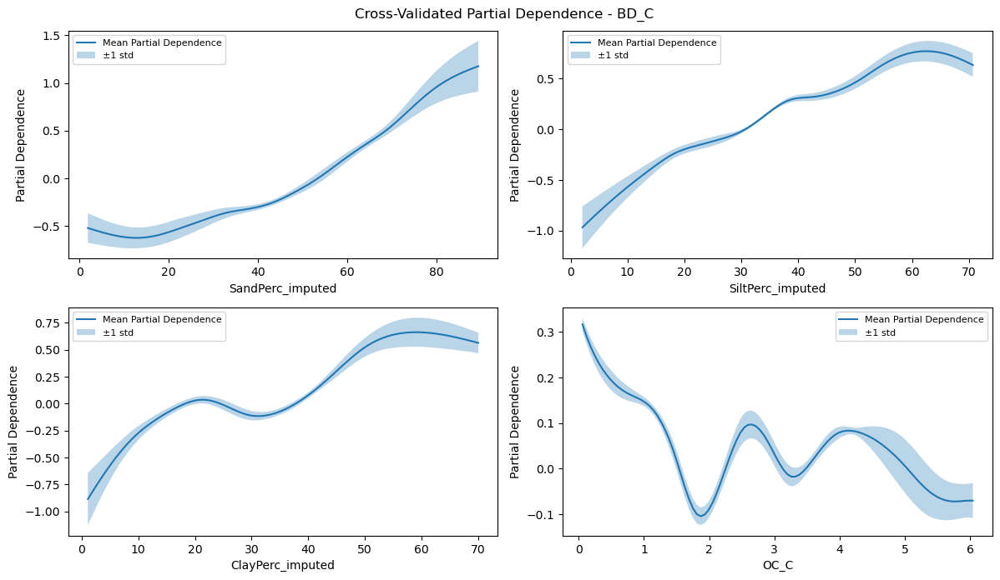

Predictors: SandPerc_imputed SiltPerc_imputed ClayPerc_imputed OC_C
Dataset Shape: (503, 4)
Train set: BD_C | Dataset Shape: (402, 4)
Test set: BD_C | Dataset Shape: (101, 4)
                              Model Cross-validated MAE (mean ± std)  \
0           Multi Linear Regression                   0.098 ± -0.006   
1                  Ridge Regression                   0.098 ± -0.006   
2         Support Vector Regression                   0.087 ± -0.008   
3                    KNN Regression                   0.031 ± -0.009   
4          Decision Tree Regression                   0.053 ± -0.006   
5          Random Forest Regression                   0.048 ± -0.008   
6  XGBoost Random Forest Regression                   0.029 ± -0.008   
7                XGBoost Regression                   0.031 ± -0.008   
8        Generalized Additive Model                  -0.080 ± -0.005   

  Cross-validated RMSE (mean ± std) Cross-validated R² (mean ± std)  
0                    0.133 ± -0.01

In [172]:
soil_health_prediction_models(df3, ['SandPerc_imputed', 'SiltPerc_imputed', 'ClayPerc_imputed', 'OC_C'], 'BD_C', 'BD_C', 'Conservation_Type')

### Aggregation

Random split (80/20) and 5-fold cross-validation used.

Predictors: SandPerc_imputed SiltPerc_imputed ClayPerc_imputed OC_C
Dataset Shape: (93, 4)
Train set: Aggre_C | Shape: (74, 4)
Test set: Aggre_C | Shape: (19, 4)

Multi Linear Regression

Cross-validated MAE (mean ± std): 95.363 ± -23.439
Cross-validated RMSE (mean ± std): 126.101 ± -23.439
Cross-validated R² (mean ± std): 0.441 ± 0.221


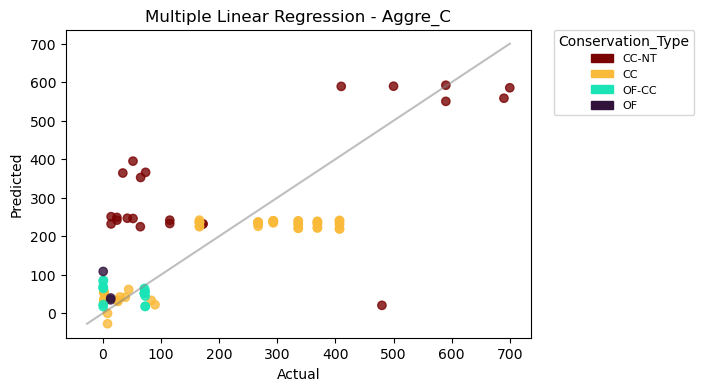

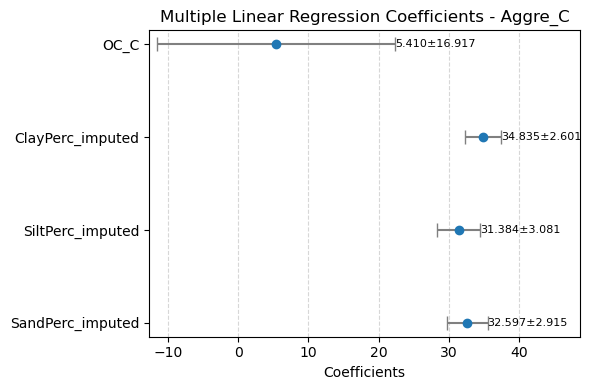

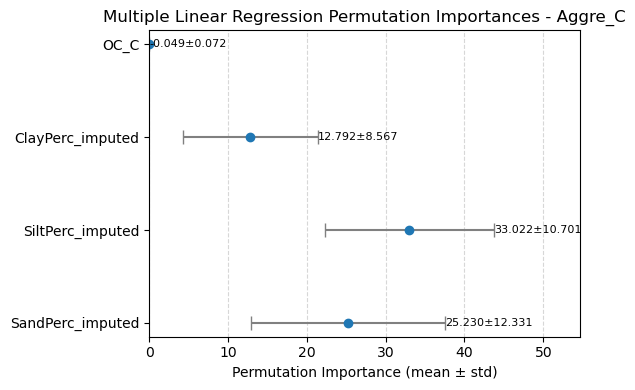

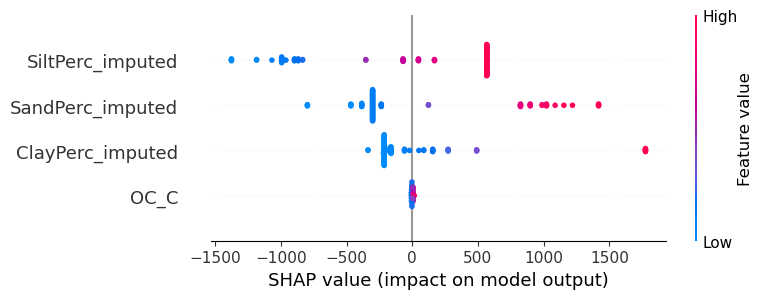


Ridge Regression

Cross-validated MAE (mean ± std): 95.355 ± -23.3
Cross-validated RMSE (mean ± std): 125.953 ± -23.3
Cross-validated R² (mean ± std): 0.442 ± 0.22


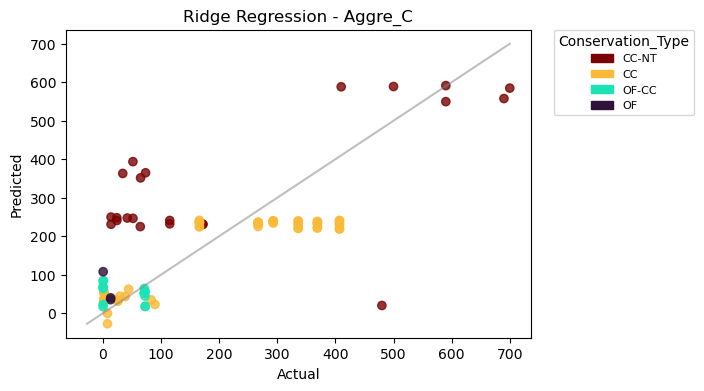

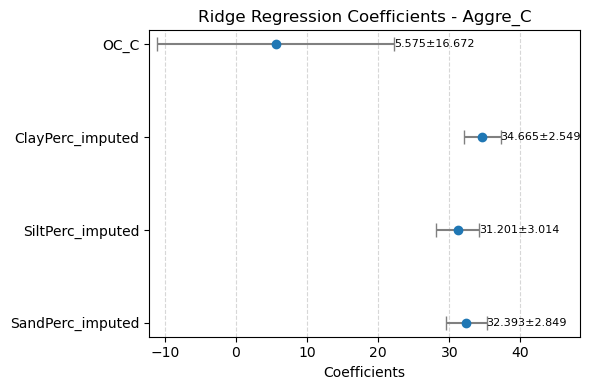

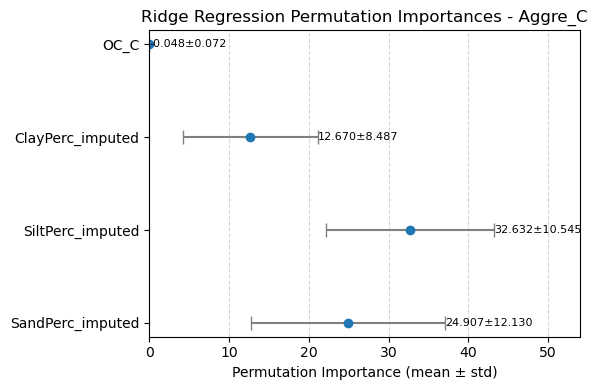

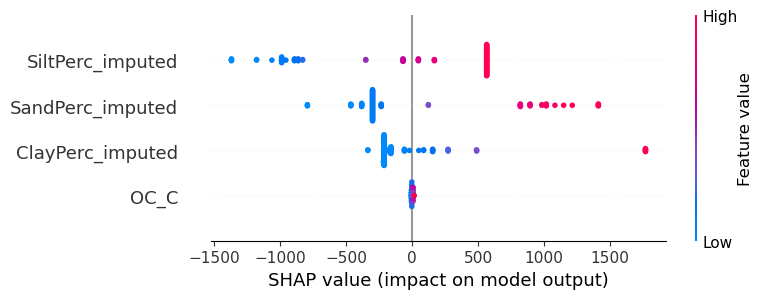


Support Vector Regression

Cross-validated MAE (mean ± std): 66.7 ± -12.546
Cross-validated RMSE (mean ± std): 105.753 ± -22.839
Cross-validated R² (mean ± std): 0.621 ± 0.144


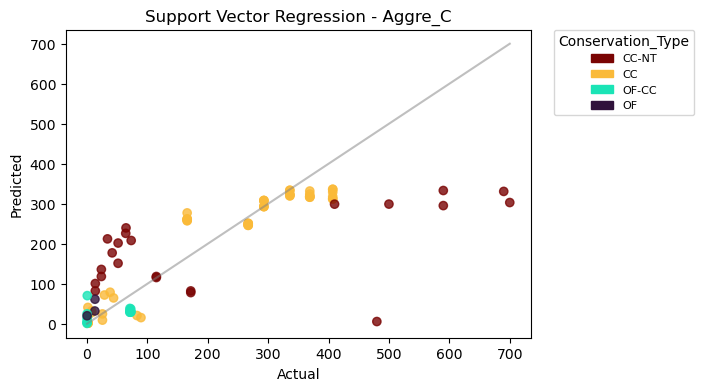

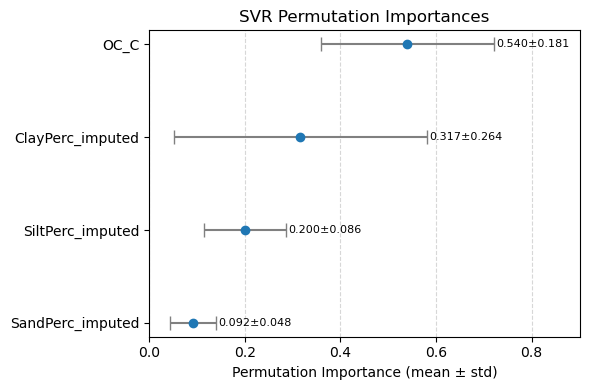

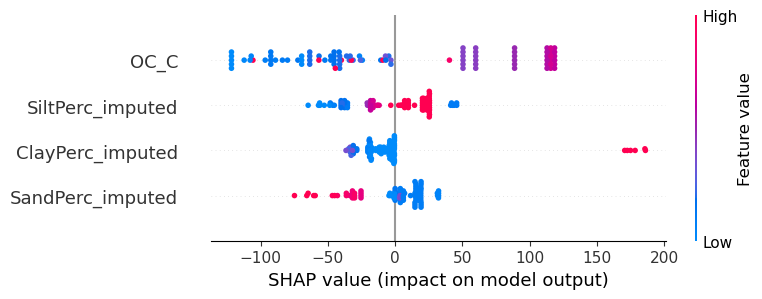


KNN Regression

Cross-validated MAE (mean ± std): 24.504 ± -30.027
Cross-validated RMSE (mean ± std): 57.745 ± -30.027
Cross-validated R² (mean ± std): 0.844 ± 0.195


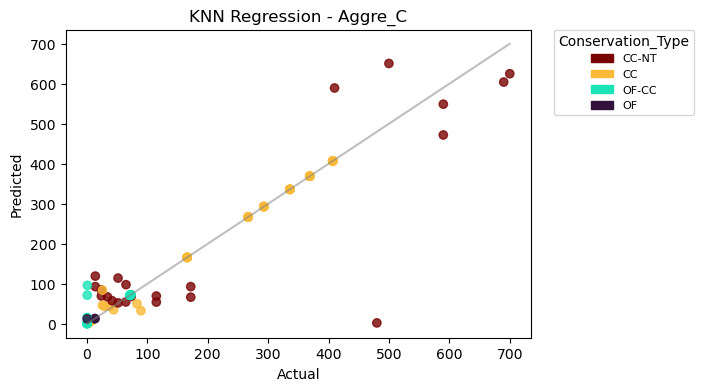

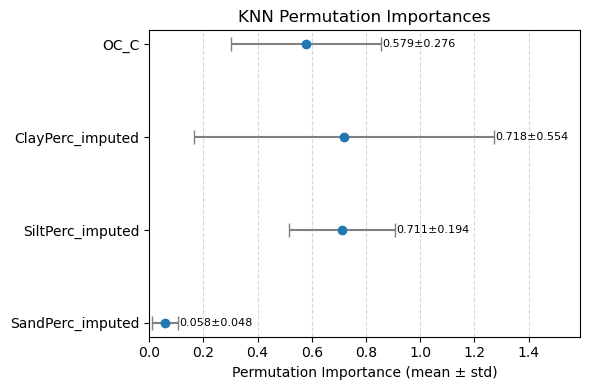

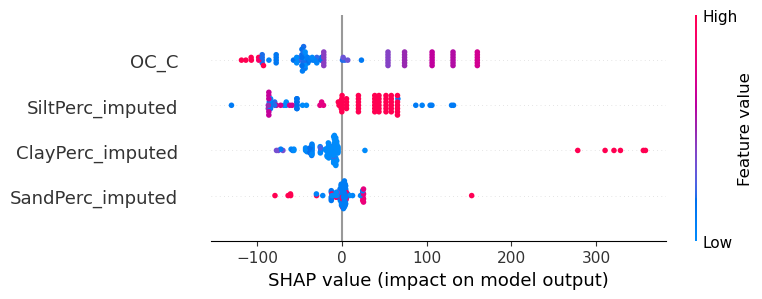


Decision Tree Regression

Cross-validated MAE (mean ± std): 24.044 ± -31.57
Cross-validated RMSE (mean ± std): 58.397 ± -31.57
Cross-validated R² (mean ± std): 0.839 ± 0.197


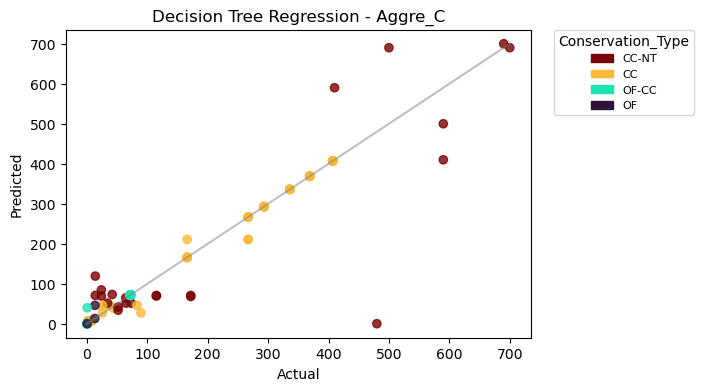

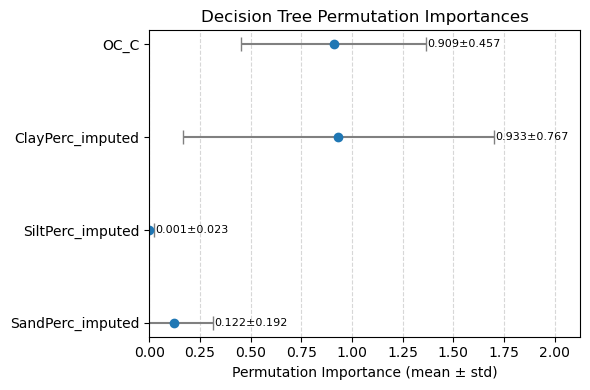

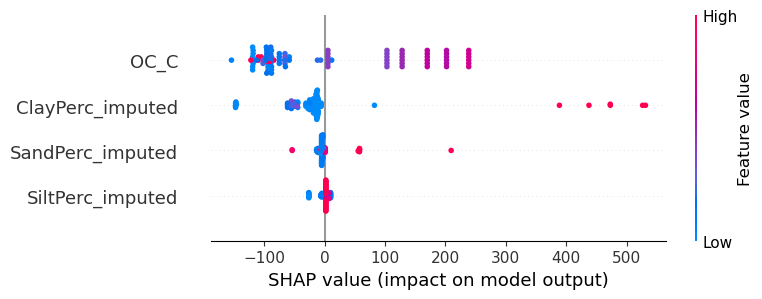


Random Forest Regression

Cross-validated MAE (mean ± std): 30.032 ± -28.006
Cross-validated RMSE (mean ± std): 56.22 ± -28.006
Cross-validated R² (mean ± std): 0.854 ± 0.176


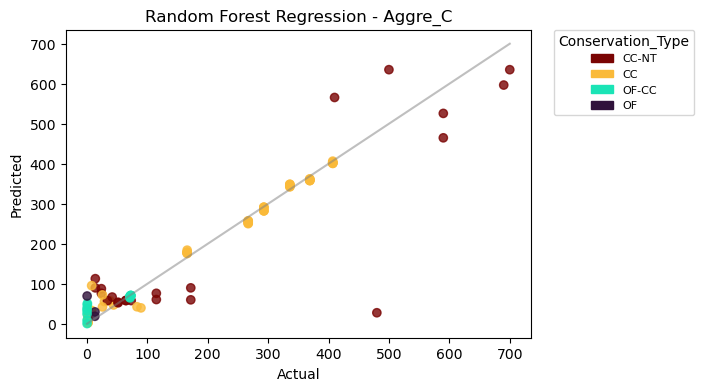

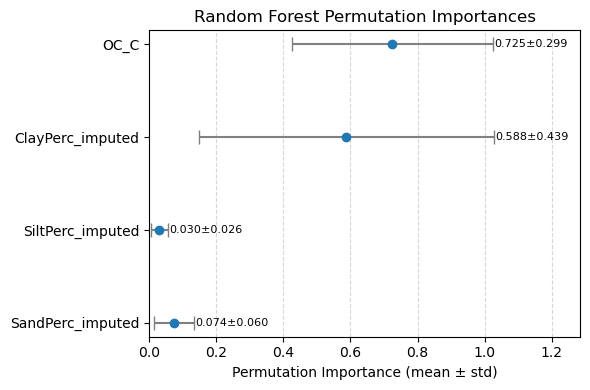

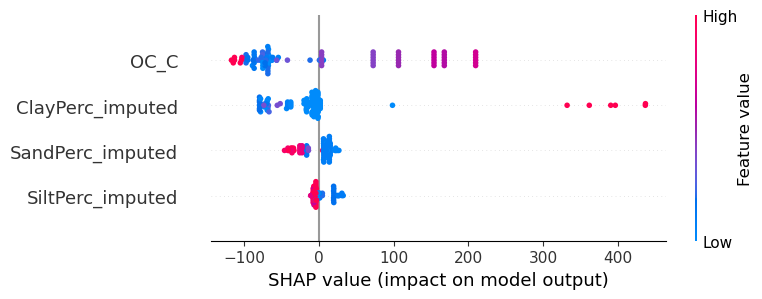


XGBoost Random Forest Regression

Cross-validated MAE (mean ± std): 27.294 ± -33.687
Cross-validated RMSE (mean ± std): 65.474 ± -33.687
Cross-validated R² (mean ± std): 0.812 ± 0.185


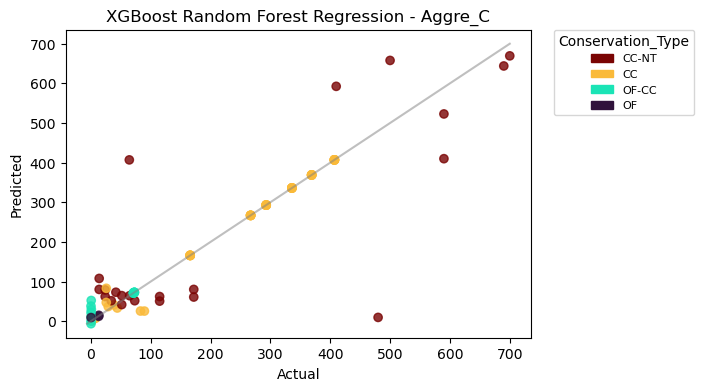

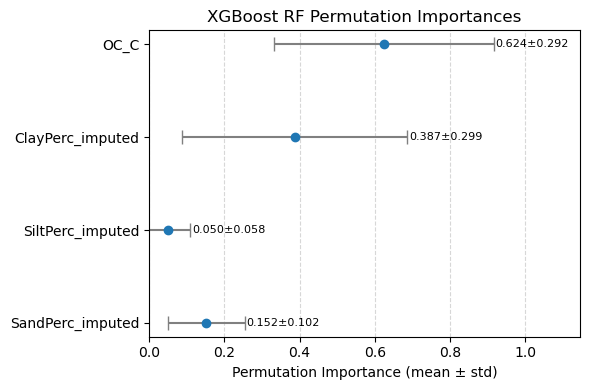

* SHAP does not support XGBoost random forest mode (num_parallel_tree > 1). Skipping SHAP plot.

XGBoost Regression

Cross-validated MAE (mean ± std): 28.404 ± -32.792
Cross-validated RMSE (mean ± std): 66.804 ± -32.792
Cross-validated R² (mean ± std): 0.809 ± 0.182


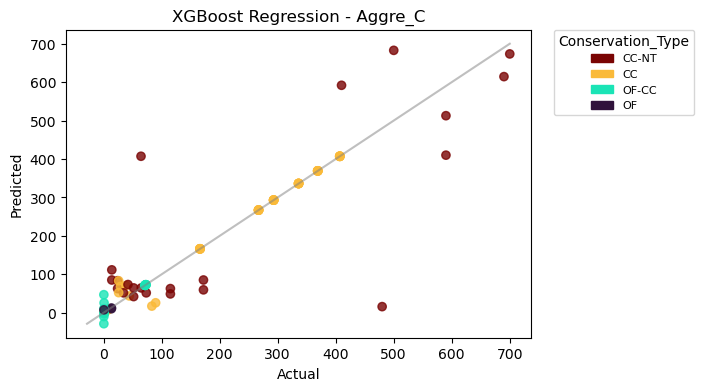

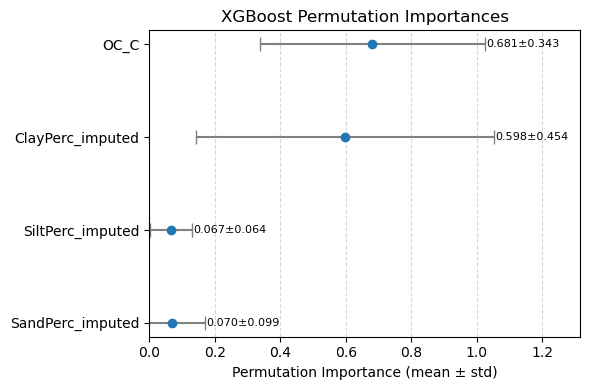

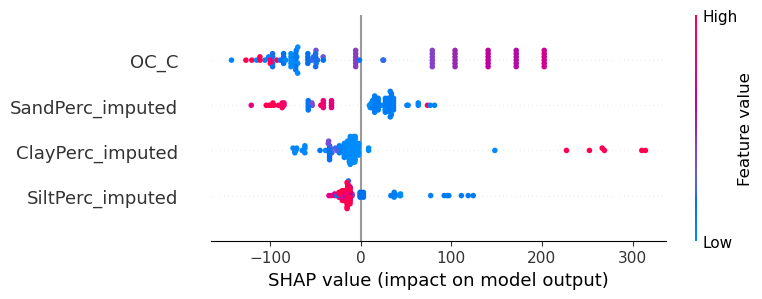


Generalized Additive Model

Cross-validated MAE (mean ± std): 42.835 ± 9.166
Cross-validated RMSE (mean ± std): 65.314 ± 26.547
Cross-validated R² (mean ± std): 0.82 ± 0.181


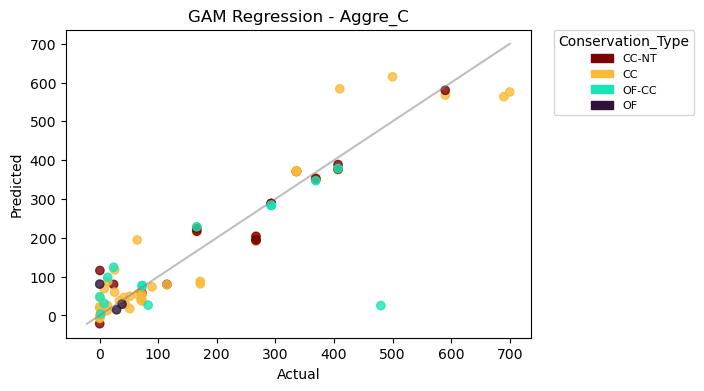

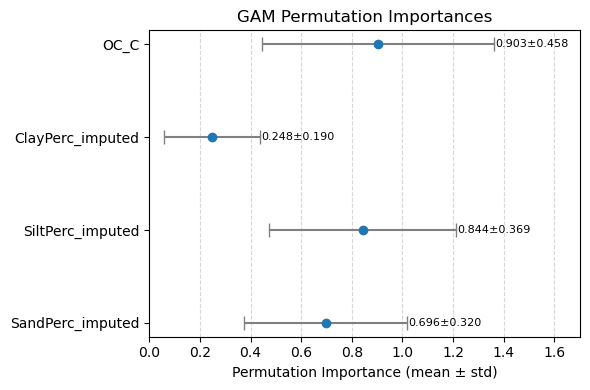

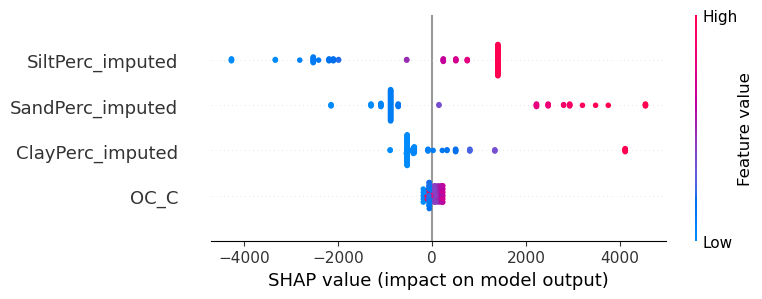

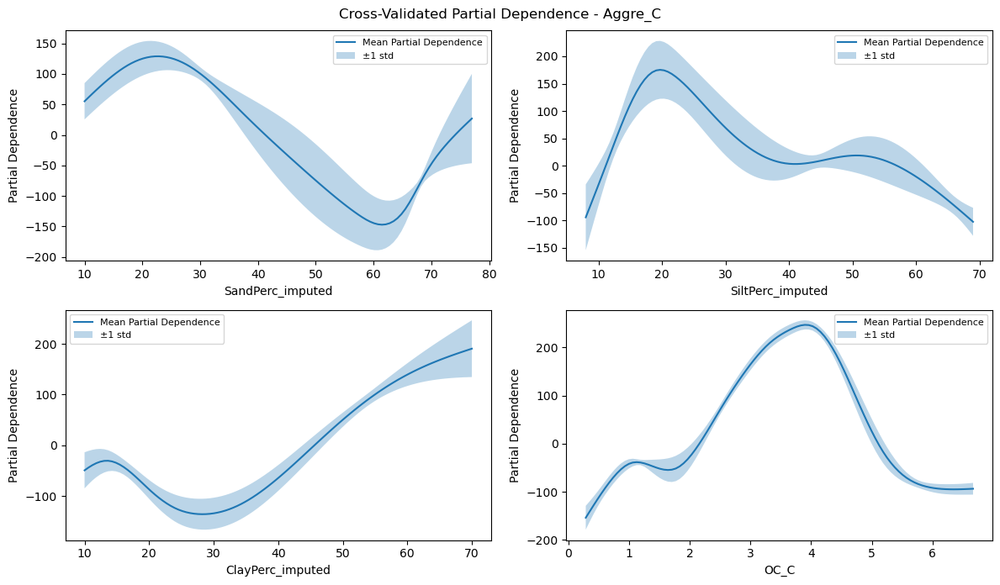

Predictors: SandPerc_imputed SiltPerc_imputed ClayPerc_imputed OC_C
Dataset Shape: (93, 4)
Train set: Aggre_C | Dataset Shape: (74, 4)
Test set: Aggre_C | Dataset Shape: (19, 4)
                              Model Cross-validated MAE (mean ± std)  \
0           Multi Linear Regression                 95.363 ± -10.603   
1                  Ridge Regression                 95.355 ± -10.589   
2         Support Vector Regression                 66.700 ± -12.546   
3                    KNN Regression                  24.504 ± -8.106   
4          Decision Tree Regression                  24.044 ± -8.588   
5          Random Forest Regression                  30.032 ± -7.704   
6  XGBoost Random Forest Regression                 27.294 ± -10.078   
7                XGBoost Regression                 28.404 ± -10.825   
8        Generalized Additive Model                 -42.835 ± -9.166   

  Cross-validated RMSE (mean ± std) Cross-validated R² (mean ± std)  
0                 126.101 ± -23

In [173]:
soil_health_prediction_models(df3, ['SandPerc_imputed', 'SiltPerc_imputed', 'ClayPerc_imputed', 'OC_C'], 'Aggre_C', 'Aggre_C', 'Conservation_Type')

## Train Control Test Treatment

### CEC

Separate train/test sets used.

Predictors: SandPerc_imputed SiltPerc_imputed ClayPerc_imputed SoilpH OC_C
Train set: CEC_C | Shape: (93, 5)
Test set: CEC_T | Shape: (93, 5)

Multi Linear Regression

MAE: 2.405
RMSE: 3.181
R²: 0.671


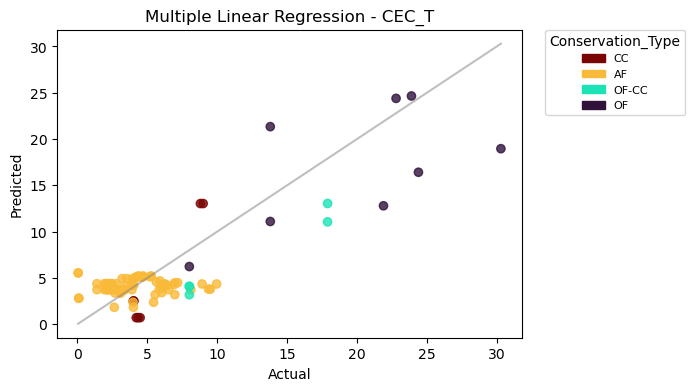

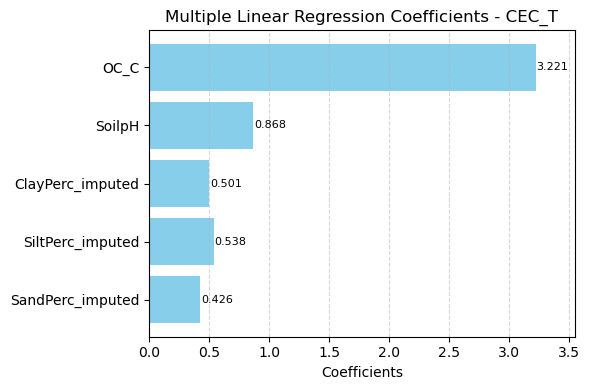

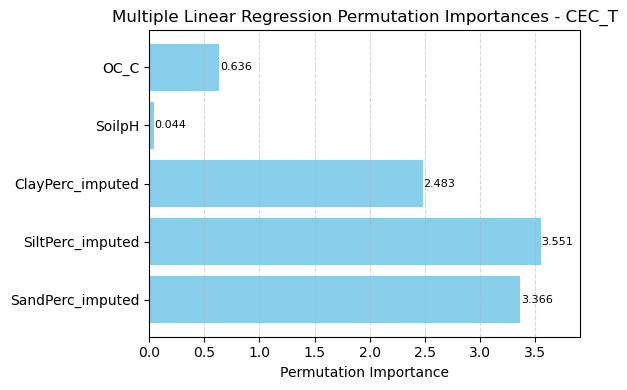

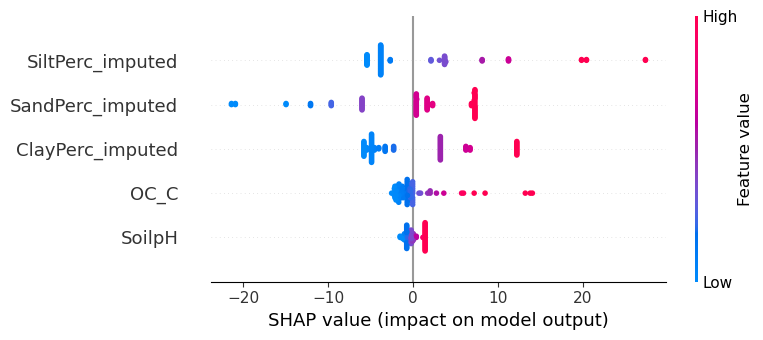


Ridge Regression

MAE: 2.398
RMSE: 3.181
R²: 0.671


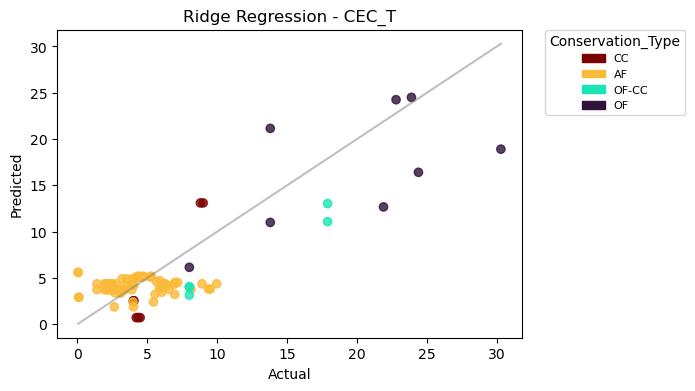

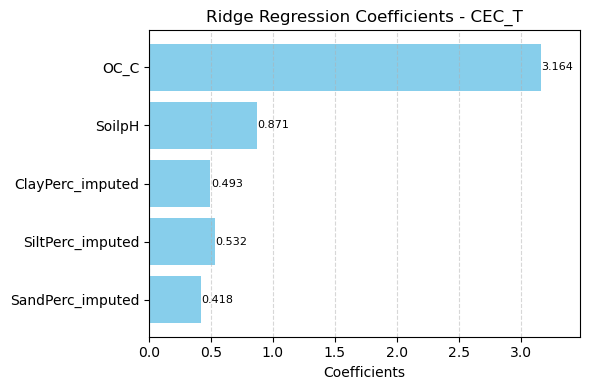

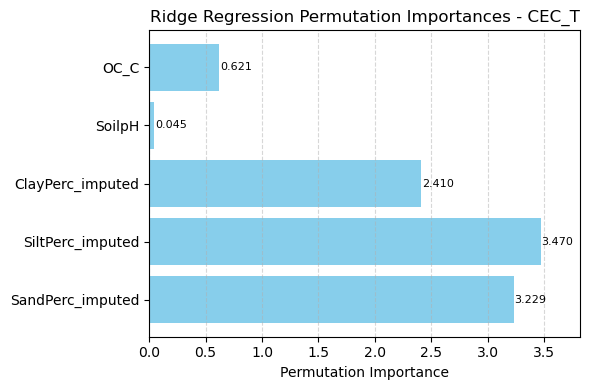

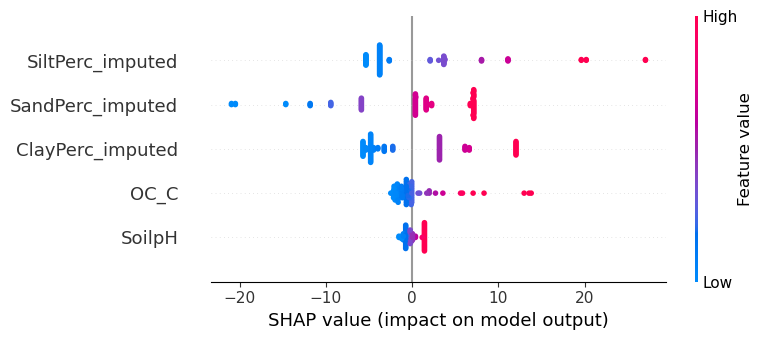


Support Vector Regression

MAE: 1.076
RMSE: 1.598
R²: 0.917


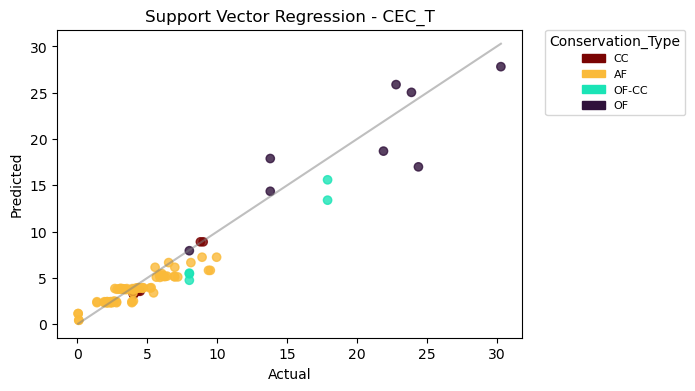

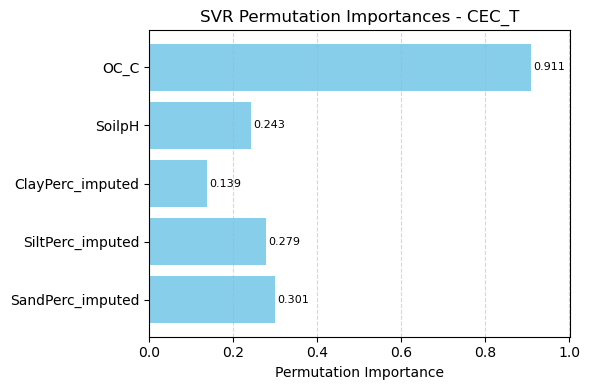

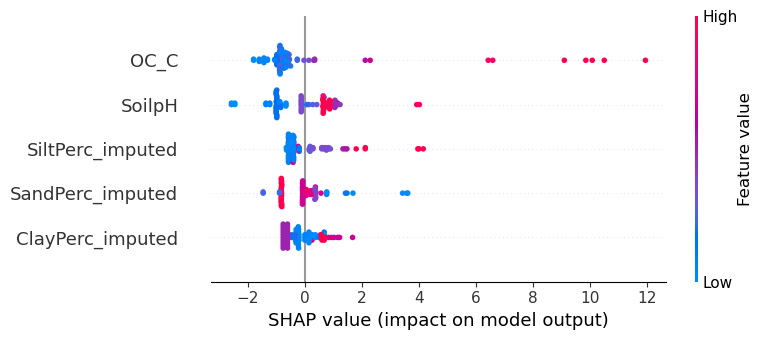


KNN Regression

MAE: 1.166
RMSE: 1.715
R²: 0.904


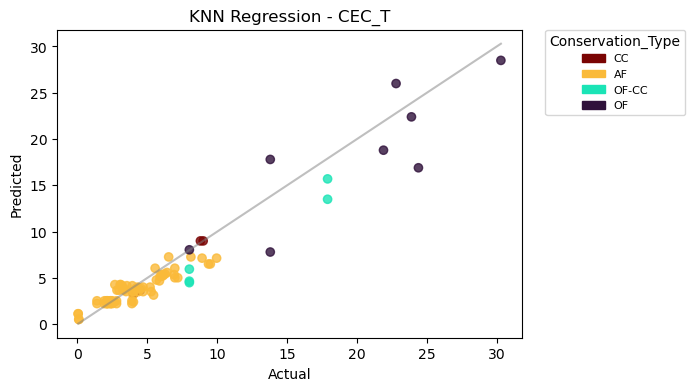

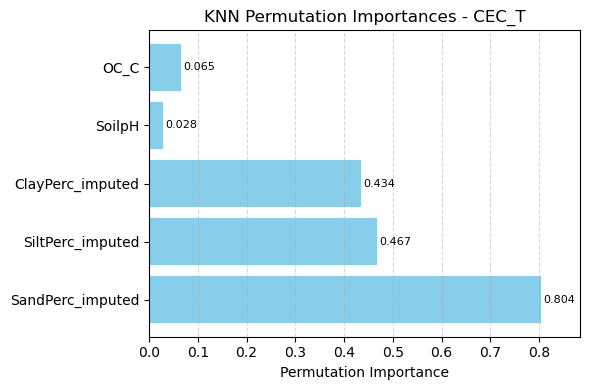

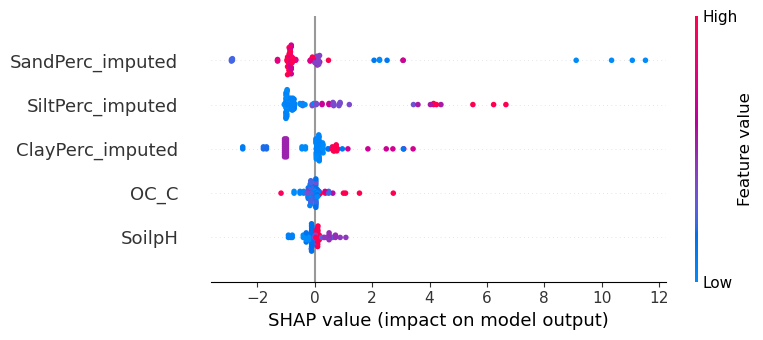


Decision Tree Regression

MAE: 1.171
RMSE: 1.727
R²: 0.903


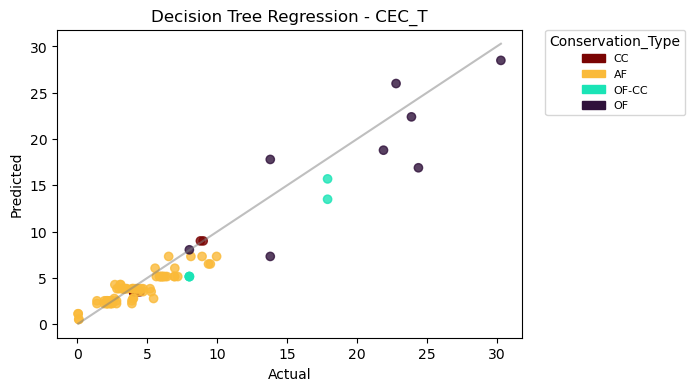

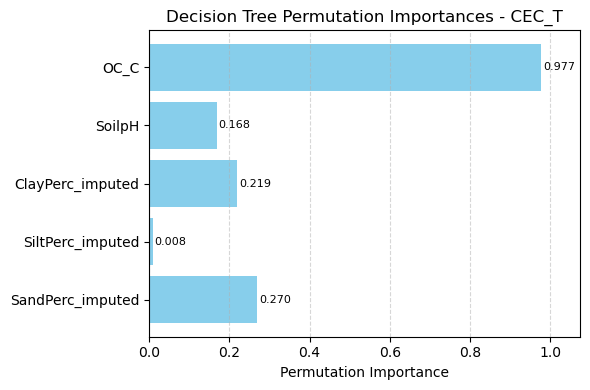

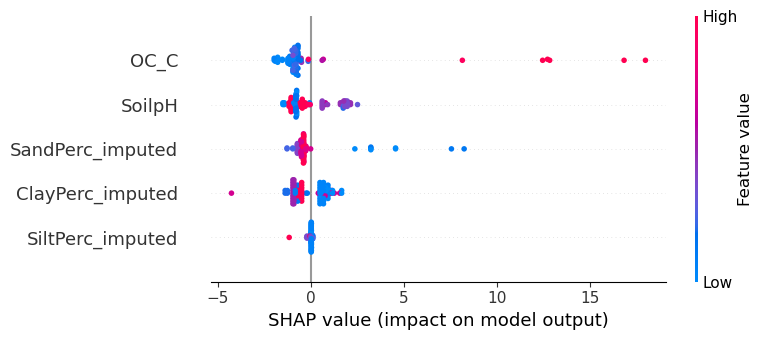


Random Forest Regression

MAE: 1.247
RMSE: 1.87
R²: 0.886


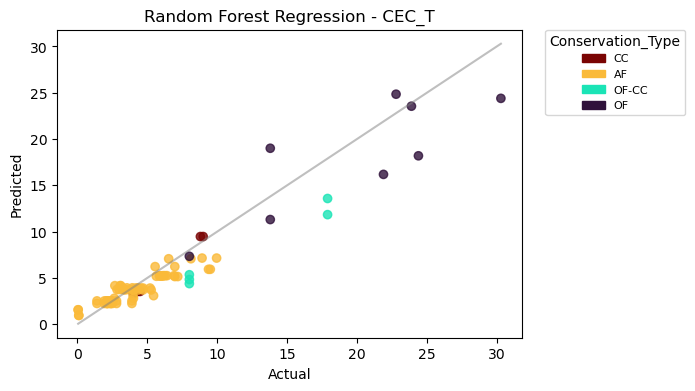

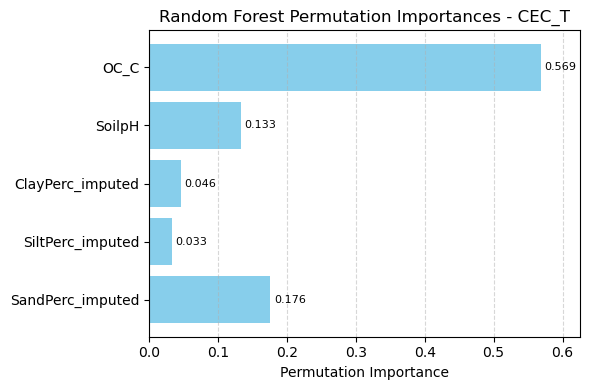

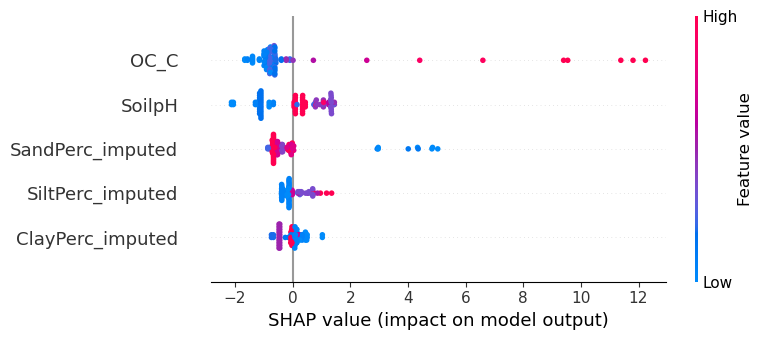


XGBoost Random Forest Regression

MAE: 1.166
RMSE: 1.715
R²: 0.904


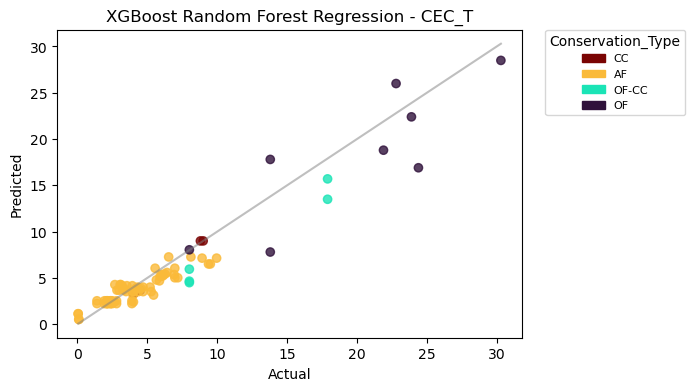

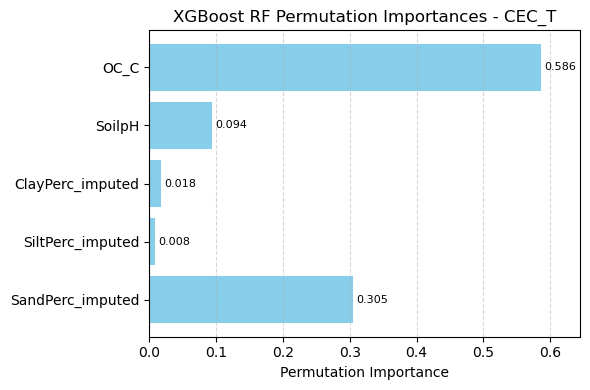

* SHAP does not support XGBoost random forest mode (num_parallel_tree > 1). Skipping SHAP plot.

XGBoost Regression

MAE: 1.165
RMSE: 1.715
R²: 0.904


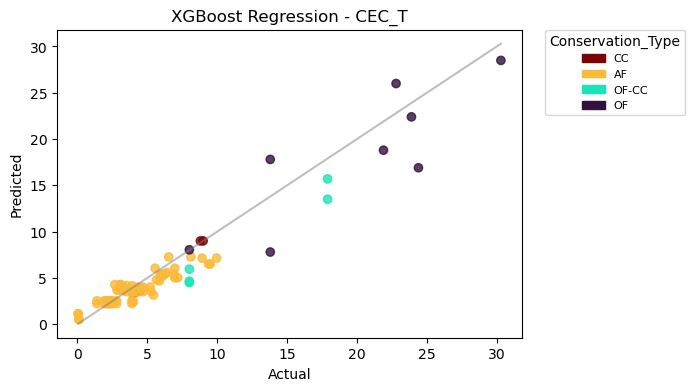

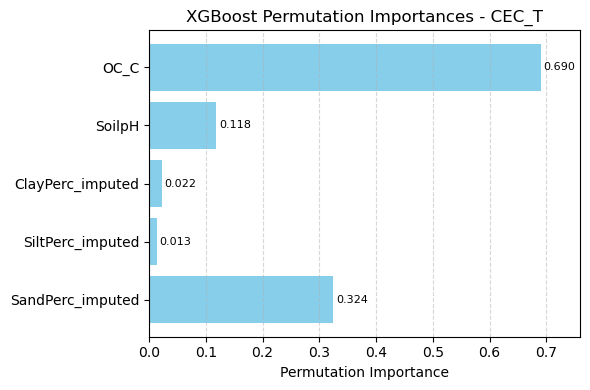

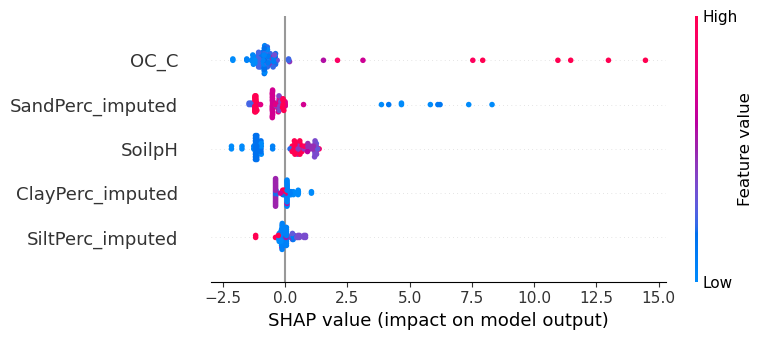


Generalized Additive Model

MAE: 1.126
RMSE: 1.742
R²: 0.901


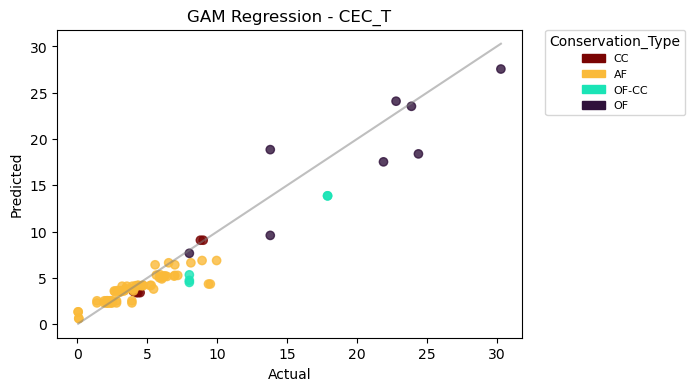

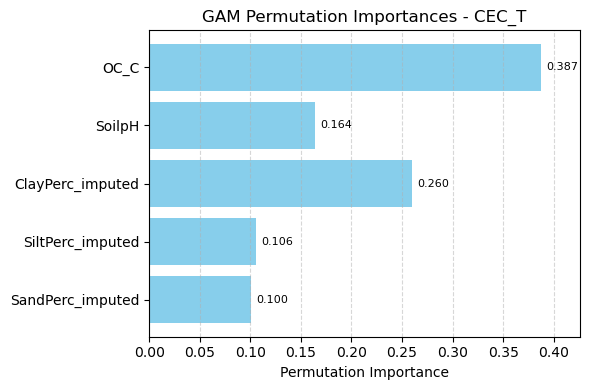

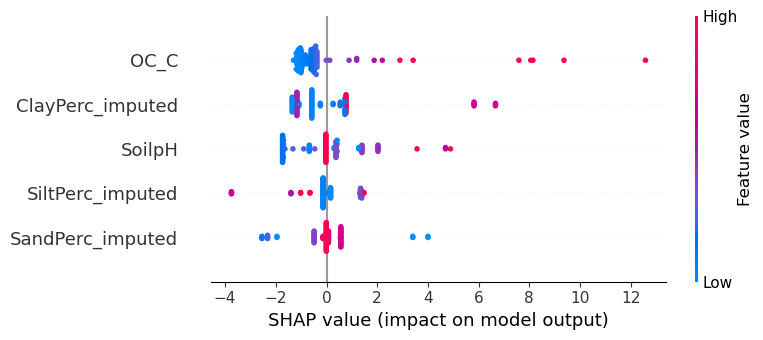

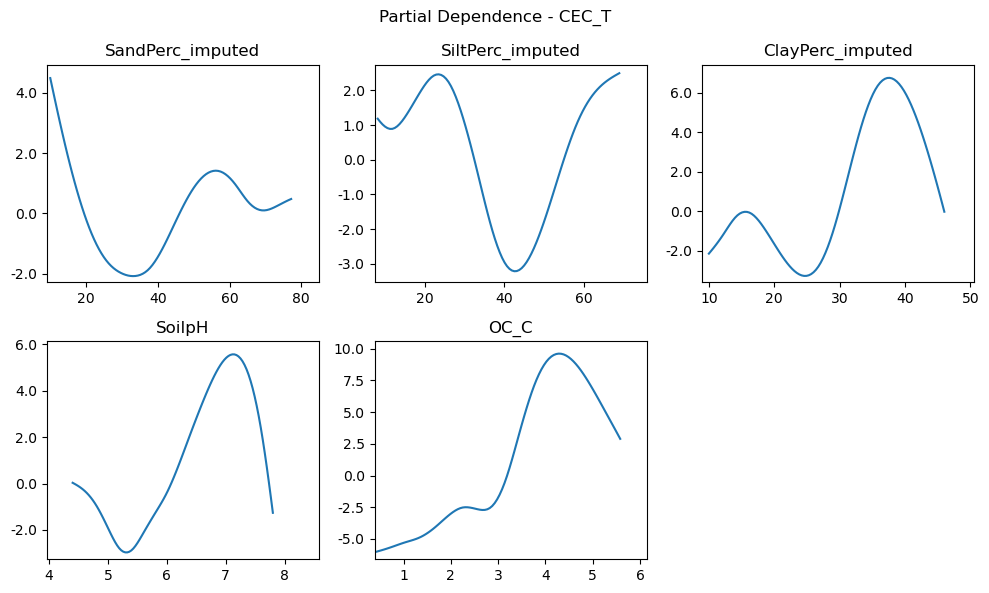

Predictors: SandPerc_imputed SiltPerc_imputed ClayPerc_imputed SoilpH OC_C
Train set: CEC_C | Dataset Shape: (93, 5)
Test set: CEC_T | Dataset Shape: (93, 5)
                              Model    MAE   RMSE     R²
0           Multi Linear Regression  2.405  3.181  0.671
1                  Ridge Regression  2.398  3.181  0.671
2         Support Vector Regression  1.076  1.598  0.917
3                    KNN Regression  1.166  1.715  0.904
4          Decision Tree Regression  1.171  1.727  0.903
5          Random Forest Regression  1.247  1.870  0.886
6  XGBoost Random Forest Regression  1.166  1.715  0.904
7                XGBoost Regression  1.165  1.715  0.904
8        Generalized Additive Model  1.126  1.742  0.901


In [174]:
soil_health_prediction_models(df3, ['SandPerc_imputed', 'SiltPerc_imputed', 'ClayPerc_imputed', 'SoilpH', 'OC_C'], 'CEC_C', 'CEC_T', 'Conservation_Type')

### CEC (Conservation Group)

Separate train/test sets used.

Predictors: SandPerc_imputed SiltPerc_imputed ClayPerc_imputed SoilpH OC_C Conservation_Group
Train set: CEC_C | Shape: (93, 8)
Test set: CEC_T | Shape: (93, 8)

Multi Linear Regression

MAE: 1.929
RMSE: 2.748
R²: 0.754


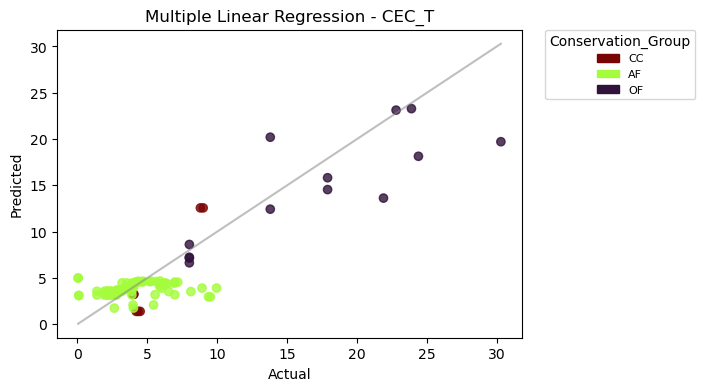

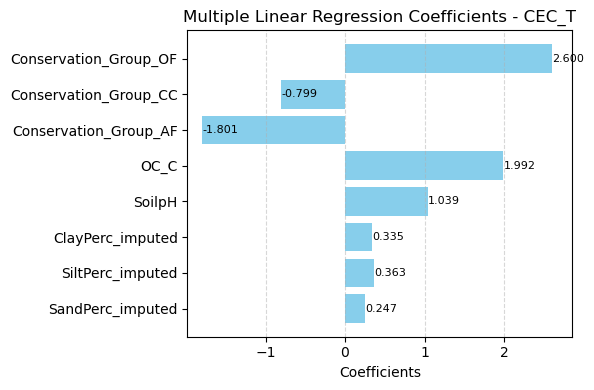

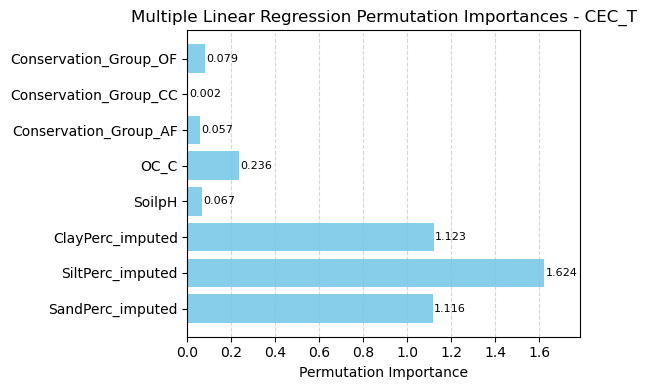

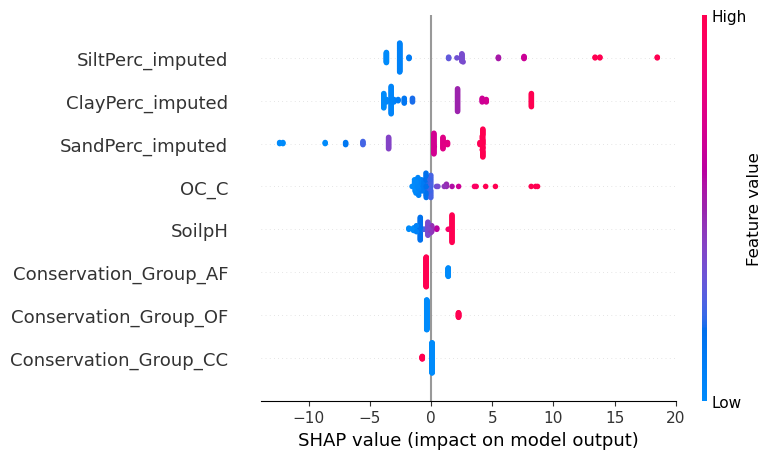


Ridge Regression

MAE: 1.954
RMSE: 2.778
R²: 0.749


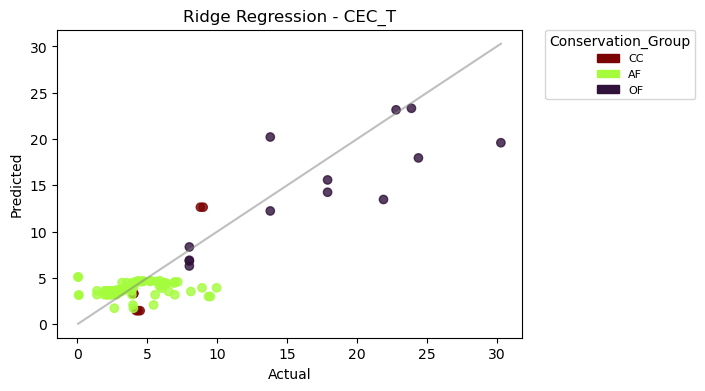

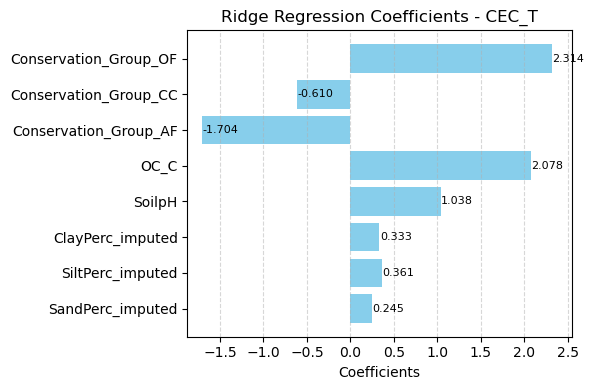

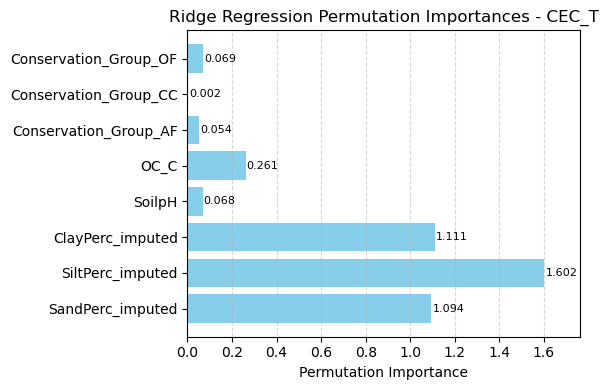

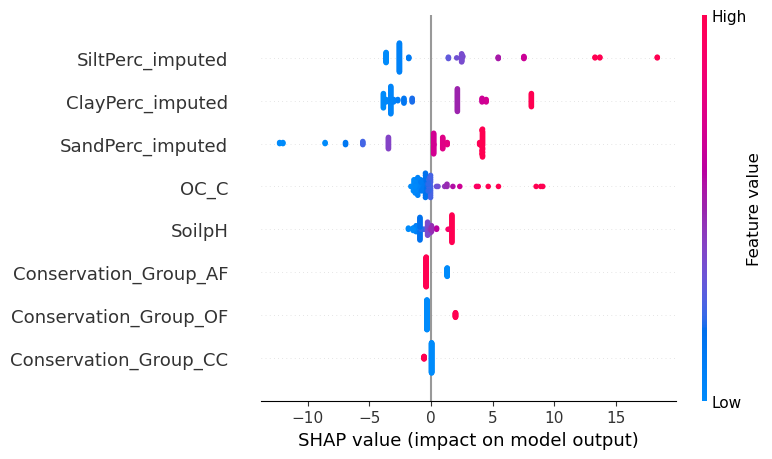


Support Vector Regression

MAE: 1.181
RMSE: 1.907
R²: 0.882


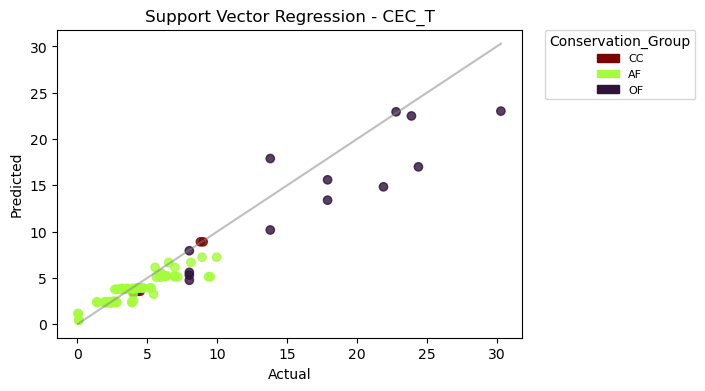

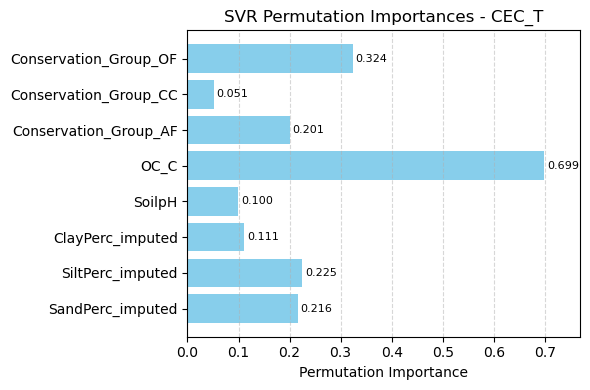

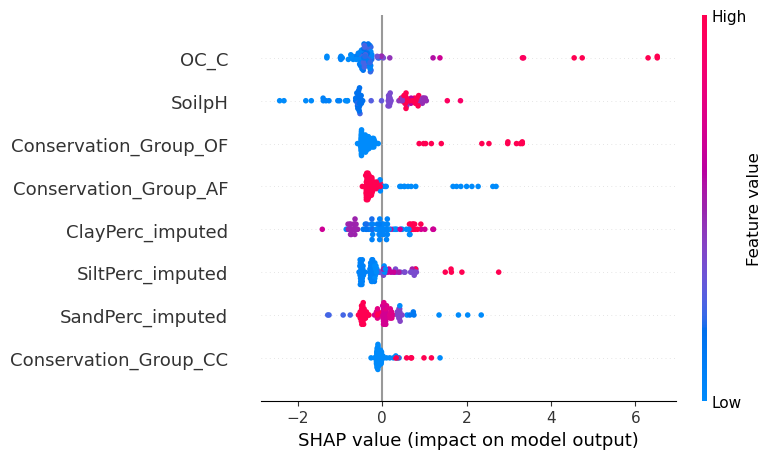


KNN Regression

MAE: 1.166
RMSE: 1.715
R²: 0.904


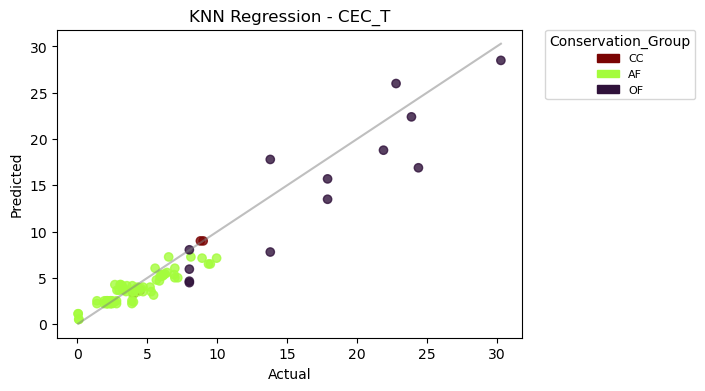

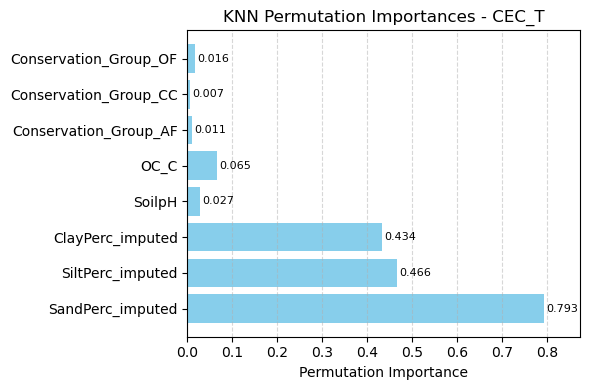

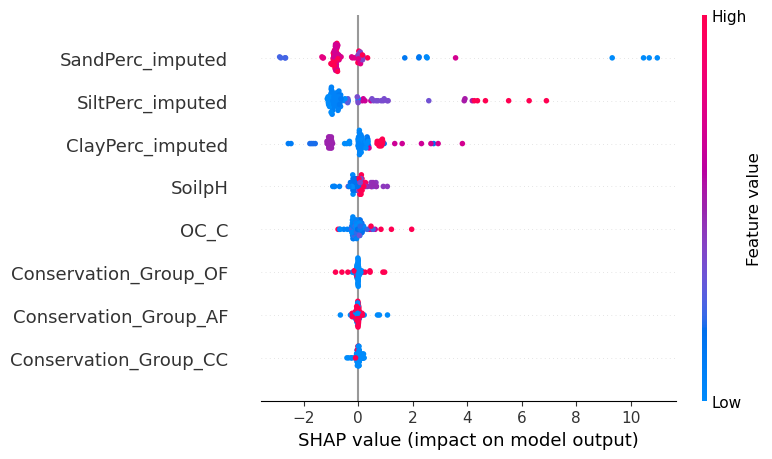


Decision Tree Regression

MAE: 1.171
RMSE: 1.727
R²: 0.903


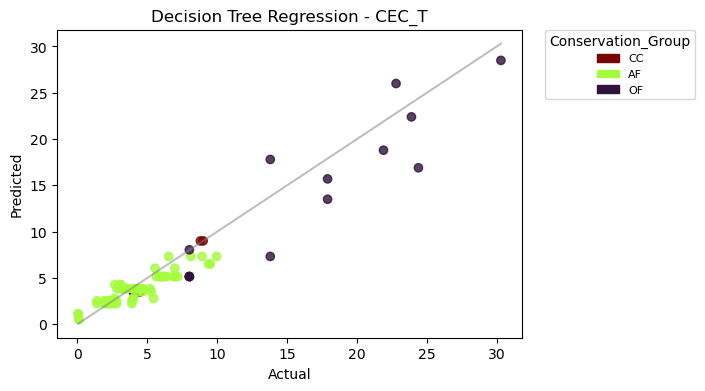

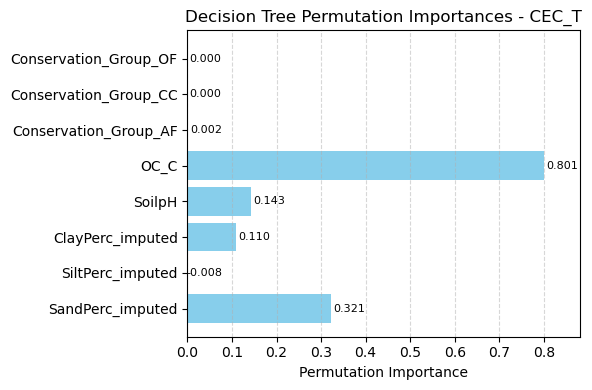

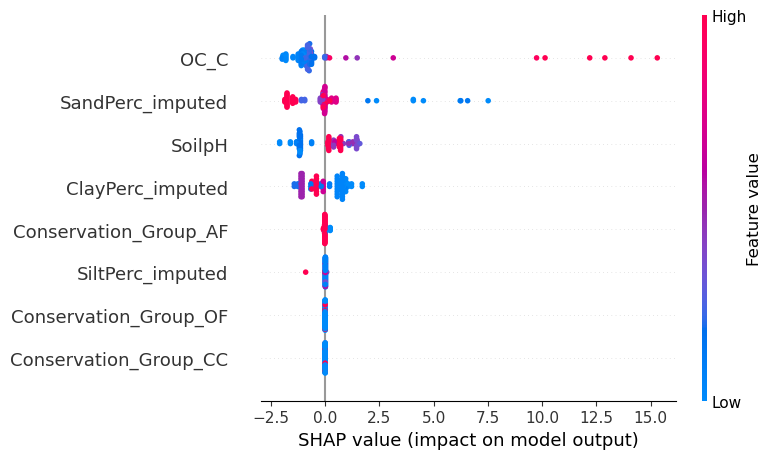


Random Forest Regression

MAE: 1.236
RMSE: 1.86
R²: 0.887


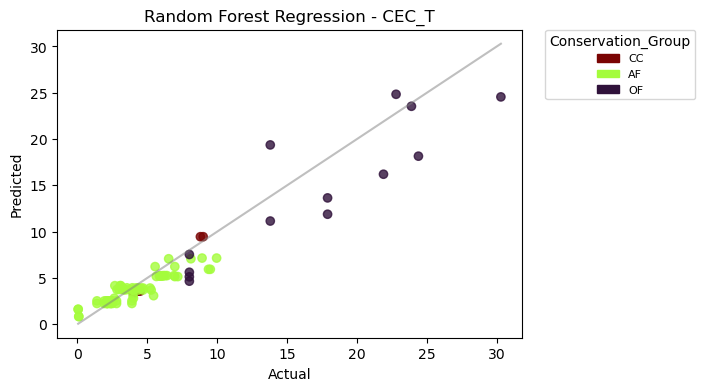

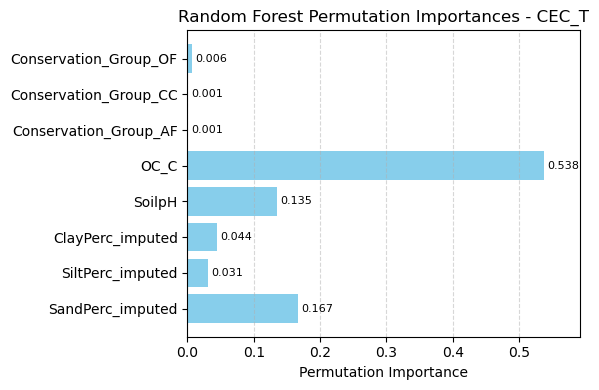

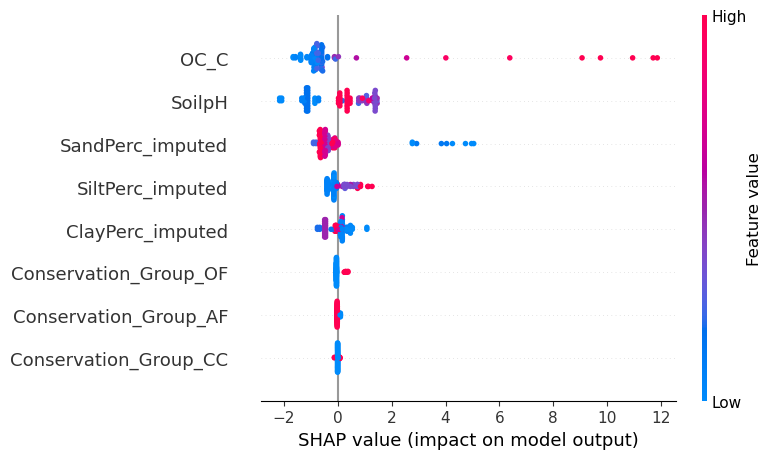


XGBoost Random Forest Regression

MAE: 1.166
RMSE: 1.715
R²: 0.904


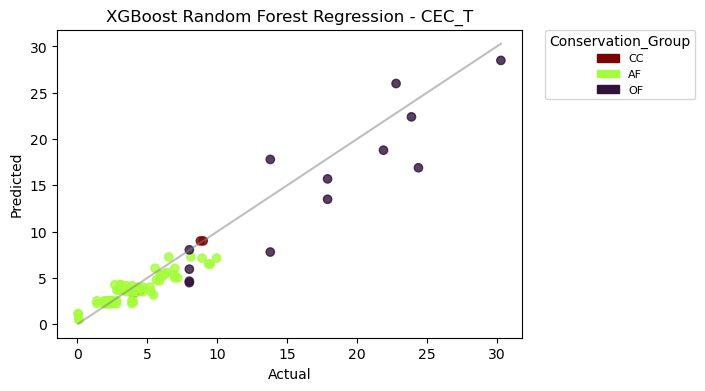

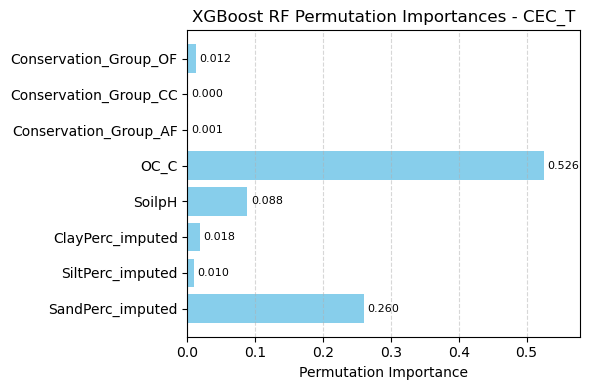

* SHAP does not support XGBoost random forest mode (num_parallel_tree > 1). Skipping SHAP plot.

XGBoost Regression

MAE: 1.165
RMSE: 1.715
R²: 0.904


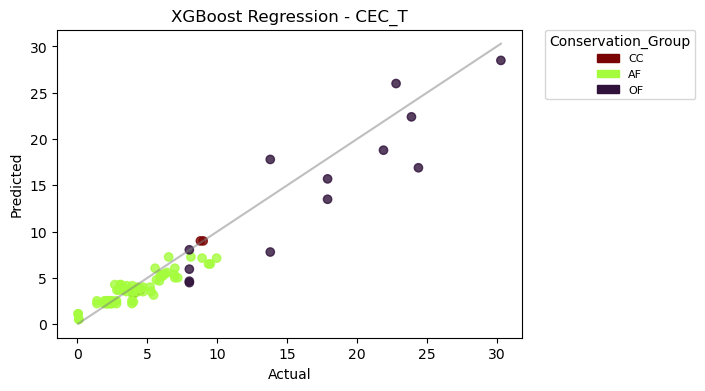

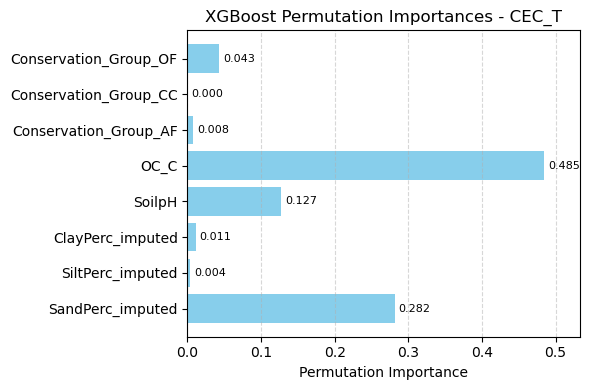

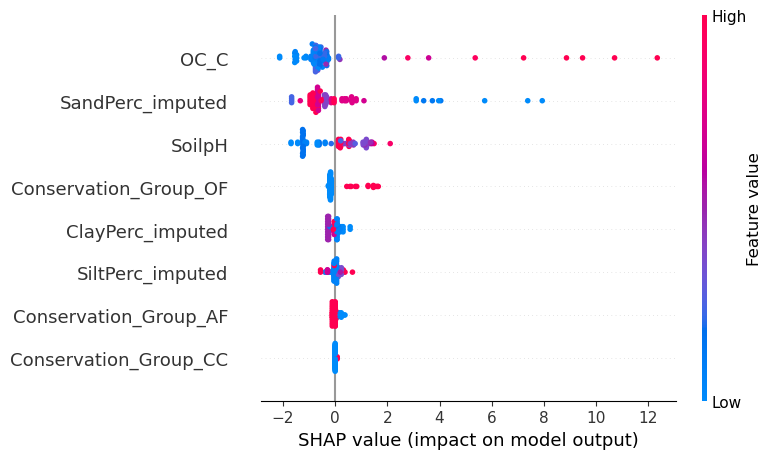


Generalized Additive Model

MAE: 1.127
RMSE: 1.742
R²: 0.901


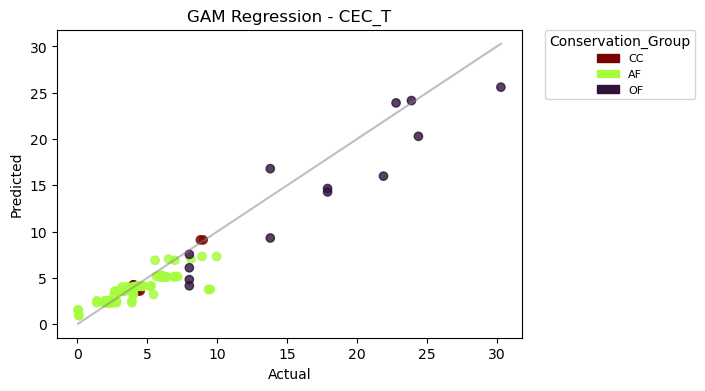

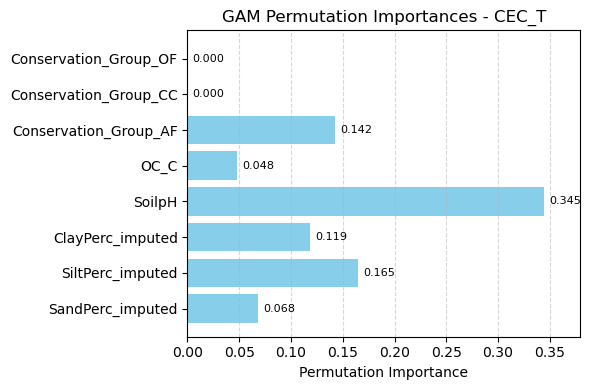

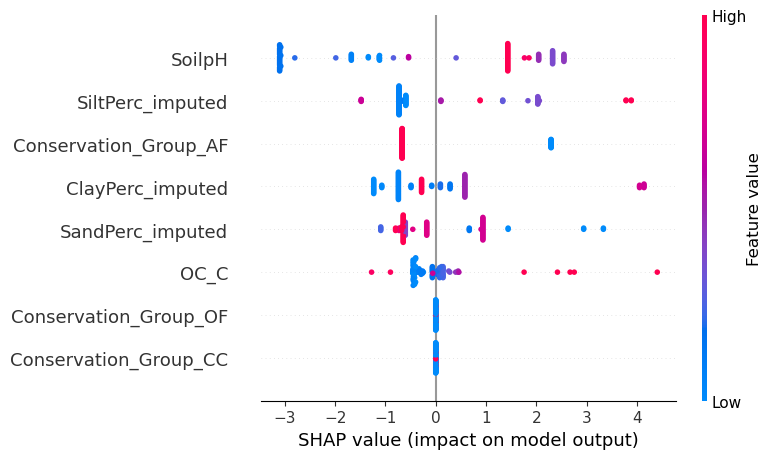

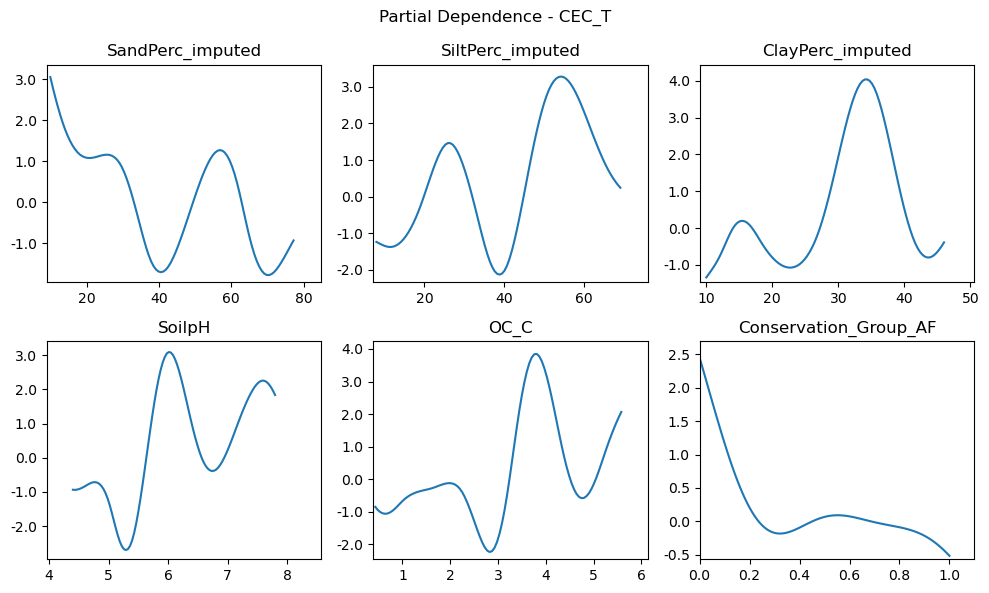

Predictors: SandPerc_imputed SiltPerc_imputed ClayPerc_imputed SoilpH OC_C Conservation_Group
Train set: CEC_C | Dataset Shape: (93, 8)
Test set: CEC_T | Dataset Shape: (93, 8)
                              Model    MAE   RMSE     R²
0           Multi Linear Regression  1.929  2.748  0.754
1                  Ridge Regression  1.954  2.778  0.749
2         Support Vector Regression  1.181  1.907  0.882
3                    KNN Regression  1.166  1.715  0.904
4          Decision Tree Regression  1.171  1.727  0.903
5          Random Forest Regression  1.236  1.860  0.887
6  XGBoost Random Forest Regression  1.166  1.715  0.904
7                XGBoost Regression  1.165  1.715  0.904
8        Generalized Additive Model  1.127  1.742  0.901


In [175]:
soil_health_prediction_models(df3, ['SandPerc_imputed', 'SiltPerc_imputed', 'ClayPerc_imputed', 'SoilpH', 'OC_C', 'Conservation_Group'], 'CEC_C', 'CEC_T', 'Conservation_Group')

### BD

Separate train/test sets used.

Predictors: SandPerc_imputed SiltPerc_imputed ClayPerc_imputed OC_C
Train set: BD_C | Shape: (503, 4)
Test set: BD_T | Shape: (503, 4)

Multi Linear Regression

MAE: 0.106
RMSE: 0.14
R²: 0.336


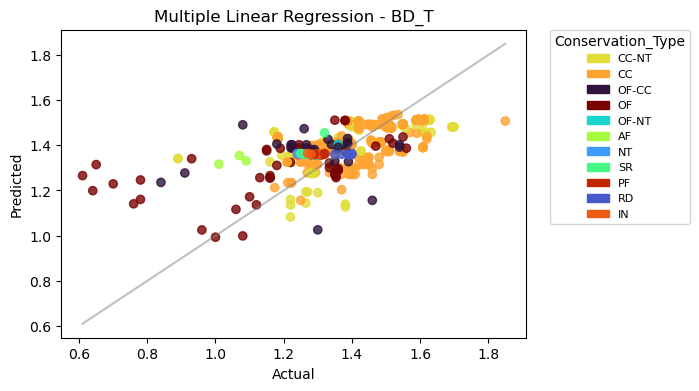

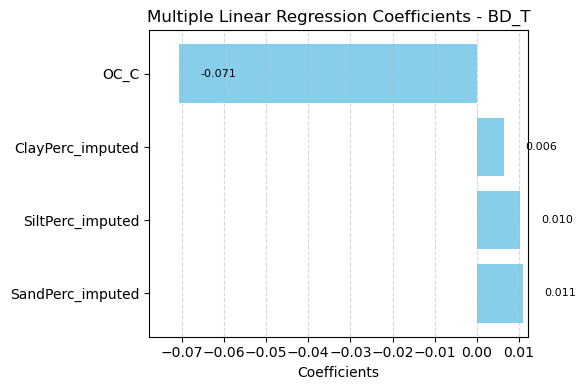

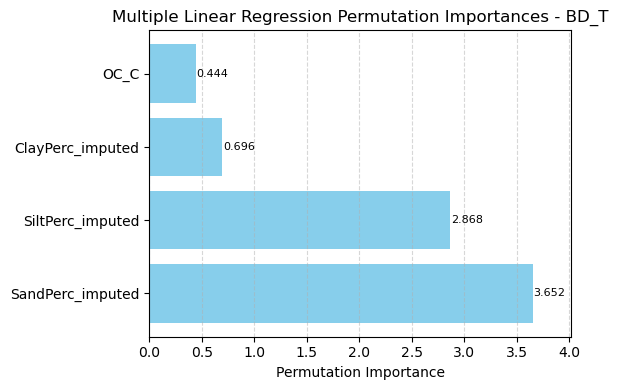

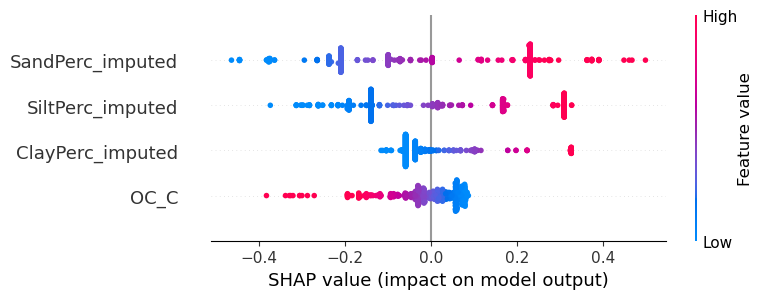


Ridge Regression

MAE: 0.106
RMSE: 0.14
R²: 0.336


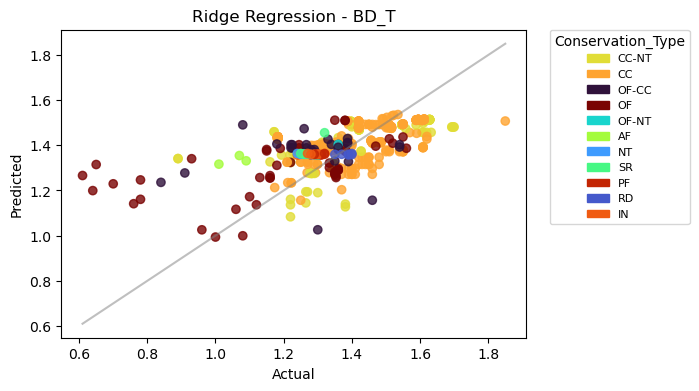

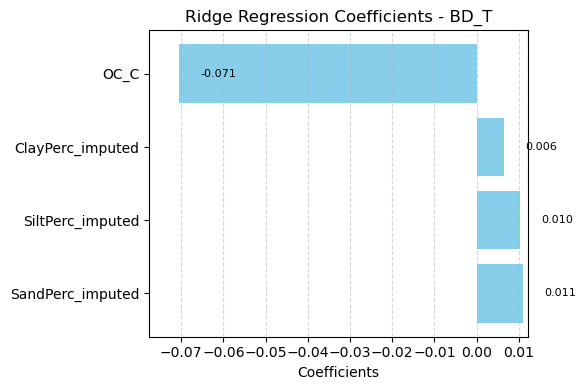

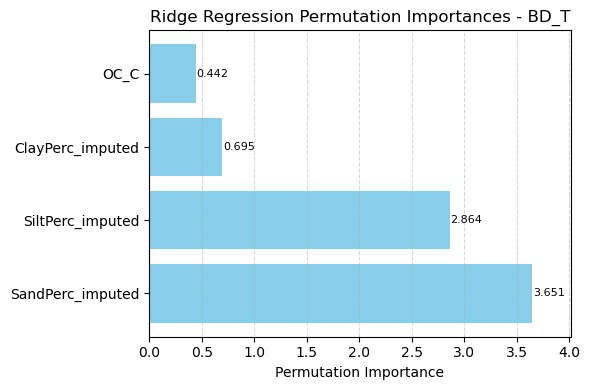

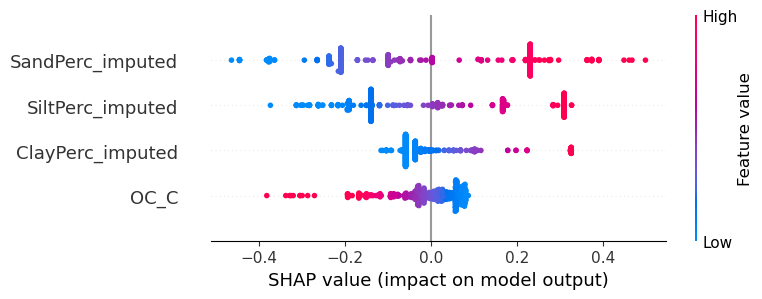


Support Vector Regression

MAE: 0.081
RMSE: 0.104
R²: 0.636


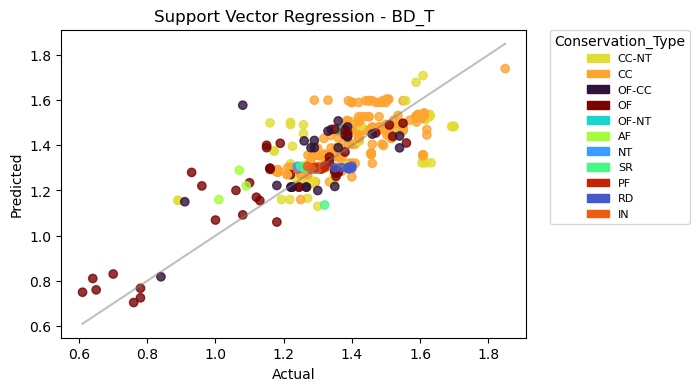

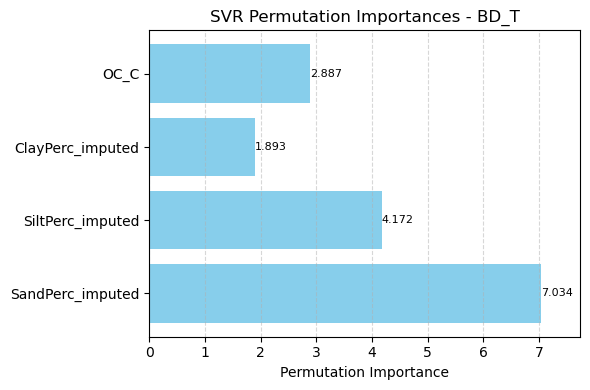

Using 503 background data samples could cause slower run times. Consider using shap.sample(data, K) or shap.kmeans(data, K) to summarize the background as K samples.


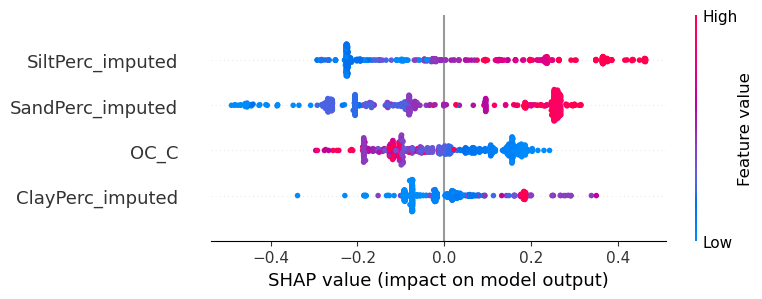


KNN Regression

MAE: 0.037
RMSE: 0.063
R²: 0.865


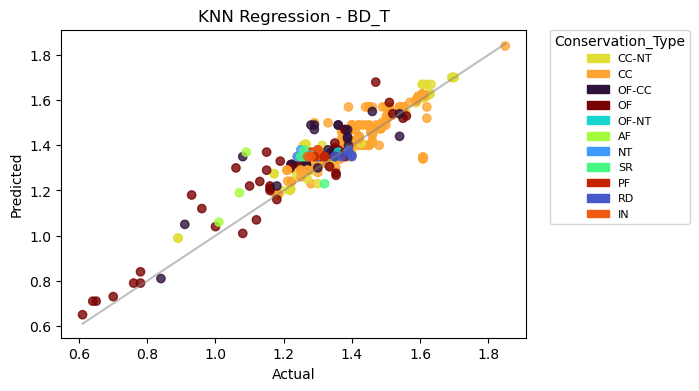

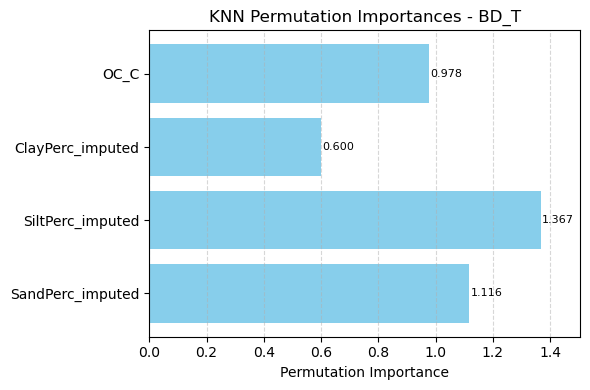

Using 503 background data samples could cause slower run times. Consider using shap.sample(data, K) or shap.kmeans(data, K) to summarize the background as K samples.


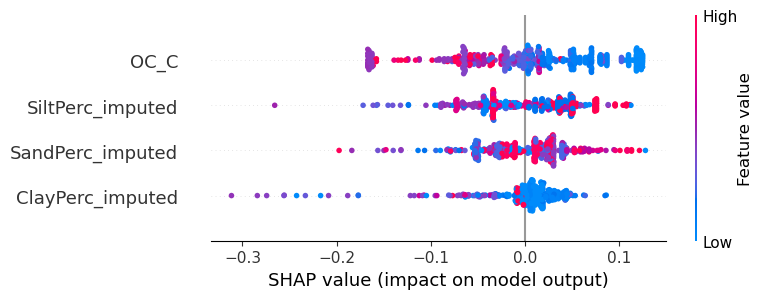


Decision Tree Regression

MAE: 0.049
RMSE: 0.076
R²: 0.802


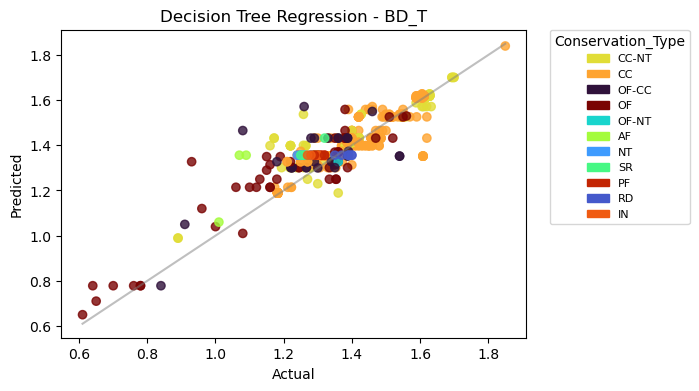

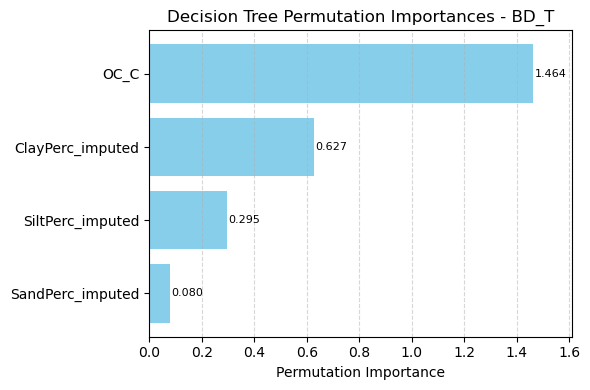

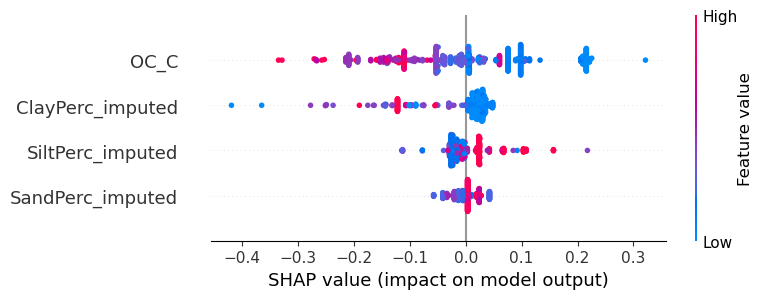


Random Forest Regression

MAE: 0.049
RMSE: 0.076
R²: 0.802


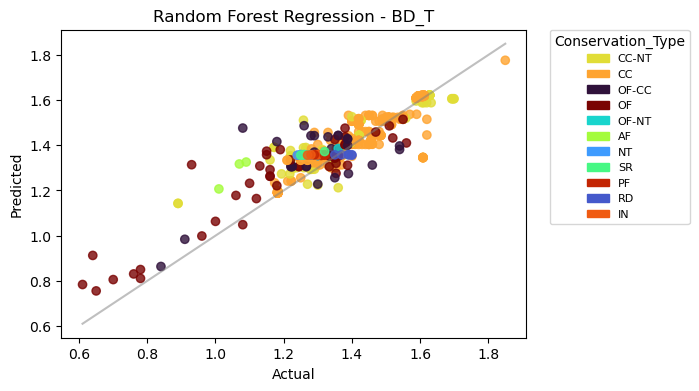

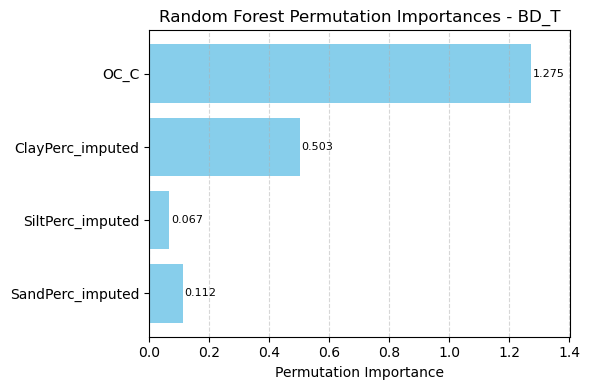

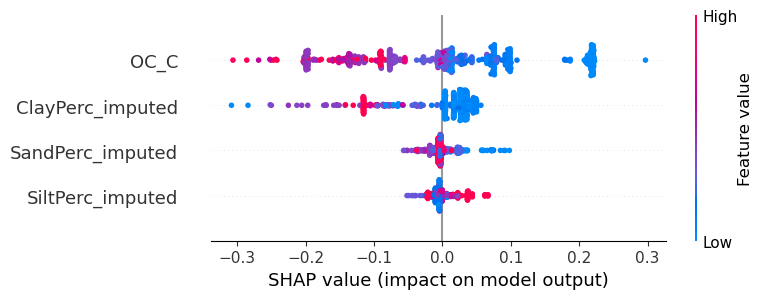


XGBoost Random Forest Regression

MAE: 0.037
RMSE: 0.063
R²: 0.864


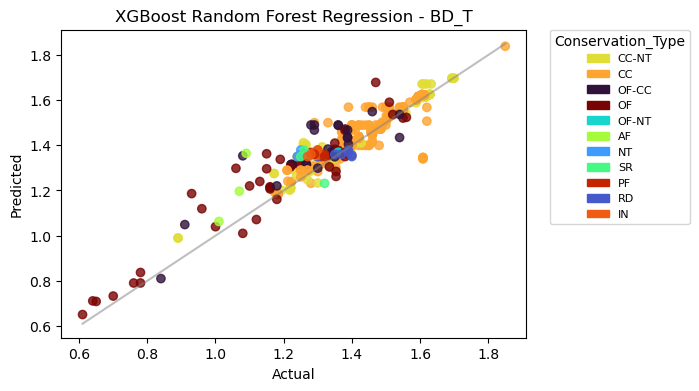

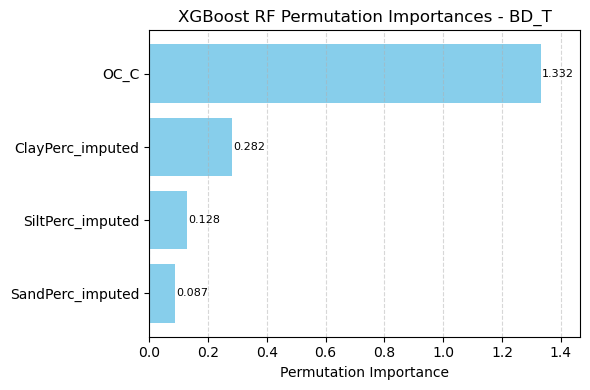

* SHAP does not support XGBoost random forest mode (num_parallel_tree > 1). Skipping SHAP plot.

XGBoost Regression

MAE: 0.037
RMSE: 0.063
R²: 0.864


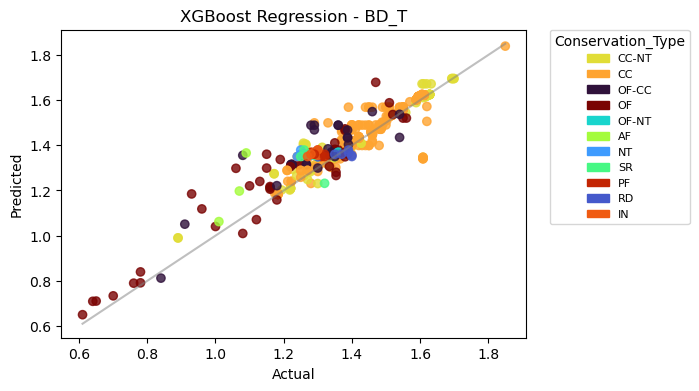

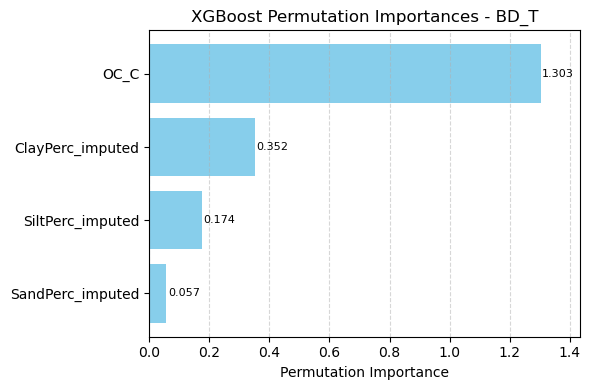

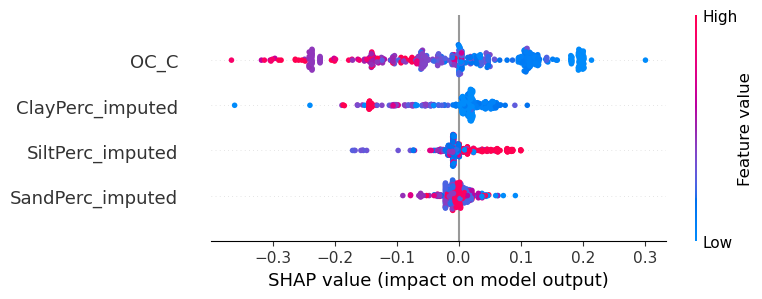


Generalized Additive Model

MAE: 0.082
RMSE: 0.106
R²: 0.621


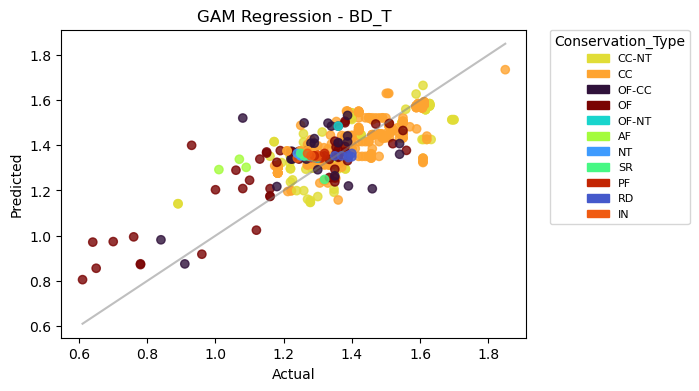

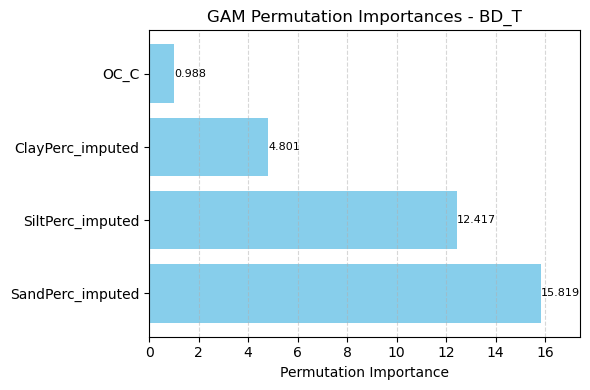

Using 503 background data samples could cause slower run times. Consider using shap.sample(data, K) or shap.kmeans(data, K) to summarize the background as K samples.


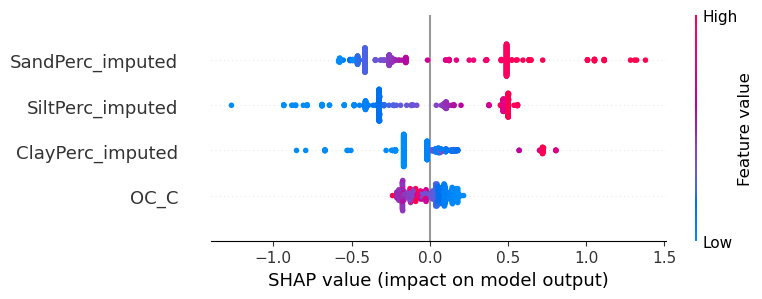

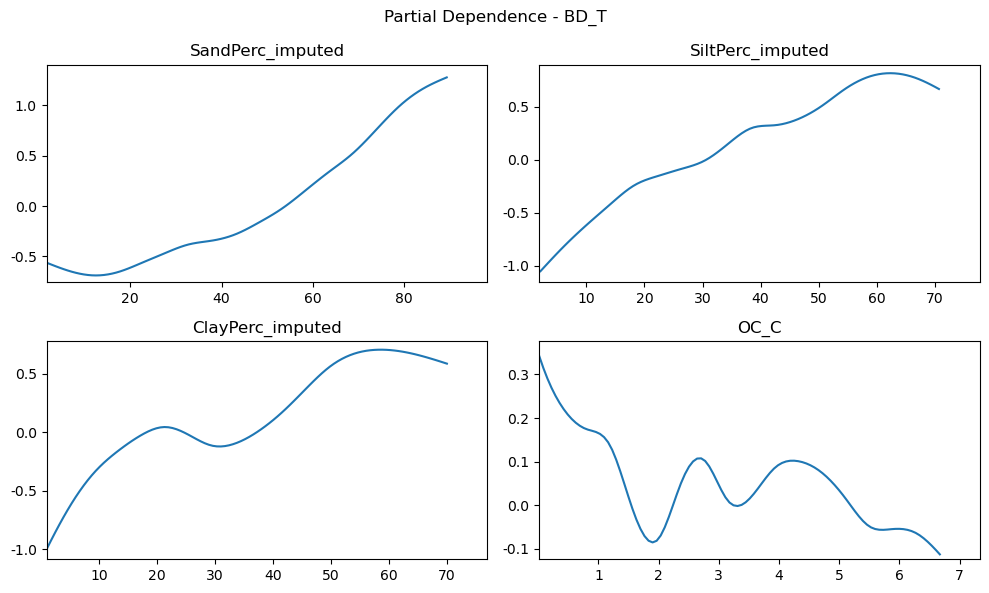

Predictors: SandPerc_imputed SiltPerc_imputed ClayPerc_imputed OC_C
Train set: BD_C | Dataset Shape: (503, 4)
Test set: BD_T | Dataset Shape: (503, 4)
                              Model    MAE   RMSE     R²
0           Multi Linear Regression  0.106  0.140  0.336
1                  Ridge Regression  0.106  0.140  0.336
2         Support Vector Regression  0.081  0.104  0.636
3                    KNN Regression  0.037  0.063  0.865
4          Decision Tree Regression  0.049  0.076  0.802
5          Random Forest Regression  0.049  0.076  0.802
6  XGBoost Random Forest Regression  0.037  0.063  0.864
7                XGBoost Regression  0.037  0.063  0.864
8        Generalized Additive Model  0.082  0.106  0.621


In [176]:
soil_health_prediction_models(df3, ['SandPerc_imputed', 'SiltPerc_imputed', 'ClayPerc_imputed', 'OC_C'], 'BD_C', 'BD_T', 'Conservation_Type')

### BD (Conservation Group)

Separate train/test sets used.

Predictors: SandPerc_imputed SiltPerc_imputed ClayPerc_imputed SoilpH OC_C Conservation_Group
Train set: BD_C | Shape: (153, 8)
Test set: BD_T | Shape: (153, 8)

Multi Linear Regression

MAE: 0.083
RMSE: 0.124
R²: 0.614


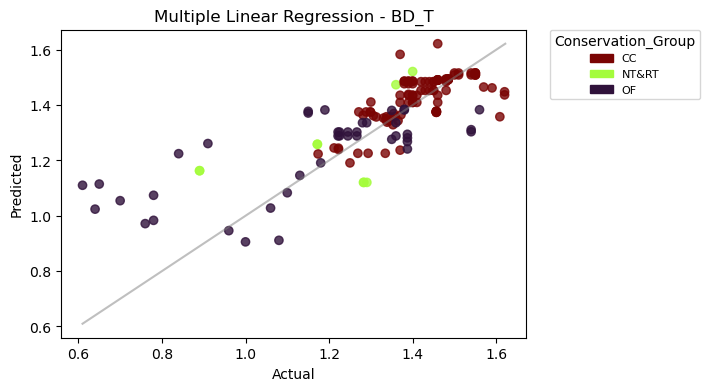

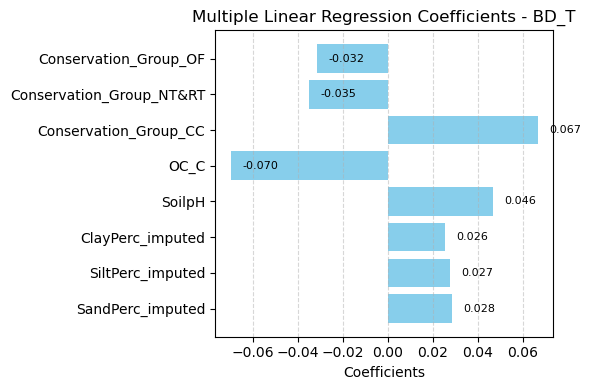

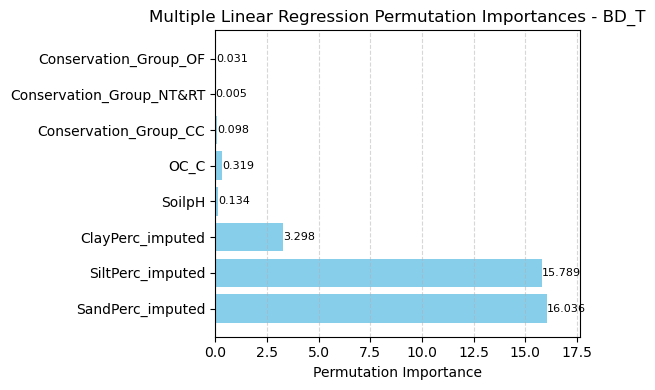

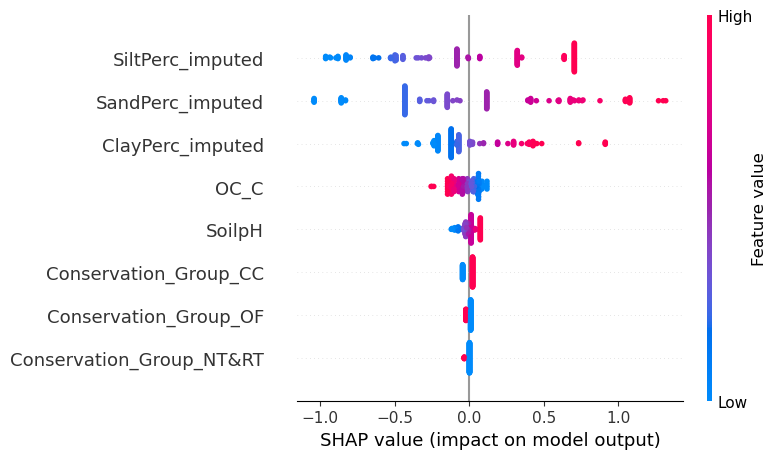


Ridge Regression

MAE: 0.083
RMSE: 0.125
R²: 0.613


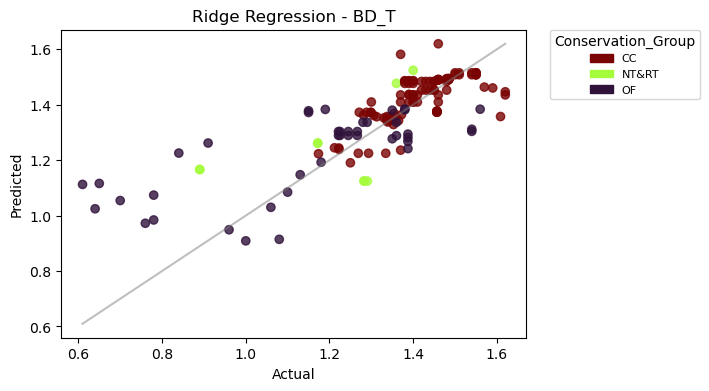

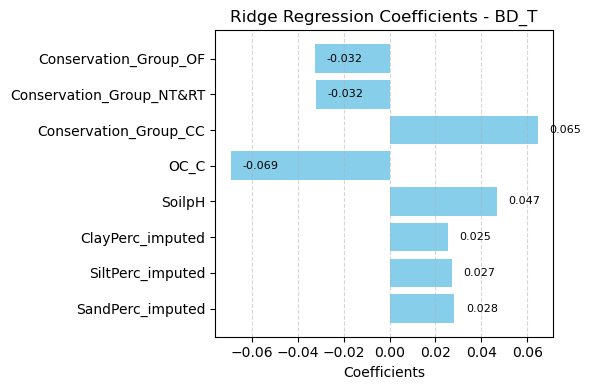

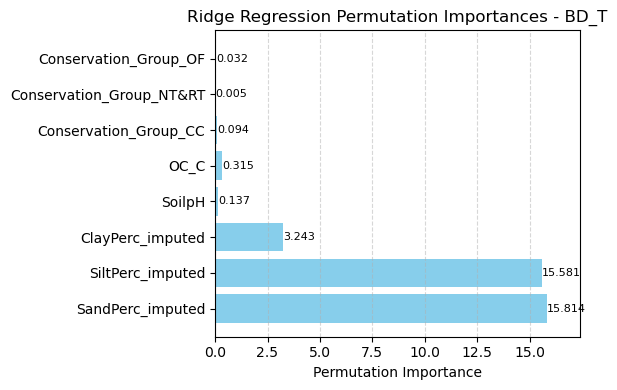

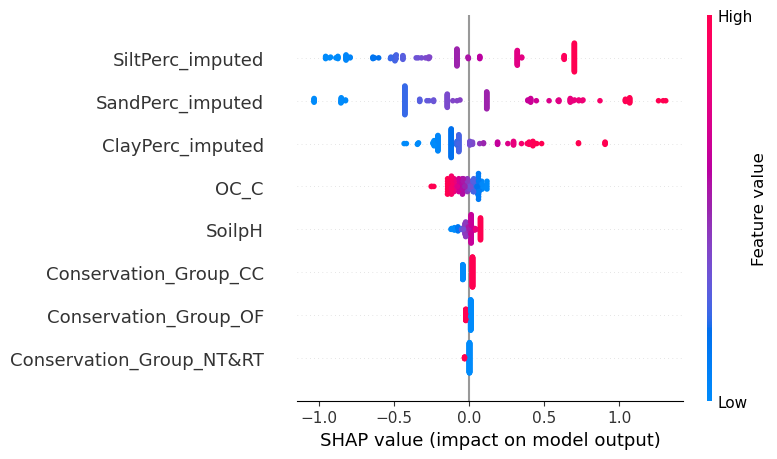


Support Vector Regression

MAE: 0.069
RMSE: 0.088
R²: 0.805


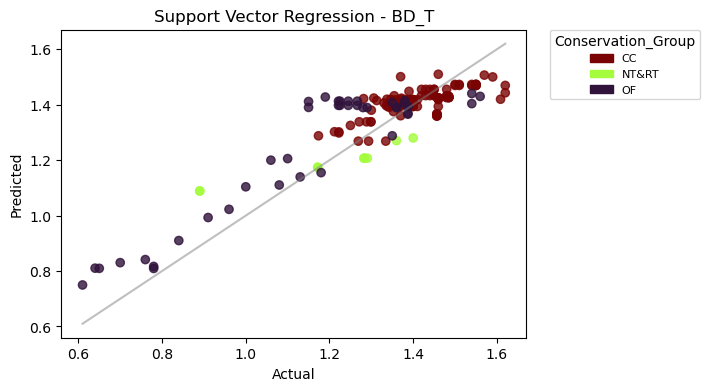

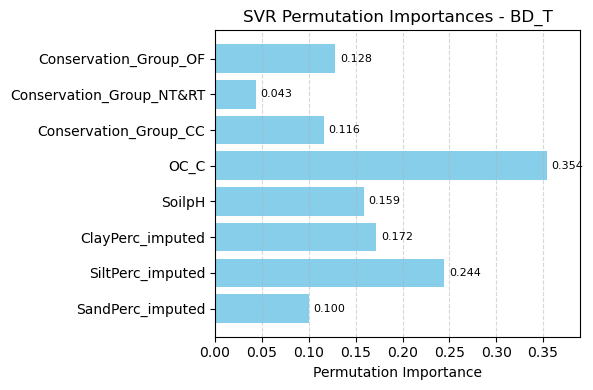

Using 153 background data samples could cause slower run times. Consider using shap.sample(data, K) or shap.kmeans(data, K) to summarize the background as K samples.


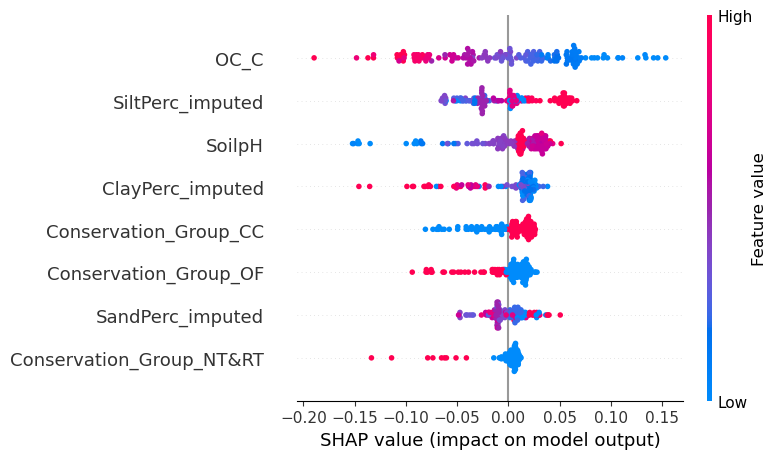


KNN Regression

MAE: 0.046
RMSE: 0.067
R²: 0.888


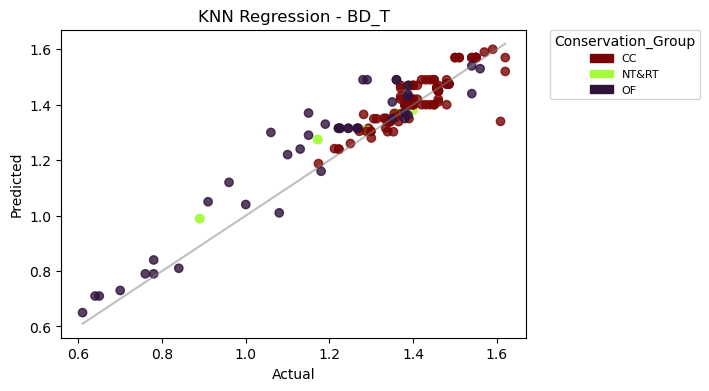

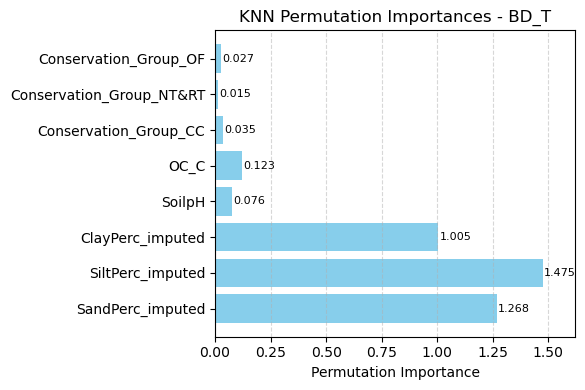

Using 153 background data samples could cause slower run times. Consider using shap.sample(data, K) or shap.kmeans(data, K) to summarize the background as K samples.


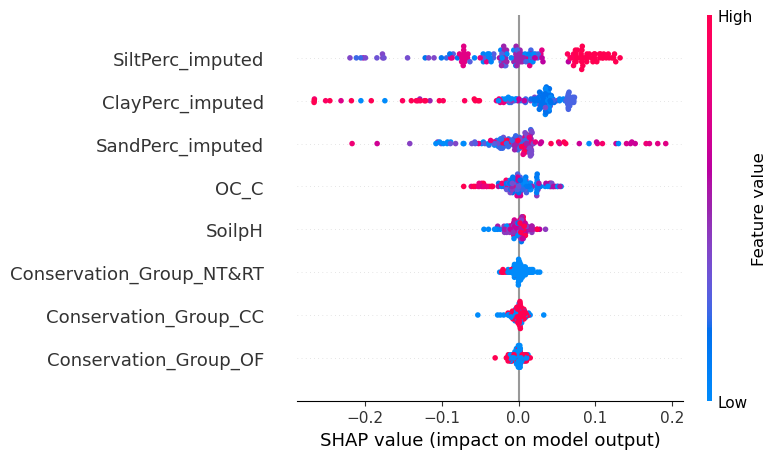


Decision Tree Regression

MAE: 0.056
RMSE: 0.078
R²: 0.85


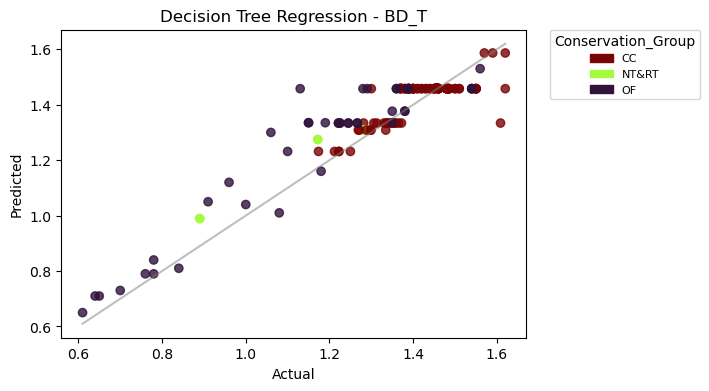

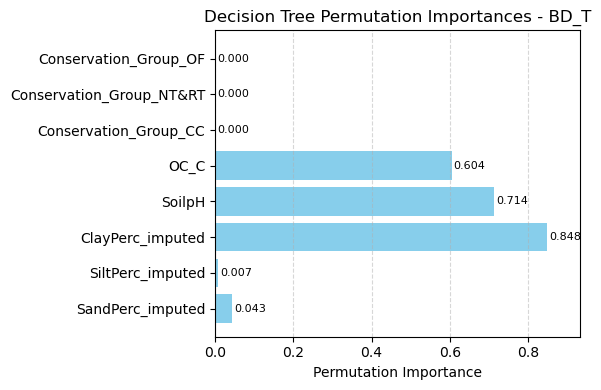

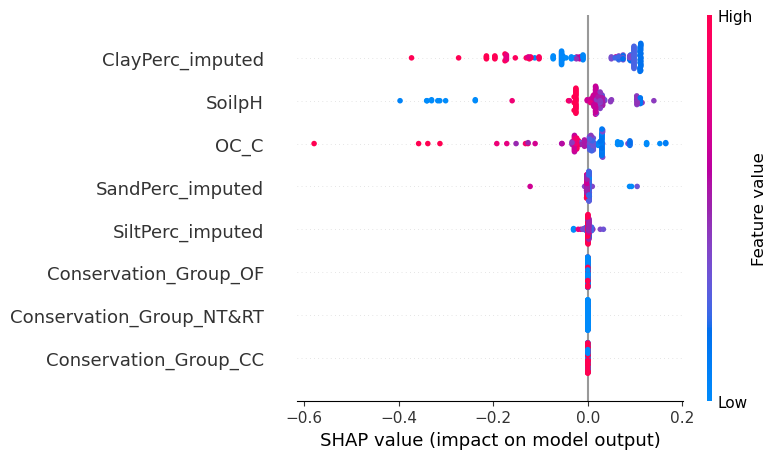


Random Forest Regression

MAE: 0.053
RMSE: 0.075
R²: 0.861


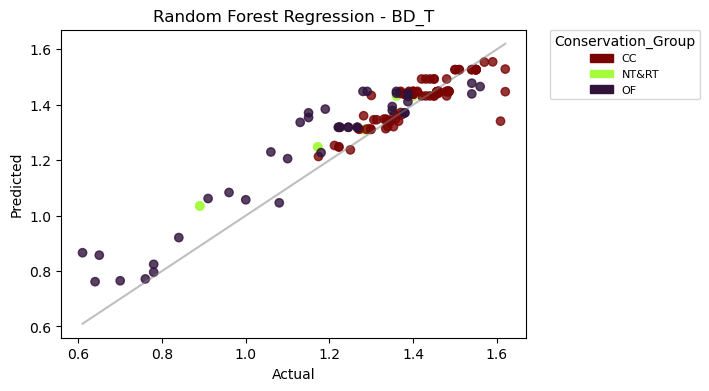

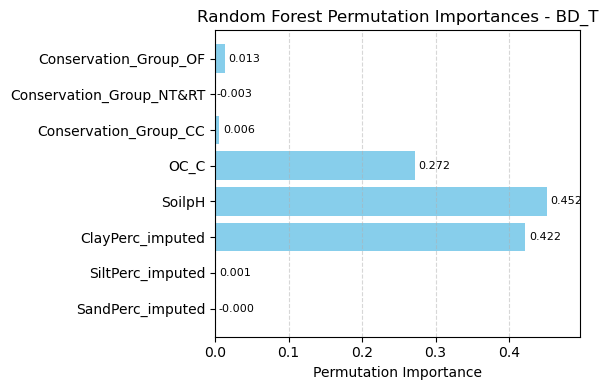

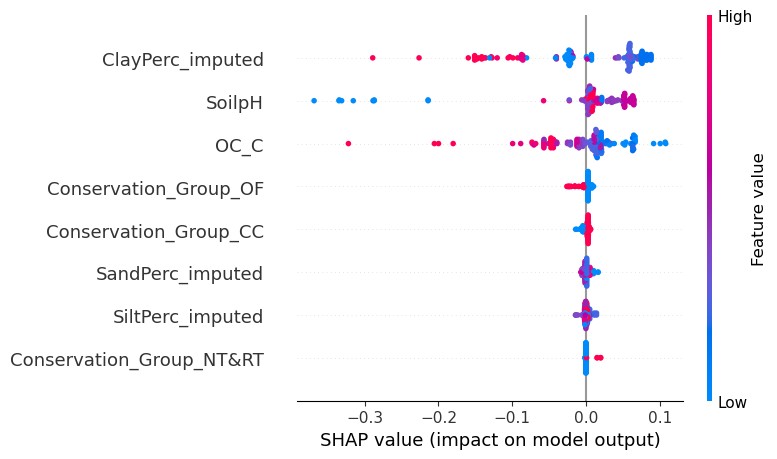


XGBoost Random Forest Regression

MAE: 0.046
RMSE: 0.067
R²: 0.888


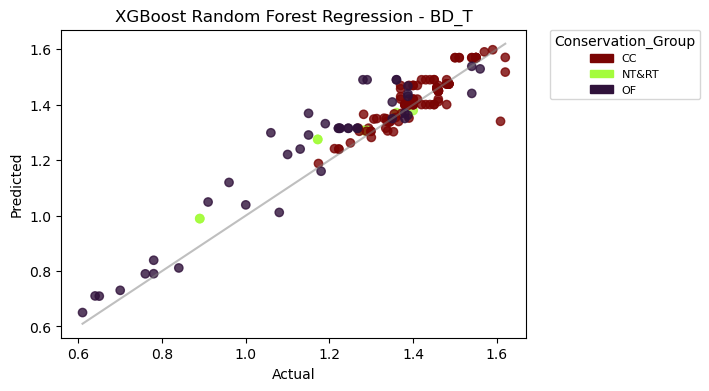

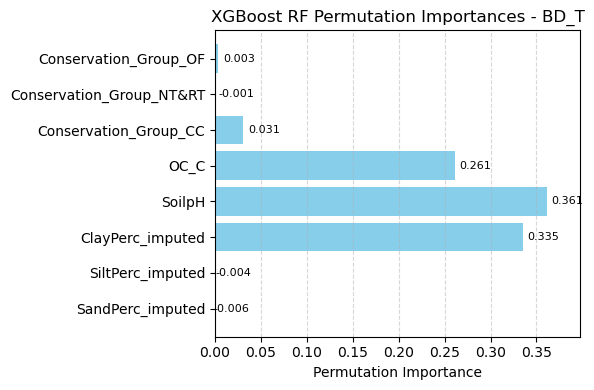

* SHAP does not support XGBoost random forest mode (num_parallel_tree > 1). Skipping SHAP plot.

XGBoost Regression

MAE: 0.046
RMSE: 0.067
R²: 0.888


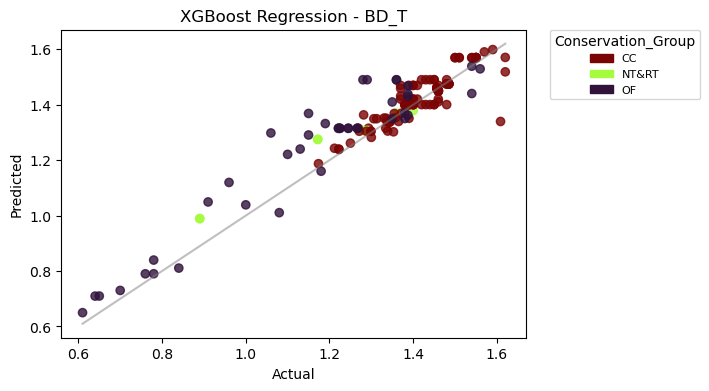

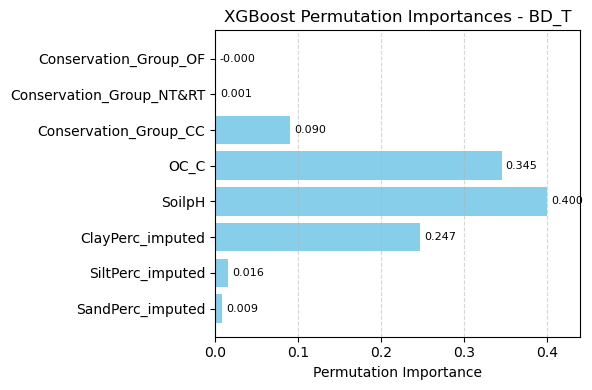

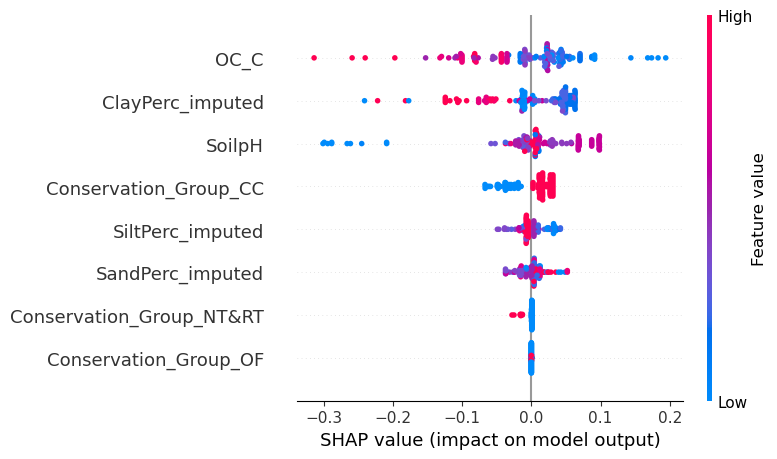


Generalized Additive Model

MAE: 0.051
RMSE: 0.071
R²: 0.875


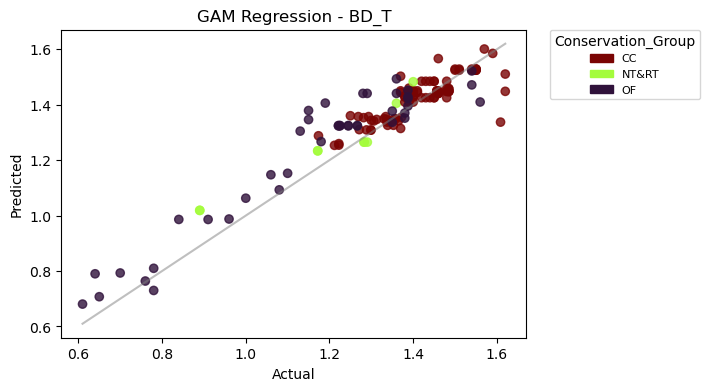

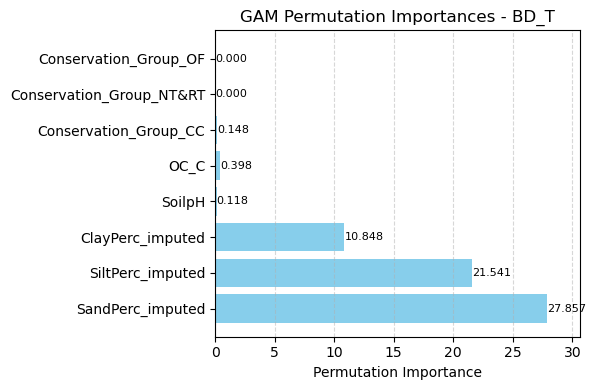

Using 153 background data samples could cause slower run times. Consider using shap.sample(data, K) or shap.kmeans(data, K) to summarize the background as K samples.


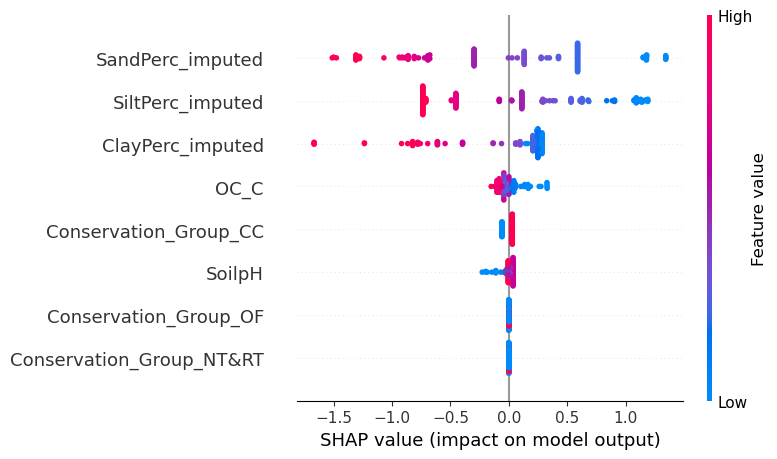

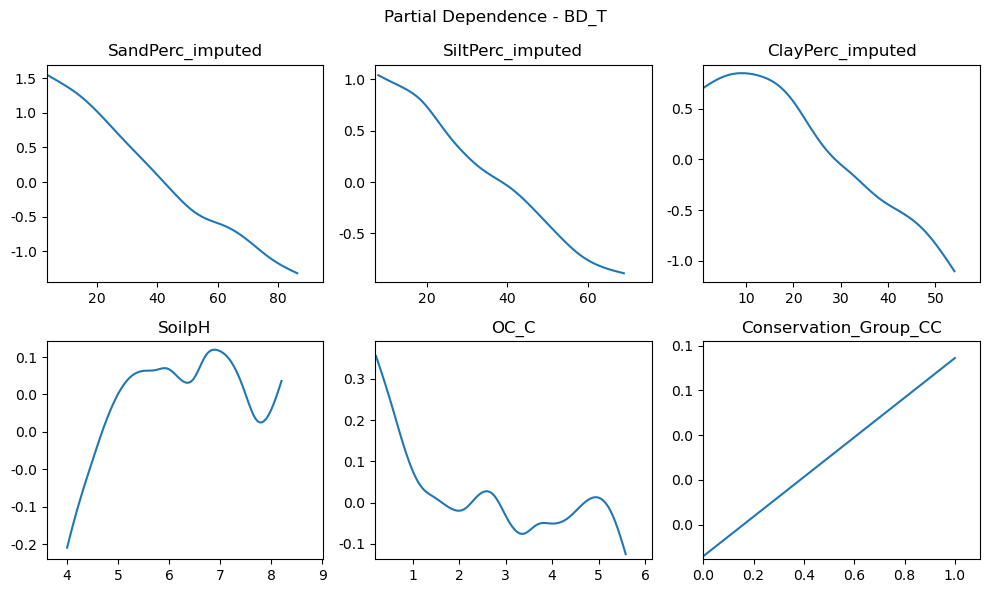

Predictors: SandPerc_imputed SiltPerc_imputed ClayPerc_imputed SoilpH OC_C Conservation_Group
Train set: BD_C | Dataset Shape: (153, 8)
Test set: BD_T | Dataset Shape: (153, 8)
                              Model    MAE   RMSE     R²
0           Multi Linear Regression  0.083  0.124  0.614
1                  Ridge Regression  0.083  0.125  0.613
2         Support Vector Regression  0.069  0.088  0.805
3                    KNN Regression  0.046  0.067  0.888
4          Decision Tree Regression  0.056  0.078  0.850
5          Random Forest Regression  0.053  0.075  0.861
6  XGBoost Random Forest Regression  0.046  0.067  0.888
7                XGBoost Regression  0.046  0.067  0.888
8        Generalized Additive Model  0.051  0.071  0.875


In [177]:
soil_health_prediction_models(df3, ['SandPerc_imputed', 'SiltPerc_imputed', 'ClayPerc_imputed', 'SoilpH', 'OC_C', 'Conservation_Group'], 'BD_C', 'BD_T', 'Conservation_Group')

## Train Ratio Test Ratio

### CEC (Conservation Group)

Random split (80/20) and 5-fold cross-validation used.

Predictors: SandPerc_imputed SiltPerc_imputed ClayPerc_imputed OC_C Conservation_Group
Dataset Shape: (116, 7)
Train set: CEC_ratio | Shape: (92, 7)
Test set: CEC_ratio | Shape: (24, 7)

Multi Linear Regression

Cross-validated MAE (mean ± std): 0.217 ± -0.047
Cross-validated RMSE (mean ± std): 0.278 ± -0.047
Cross-validated R² (mean ± std): 0.134 ± 0.109


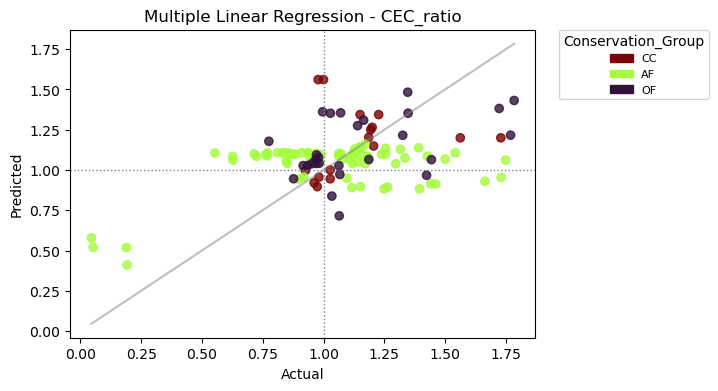

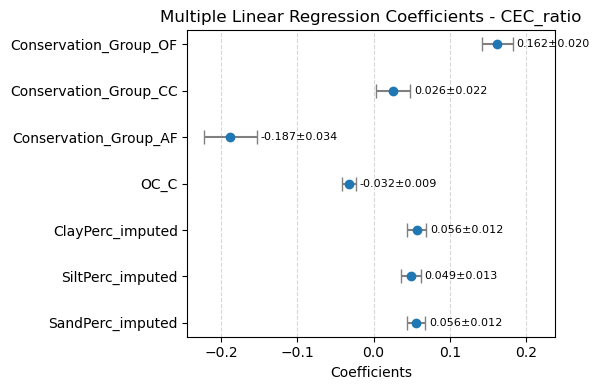

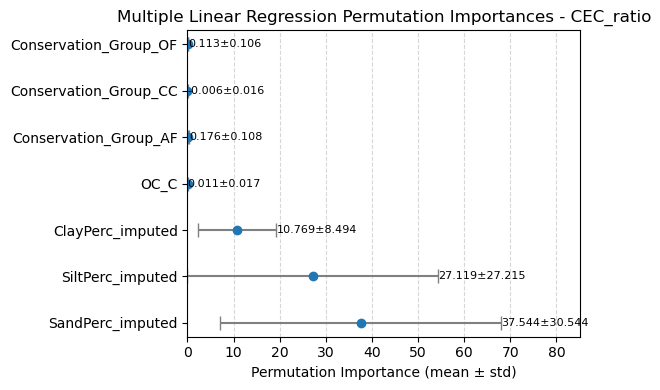

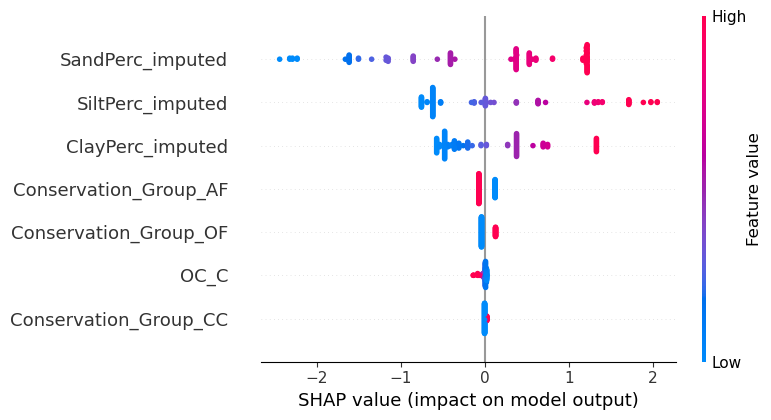


Ridge Regression

Cross-validated MAE (mean ± std): 0.217 ± -0.048
Cross-validated RMSE (mean ± std): 0.278 ± -0.048
Cross-validated R² (mean ± std): 0.137 ± 0.108


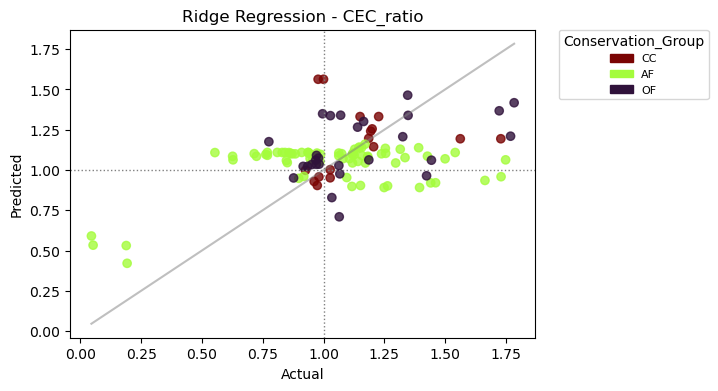

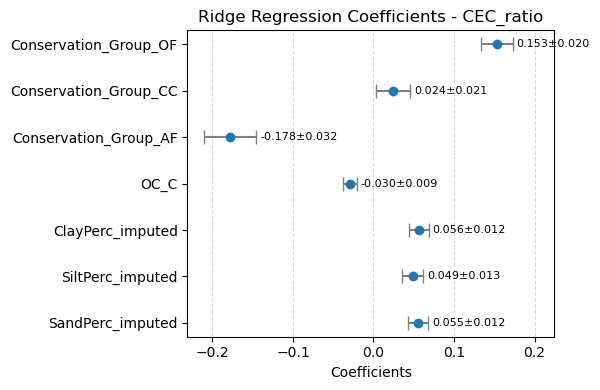

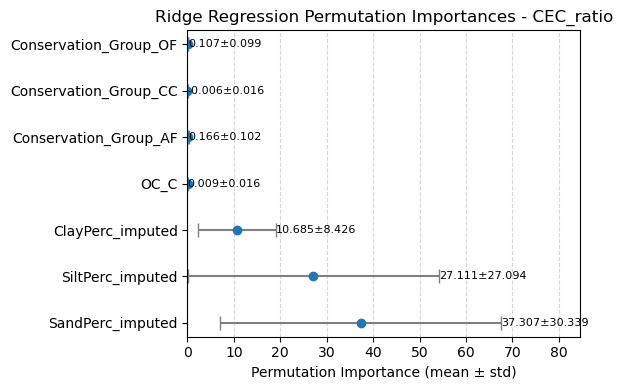

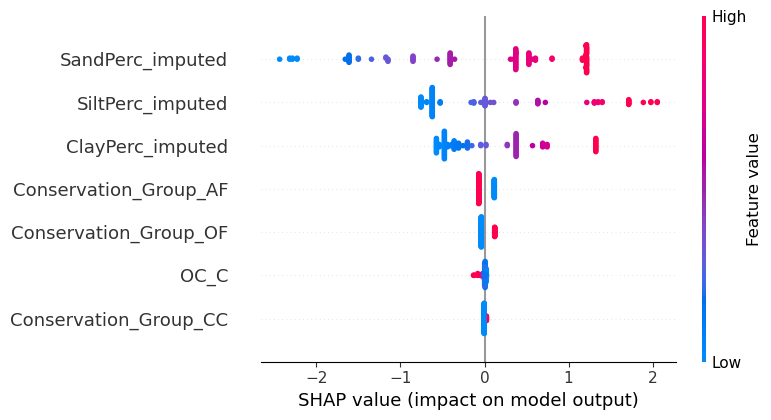


Support Vector Regression

Cross-validated MAE (mean ± std): 0.143 ± -0.038
Cross-validated RMSE (mean ± std): 0.204 ± -0.05
Cross-validated R² (mean ± std): 0.54 ± 0.1


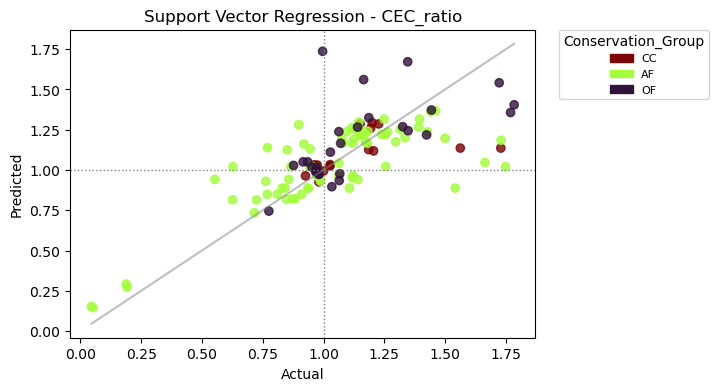

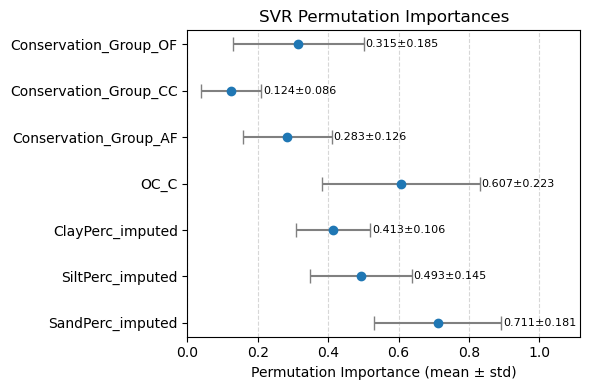

Using 116 background data samples could cause slower run times. Consider using shap.sample(data, K) or shap.kmeans(data, K) to summarize the background as K samples.


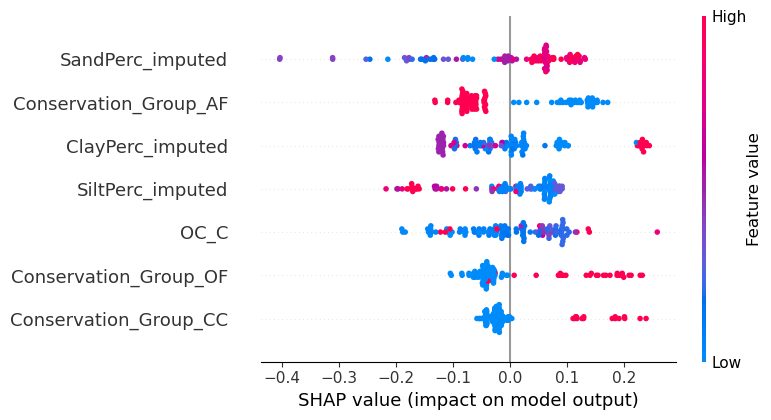


KNN Regression

Cross-validated MAE (mean ± std): 0.151 ± -0.047
Cross-validated RMSE (mean ± std): 0.221 ± -0.047
Cross-validated R² (mean ± std): 0.406 ± 0.302


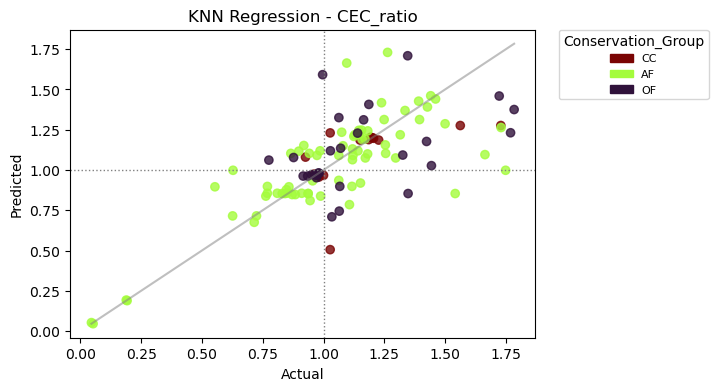

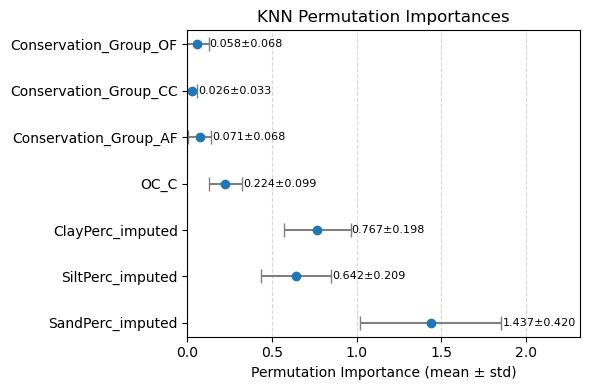

Using 116 background data samples could cause slower run times. Consider using shap.sample(data, K) or shap.kmeans(data, K) to summarize the background as K samples.


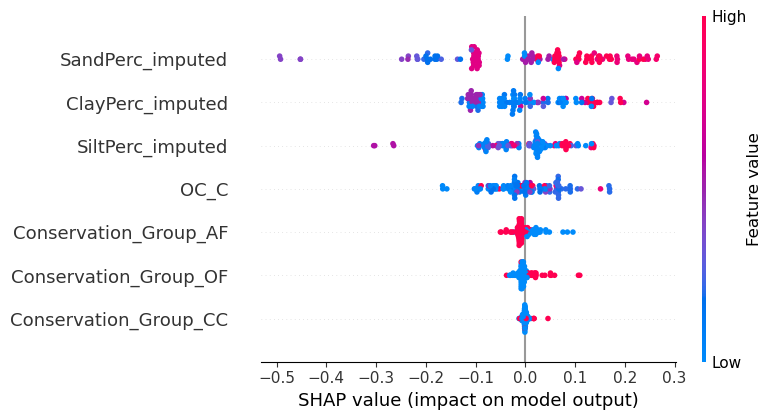


Decision Tree Regression

Cross-validated MAE (mean ± std): 0.167 ± -0.039
Cross-validated RMSE (mean ± std): 0.248 ± -0.039
Cross-validated R² (mean ± std): 0.282 ± 0.239


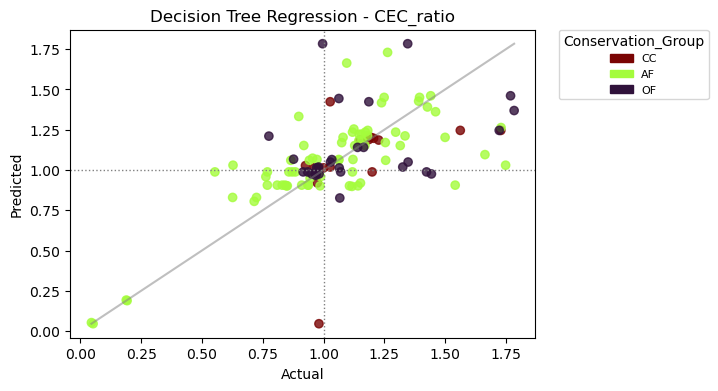

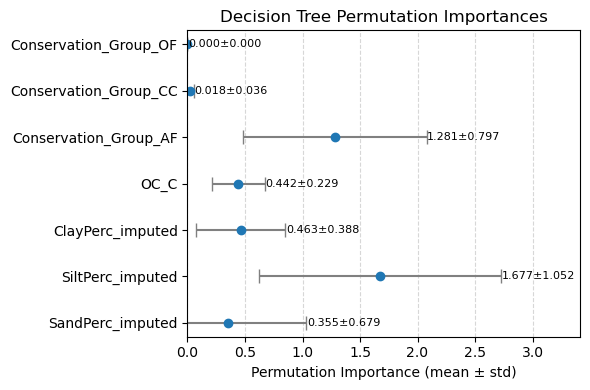

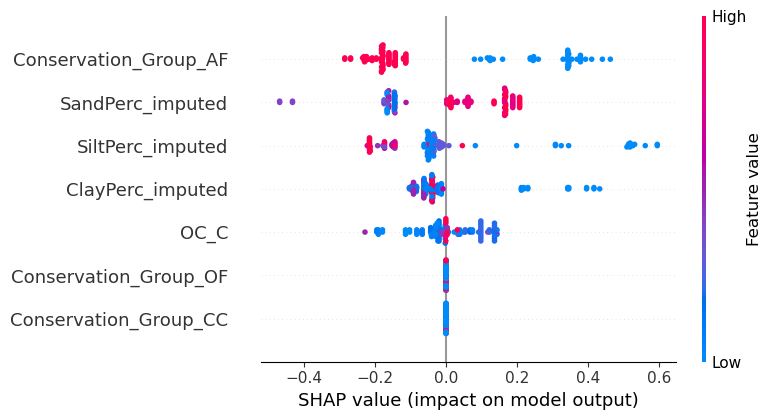


Random Forest Regression

Cross-validated MAE (mean ± std): 0.15 ± -0.047
Cross-validated RMSE (mean ± std): 0.212 ± -0.047
Cross-validated R² (mean ± std): 0.484 ± 0.197


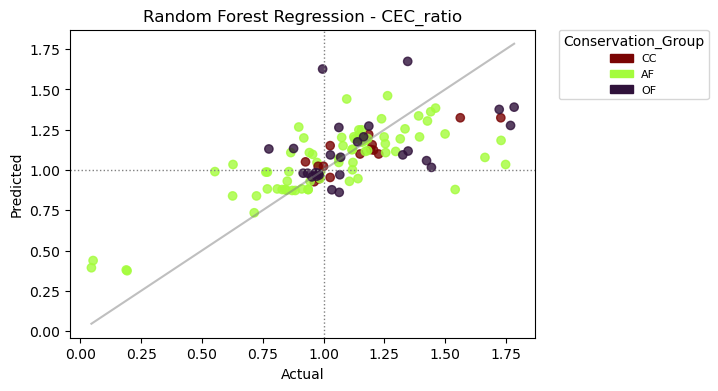

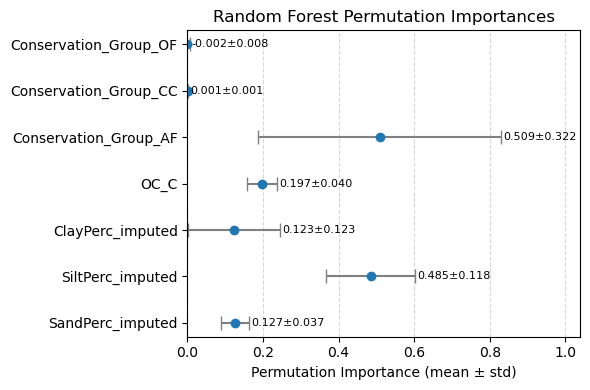

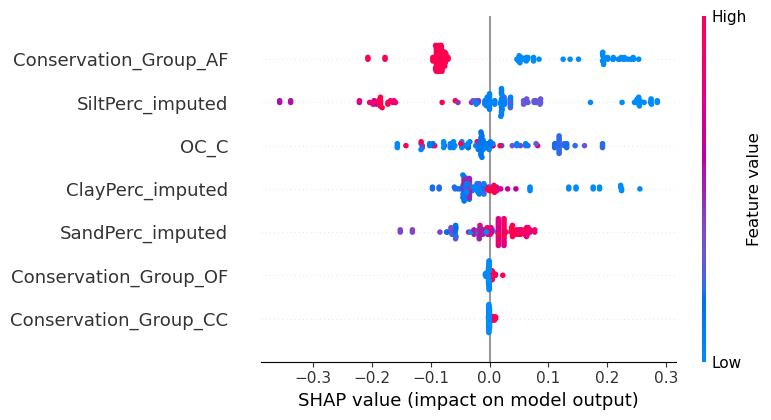


XGBoost Random Forest Regression

Cross-validated MAE (mean ± std): 0.145 ± -0.035
Cross-validated RMSE (mean ± std): 0.219 ± -0.035
Cross-validated R² (mean ± std): 0.429 ± 0.226


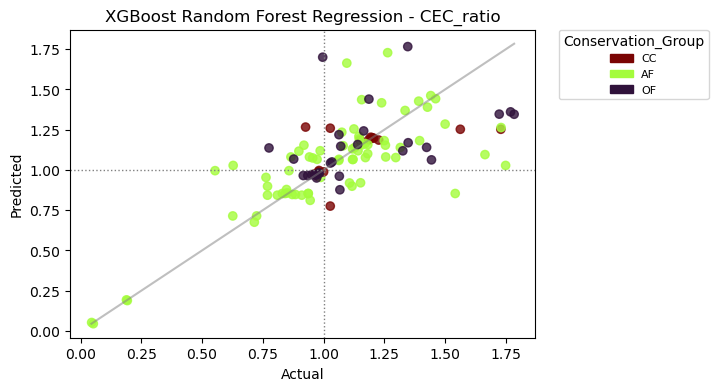

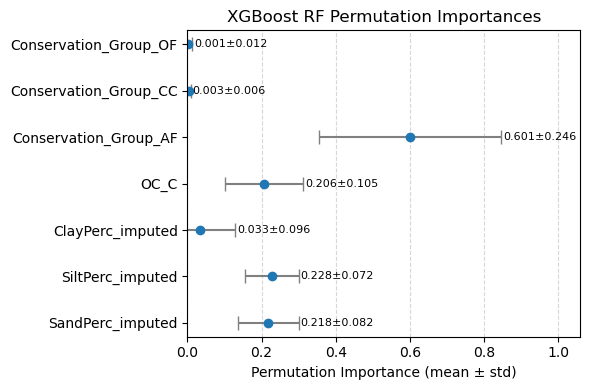

* SHAP does not support XGBoost random forest mode (num_parallel_tree > 1). Skipping SHAP plot.

XGBoost Regression

Cross-validated MAE (mean ± std): 0.145 ± -0.034
Cross-validated RMSE (mean ± std): 0.221 ± -0.034
Cross-validated R² (mean ± std): 0.422 ± 0.221


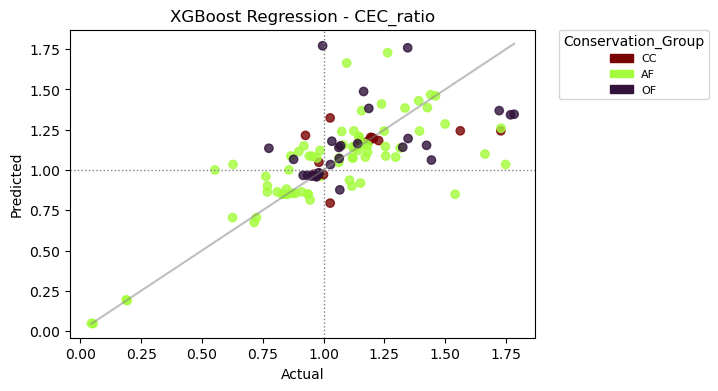

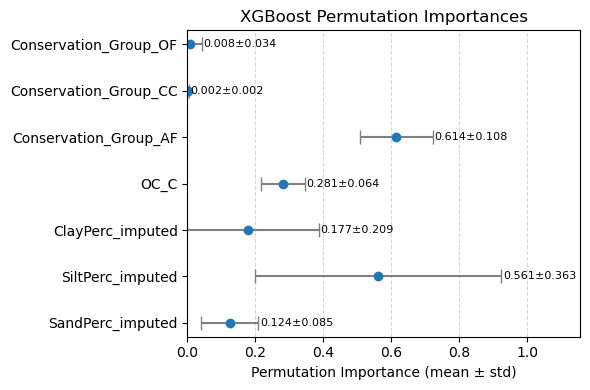

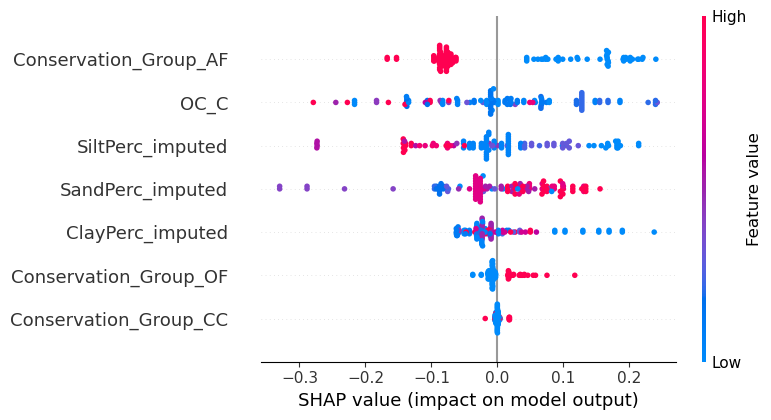


Generalized Additive Model

Cross-validated MAE (mean ± std): 0.154 ± 0.03
Cross-validated RMSE (mean ± std): 0.207 ± 0.041
Cross-validated R² (mean ± std): 0.52 ± 0.089


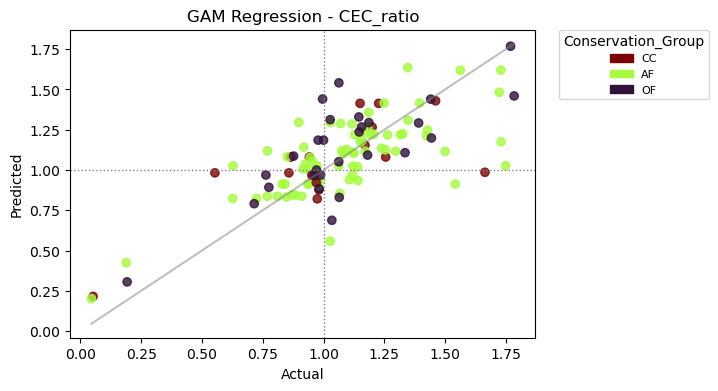

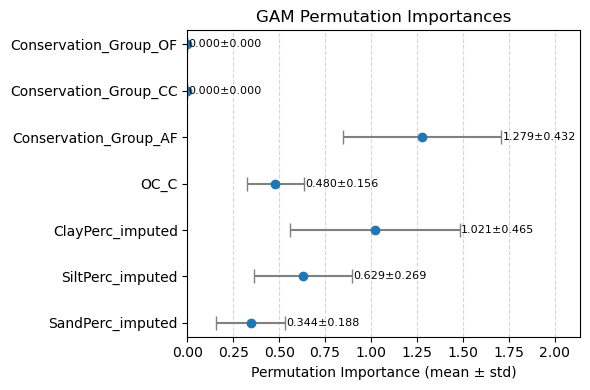

Using 116 background data samples could cause slower run times. Consider using shap.sample(data, K) or shap.kmeans(data, K) to summarize the background as K samples.


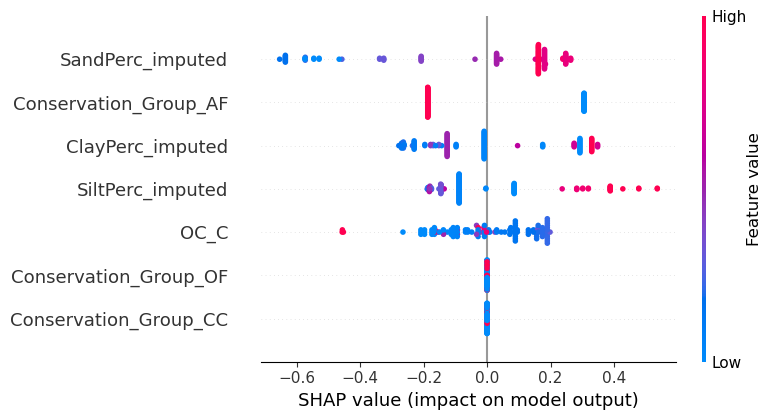

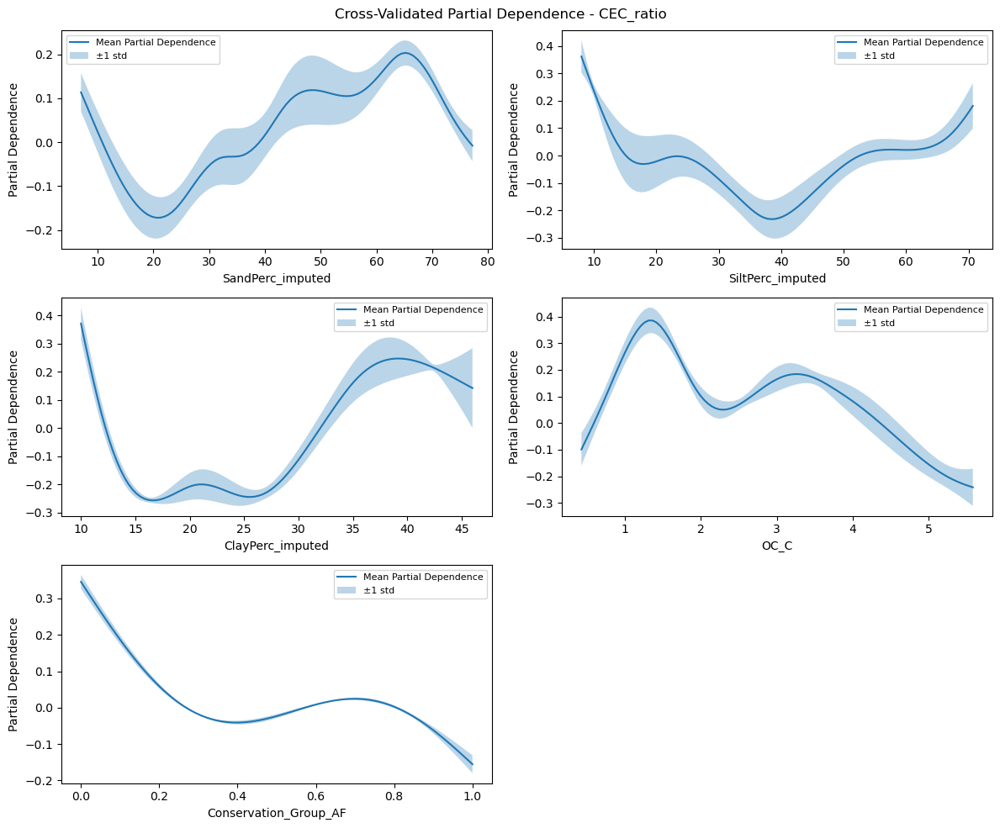

Predictors: SandPerc_imputed SiltPerc_imputed ClayPerc_imputed OC_C Conservation_Group
Dataset Shape: (116, 7)
Train set: CEC_ratio | Dataset Shape: (92, 7)
Test set: CEC_ratio | Dataset Shape: (24, 7)
                              Model Cross-validated MAE (mean ± std)  \
0           Multi Linear Regression                   0.217 ± -0.030   
1                  Ridge Regression                   0.217 ± -0.031   
2         Support Vector Regression                   0.143 ± -0.038   
3                    KNN Regression                   0.151 ± -0.036   
4          Decision Tree Regression                   0.167 ± -0.028   
5          Random Forest Regression                   0.150 ± -0.033   
6  XGBoost Random Forest Regression                   0.145 ± -0.029   
7                XGBoost Regression                   0.145 ± -0.028   
8        Generalized Additive Model                  -0.154 ± -0.030   

  Cross-validated RMSE (mean ± std) Cross-validated R² (mean ± std)  
0      

In [178]:
soil_health_prediction_models(df3, ['SandPerc_imputed', 'SiltPerc_imputed', 'ClayPerc_imputed', 'OC_C', 'Conservation_Group'], 'CEC_ratio', 'CEC_ratio', 'Conservation_Group')

### CEC (Conservation Type)

Random split (80/20) and 5-fold cross-validation used.

Predictors: SandPerc_imputed SiltPerc_imputed ClayPerc_imputed OC_C Conservation_Type
Dataset Shape: (116, 8)
Train set: CEC_ratio | Shape: (92, 8)
Test set: CEC_ratio | Shape: (24, 8)

Multi Linear Regression

Cross-validated MAE (mean ± std): 0.215 ± -0.051
Cross-validated RMSE (mean ± std): 0.278 ± -0.051
Cross-validated R² (mean ± std): 0.133 ± 0.141


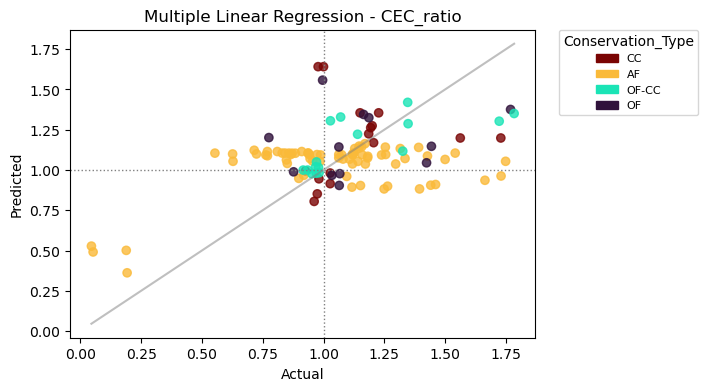

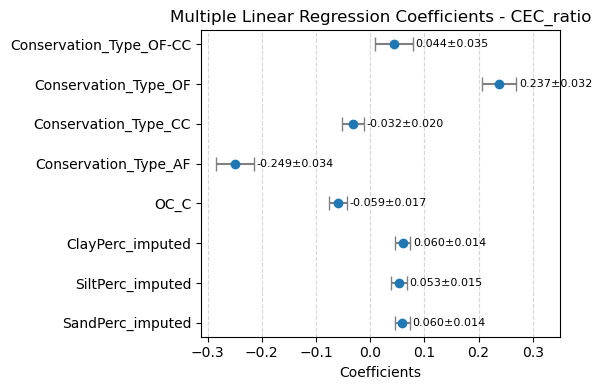

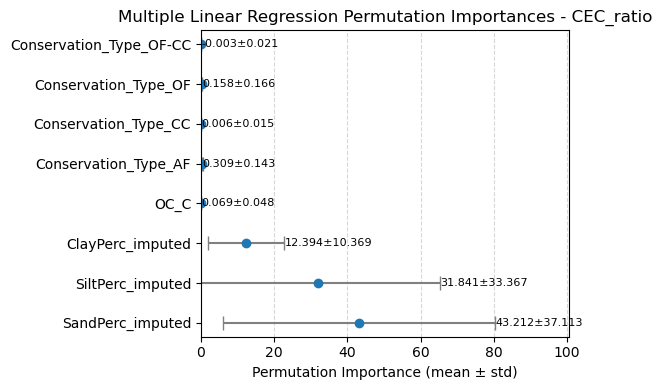

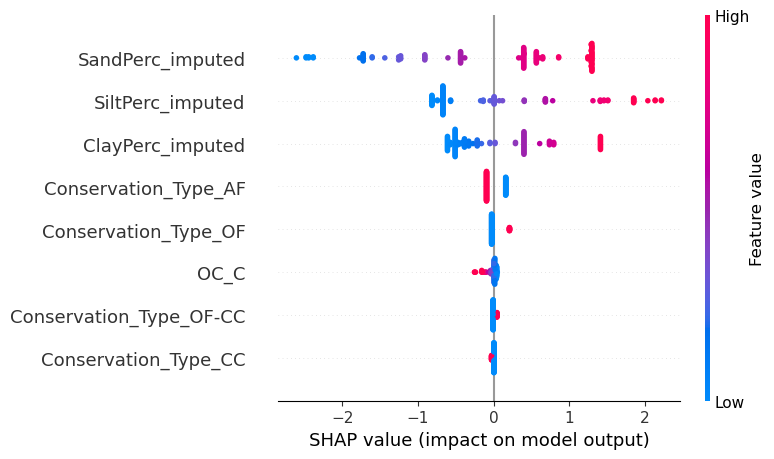


Ridge Regression

Cross-validated MAE (mean ± std): 0.214 ± -0.051
Cross-validated RMSE (mean ± std): 0.278 ± -0.051
Cross-validated R² (mean ± std): 0.139 ± 0.129


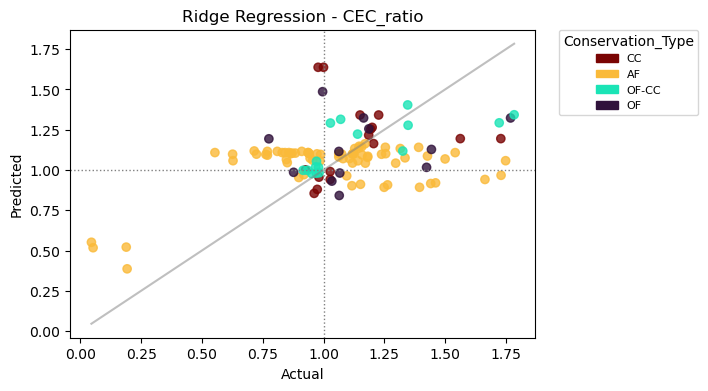

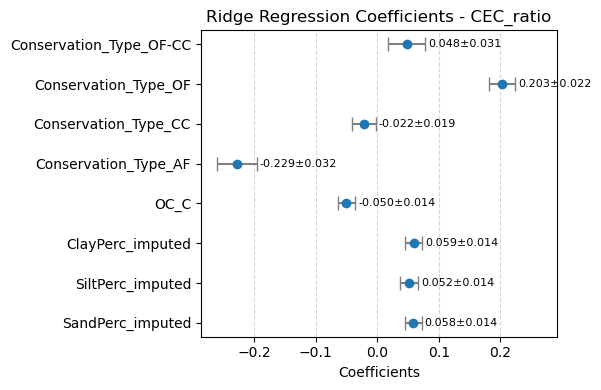

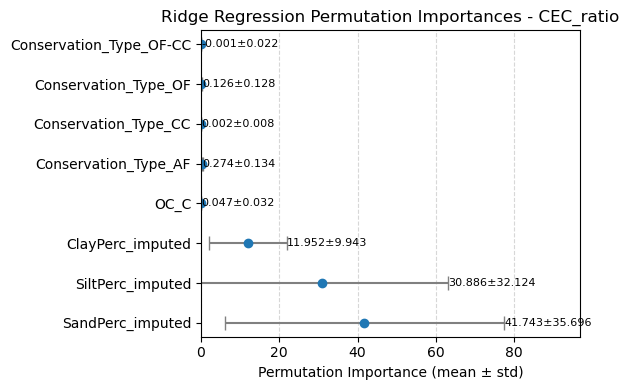

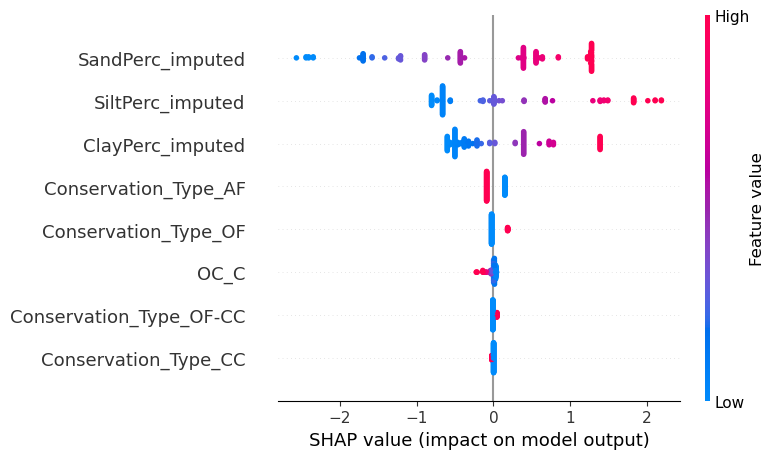


Support Vector Regression

Cross-validated MAE (mean ± std): 0.147 ± -0.041
Cross-validated RMSE (mean ± std): 0.201 ± -0.055
Cross-validated R² (mean ± std): 0.551 ± 0.13


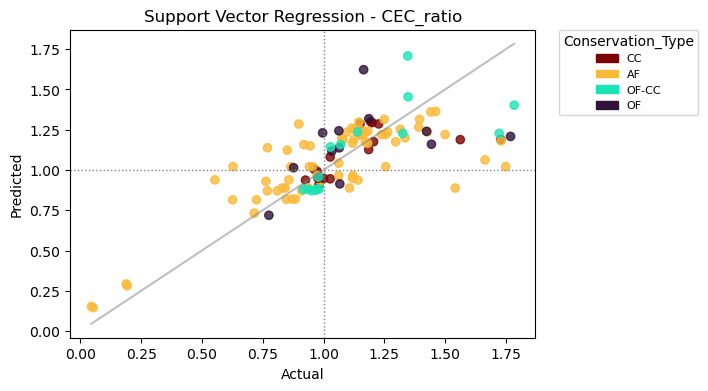

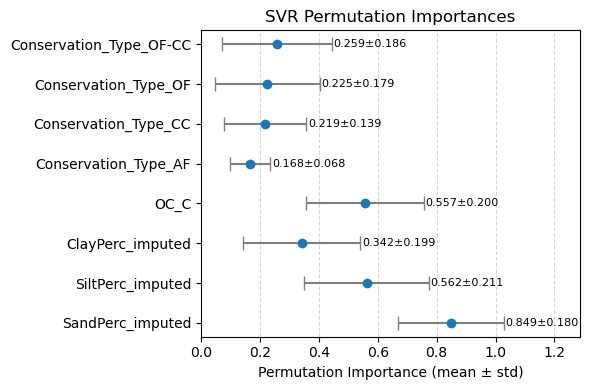

Using 116 background data samples could cause slower run times. Consider using shap.sample(data, K) or shap.kmeans(data, K) to summarize the background as K samples.


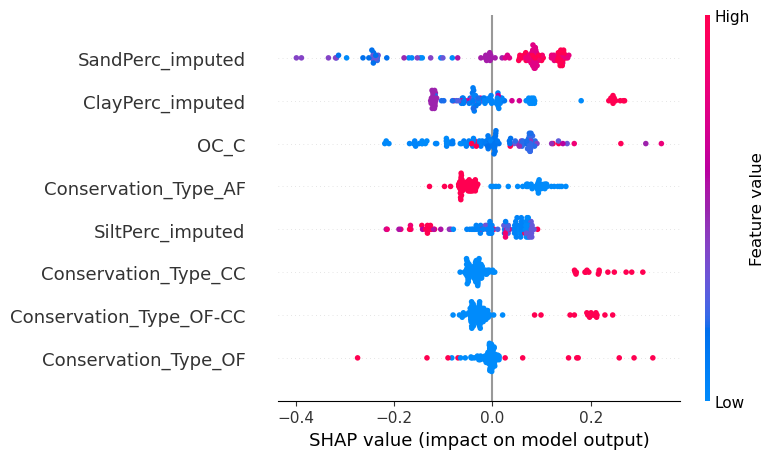


KNN Regression

Cross-validated MAE (mean ± std): 0.15 ± -0.046
Cross-validated RMSE (mean ± std): 0.22 ± -0.046
Cross-validated R² (mean ± std): 0.409 ± 0.296


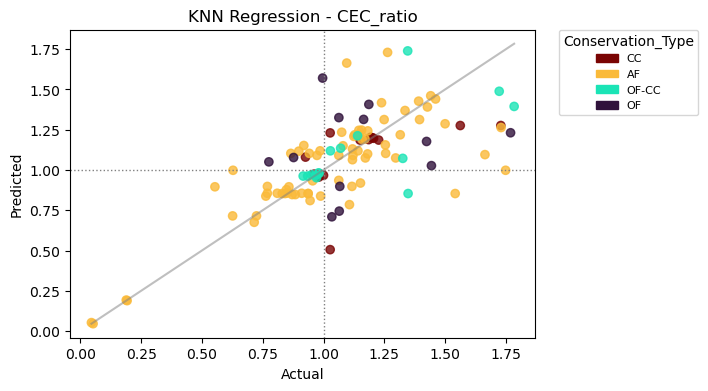

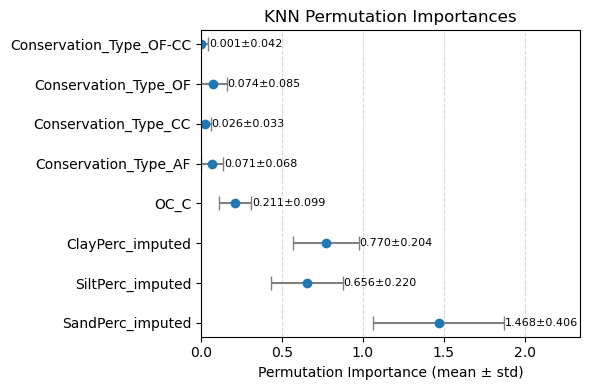

Using 116 background data samples could cause slower run times. Consider using shap.sample(data, K) or shap.kmeans(data, K) to summarize the background as K samples.


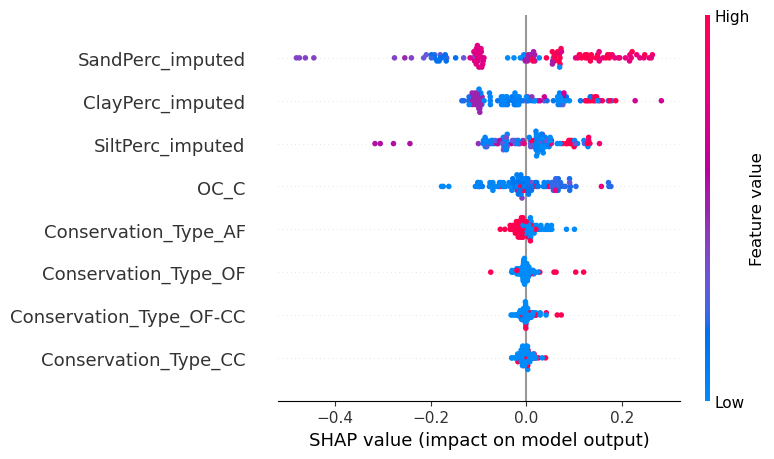


Decision Tree Regression

Cross-validated MAE (mean ± std): 0.169 ± -0.046
Cross-validated RMSE (mean ± std): 0.253 ± -0.046
Cross-validated R² (mean ± std): 0.266 ± 0.208


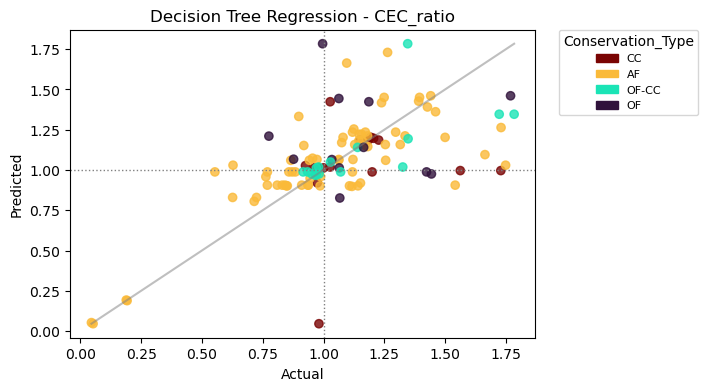

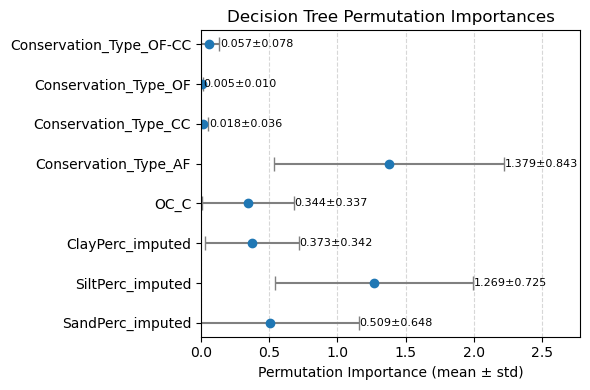

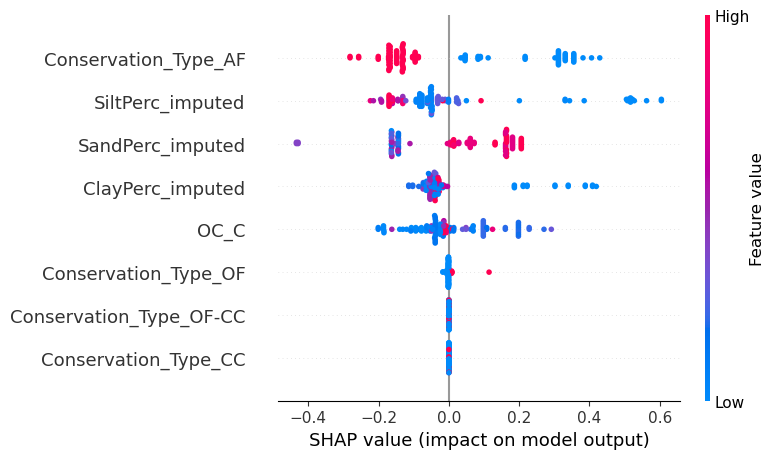


Random Forest Regression

Cross-validated MAE (mean ± std): 0.152 ± -0.051
Cross-validated RMSE (mean ± std): 0.214 ± -0.051
Cross-validated R² (mean ± std): 0.475 ± 0.193


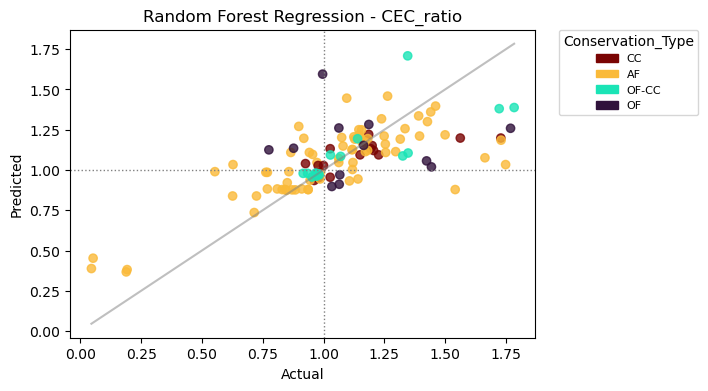

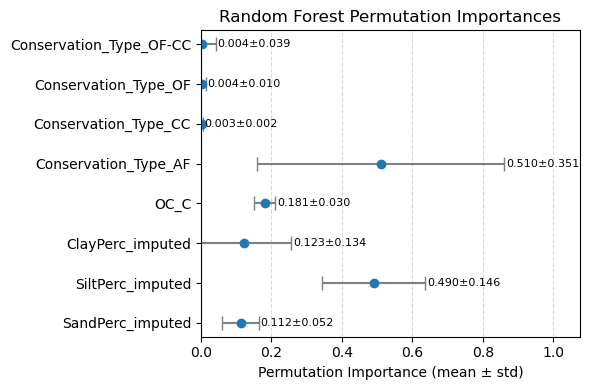

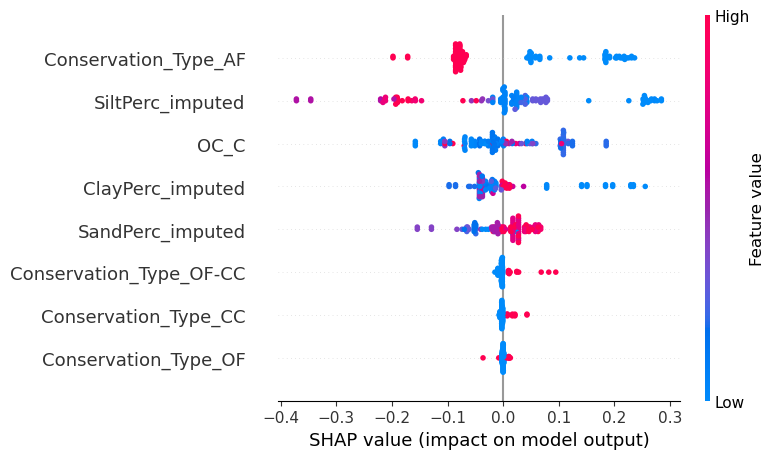


XGBoost Random Forest Regression

Cross-validated MAE (mean ± std): 0.146 ± -0.039
Cross-validated RMSE (mean ± std): 0.221 ± -0.039
Cross-validated R² (mean ± std): 0.422 ± 0.223


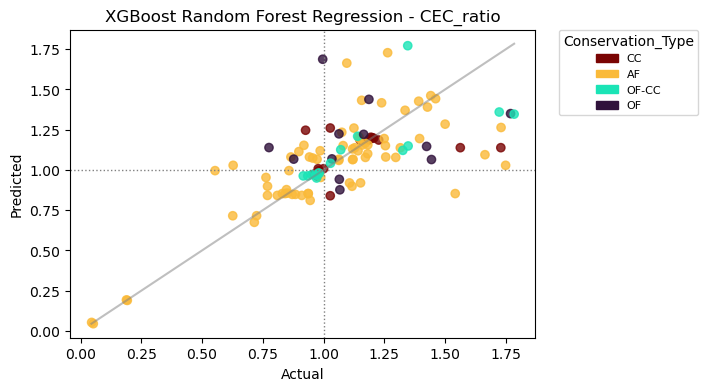

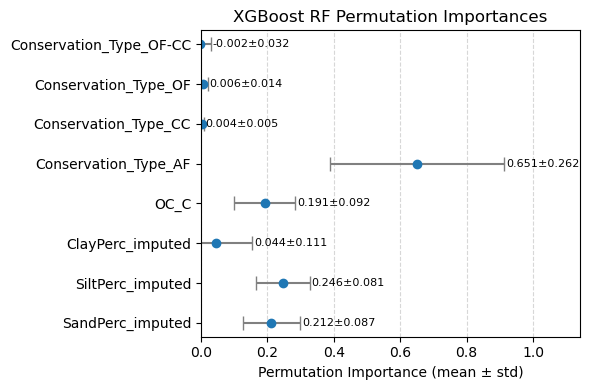

* SHAP does not support XGBoost random forest mode (num_parallel_tree > 1). Skipping SHAP plot.

XGBoost Regression

Cross-validated MAE (mean ± std): 0.146 ± -0.039
Cross-validated RMSE (mean ± std): 0.218 ± -0.039
Cross-validated R² (mean ± std): 0.436 ± 0.218


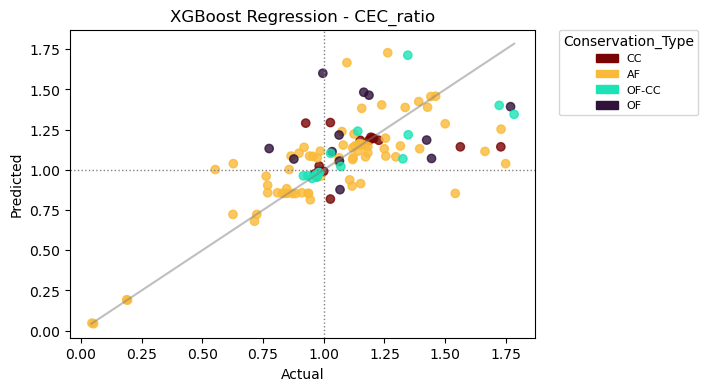

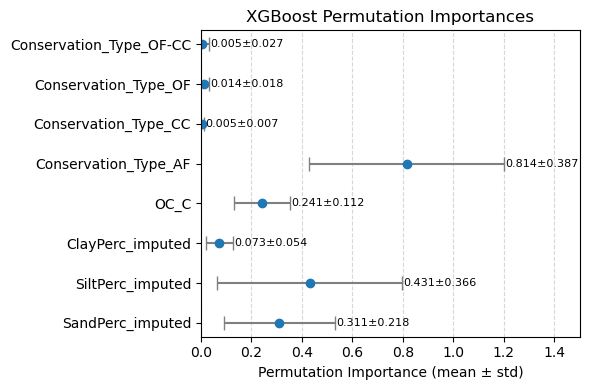

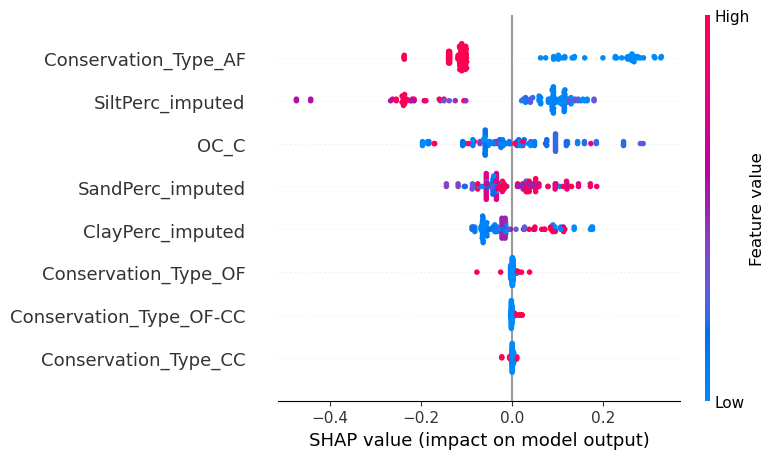


Generalized Additive Model

Cross-validated MAE (mean ± std): 0.154 ± 0.03
Cross-validated RMSE (mean ± std): 0.207 ± 0.041
Cross-validated R² (mean ± std): 0.52 ± 0.089


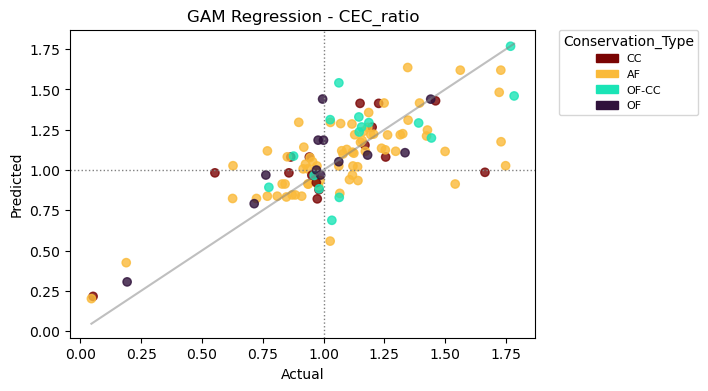

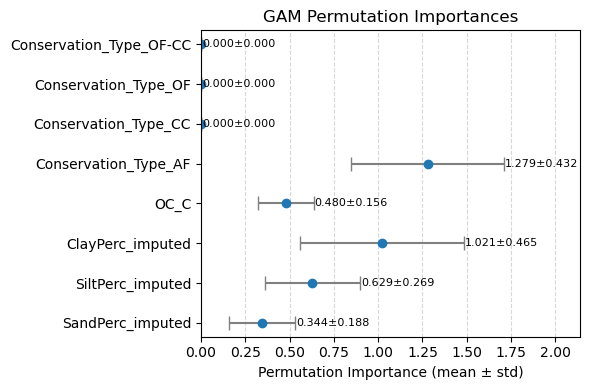

Using 116 background data samples could cause slower run times. Consider using shap.sample(data, K) or shap.kmeans(data, K) to summarize the background as K samples.


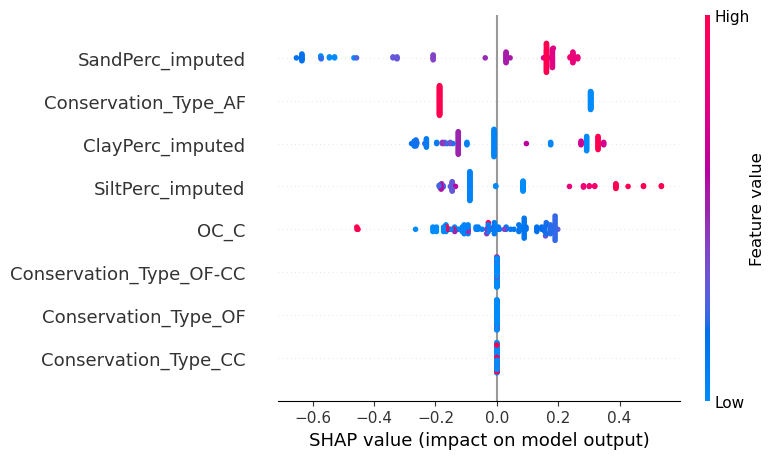

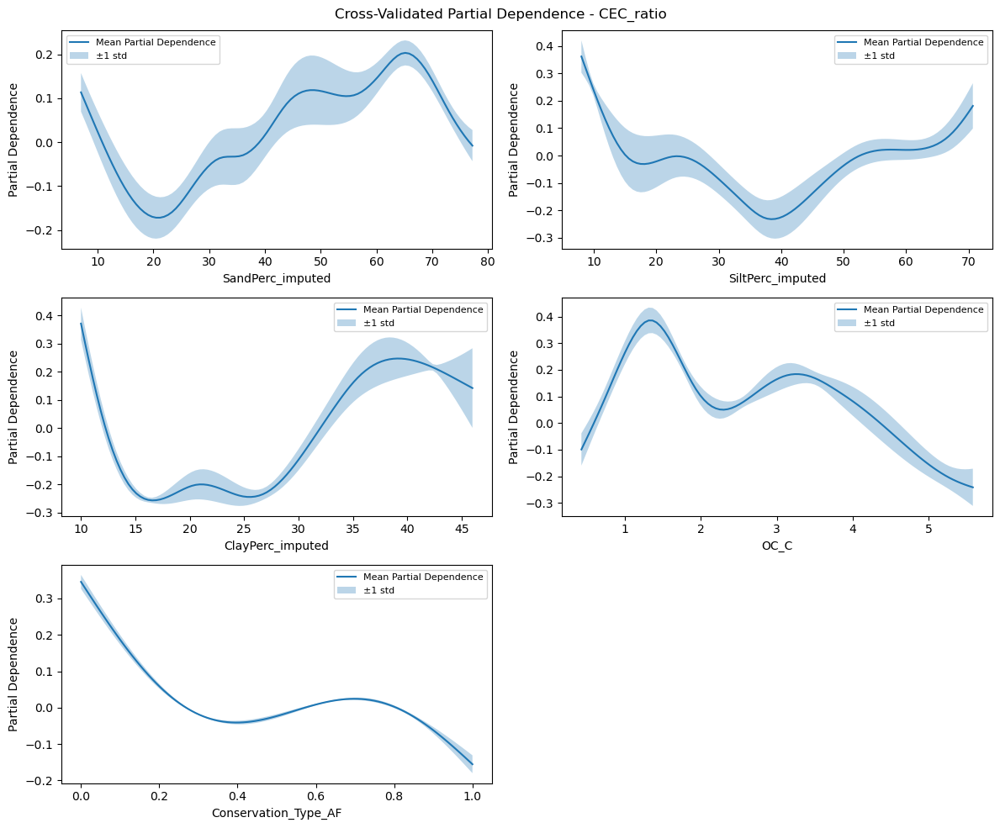

Predictors: SandPerc_imputed SiltPerc_imputed ClayPerc_imputed OC_C Conservation_Type
Dataset Shape: (116, 8)
Train set: CEC_ratio | Dataset Shape: (92, 8)
Test set: CEC_ratio | Dataset Shape: (24, 8)
                              Model Cross-validated MAE (mean ± std)  \
0           Multi Linear Regression                   0.215 ± -0.035   
1                  Ridge Regression                   0.214 ± -0.035   
2         Support Vector Regression                   0.147 ± -0.041   
3                    KNN Regression                   0.150 ± -0.035   
4          Decision Tree Regression                   0.169 ± -0.032   
5          Random Forest Regression                   0.152 ± -0.037   
6  XGBoost Random Forest Regression                   0.146 ± -0.031   
7                XGBoost Regression                   0.146 ± -0.030   
8        Generalized Additive Model                  -0.154 ± -0.030   

  Cross-validated RMSE (mean ± std) Cross-validated R² (mean ± std)  
0       

In [179]:
soil_health_prediction_models(df3, ['SandPerc_imputed', 'SiltPerc_imputed', 'ClayPerc_imputed', 'OC_C', 'Conservation_Type'], 'CEC_ratio', 'CEC_ratio', 'Conservation_Type')

### BD (Conservation Group)

Random split (80/20) and 5-fold cross-validation used.

Predictors: SandPerc_imputed SiltPerc_imputed ClayPerc_imputed OC_C Conservation_Group
Dataset Shape: (482, 9)
Train set: BD_ratio | Shape: (385, 9)
Test set: BD_ratio | Shape: (97, 9)

Multi Linear Regression

Cross-validated MAE (mean ± std): 0.024 ± -0.006
Cross-validated RMSE (mean ± std): 0.041 ± -0.006
Cross-validated R² (mean ± std): 0.066 ± 0.11


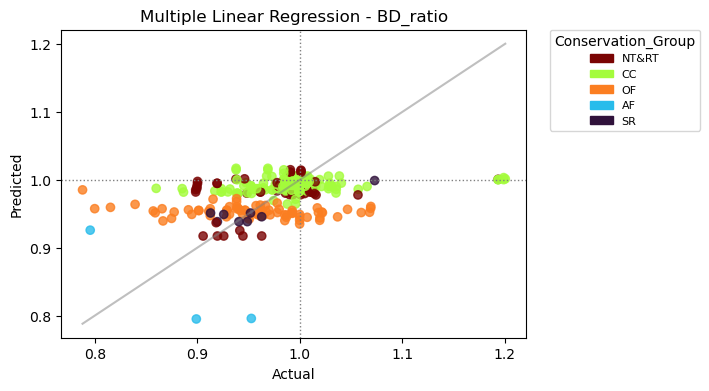

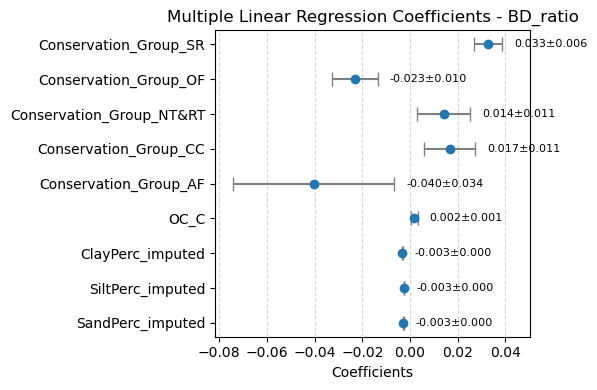

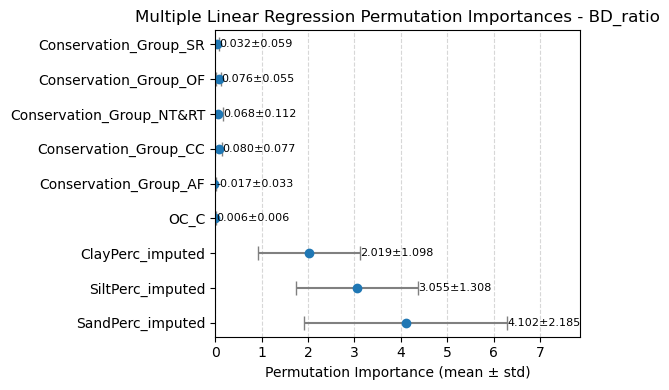

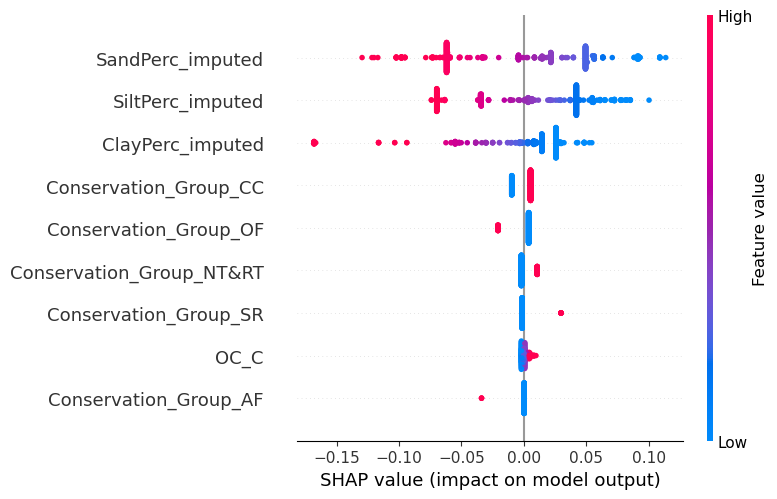


Ridge Regression

Cross-validated MAE (mean ± std): 0.024 ± -0.006
Cross-validated RMSE (mean ± std): 0.041 ± -0.006
Cross-validated R² (mean ± std): 0.105 ± 0.086


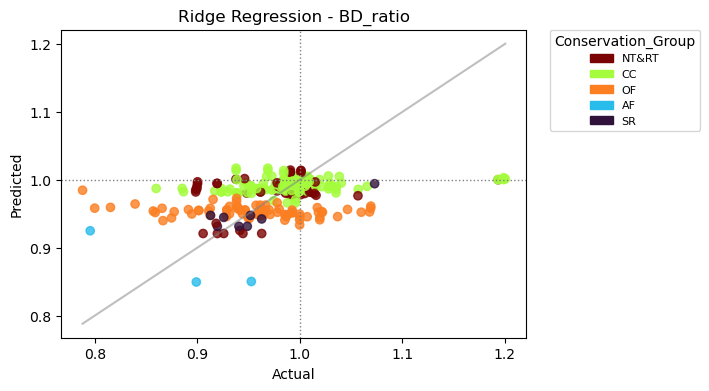

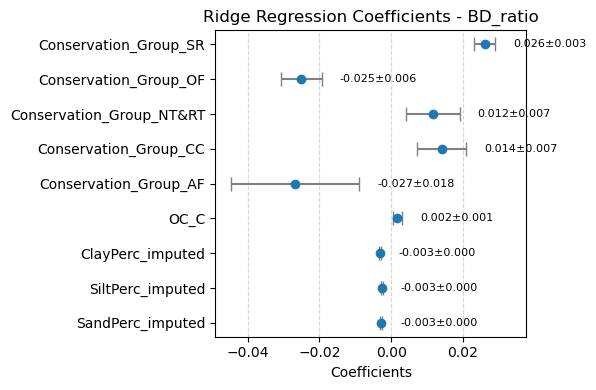

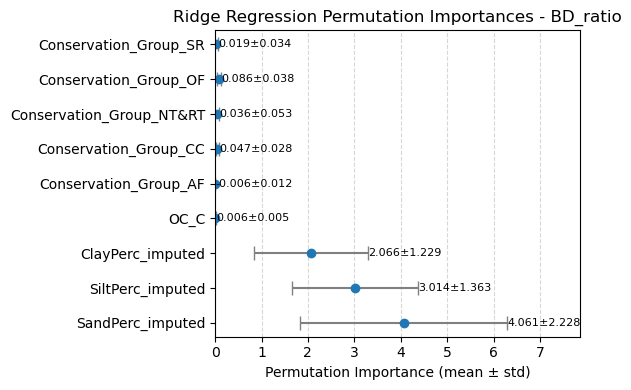

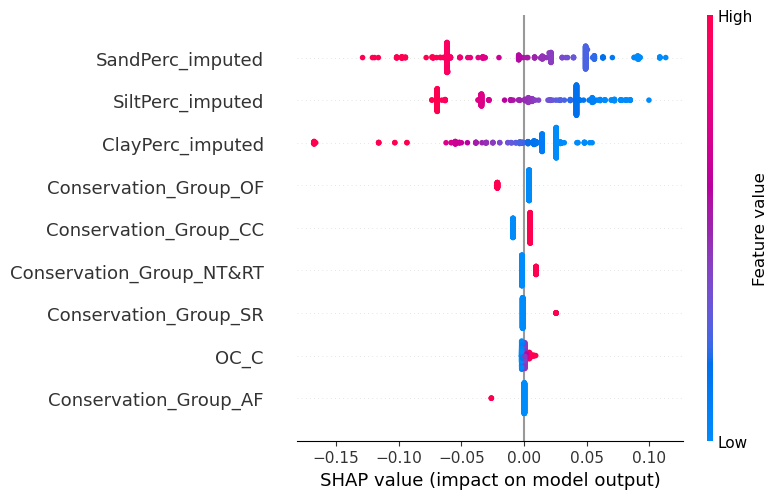


Support Vector Regression

Cross-validated MAE (mean ± std): 0.058 ± -0.006
Cross-validated RMSE (mean ± std): 0.068 ± -0.006
Cross-validated R² (mean ± std): -1.737 ± 1.113


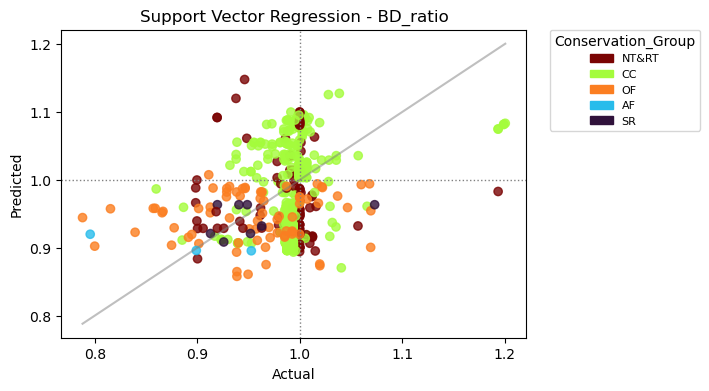

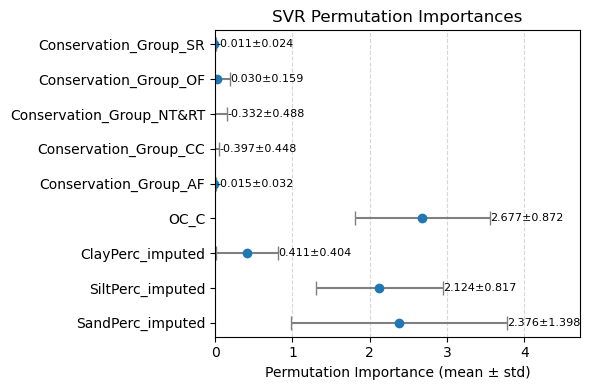

Using 482 background data samples could cause slower run times. Consider using shap.sample(data, K) or shap.kmeans(data, K) to summarize the background as K samples.


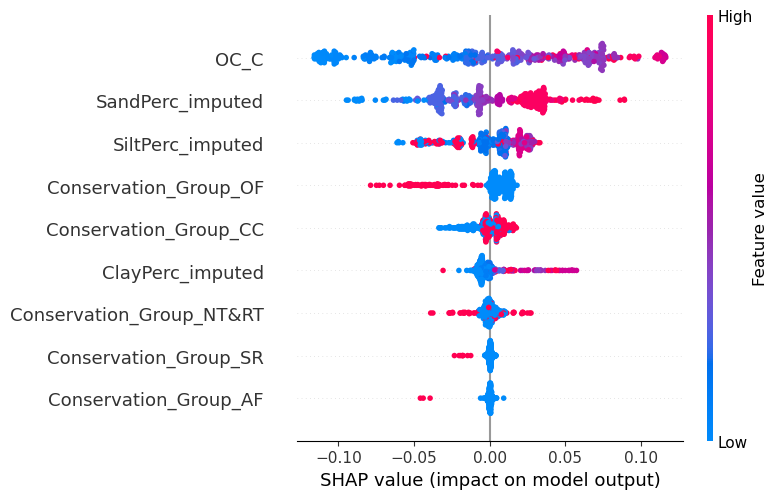


KNN Regression

Cross-validated MAE (mean ± std): 0.018 ± -0.006
Cross-validated RMSE (mean ± std): 0.039 ± -0.006
Cross-validated R² (mean ± std): 0.168 ± 0.236


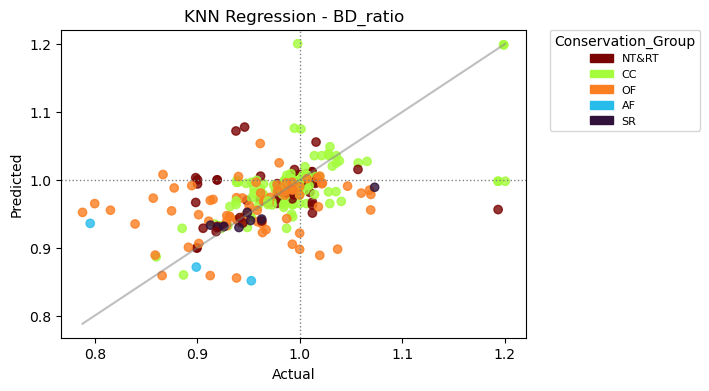

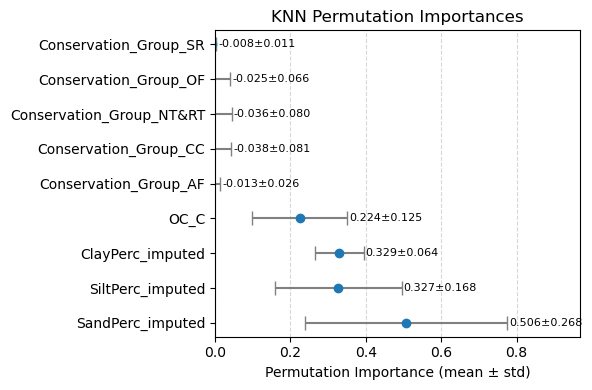

Using 482 background data samples could cause slower run times. Consider using shap.sample(data, K) or shap.kmeans(data, K) to summarize the background as K samples.


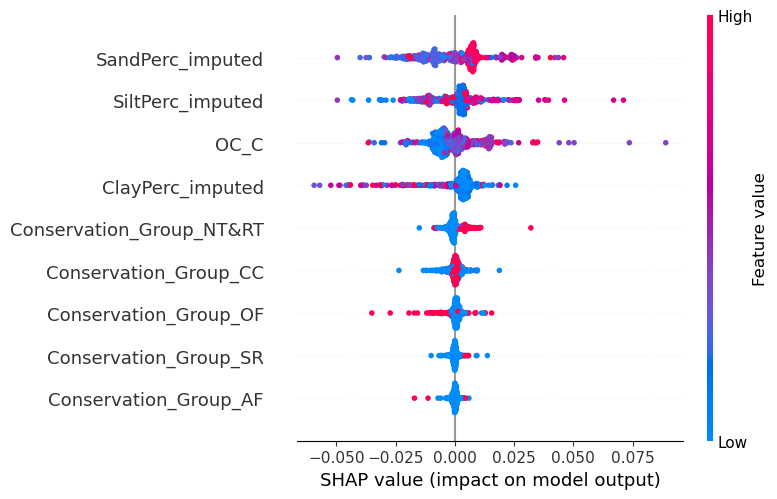


Decision Tree Regression

Cross-validated MAE (mean ± std): 0.023 ± -0.005
Cross-validated RMSE (mean ± std): 0.039 ± -0.005
Cross-validated R² (mean ± std): 0.116 ± 0.275


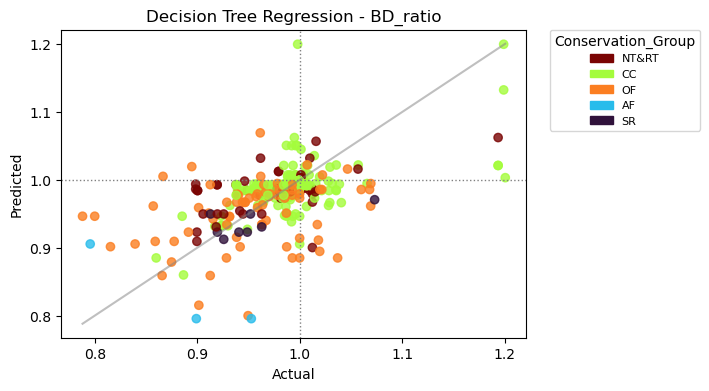

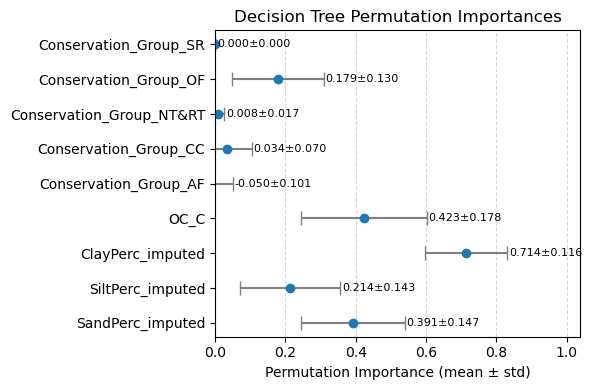

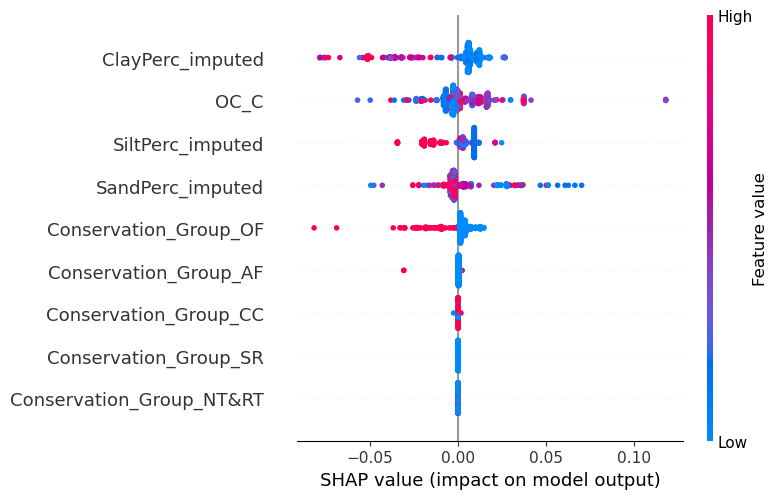


Random Forest Regression

Cross-validated MAE (mean ± std): 0.021 ± -0.006
Cross-validated RMSE (mean ± std): 0.037 ± -0.006
Cross-validated R² (mean ± std): 0.233 ± 0.194


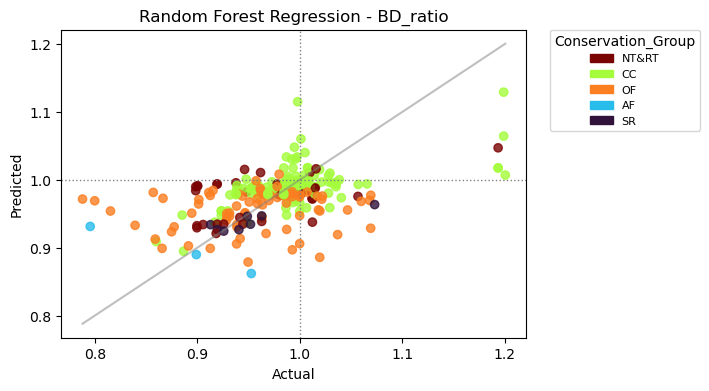

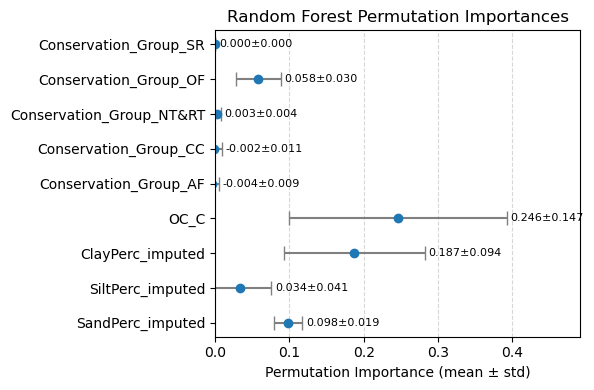

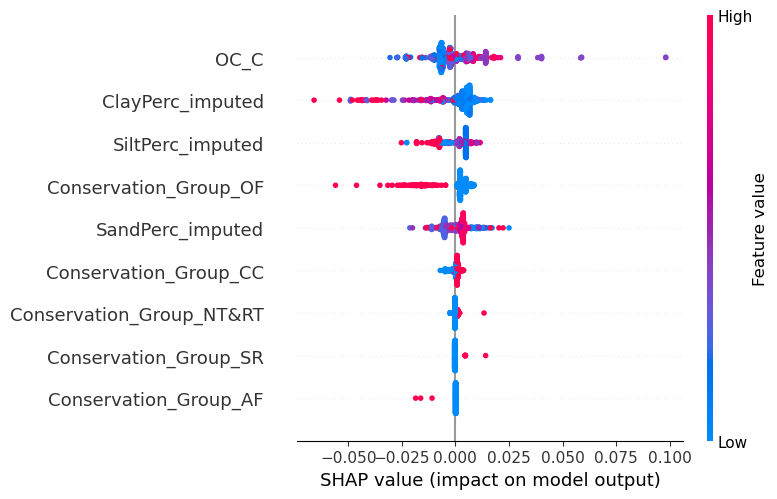


XGBoost Random Forest Regression

Cross-validated MAE (mean ± std): 0.019 ± -0.006
Cross-validated RMSE (mean ± std): 0.038 ± -0.006
Cross-validated R² (mean ± std): 0.169 ± 0.251


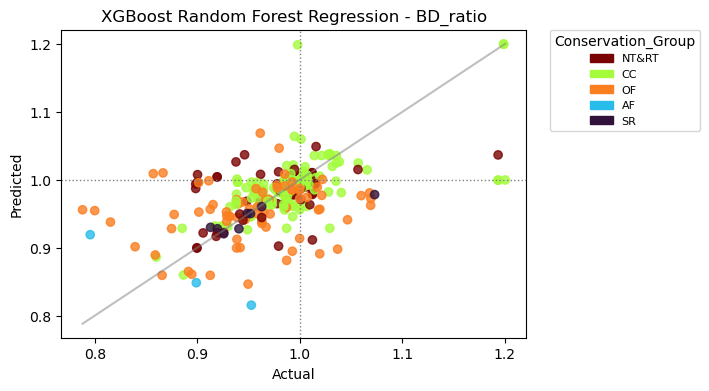

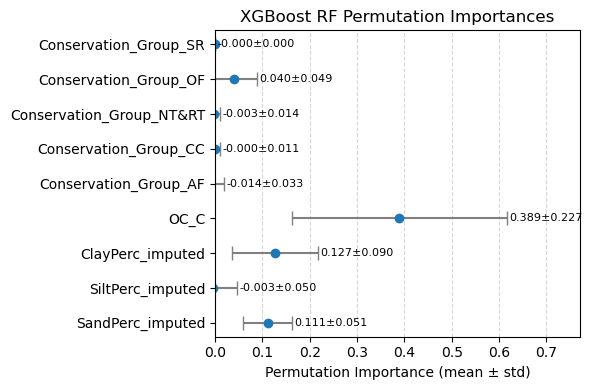

* SHAP does not support XGBoost random forest mode (num_parallel_tree > 1). Skipping SHAP plot.

XGBoost Regression

Cross-validated MAE (mean ± std): 0.02 ± -0.006
Cross-validated RMSE (mean ± std): 0.039 ± -0.006
Cross-validated R² (mean ± std): 0.15 ± 0.248


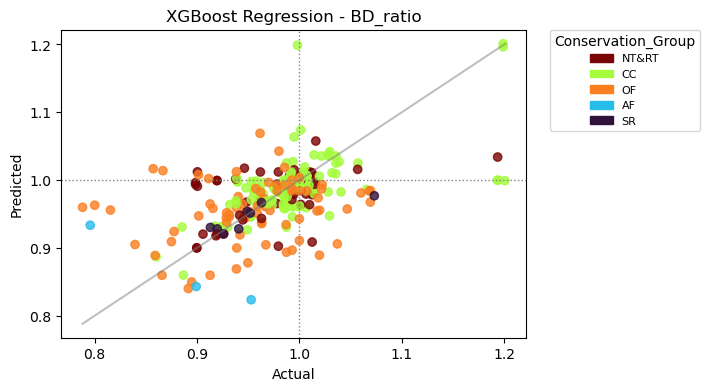

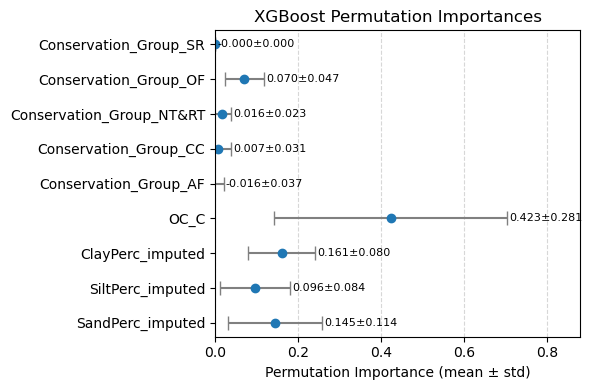

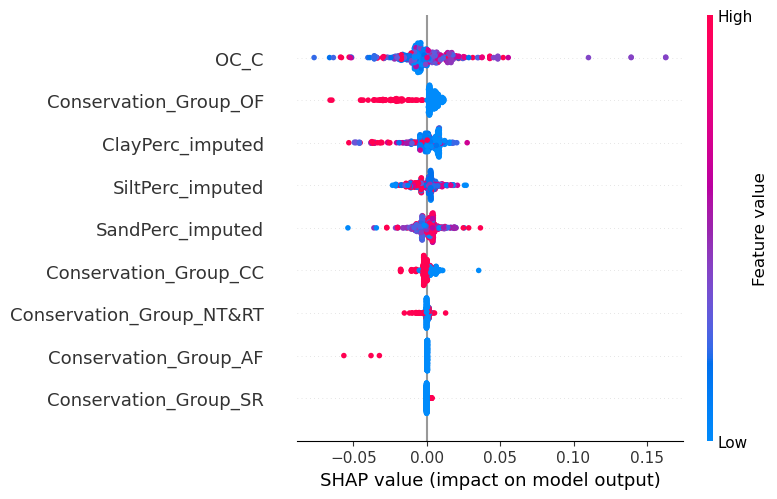


Generalized Additive Model

Cross-validated MAE (mean ± std): 0.024 ± 0.003
Cross-validated RMSE (mean ± std): 0.04 ± 0.005
Cross-validated R² (mean ± std): 0.123 ± 0.101


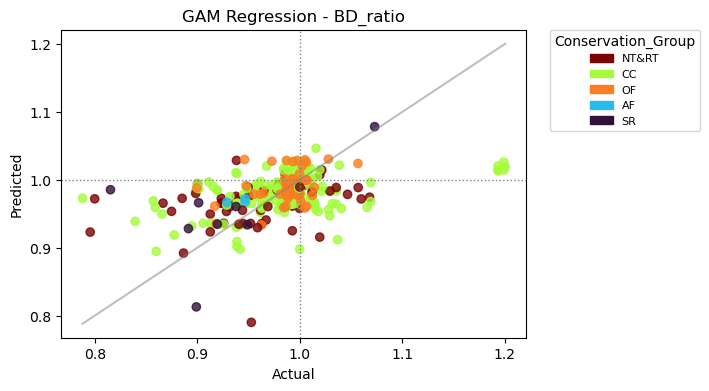

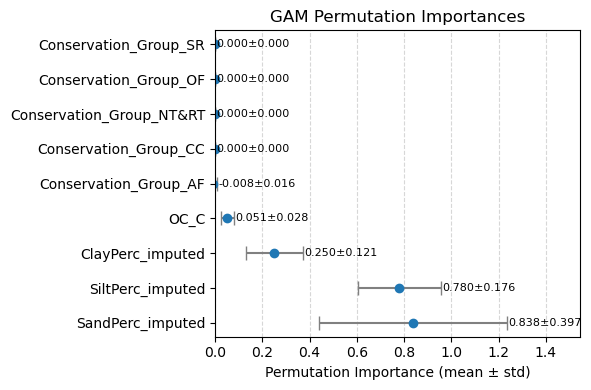

Using 482 background data samples could cause slower run times. Consider using shap.sample(data, K) or shap.kmeans(data, K) to summarize the background as K samples.


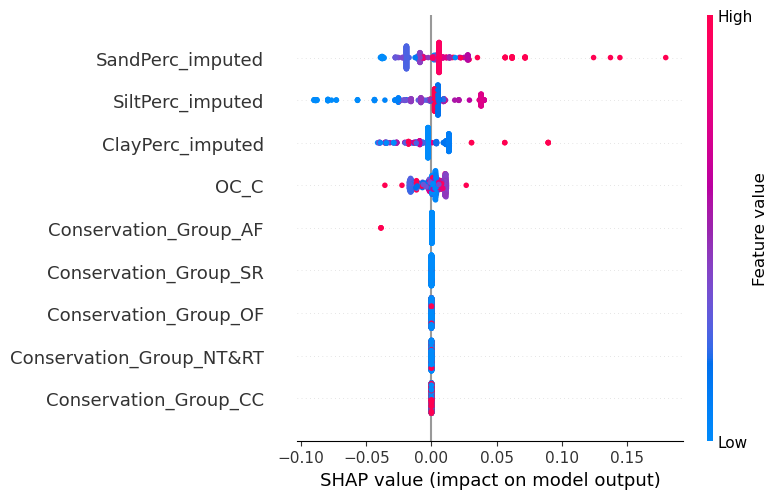

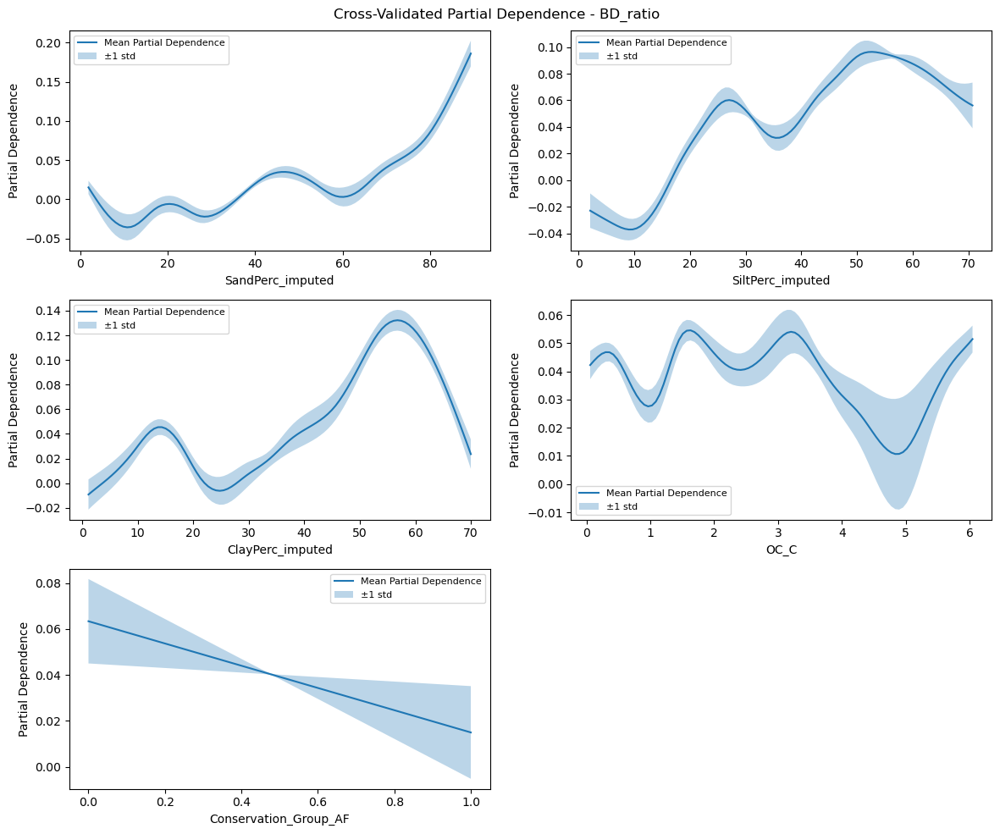

Predictors: SandPerc_imputed SiltPerc_imputed ClayPerc_imputed OC_C Conservation_Group
Dataset Shape: (482, 9)
Train set: BD_ratio | Dataset Shape: (385, 9)
Test set: BD_ratio | Dataset Shape: (97, 9)
                              Model Cross-validated MAE (mean ± std)  \
0           Multi Linear Regression                   0.024 ± -0.004   
1                  Ridge Regression                   0.024 ± -0.004   
2         Support Vector Regression                   0.058 ± -0.006   
3                    KNN Regression                   0.018 ± -0.004   
4          Decision Tree Regression                   0.023 ± -0.004   
5          Random Forest Regression                   0.021 ± -0.004   
6  XGBoost Random Forest Regression                   0.019 ± -0.004   
7                XGBoost Regression                   0.020 ± -0.004   
8        Generalized Additive Model                  -0.024 ± -0.003   

  Cross-validated RMSE (mean ± std) Cross-validated R² (mean ± std)  
0       

In [180]:
soil_health_prediction_models(df3, ['SandPerc_imputed', 'SiltPerc_imputed', 'ClayPerc_imputed', 'OC_C', 'Conservation_Group'], 'BD_ratio', 'BD_ratio', 'Conservation_Group')

### BD (Conservation Type)

Random split (80/20) and 5-fold cross-validation used.

Predictors: SandPerc_imputed SiltPerc_imputed ClayPerc_imputed OC_C Conservation_Type
Dataset Shape: (503, 15)
Train set: BD_ratio | Shape: (402, 15)
Test set: BD_ratio | Shape: (101, 15)

Multi Linear Regression

Cross-validated MAE (mean ± std): 0.024 ± -0.004
Cross-validated RMSE (mean ± std): 0.04 ± -0.004
Cross-validated R² (mean ± std): 0.12 ± 0.101


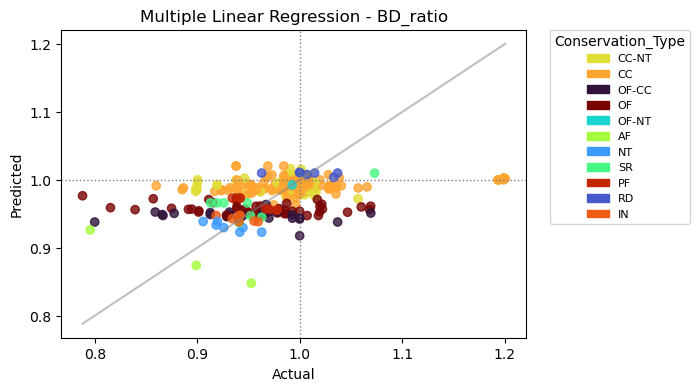

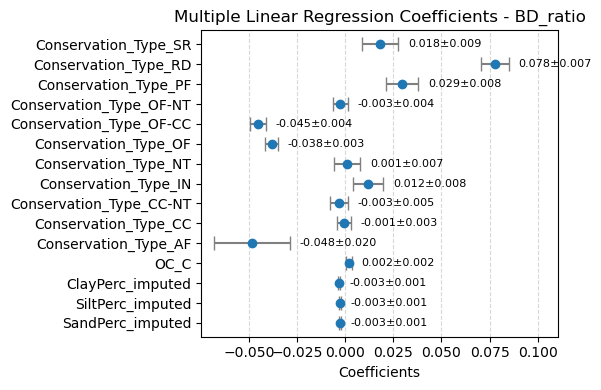

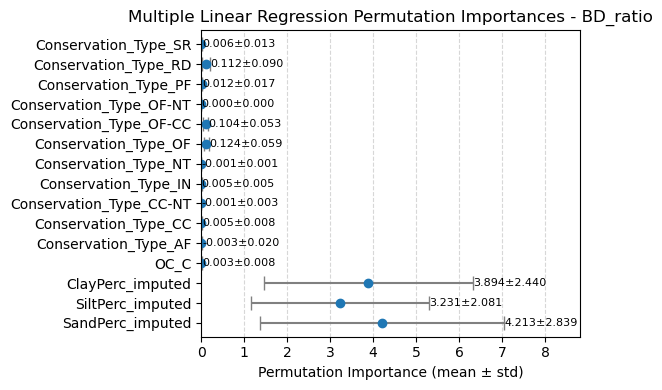

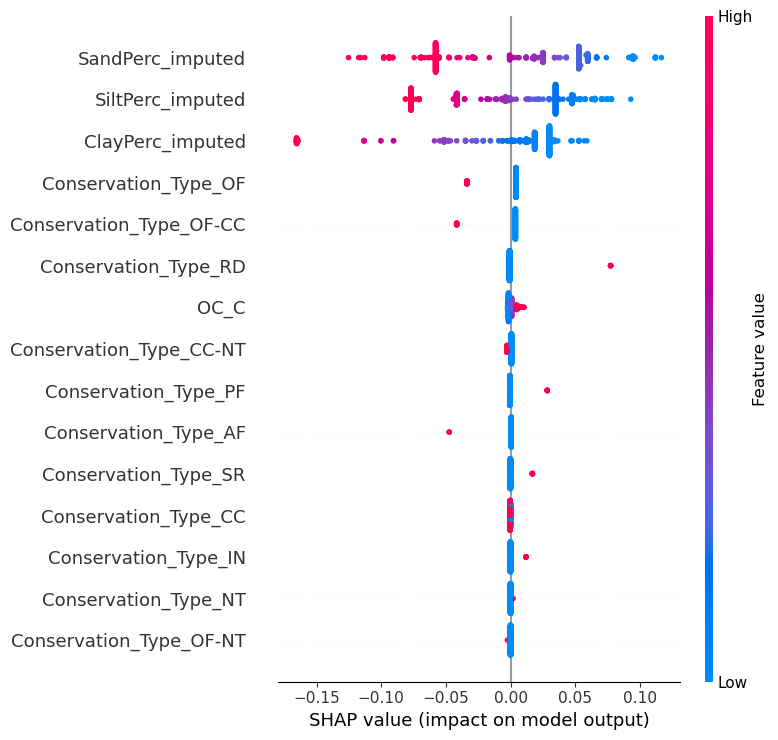


Ridge Regression

Cross-validated MAE (mean ± std): 0.023 ± -0.005
Cross-validated RMSE (mean ± std): 0.04 ± -0.005
Cross-validated R² (mean ± std): 0.13 ± 0.078


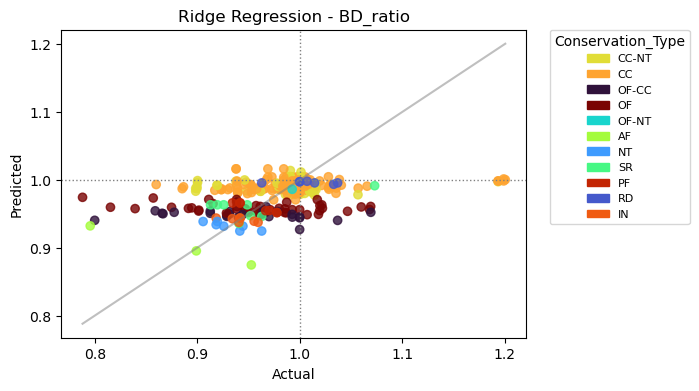

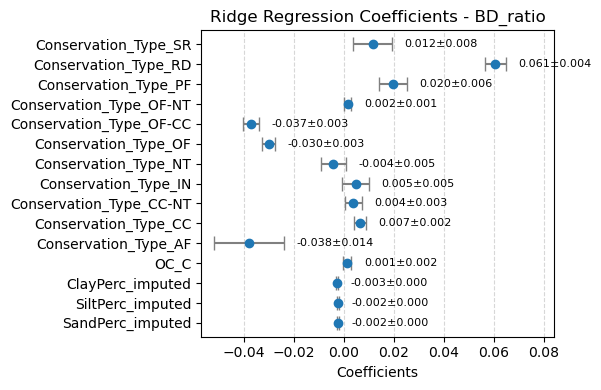

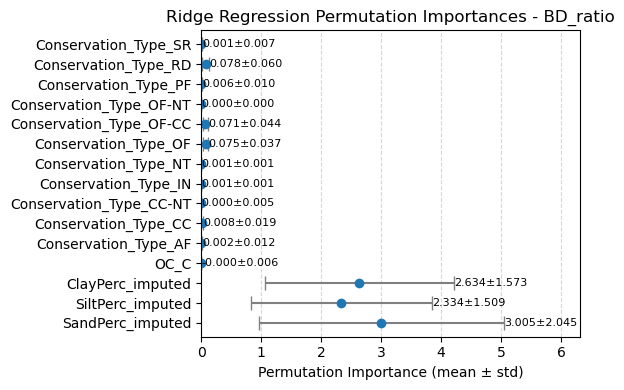

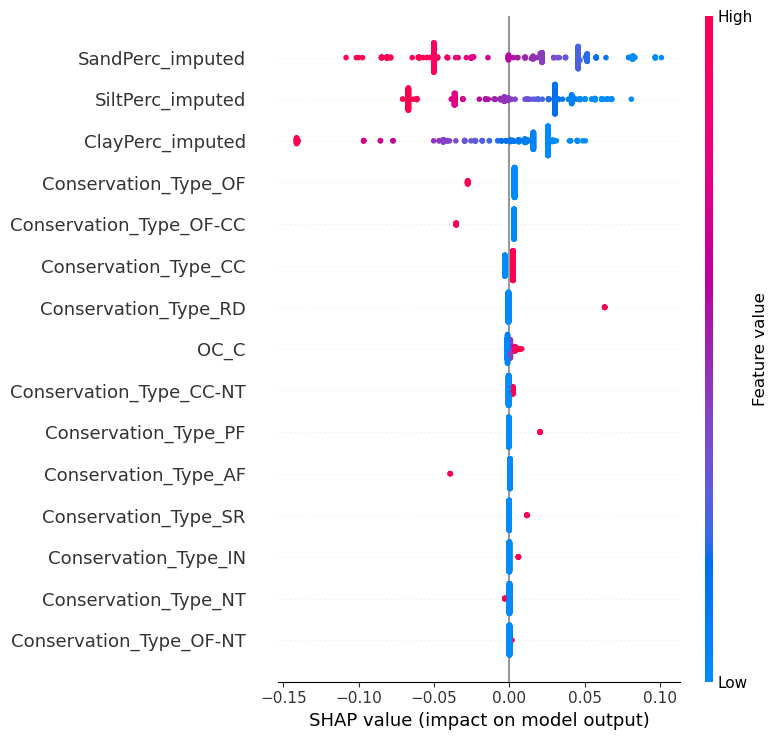


Support Vector Regression

Cross-validated MAE (mean ± std): 0.053 ± -0.004
Cross-validated RMSE (mean ± std): 0.064 ± -0.004
Cross-validated R² (mean ± std): -1.39 ± 1.032


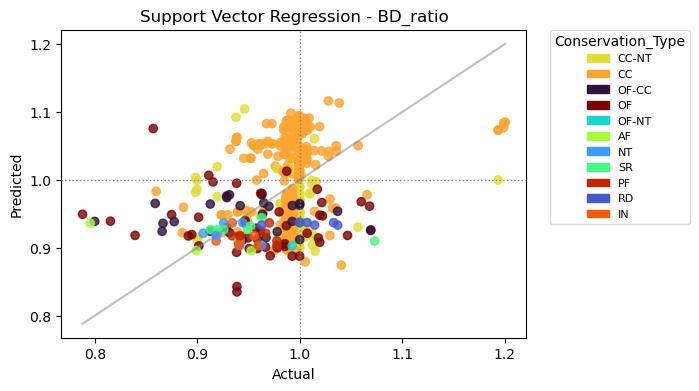

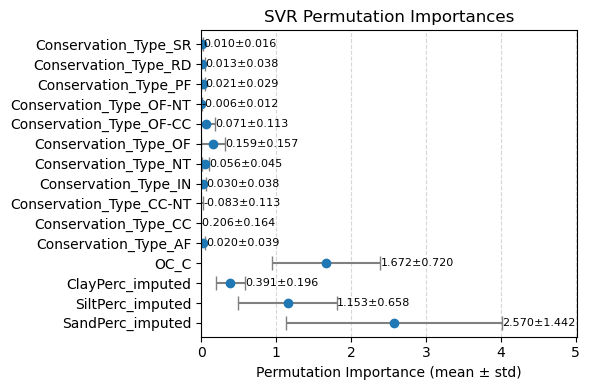

Using 503 background data samples could cause slower run times. Consider using shap.sample(data, K) or shap.kmeans(data, K) to summarize the background as K samples.


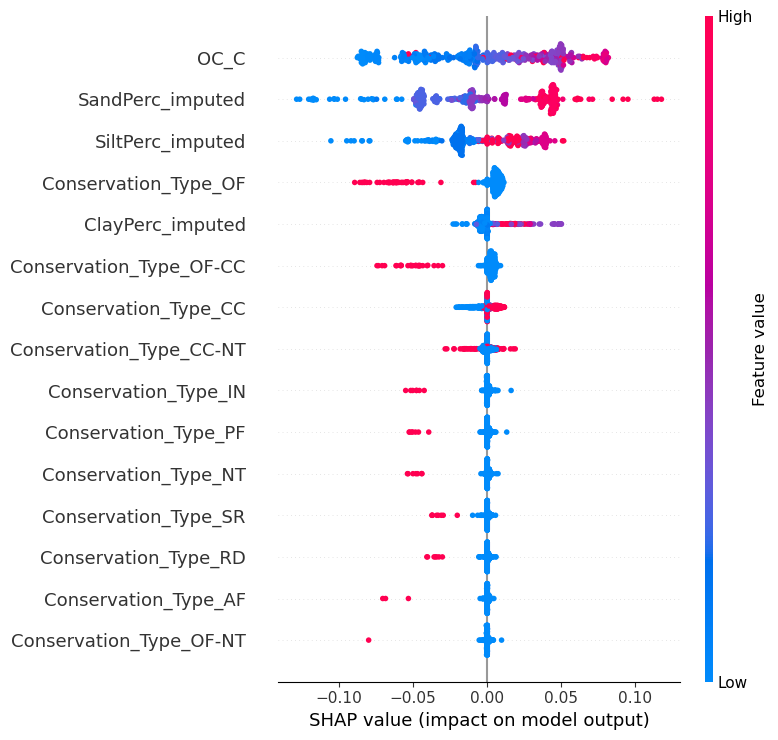


KNN Regression

Cross-validated MAE (mean ± std): 0.018 ± -0.004
Cross-validated RMSE (mean ± std): 0.038 ± -0.004
Cross-validated R² (mean ± std): 0.22 ± 0.073


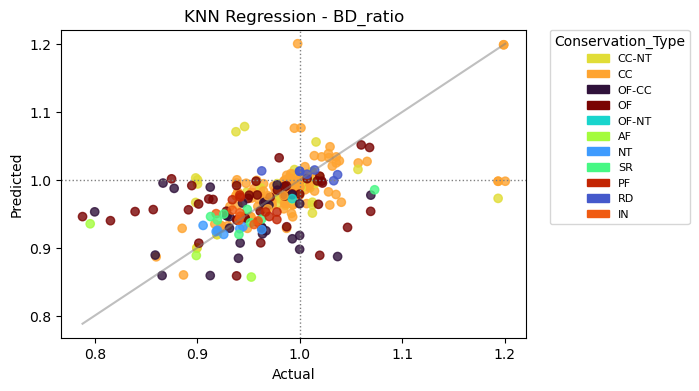

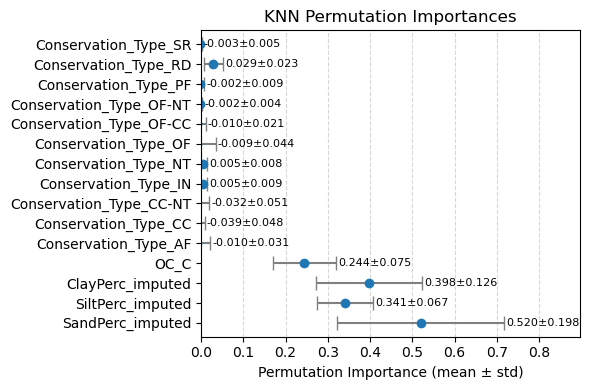

Using 503 background data samples could cause slower run times. Consider using shap.sample(data, K) or shap.kmeans(data, K) to summarize the background as K samples.


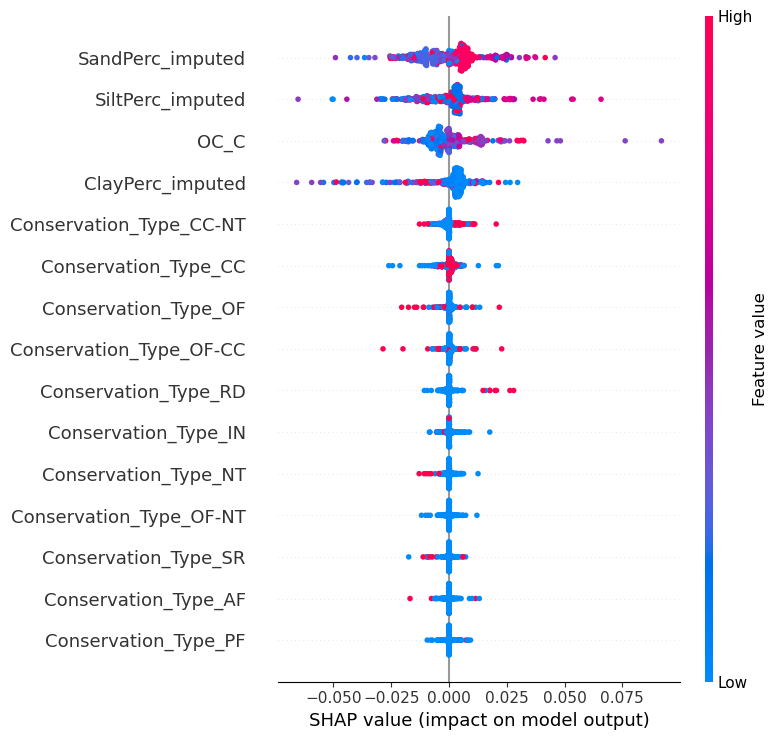


Decision Tree Regression

Cross-validated MAE (mean ± std): 0.024 ± -0.007
Cross-validated RMSE (mean ± std): 0.041 ± -0.007
Cross-validated R² (mean ± std): 0.103 ± 0.125


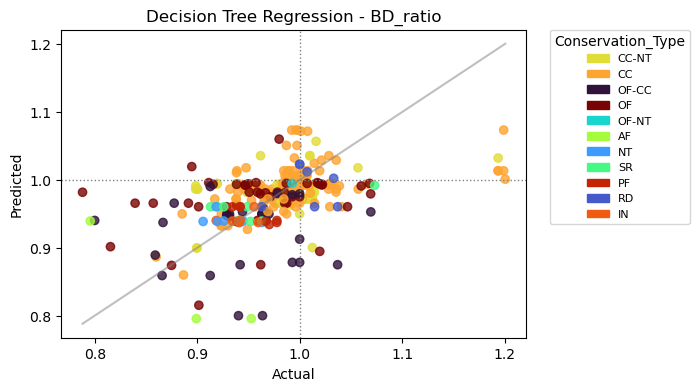

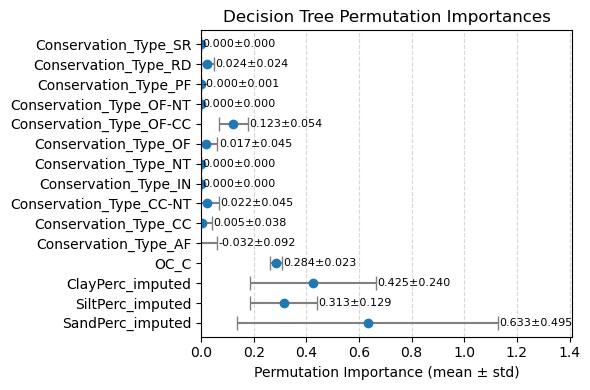

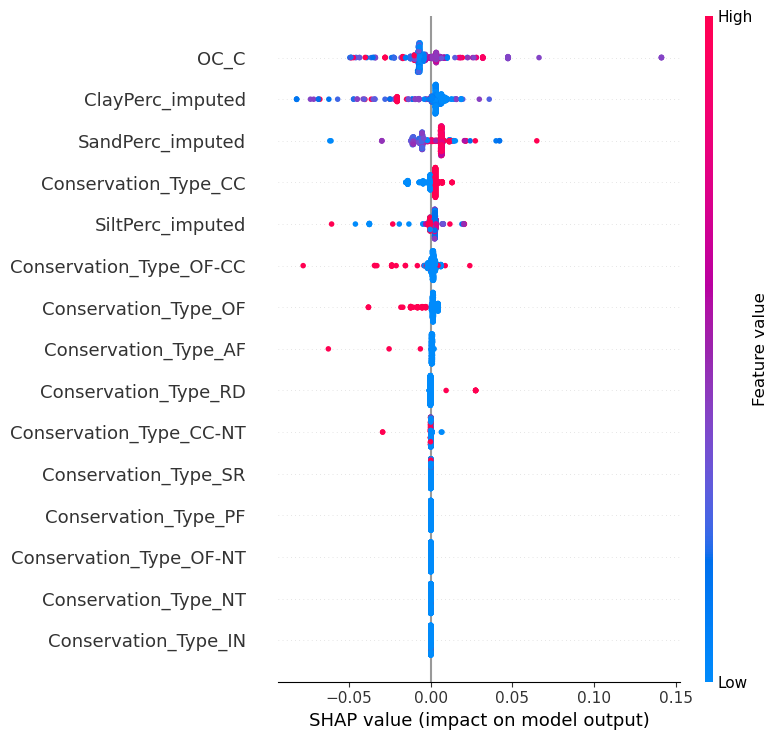


Random Forest Regression

Cross-validated MAE (mean ± std): 0.022 ± -0.006
Cross-validated RMSE (mean ± std): 0.037 ± -0.006
Cross-validated R² (mean ± std): 0.271 ± 0.137


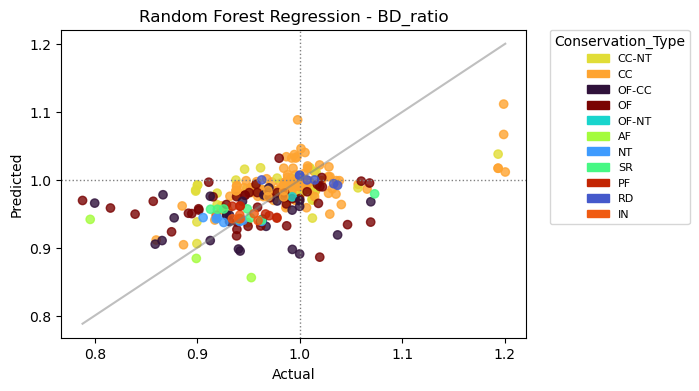

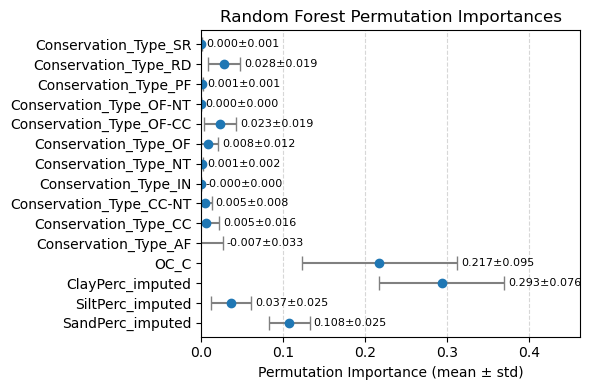

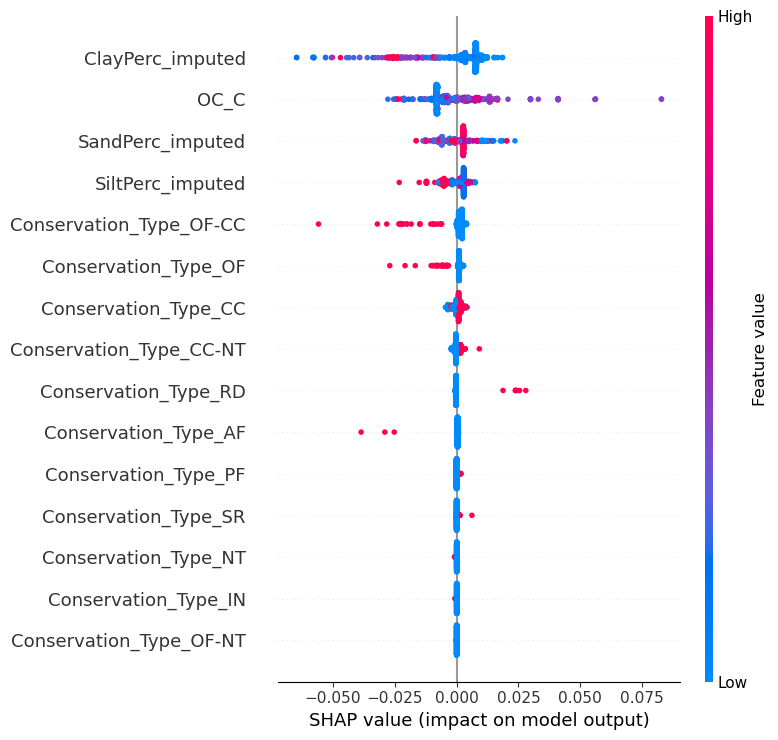


XGBoost Random Forest Regression

Cross-validated MAE (mean ± std): 0.019 ± -0.005
Cross-validated RMSE (mean ± std): 0.038 ± -0.005
Cross-validated R² (mean ± std): 0.233 ± 0.068


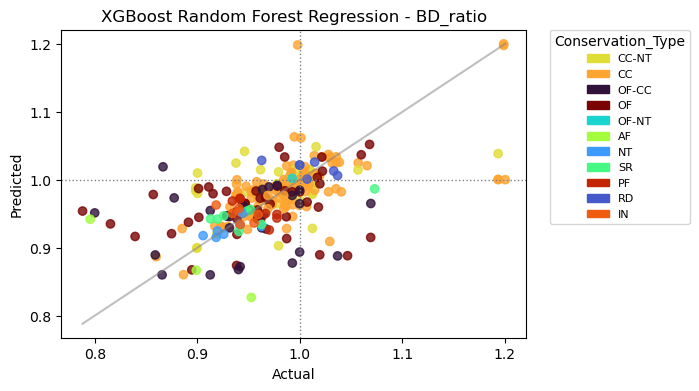

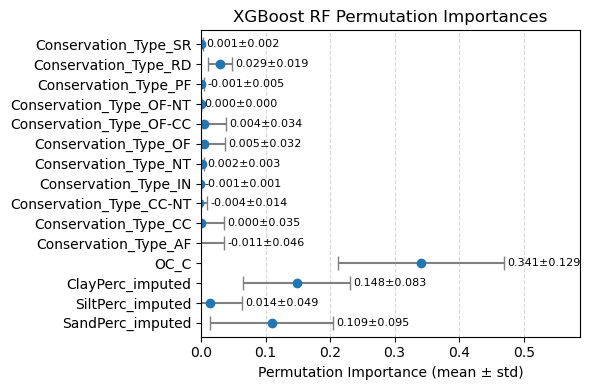

* SHAP does not support XGBoost random forest mode (num_parallel_tree > 1). Skipping SHAP plot.

XGBoost Regression

Cross-validated MAE (mean ± std): 0.02 ± -0.006
Cross-validated RMSE (mean ± std): 0.039 ± -0.006
Cross-validated R² (mean ± std): 0.188 ± 0.058


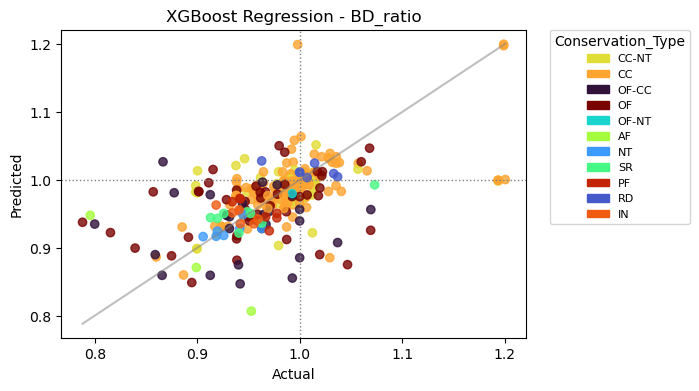

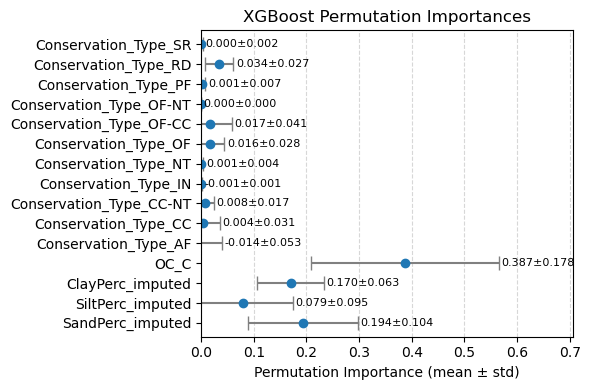

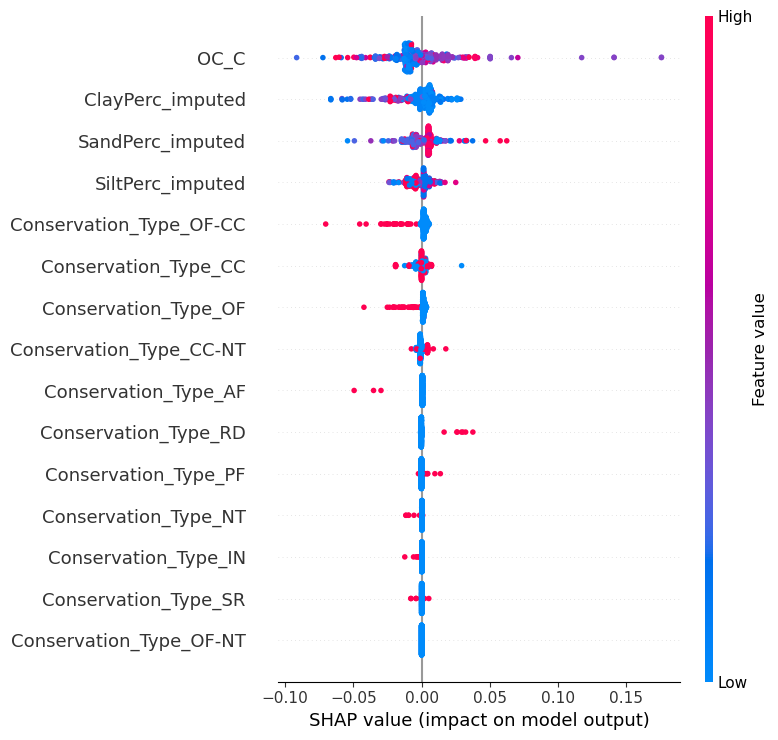


Generalized Additive Model

Cross-validated MAE (mean ± std): 0.026 ± 0.003
Cross-validated RMSE (mean ± std): 0.041 ± 0.006
Cross-validated R² (mean ± std): 0.087 ± 0.111


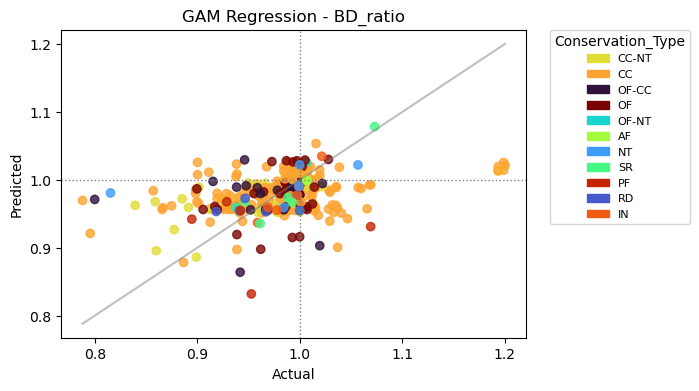

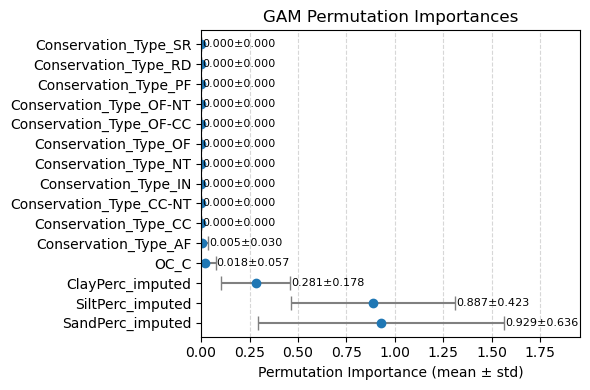

Using 503 background data samples could cause slower run times. Consider using shap.sample(data, K) or shap.kmeans(data, K) to summarize the background as K samples.


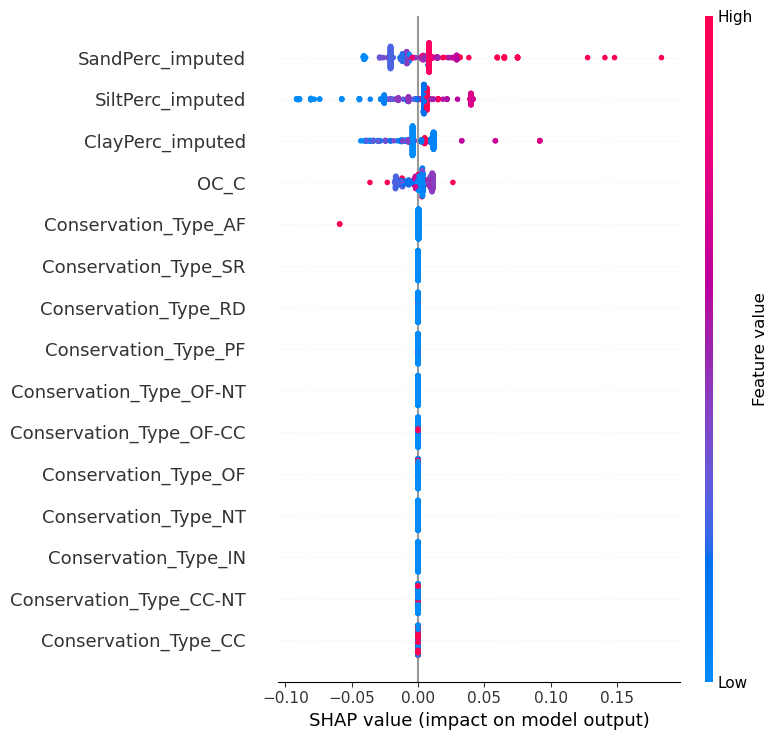

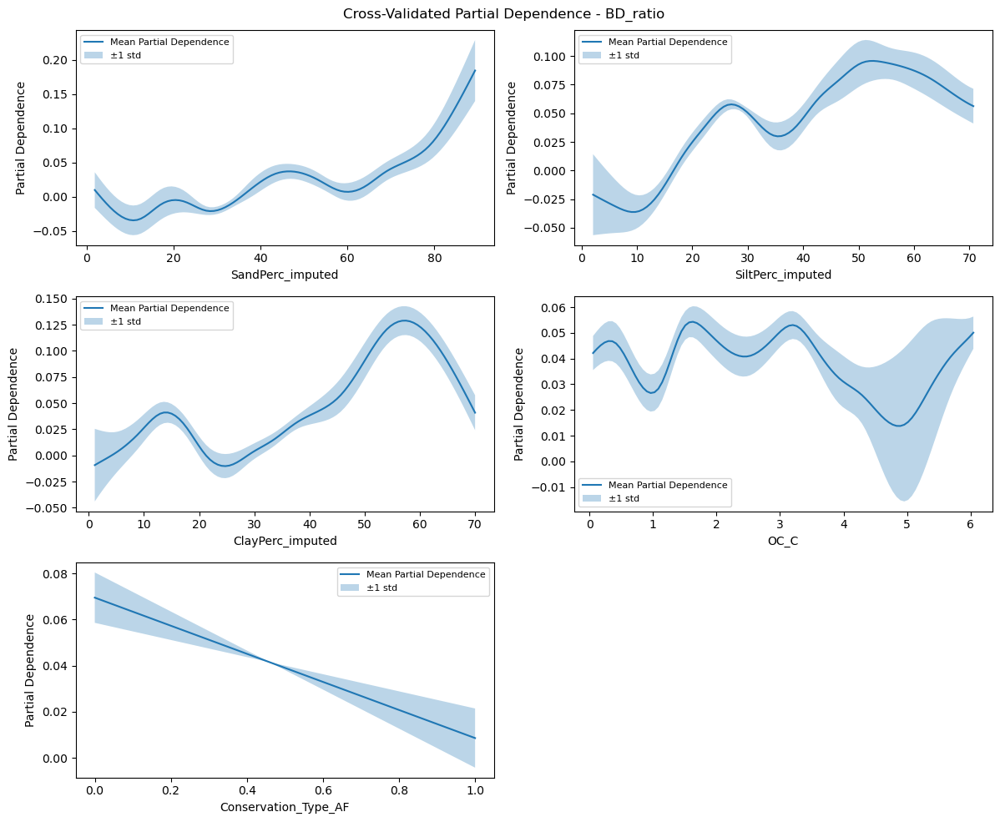

Predictors: SandPerc_imputed SiltPerc_imputed ClayPerc_imputed OC_C Conservation_Type
Dataset Shape: (503, 15)
Train set: BD_ratio | Dataset Shape: (402, 15)
Test set: BD_ratio | Dataset Shape: (101, 15)
                              Model Cross-validated MAE (mean ± std)  \
0           Multi Linear Regression                   0.024 ± -0.002   
1                  Ridge Regression                   0.023 ± -0.002   
2         Support Vector Regression                   0.053 ± -0.004   
3                    KNN Regression                   0.018 ± -0.003   
4          Decision Tree Regression                   0.024 ± -0.004   
5          Random Forest Regression                   0.022 ± -0.003   
6  XGBoost Random Forest Regression                   0.019 ± -0.003   
7                XGBoost Regression                   0.020 ± -0.003   
8        Generalized Additive Model                  -0.026 ± -0.003   

  Cross-validated RMSE (mean ± std) Cross-validated R² (mean ± std)  
0    

In [181]:
soil_health_prediction_models(df3, ['SandPerc_imputed', 'SiltPerc_imputed', 'ClayPerc_imputed', 'OC_C', 'Conservation_Type'], 'BD_ratio', 'BD_ratio', 'Conservation_Type')

# Imputation Using Models

## CEC_C

In [15]:
# Choose predictors
predictors = ['SandPerc_imputed', 'SiltPerc_imputed', 'ClayPerc_imputed', 'SoilpH', 'OC_C']

# Train model on non-missing data
train_df = df3[predictors + ['CEC_C']].dropna()
X_train = train_df[predictors]
y_train = train_df['CEC_C']

gam = LinearGAM(reduce(lambda a, b: a + b, [s(i) for i in range(len(predictors))]))
gam.fit(X_train, y_train)

# Predict missing data
missing_mask = df3['CEC_C'].isna() & df3[predictors].notna().all(axis=1)
X_missing = df3.loc[missing_mask, predictors]
y_pred = gam.predict(X_missing)

# Create new column with imputed values
df3 = df3.drop(columns=['CEC_C_imputed'], errors='ignore') # Remove imputed column if it already exists (for re-running the script)
df3['CEC_C_imputed'] = df3['CEC_C'].copy()
df3.loc[missing_mask, 'CEC_C_imputed'] = y_pred

print(f"Imputed {missing_mask.sum()} missing CEC_C values using GAM in 'CEC_C_imputed'.")

Imputed 351 missing CEC_C values using GAM in 'CEC_C_imputed'.


## CEC_T

In [16]:
# Choose predictors
predictors = ['SandPerc_imputed', 'SiltPerc_imputed', 'ClayPerc_imputed', 'SoilpH', 'OC_C', 'Conservation_Group']

# Train model on non-missing data
train_df = df3[df3['CEC_T'].notna()].dropna(subset=predictors)
X_train = pd.get_dummies(train_df[predictors], columns=['Conservation_Group']) # Convert categorical variable to one-hot variables
y_train = train_df['CEC_T']
scaler = StandardScaler() # Scale features for SVR
X_train_scaled = scaler.fit_transform(X_train)

svr_model = SVR(kernel='rbf', C=50, epsilon=0.1)
svr_model.fit(X_train_scaled, y_train)

# Predict missing data
missing_mask = df3['CEC_T'].isna() & df3[predictors].notna().all(axis=1)
X_missing = pd.get_dummies(df3.loc[missing_mask, predictors], columns=['Conservation_Group'])
X_missing = X_missing.reindex(columns=X_train.columns, fill_value=0) # Align columns in case some groups are missing in X_missing
X_missing_scaled = scaler.transform(X_missing)
cec_t_pred = svr_model.predict(X_missing_scaled)

# Create new column with imputed values
df3 = df3.drop(columns=['CEC_T_imputed'], errors='ignore') # Remove imputed column if it already exists (for re-running the script)
df3['CEC_T_imputed'] = df3['CEC_T'].copy()
df3.loc[missing_mask, 'CEC_T_imputed'] = cec_t_pred

print(f"Imputed {missing_mask.sum()} missing CEC_T values using SVR (with Conservation_Group) in 'CEC_T_imputed'.")

Imputed 351 missing CEC_T values using SVR (with Conservation_Group) in 'CEC_T_imputed'.


## BD_C

In [17]:
# Choose predictors
predictors = ['SandPerc_imputed', 'SiltPerc_imputed', 'ClayPerc_imputed', 'OC_C']

# Train model on non-missing data
train_df = df3[df3['BD_C'].notna()].dropna(subset=predictors)
X_train = train_df[predictors]
y_train = train_df['BD_C']

xgb_model = xgb.XGBRegressor(n_estimators=100, max_depth=6, tree_method='hist', random_state=42)
xgb_model.fit(X_train, y_train)

# Predict missing data
missing_mask = df3['BD_C'].isna() & df3[predictors].notna().all(axis=1)
X_missing = df3.loc[missing_mask, predictors]
bd_c_pred = xgb_model.predict(X_missing)

# Create new column with imputed values
df3 = df3.drop(columns=['BD_C_imputed'], errors='ignore') # Remove imputed column if it already exists (for re-running the script)
df3['BD_C_imputed'] = df3['BD_C'].copy()
df3.loc[missing_mask, 'BD_C_imputed'] = bd_c_pred

print(f"Imputed {missing_mask.sum()} missing BD_C values using XGBoost in 'BD_C_imputed'.")

Imputed 654 missing BD_C values using XGBoost in 'BD_C_imputed'.


## BD_T

In [18]:
# Choose predictors
predictors = ['SandPerc_imputed', 'SiltPerc_imputed', 'ClayPerc_imputed', 'OC_C', 'Conservation_Group']

# Train model on non-missing data
train_df = df3[df3['BD_T'].notna()].dropna(subset=predictors)
X_train = pd.get_dummies(train_df[predictors], columns=['Conservation_Group']) # Convert categorical variable to one-hot variables
y_train = train_df['BD_T']

rf_model = RandomForestRegressor(n_estimators=100, max_depth=6, random_state=42)
rf_model.fit(X_train, y_train)

# Predict missing data
missing_mask = df3['BD_T'].isna() & df3[predictors].notna().all(axis=1)
X_missing = pd.get_dummies(df3.loc[missing_mask, predictors], columns=['Conservation_Group'])
X_missing = X_missing.reindex(columns=X_train.columns, fill_value=0) # Align columns in case some groups are missing in X_missing
bd_t_pred = rf_model.predict(X_missing)

# Create new column with imputed values
df3 = df3.drop(columns=['BD_T_imputed'], errors='ignore') # Remove imputed column if it already exists (for re-running the script)
df3['BD_T_imputed'] = df3['BD_T'].copy()
df3.loc[missing_mask, 'BD_T_imputed'] = bd_t_pred

print(f"Imputed {missing_mask.sum()} missing BD_T values using Random Forest (with Conservation_Group) in 'BD_T_imputed'.")

Imputed 612 missing BD_T values using Random Forest (with Conservation_Group) in 'BD_T_imputed'.


# Statistical Testing

In [19]:
# Set both control and treatment values to NA if either is NA
indicator_pairs = [
    ('CEC_C', 'CEC_T'),
    ('BD_C', 'BD_T'),
    ('Yield_C', 'Yield_T'),
    ('CEC_C_imputed', 'CEC_T_imputed'),
    ('BD_C_imputed', 'BD_T_imputed')]

for ctl_col, trt_col in indicator_pairs:
    mask = df3[ctl_col].isna() | df3[trt_col].isna()
    df3.loc[mask, [ctl_col, trt_col]] = pd.NA

In [20]:
# Create new columns of imputed CEC, BD and Yield log ratios for downstream analysis
df3 = df3.drop(columns=['CEC_imputed_ratio','BD_imputed_ratio','CEC_imputed_log_ratio','BD_imputed_log_ratio'], errors='ignore') # Remove imputed column if it already exists (for re-running the script)

df3['CEC_imputed_ratio'] = df3['CEC_T_imputed'] / df3['CEC_C_imputed']
df3['BD_imputed_ratio'] = df3['BD_T_imputed'] / df3['BD_C_imputed']

# Avoid log of zero/negative/NaN
df3['CEC_imputed_log_ratio'] = np.nan
mask_cec = (df3['CEC_T_imputed'] > 0) & (df3['CEC_C_imputed'] > 0)
df3.loc[mask_cec, 'CEC_imputed_log_ratio'] = np.log(df3.loc[mask_cec, 'CEC_T_imputed'] / df3.loc[mask_cec, 'CEC_C_imputed'])

df3['BD_imputed_log_ratio'] = np.nan
mask_bd = (df3['BD_T_imputed'] > 0) & (df3['BD_C_imputed'] > 0)
df3.loc[mask_bd, 'BD_imputed_log_ratio'] = np.log(df3.loc[mask_bd, 'BD_T_imputed'] / df3.loc[mask_bd, 'BD_C_imputed'])

## Shapiro-Wilk Test

In [21]:
print("\nShapiro-Wilk Test for Normality\n") # p-value < 0.05 indicates non-normality

# List of variables to test
shapiro_vars = ['CEC_log_ratio', 'BD_log_ratio', 'Yield_log_ratio']

# Collect results in a table
shapiro_results = []
for var in shapiro_vars:
    stat, p = shapiro(df3[var].dropna())
    shapiro_results.append({'Variable': var, 'Statistic': stat, 'p-value': p})

# Display table with different float formats, preserving column titles
shapiro_df = pd.DataFrame(shapiro_results)
# Print header
print(f"{'Variable':<18} {'Statistic':>10} {'p-value':>12}")
for idx, row in shapiro_df.iterrows():
    print(f"{row['Variable']:<18} {row['Statistic']:>10.3f} {row['p-value']:>12.2e}")


Shapiro-Wilk Test for Normality

Variable            Statistic      p-value
CEC_log_ratio           0.581     2.65e-18
BD_log_ratio            0.869     8.98e-27
Yield_log_ratio         0.899     1.52e-36


## Mann–Whitney U Test

In [23]:
def mann_whitney_u_test(df, group1, group2, group1_conservation=None, group2_conservation=None):
    if group1_conservation is not None:
        group1 = df[df['Conservation_Group'] == group1_conservation][group1].dropna()
    else:
        group1 = df[group1].dropna()
    if group2_conservation is not None:
        group2 = df[df['Conservation_Group'] == group2_conservation][group2].dropna()
    else:
        group2 = df[group2].dropna()

    stat, p = mannwhitneyu(group1, group2, alternative='two-sided')
    
    # Group conservation information
    def label(name, cons):
        return f"{name} ({cons})" if cons is not None else name
    label1 = label(group1.name, group1_conservation)
    label2 = label(group2.name, group2_conservation)
    significant = "<0.05" if p < 0.05 else ">=0.05"
    
    # Return results as dict
    return {
        "Group 1": label1,
        "Group 2": label2,
        "size_1": group1.shape[0],
        "mean_1": group1.mean(),
        "std_1": group1.std(),
        "size_2": group2.shape[0],
        "mean_2": group2.mean(),
        "std_2": group2.std(),
        "U stat": stat,
        "P-value": p,
        "Significant": significant
    }

print(f"Two-tailed Mann-Whitney U Test\n")

# Collect results in a list
mwu_results = []

# CEC
mwu_results.append(mann_whitney_u_test(df3, 'CEC_C', 'CEC_T'))
mwu_results.append(mann_whitney_u_test(df3, 'CEC_C', 'CEC_T', 'AF', 'AF'))
mwu_results.append(mann_whitney_u_test(df3, 'CEC_C', 'CEC_T', 'CC', 'CC'))
mwu_results.append(mann_whitney_u_test(df3, 'CEC_C', 'CEC_T', 'OF', 'OF'))
mwu_results.append(mann_whitney_u_test(df3, 'CEC_C', 'CEC_T', 'NT&RT', 'NT&RT'))
#mwu_results.append(mann_whitney_u_test(df3, 'CEC_C', 'CEC_T', None, 'SR')) # Conservation Group not present in given data
mwu_results.append(mann_whitney_u_test(df3, 'CEC_ratio', 'CEC_ratio', 'AF', 'CC'))
mwu_results.append(mann_whitney_u_test(df3, 'CEC_ratio', 'CEC_ratio', 'AF', 'OF'))
mwu_results.append(mann_whitney_u_test(df3, 'CEC_ratio', 'CEC_ratio', 'AF', 'NT&RT'))
#mwu_results.append(mann_whitney_u_test(df3, 'CEC_ratio', 'CEC_ratio', 'AF', 'SR'))
mwu_results.append(mann_whitney_u_test(df3, 'CEC_ratio', 'CEC_ratio', 'CC', 'OF'))
mwu_results.append(mann_whitney_u_test(df3, 'CEC_ratio', 'CEC_ratio', 'CC', 'NT&RT'))
#mwu_results.append(mann_whitney_u_test(df3, 'CEC_ratio', 'CEC_ratio', 'CC', 'SR'))
mwu_results.append(mann_whitney_u_test(df3, 'CEC_ratio', 'CEC_ratio', 'OF', 'NT&RT'))
#mwu_results.append(mann_whitney_u_test(df3, 'CEC_ratio', 'CEC_ratio', 'OF', 'SR'))
#mwu_results.append(mann_whitney_u_test(df3, 'CEC_ratio', 'CEC_ratio', 'NT&RT', 'SR'))

# CEC imputed
mwu_results.append(mann_whitney_u_test(df3, 'CEC_C_imputed', 'CEC_T_imputed'))
mwu_results.append(mann_whitney_u_test(df3, 'CEC_C_imputed', 'CEC_T_imputed', 'AF', 'AF'))
mwu_results.append(mann_whitney_u_test(df3, 'CEC_C_imputed', 'CEC_T_imputed', 'CC', 'CC'))
mwu_results.append(mann_whitney_u_test(df3, 'CEC_C_imputed', 'CEC_T_imputed', 'OF', 'OF'))
mwu_results.append(mann_whitney_u_test(df3, 'CEC_C_imputed', 'CEC_T_imputed', 'NT&RT', 'NT&RT'))
#mwu_results.append(mann_whitney_u_test(df3, 'CEC_C_imputed', 'CEC_T_imputed', None, 'SR'))
mwu_results.append(mann_whitney_u_test(df3, 'CEC_imputed_ratio', 'CEC_imputed_ratio', 'AF', 'CC'))
mwu_results.append(mann_whitney_u_test(df3, 'CEC_imputed_ratio', 'CEC_imputed_ratio', 'AF', 'OF'))
mwu_results.append(mann_whitney_u_test(df3, 'CEC_imputed_ratio', 'CEC_imputed_ratio', 'AF', 'NT&RT'))
#mwu_results.append(mann_whitney_u_test(df3, 'CEC_imputed_ratio', 'CEC_imputed_ratio', 'AF', 'SR'))
mwu_results.append(mann_whitney_u_test(df3, 'CEC_imputed_ratio', 'CEC_imputed_ratio', 'CC', 'OF'))
mwu_results.append(mann_whitney_u_test(df3, 'CEC_imputed_ratio', 'CEC_imputed_ratio', 'CC', 'NT&RT'))
#mwu_results.append(mann_whitney_u_test(df3, 'CEC_imputed_ratio', 'CEC_imputed_ratio', 'CC', 'SR'))
mwu_results.append(mann_whitney_u_test(df3, 'CEC_imputed_ratio', 'CEC_imputed_ratio', 'OF', 'NT&RT'))
#mwu_results.append(mann_whitney_u_test(df3, 'CEC_imputed_ratio', 'CEC_imputed_ratio', 'OF', 'SR'))
#mwu_results.append(mann_whitney_u_test(df3, 'CEC_imputed_ratio', 'CEC_imputed_ratio', 'NT&RT', 'SR'))

# BD
mwu_results.append(mann_whitney_u_test(df3, 'BD_C', 'BD_T'))
mwu_results.append(mann_whitney_u_test(df3, 'BD_C', 'BD_T', 'AF', 'AF'))
mwu_results.append(mann_whitney_u_test(df3, 'BD_C', 'BD_T', 'CC', 'CC'))
mwu_results.append(mann_whitney_u_test(df3, 'BD_C', 'BD_T', 'OF', 'OF'))
mwu_results.append(mann_whitney_u_test(df3, 'BD_C', 'BD_T', 'NT&RT', 'NT&RT'))
mwu_results.append(mann_whitney_u_test(df3, 'BD_C', 'BD_T', 'SR', 'SR'))
mwu_results.append(mann_whitney_u_test(df3, 'BD_ratio', 'BD_ratio', 'AF', 'CC'))
mwu_results.append(mann_whitney_u_test(df3, 'BD_ratio', 'BD_ratio', 'AF', 'OF'))
mwu_results.append(mann_whitney_u_test(df3, 'BD_ratio', 'BD_ratio', 'AF', 'NT&RT'))
mwu_results.append(mann_whitney_u_test(df3, 'BD_ratio', 'BD_ratio', 'AF', 'SR'))
mwu_results.append(mann_whitney_u_test(df3, 'BD_ratio', 'BD_ratio', 'CC', 'OF'))
mwu_results.append(mann_whitney_u_test(df3, 'BD_ratio', 'BD_ratio', 'CC', 'NT&RT'))
mwu_results.append(mann_whitney_u_test(df3, 'BD_ratio', 'BD_ratio', 'CC', 'SR'))
mwu_results.append(mann_whitney_u_test(df3, 'BD_ratio', 'BD_ratio', 'OF', 'NT&RT'))
mwu_results.append(mann_whitney_u_test(df3, 'BD_ratio', 'BD_ratio', 'OF', 'SR'))
mwu_results.append(mann_whitney_u_test(df3, 'BD_ratio', 'BD_ratio', 'NT&RT', 'SR'))

# BD imputed
mwu_results.append(mann_whitney_u_test(df3, 'BD_C_imputed', 'BD_T_imputed'))
mwu_results.append(mann_whitney_u_test(df3, 'BD_C_imputed', 'BD_T_imputed', 'AF', 'AF'))
mwu_results.append(mann_whitney_u_test(df3, 'BD_C_imputed', 'BD_T_imputed', 'CC', 'CC'))
mwu_results.append(mann_whitney_u_test(df3, 'BD_C_imputed', 'BD_T_imputed', 'OF', 'OF'))
mwu_results.append(mann_whitney_u_test(df3, 'BD_C_imputed', 'BD_T_imputed', 'NT&RT', 'NT&RT'))
mwu_results.append(mann_whitney_u_test(df3, 'BD_C_imputed', 'BD_T_imputed', 'SR', 'SR'))
mwu_results.append(mann_whitney_u_test(df3, 'BD_imputed_ratio', 'BD_imputed_ratio', 'AF', 'CC'))
mwu_results.append(mann_whitney_u_test(df3, 'BD_imputed_ratio', 'BD_imputed_ratio', 'AF', 'OF'))
mwu_results.append(mann_whitney_u_test(df3, 'BD_imputed_ratio', 'BD_imputed_ratio', 'AF', 'NT&RT'))
mwu_results.append(mann_whitney_u_test(df3, 'BD_imputed_ratio', 'BD_imputed_ratio', 'AF', 'SR'))
mwu_results.append(mann_whitney_u_test(df3, 'BD_imputed_ratio', 'BD_imputed_ratio', 'CC', 'OF'))
mwu_results.append(mann_whitney_u_test(df3, 'BD_imputed_ratio', 'BD_imputed_ratio', 'CC', 'NT&RT'))
mwu_results.append(mann_whitney_u_test(df3, 'BD_imputed_ratio', 'BD_imputed_ratio', 'CC', 'SR'))
mwu_results.append(mann_whitney_u_test(df3, 'BD_imputed_ratio', 'BD_imputed_ratio', 'OF', 'NT&RT'))
mwu_results.append(mann_whitney_u_test(df3, 'BD_imputed_ratio', 'BD_imputed_ratio', 'OF', 'SR'))
mwu_results.append(mann_whitney_u_test(df3, 'BD_imputed_ratio', 'BD_imputed_ratio', 'NT&RT', 'SR'))

# Yield
mwu_results.append(mann_whitney_u_test(df3, 'Yield_C', 'Yield_T'))
mwu_results.append(mann_whitney_u_test(df3, 'Yield_C', 'Yield_T', 'AF', 'AF'))
mwu_results.append(mann_whitney_u_test(df3, 'Yield_C', 'Yield_T', 'CC', 'CC'))
mwu_results.append(mann_whitney_u_test(df3, 'Yield_C', 'Yield_T', 'OF', 'OF'))
mwu_results.append(mann_whitney_u_test(df3, 'Yield_C', 'Yield_T', 'NT&RT', 'NT&RT'))
mwu_results.append(mann_whitney_u_test(df3, 'Yield_C', 'Yield_T', 'SR', 'SR'))
mwu_results.append(mann_whitney_u_test(df3, 'Yield_ratio', 'Yield_ratio', 'AF', 'CC'))
mwu_results.append(mann_whitney_u_test(df3, 'Yield_ratio', 'Yield_ratio', 'AF', 'OF'))
mwu_results.append(mann_whitney_u_test(df3, 'Yield_ratio', 'Yield_ratio', 'AF', 'NT&RT'))
mwu_results.append(mann_whitney_u_test(df3, 'Yield_ratio', 'Yield_ratio', 'AF', 'SR'))
mwu_results.append(mann_whitney_u_test(df3, 'Yield_ratio', 'Yield_ratio', 'CC', 'OF'))
mwu_results.append(mann_whitney_u_test(df3, 'Yield_ratio', 'Yield_ratio', 'CC', 'NT&RT'))
mwu_results.append(mann_whitney_u_test(df3, 'Yield_ratio', 'Yield_ratio', 'CC', 'SR'))
mwu_results.append(mann_whitney_u_test(df3, 'Yield_ratio', 'Yield_ratio', 'OF', 'NT&RT'))
mwu_results.append(mann_whitney_u_test(df3, 'Yield_ratio', 'Yield_ratio', 'OF', 'SR'))
mwu_results.append(mann_whitney_u_test(df3, 'Yield_ratio', 'Yield_ratio', 'NT&RT', 'SR'))

# Concatenate all results into a single DataFrame and print
mwu_results_df = pd.DataFrame(mwu_results)
print(mwu_results_df.to_string(index=False, float_format="%.3f"))
mwu_results_df.to_csv('output/tables/mannwhitneyu_results.csv', index=False)

Two-tailed Mann-Whitney U Test

                 Group 1                   Group 2  size_1   mean_1    std_1  size_2   mean_2    std_2      U stat  P-value Significant
                   CEC_C                     CEC_T     140    8.841    8.779     140    9.500    9.127    9264.500    0.430      >=0.05
              CEC_C (AF)                CEC_T (AF)      78    3.659    1.560      78    3.969    2.215    2917.500    0.660      >=0.05
              CEC_C (CC)                CEC_T (CC)      16   11.865   10.338      16   12.337    9.620     110.000    0.509      >=0.05
              CEC_C (OF)                CEC_T (OF)      42   17.470    9.292      42   18.845    9.389     811.000    0.528      >=0.05
           CEC_C (NT&RT)             CEC_T (NT&RT)       4    7.180    1.005       4    7.875    1.371       6.000    0.661      >=0.05
          CEC_ratio (AF)            CEC_ratio (CC)      78    1.025    0.326      16    1.146    0.223     473.000    0.130      >=0.05
          CEC_ra

## Wilcoxon Signed-Rank Test

In [ ]:
def wilcoxon_by_conservation_table(df, control_col, treatment_col, conservation_col):
    rows = []
    for cons_group in df[conservation_col].dropna().unique():
        subset = df[df[conservation_col] == cons_group]
        paired_all = subset[[control_col, treatment_col]].dropna()  # All pairs
        paired_diff = paired_all[(paired_all[control_col] - paired_all[treatment_col]) != 0]  # Pairs with different values
        if len(paired_diff) < 10: # Skip groups with less than 10 pairs
            continue
        stat, p = wilcoxon(paired_diff[control_col], paired_diff[treatment_col])
        rows.append({
            "Control": f"{control_col} ({cons_group})",
            "Treatment": f"{treatment_col} ({cons_group})",
            "size_all": len(paired_all), # Total number of pairs
            "size_diff": len(paired_diff), # Number of pairs with different values
            "mean_control": paired_all[control_col].mean(),
            "std_control": paired_all[control_col].std(),
            "mean_treatment": paired_all[treatment_col].mean(),
            "std_treatment": paired_all[treatment_col].std(),
            "U stat": stat,
            "P-value": p,
            "Significant": "<0.05" if p < 0.05 else ">=0.05"
        })
    result_df = pd.DataFrame(rows)
    return result_df

print("Wilcoxon Signed-Rank Test by Conservation Group")

# Collect all results in a list
wilcoxon_result = []
wilcoxon_result.append(wilcoxon_by_conservation_table(df3, 'CEC_C', 'CEC_T', 'Conservation_Group'))
wilcoxon_result.append(wilcoxon_by_conservation_table(df3, 'CEC_C_imputed', 'CEC_T_imputed', 'Conservation_Group'))
wilcoxon_result.append(wilcoxon_by_conservation_table(df3, 'BD_C', 'BD_T', 'Conservation_Group'))
wilcoxon_result.append(wilcoxon_by_conservation_table(df3, 'BD_C_imputed', 'BD_T_imputed', 'Conservation_Group'))
wilcoxon_result.append(wilcoxon_by_conservation_table(df3, 'Yield_C', 'Yield_T', 'Conservation_Group'))

# Concatenate all results into a single DataFrame and print
wilcoxon_results = pd.concat(wilcoxon_result, ignore_index=True)
print(wilcoxon_results.to_string(index=False, float_format="%.3f"))
wilcoxon_results.to_csv('output/tables/wilcoxon_results.csv', index=False)

Wilcoxon Signed-Rank Test by Conservation Group
              Control             Treatment  size_all  size_diff  mean_control  std_control  mean_treatment  std_treatment     U stat  P-value Significant
           CEC_C (CC)            CEC_T (CC)        16         15        11.865       10.338          12.337          9.620     24.000    0.041       <0.05
           CEC_C (AF)            CEC_T (AF)        78         78         3.659        1.560           3.969          2.215   1118.000    0.035       <0.05
           CEC_C (OF)            CEC_T (OF)        42         42        17.470        9.292          18.845          9.389    209.500    0.002       <0.05
   CEC_C_imputed (CC)    CEC_T_imputed (CC)       218        217         6.710        8.931           7.910          3.210  10935.000    0.336      >=0.05
CEC_C_imputed (NT&RT) CEC_T_imputed (NT&RT)        57         57         5.825        7.011           8.209          0.893    765.000    0.625      >=0.05
   CEC_C_imputed (AF) 